In [1]:
import torch
import torchvision
import torchvision.transforms as transforms
import numpy as np

In [2]:
for i in range(1,11):
    print(i)


1
2
3
4
5
6
7
8
9
10


In [3]:
class IMBALANCECIFAR10(torchvision.datasets.CIFAR10):
    cls_num = 10

    def __init__(self, root, imb_type='Zipf-Mandelbrot', imb_factor=2.3, imb_factor2=54.7, rand_number=0, train=True,
                 transform=None, target_transform=None,
                 download=False):
        super(IMBALANCECIFAR10, self).__init__(root, train, transform, target_transform, download)
        np.random.seed(rand_number)
        img_num_list = self.get_img_num_per_cls(self.cls_num, imb_type, imb_factor, imb_factor2)
        self.gen_imbalanced_data(img_num_list)

    def get_img_num_per_cls(self, cls_num, imb_type, imb_factor, imb_factor2):
        img_max = len(self.data) / cls_num
        img_num_per_cls = []
        if imb_type == 'exp':
            for cls_idx in range(cls_num):
                num = img_max * (imb_factor**(cls_idx / (cls_num - 1.0)))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf-Mandelbrot':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx+imb_factor2)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx+imb_factor2)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        elif imb_type == 'step':
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max))
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max * imb_factor))
        else:
            img_num_per_cls.extend([int(img_max)] * cls_num)
        return img_num_per_cls

    def gen_imbalanced_data(self, img_num_per_cls):
        new_data = []
        new_targets = []
        targets_np = np.array(self.targets, dtype=np.int64)
        classes = np.unique(targets_np)
        # np.random.shuffle(classes)
        self.num_per_cls_dict = dict()
        for the_class, the_img_num in zip(classes, img_num_per_cls):
            self.num_per_cls_dict[the_class] = the_img_num
            idx = np.where(targets_np == the_class)[0]
            np.random.shuffle(idx)
            selec_idx = idx[:the_img_num]
            new_data.append(self.data[selec_idx, ...])
            new_targets.extend([the_class, ] * the_img_num)
        new_data = np.vstack(new_data)
        self.data = new_data
        self.targets = new_targets
        
    def get_cls_num_list(self):
        cls_num_list = []
        for i in range(self.cls_num):
            cls_num_list.append(self.num_per_cls_dict[i])
        return cls_num_list

In [4]:
class IMBALANCECIFAR100(IMBALANCECIFAR10):
    """`CIFAR100 <https://www.cs.toronto.edu/~kriz/cifar.html>`_ Dataset.
    This is a subclass of the `CIFAR10` Dataset.
    """
    base_folder = 'cifar-100-python'
    url = "https://www.cs.toronto.edu/~kriz/cifar-100-python.tar.gz"
    filename = "cifar-100-python.tar.gz"
    tgz_md5 = 'eb9058c3a382ffc7106e4002c42a8d85'
    train_list = [
        ['train', '16019d7e3df5f24257cddd939b257f8d'],
    ]

    test_list = [
        ['test', 'f0ef6b0ae62326f3e7ffdfab6717acfc'],
    ]
    meta = {
        'filename': 'meta',
        'key': 'fine_label_names',
        'md5': '7973b15100ade9c7d40fb424638fde48',
    }
    cls_num = 100


In [5]:
#CRéons des datasets en échantillonant sur les classes(especes)
if __name__ == '__main__':
    transform = transforms.Compose(
        [transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
    trainset = IMBALANCECIFAR100(root='./data', train=True,
                    download=True, transform=transform)
    trainloader = iter(trainset)
    data, label = next(trainloader)
    import pdb; pdb.set_trace()

Files already downloaded and verified
--Return--
None
> c:\users\nilsr\appdata\local\temp\ipykernel_46108\3758276600.py(10)<cell line: 2>()

ipdb> c


In [6]:
import matplotlib.pyplot as plt

C:\Users\nilsr\AppData\Local\Temp\ipykernel_46108\106297698.py:8: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matricesor `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at  C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:2318.)
  plt.imshow(img.squeeze().T, cmap="gray")
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB 

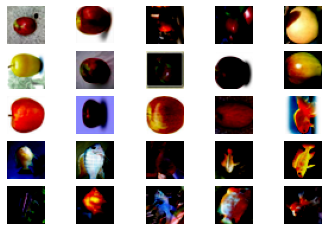

In [7]:
#Représentons graphiquement les premières images
figure = plt.figure()
cols, rows = 5, 5
for i in range(1, cols * rows + 1):
    img, label = trainset[i]
    figure.add_subplot(rows, cols, i)
    plt.axis("off")
    plt.imshow(img.squeeze().T, cmap="gray")
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

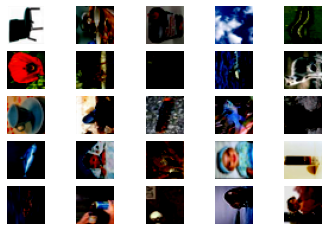

In [8]:
#Représentons graphiquement des images au hasard
figure = plt.figure()
cols, rows = 5, 5
for i in range(1, cols * rows + 1):
    sample_idx = torch.randint(len(trainset), size=(1,)).item()
    img, label = trainset[sample_idx]
    figure.add_subplot(rows, cols, i)
    plt.axis("off")
    plt.imshow(img.squeeze().T, cmap="gray")
plt.show()

In [9]:
len(trainset)

447

In [10]:
trainset

Dataset IMBALANCECIFAR100
    Number of datapoints: 447
    Root location: ./data
    Split: Train
    StandardTransform
Transform: Compose(
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )

In [11]:
from torch.utils.data import Dataset
from torchvision import datasets
from torchvision.transforms import ToTensor

In [12]:
training_data = datasets.CIFAR100(
    root="./data",
    train=True,
    download=True,
    transform=ToTensor()
)
test_data = datasets.CIFAR100(
    root="./data",
    train=False,
    download=True,
    transform=ToTensor()
)

Files already downloaded and verified
Files already downloaded and verified


In [13]:
print(len(training_data))
print(len(test_data))

50000
10000


In [14]:
#Let's discover our CIFAR10 dataset
dataset_size = len(training_data)
training_data[1]

(tensor([[[1.0000, 0.9922, 0.9922,  ..., 0.9922, 0.9922, 1.0000],
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          ...,
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          [1.0000, 0.9922, 0.9922,  ..., 0.9922, 0.9922, 1.0000]],
 
         [[1.0000, 0.9922, 0.9922,  ..., 0.9922, 0.9922, 1.0000],
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          ...,
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          [1.0000, 0.9922, 0.9922,  ..., 0.9922, 0.9922, 1.0000]],
 
         [[1.0000, 0.9922, 0.9922,  ..., 0.9922, 0.9922, 1.0000],
          [1.0000, 1.0000, 1.0000,  ..., 1.0000, 1.0000, 1.0000],
          [1.0000, 1.0000, 1.0000,  ...,

In [15]:
classes = training_data.classes
num_classes = len(training_data.classes)
print(classes)

['apple', 'aquarium_fish', 'baby', 'bear', 'beaver', 'bed', 'bee', 'beetle', 'bicycle', 'bottle', 'bowl', 'boy', 'bridge', 'bus', 'butterfly', 'camel', 'can', 'castle', 'caterpillar', 'cattle', 'chair', 'chimpanzee', 'clock', 'cloud', 'cockroach', 'couch', 'crab', 'crocodile', 'cup', 'dinosaur', 'dolphin', 'elephant', 'flatfish', 'forest', 'fox', 'girl', 'hamster', 'house', 'kangaroo', 'keyboard', 'lamp', 'lawn_mower', 'leopard', 'lion', 'lizard', 'lobster', 'man', 'maple_tree', 'motorcycle', 'mountain', 'mouse', 'mushroom', 'oak_tree', 'orange', 'orchid', 'otter', 'palm_tree', 'pear', 'pickup_truck', 'pine_tree', 'plain', 'plate', 'poppy', 'porcupine', 'possum', 'rabbit', 'raccoon', 'ray', 'road', 'rocket', 'rose', 'sea', 'seal', 'shark', 'shrew', 'skunk', 'skyscraper', 'snail', 'snake', 'spider', 'squirrel', 'streetcar', 'sunflower', 'sweet_pepper', 'table', 'tank', 'telephone', 'television', 'tiger', 'tractor', 'train', 'trout', 'tulip', 'turtle', 'wardrobe', 'whale', 'willow_tree',

In [16]:
img_dict = {}
for i in range(num_classes):
    img_dict[classes[i]] = 0
for i in range(dataset_size):
    img, label = training_data[i]
    img_dict[classes[label]] += 1
img_dict


{'apple': 500,
 'aquarium_fish': 500,
 'baby': 500,
 'bear': 500,
 'beaver': 500,
 'bed': 500,
 'bee': 500,
 'beetle': 500,
 'bicycle': 500,
 'bottle': 500,
 'bowl': 500,
 'boy': 500,
 'bridge': 500,
 'bus': 500,
 'butterfly': 500,
 'camel': 500,
 'can': 500,
 'castle': 500,
 'caterpillar': 500,
 'cattle': 500,
 'chair': 500,
 'chimpanzee': 500,
 'clock': 500,
 'cloud': 500,
 'cockroach': 500,
 'couch': 500,
 'crab': 500,
 'crocodile': 500,
 'cup': 500,
 'dinosaur': 500,
 'dolphin': 500,
 'elephant': 500,
 'flatfish': 500,
 'forest': 500,
 'fox': 500,
 'girl': 500,
 'hamster': 500,
 'house': 500,
 'kangaroo': 500,
 'keyboard': 500,
 'lamp': 500,
 'lawn_mower': 500,
 'leopard': 500,
 'lion': 500,
 'lizard': 500,
 'lobster': 500,
 'man': 500,
 'maple_tree': 500,
 'motorcycle': 500,
 'mountain': 500,
 'mouse': 500,
 'mushroom': 500,
 'oak_tree': 500,
 'orange': 500,
 'orchid': 500,
 'otter': 500,
 'palm_tree': 500,
 'pear': 500,
 'pickup_truck': 500,
 'pine_tree': 500,
 'plain': 500,
 'pl

In [17]:
classes_Especes_Zipf = trainset.classes
num_classes_Especes_Zipf = len(trainset.classes)
dataset_size_Especes_Zipf = len(trainset)
print(dataset_size_Especes_Zipf)

447


In [18]:
img_dict_Especes_Zipf = {}
for i in range(num_classes_Especes_Zipf):
    img_dict_Especes_Zipf[classes_Especes_Zipf[i]] = 0
for i in range(dataset_size_Especes_Zipf):
    img, label = trainset[i]
    img_dict_Especes_Zipf[classes_Especes_Zipf[label]] += 1
img_dict_Especes_Zipf


{'apple': 15,
 'aquarium_fish': 14,
 'baby': 14,
 'bear': 13,
 'beaver': 13,
 'bed': 12,
 'bee': 12,
 'beetle': 11,
 'bicycle': 11,
 'bottle': 11,
 'bowl': 10,
 'boy': 10,
 'bridge': 9,
 'bus': 9,
 'butterfly': 9,
 'camel': 9,
 'can': 8,
 'castle': 8,
 'caterpillar': 8,
 'cattle': 7,
 'chair': 7,
 'chimpanzee': 7,
 'clock': 7,
 'cloud': 7,
 'cockroach': 6,
 'couch': 6,
 'crab': 6,
 'crocodile': 6,
 'cup': 6,
 'dinosaur': 5,
 'dolphin': 5,
 'elephant': 5,
 'flatfish': 5,
 'forest': 5,
 'fox': 5,
 'girl': 5,
 'hamster': 4,
 'house': 4,
 'kangaroo': 4,
 'keyboard': 4,
 'lamp': 4,
 'lawn_mower': 4,
 'leopard': 4,
 'lion': 4,
 'lizard': 4,
 'lobster': 3,
 'man': 3,
 'maple_tree': 3,
 'motorcycle': 3,
 'mountain': 3,
 'mouse': 3,
 'mushroom': 3,
 'oak_tree': 3,
 'orange': 3,
 'orchid': 3,
 'otter': 3,
 'palm_tree': 3,
 'pear': 3,
 'pickup_truck': 3,
 'pine_tree': 2,
 'plain': 2,
 'plate': 2,
 'poppy': 2,
 'porcupine': 2,
 'possum': 2,
 'rabbit': 2,
 'raccoon': 2,
 'ray': 2,
 'road': 2,
 'roc

In [19]:
Liste = list(img_dict_Especes_Zipf.values())

In [20]:
Liste2 = []
for element in Liste:
    Liste2.append(element/sum(Liste))
Liste2

[0.03355704697986577,
 0.03131991051454139,
 0.03131991051454139,
 0.029082774049217,
 0.029082774049217,
 0.026845637583892617,
 0.026845637583892617,
 0.024608501118568233,
 0.024608501118568233,
 0.024608501118568233,
 0.02237136465324385,
 0.02237136465324385,
 0.020134228187919462,
 0.020134228187919462,
 0.020134228187919462,
 0.020134228187919462,
 0.017897091722595078,
 0.017897091722595078,
 0.017897091722595078,
 0.015659955257270694,
 0.015659955257270694,
 0.015659955257270694,
 0.015659955257270694,
 0.015659955257270694,
 0.013422818791946308,
 0.013422818791946308,
 0.013422818791946308,
 0.013422818791946308,
 0.013422818791946308,
 0.011185682326621925,
 0.011185682326621925,
 0.011185682326621925,
 0.011185682326621925,
 0.011185682326621925,
 0.011185682326621925,
 0.011185682326621925,
 0.008948545861297539,
 0.008948545861297539,
 0.008948545861297539,
 0.008948545861297539,
 0.008948545861297539,
 0.008948545861297539,
 0.008948545861297539,
 0.008948545861297539,

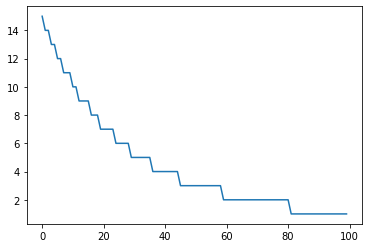

In [21]:
import matplotlib.pyplot as plt
plt.plot(Liste)

In [22]:
#Vérifions que notre dataset suit bien une loi de Zipf
import pandas as pd
df = pd.DataFrame(Liste)
df.columns = ['Images_Classes']
df.sort_values(by=['Images_Classes'], ascending=False, inplace=True)
print(df)

    Images_Classes
0               15
2               14
1               14
3               13
4               13
..             ...
84               1
83               1
82               1
81               1
99               1

[100 rows x 1 columns]


In [23]:
df.to_csv('C:/Users/nilsr/Desktop/PRE/Stage_M1/Jupyter_Notebook/Donnees_CSV/Dataset_Especes_ZM.csv', encoding='utf-8', index=False)

In [24]:
# Creons des datasets en échantillonant sur les méta-classes
import numpy as np
from torchvision.datasets import CIFAR100


class CIFAR100Coarse(CIFAR100):
    def __init__(self, root, train=True, transform=None, target_transform=None, download=False):
        super(CIFAR100Coarse, self).__init__(root, train, transform, target_transform, download)

        # update labels
        coarse_labels = np.array([ 4,  1, 14,  8,  0,  6,  7,  7, 18,  3,
                                   3, 14,  9, 18,  7, 11,  3,  9,  7, 11,
                                   6, 11,  5, 10,  7,  6, 13, 15,  3, 15, 
                                   0, 11,  1, 10, 12, 14, 16,  9, 11,  5,
                                   5, 19,  8,  8, 15, 13, 14, 17, 18, 10,
                                   16, 4, 17,  4,  2,  0, 17,  4, 18, 17,
                                   10, 3,  2, 12, 12, 16, 12,  1,  9, 19, 
                                   2, 10,  0,  1, 16, 12,  9, 13, 15, 13,
                                  16, 19,  2,  4,  6, 19,  5,  5,  8, 19,
                                  18,  1,  2, 15,  6,  0, 17,  8, 14, 13])
        self.targets = coarse_labels[self.targets]

        # update classes
        self.classes = [['beaver', 'dolphin', 'otter', 'seal', 'whale'],
                        ['aquarium_fish', 'flatfish', 'ray', 'shark', 'trout'],
                        ['orchid', 'poppy', 'rose', 'sunflower', 'tulip'],
                        ['bottle', 'bowl', 'can', 'cup', 'plate'],
                        ['apple', 'mushroom', 'orange', 'pear', 'sweet_pepper'],
                        ['clock', 'keyboard', 'lamp', 'telephone', 'television'],
                        ['bed', 'chair', 'couch', 'table', 'wardrobe'],
                        ['bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach'],
                        ['bear', 'leopard', 'lion', 'tiger', 'wolf'],
                        ['bridge', 'castle', 'house', 'road', 'skyscraper'],
                        ['cloud', 'forest', 'mountain', 'plain', 'sea'],
                        ['camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo'],
                        ['fox', 'porcupine', 'possum', 'raccoon', 'skunk'],
                        ['crab', 'lobster', 'snail', 'spider', 'worm'],
                        ['baby', 'boy', 'girl', 'man', 'woman'],
                        ['crocodile', 'dinosaur', 'lizard', 'snake', 'turtle'],
                        ['hamster', 'mouse', 'rabbit', 'shrew', 'squirrel'],
                        ['maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree'],
                        ['bicycle', 'bus', 'motorcycle', 'pickup_truck', 'train'],
                        ['lawn_mower', 'rocket', 'streetcar', 'tank', 'tractor']]

In [25]:
class IMBALANCECIFAR100Metaclasses(CIFAR100Coarse):
    cls_num = 100

    def __init__(self, root, imb_type='Zipf-Mandelbrot', imb_factor=15, imb_factor2=92, rand_number=0, train=True,
                 transform=None, target_transform=None,
                 download=False):
        super(IMBALANCECIFAR100Metaclasses, self).__init__(root, train, transform, target_transform, download)
        np.random.seed(rand_number)
        img_num_list = self.get_img_num_per_cls(self.cls_num, imb_type, imb_factor, imb_factor2)
        self.gen_imbalanced_data(img_num_list)

    def get_img_num_per_cls(self, cls_num, imb_type, imb_factor, imb_factor2):
        img_max = len(self.data) / cls_num
        img_num_per_cls = []
        if imb_type == 'exp':
            for cls_idx in range(cls_num):
                num = img_max * (imb_factor**(cls_idx / (cls_num - 1.0)))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf-Mandelbrot':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx+imb_factor2)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx+imb_factor2)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        elif imb_type == 'step':
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max))
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max * imb_factor))
        else:
            img_num_per_cls.extend([int(img_max)] * cls_num)
        return img_num_per_cls

    def gen_imbalanced_data(self, img_num_per_cls):
        new_data = []
        new_targets = []
        targets_np = np.array(self.targets, dtype=np.int64)
        classes = np.unique(targets_np)
        # np.random.shuffle(classes)
        self.num_per_cls_dict = dict()
        for the_class, the_img_num in zip(classes, img_num_per_cls):
            self.num_per_cls_dict[the_class] = the_img_num
            idx = np.where(targets_np == the_class)[0]
            np.random.shuffle(idx)
            selec_idx = idx[:the_img_num]
            new_data.append(self.data[selec_idx, ...])
            new_targets.extend([the_class, ] * the_img_num)
        new_data = np.vstack(new_data)
        self.data = new_data
        self.targets = new_targets
        
    def get_cls_num_list(self):
        cls_num_list = []
        for i in range(self.cls_num):
            cls_num_list.append(self.num_per_cls_dict[i])
        return cls_num_list

In [26]:
dataset = CIFAR100Coarse(
    root="./data",
    download=True,
    transform=ToTensor()
)

Files already downloaded and verified


In [27]:
dataset2 = IMBALANCECIFAR100Metaclasses(
    root="./data",
    download=True,
    transform=ToTensor()
)

Files already downloaded and verified


In [28]:
print(len(dataset.classes))
print(dataset.classes)
print(len(dataset))

20
[['beaver', 'dolphin', 'otter', 'seal', 'whale'], ['aquarium_fish', 'flatfish', 'ray', 'shark', 'trout'], ['orchid', 'poppy', 'rose', 'sunflower', 'tulip'], ['bottle', 'bowl', 'can', 'cup', 'plate'], ['apple', 'mushroom', 'orange', 'pear', 'sweet_pepper'], ['clock', 'keyboard', 'lamp', 'telephone', 'television'], ['bed', 'chair', 'couch', 'table', 'wardrobe'], ['bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach'], ['bear', 'leopard', 'lion', 'tiger', 'wolf'], ['bridge', 'castle', 'house', 'road', 'skyscraper'], ['cloud', 'forest', 'mountain', 'plain', 'sea'], ['camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo'], ['fox', 'porcupine', 'possum', 'raccoon', 'skunk'], ['crab', 'lobster', 'snail', 'spider', 'worm'], ['baby', 'boy', 'girl', 'man', 'woman'], ['crocodile', 'dinosaur', 'lizard', 'snake', 'turtle'], ['hamster', 'mouse', 'rabbit', 'shrew', 'squirrel'], ['maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree'], ['bicycle', 'bus', 'motorcycle', 'pickup_truck',

In [29]:
classes3 = dataset.classes
num_classes3 = len(dataset.classes)
dataset_size3 = len(dataset)
print(dataset_size3)
print(num_classes3)
print(classes3)

50000
20
[['beaver', 'dolphin', 'otter', 'seal', 'whale'], ['aquarium_fish', 'flatfish', 'ray', 'shark', 'trout'], ['orchid', 'poppy', 'rose', 'sunflower', 'tulip'], ['bottle', 'bowl', 'can', 'cup', 'plate'], ['apple', 'mushroom', 'orange', 'pear', 'sweet_pepper'], ['clock', 'keyboard', 'lamp', 'telephone', 'television'], ['bed', 'chair', 'couch', 'table', 'wardrobe'], ['bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach'], ['bear', 'leopard', 'lion', 'tiger', 'wolf'], ['bridge', 'castle', 'house', 'road', 'skyscraper'], ['cloud', 'forest', 'mountain', 'plain', 'sea'], ['camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo'], ['fox', 'porcupine', 'possum', 'raccoon', 'skunk'], ['crab', 'lobster', 'snail', 'spider', 'worm'], ['baby', 'boy', 'girl', 'man', 'woman'], ['crocodile', 'dinosaur', 'lizard', 'snake', 'turtle'], ['hamster', 'mouse', 'rabbit', 'shrew', 'squirrel'], ['maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree'], ['bicycle', 'bus', 'motorcycle', 'pickup_t

In [30]:
MetaClasses = ['Fish1', 'Fish2', 'Flowers', 'Kitchen', 'Fruits', 'Technology', 'Furniture', 'Insects', 'Jungle', 'Buildings', 'Nature', 'Desert', 'Forest', 'Sea', 'Gender', 'Savage', 'Domestic', 'Trees', 'Vehicles', 'Big_Vehicles']

In [31]:
classes3[0]

['beaver', 'dolphin', 'otter', 'seal', 'whale']

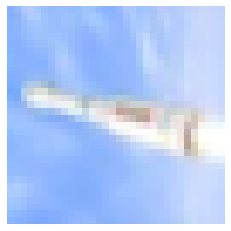

In [32]:
figure = plt.figure()
img, label = dataset[199]
plt.axis("off")
plt.imshow(img.squeeze().T, cmap="gray")
plt.show()

In [33]:
img_dict3 = {}
for i in range(num_classes3):
    img_dict3[MetaClasses[i]] = 0
for i in range(dataset_size3):
    img, label = dataset[i]
    img_dict3[MetaClasses[label]] += 1
img_dict3

{'Fish1': 2500,
 'Fish2': 2500,
 'Flowers': 2500,
 'Kitchen': 2500,
 'Fruits': 2500,
 'Technology': 2500,
 'Furniture': 2500,
 'Insects': 2500,
 'Jungle': 2500,
 'Buildings': 2500,
 'Nature': 2500,
 'Desert': 2500,
 'Forest': 2500,
 'Sea': 2500,
 'Gender': 2500,
 'Savage': 2500,
 'Domestic': 2500,
 'Trees': 2500,
 'Vehicles': 2500,
 'Big_Vehicles': 2500}

In [34]:
classes4 = dataset2.classes
num_classes4 = len(dataset2.classes)
dataset_size4 = len(dataset2)
print(dataset_size4)
print(num_classes4)
print(classes4)

458
20
[['beaver', 'dolphin', 'otter', 'seal', 'whale'], ['aquarium_fish', 'flatfish', 'ray', 'shark', 'trout'], ['orchid', 'poppy', 'rose', 'sunflower', 'tulip'], ['bottle', 'bowl', 'can', 'cup', 'plate'], ['apple', 'mushroom', 'orange', 'pear', 'sweet_pepper'], ['clock', 'keyboard', 'lamp', 'telephone', 'television'], ['bed', 'chair', 'couch', 'table', 'wardrobe'], ['bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach'], ['bear', 'leopard', 'lion', 'tiger', 'wolf'], ['bridge', 'castle', 'house', 'road', 'skyscraper'], ['cloud', 'forest', 'mountain', 'plain', 'sea'], ['camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo'], ['fox', 'porcupine', 'possum', 'raccoon', 'skunk'], ['crab', 'lobster', 'snail', 'spider', 'worm'], ['baby', 'boy', 'girl', 'man', 'woman'], ['crocodile', 'dinosaur', 'lizard', 'snake', 'turtle'], ['hamster', 'mouse', 'rabbit', 'shrew', 'squirrel'], ['maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree'], ['bicycle', 'bus', 'motorcycle', 'pickup_tru

1


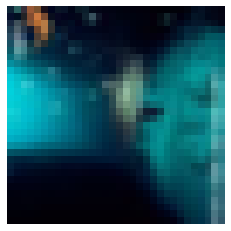

1


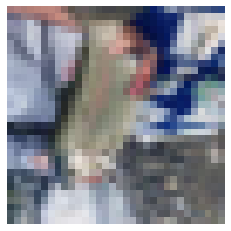

1


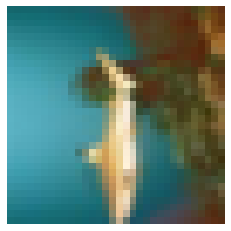

1


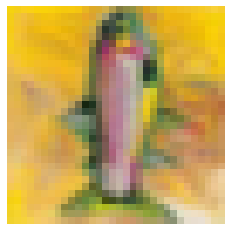

1


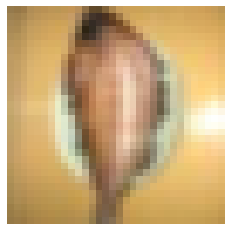

1


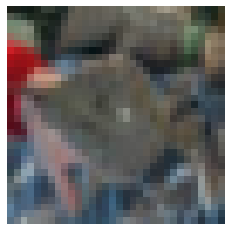

1


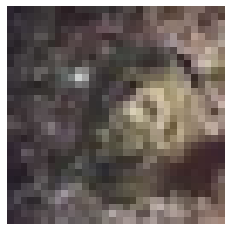

1


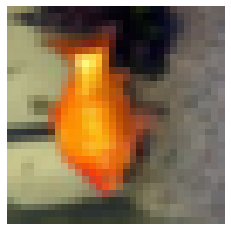

1


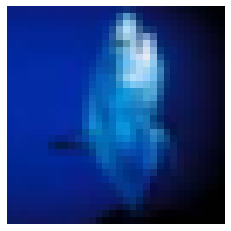

1


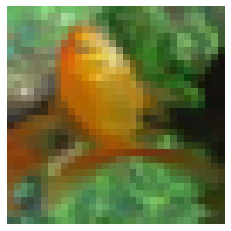

1


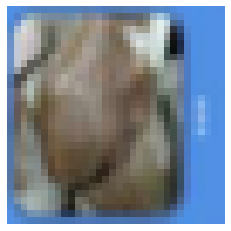

1


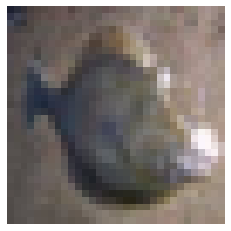

1


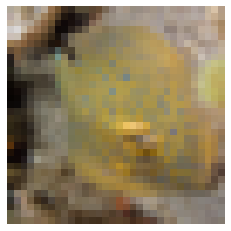

1


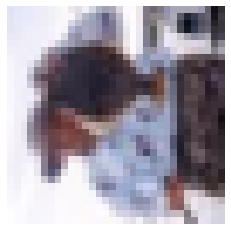

1


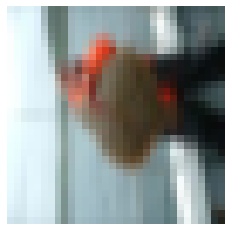

1


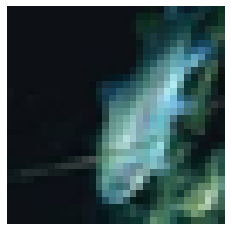

1


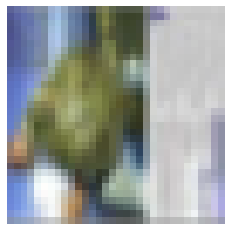

1


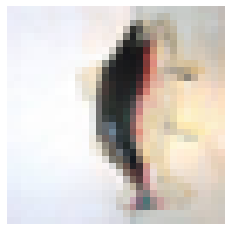

1


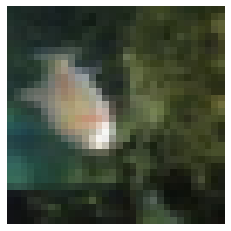

1


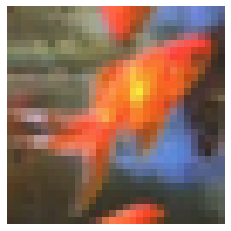

1


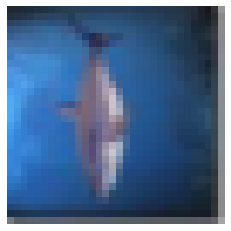

1


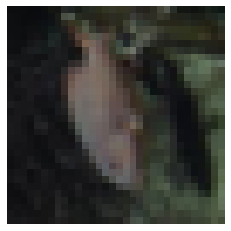

1


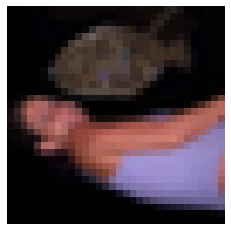

1


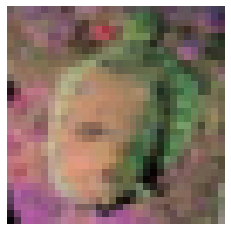

1


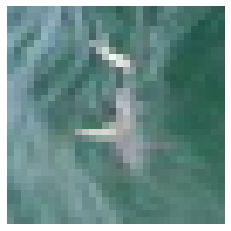

1


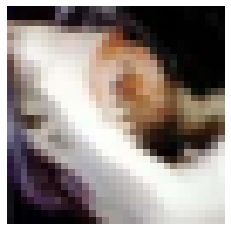

1


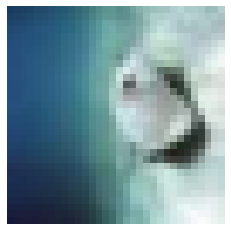

1


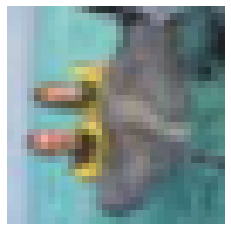

1


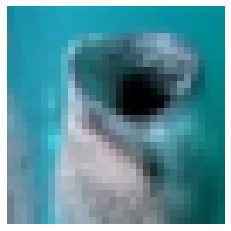

1


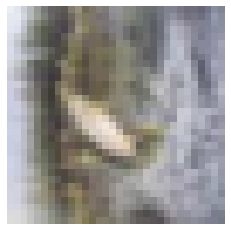

1


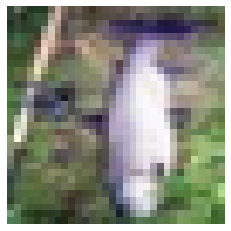

1


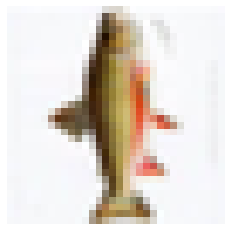

1


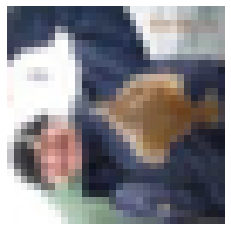

1


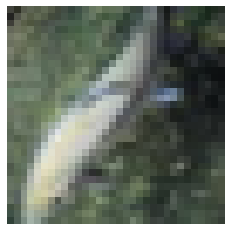

1


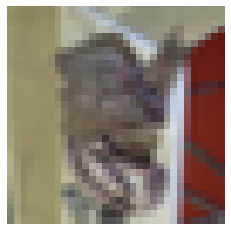

1


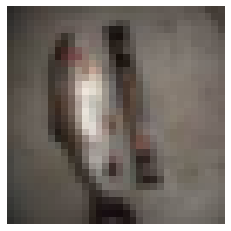

1


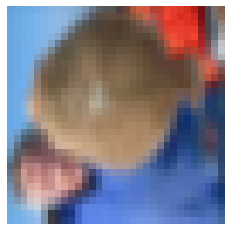

1


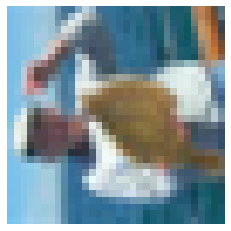

1


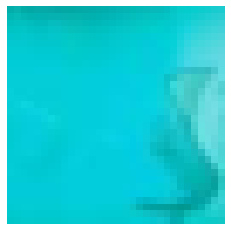

1


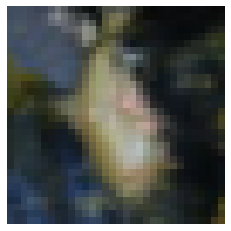

1


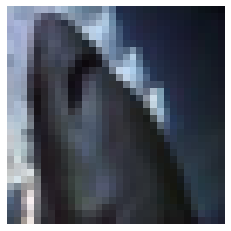

1


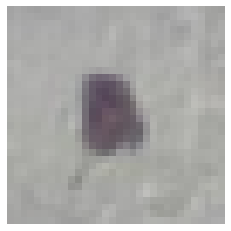

1


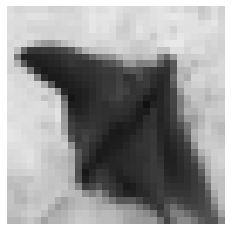

1


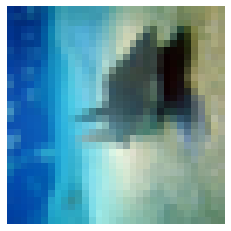

1


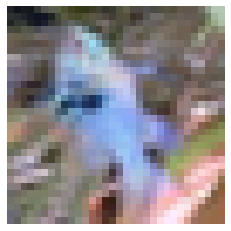

1


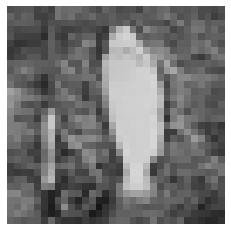

1


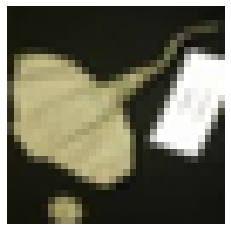

1


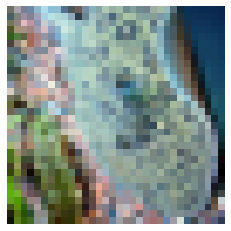

1


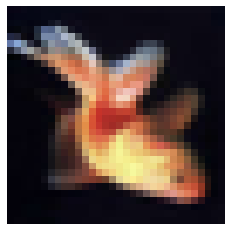

1


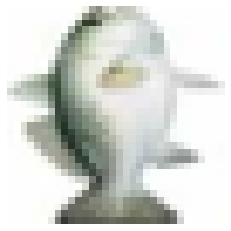

1


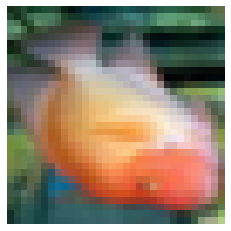

1


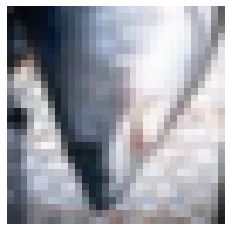

1


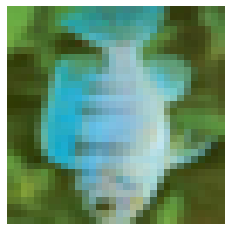

1


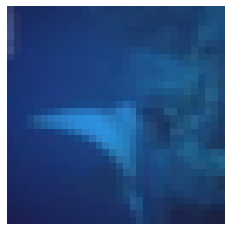

1


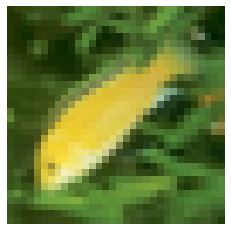

1


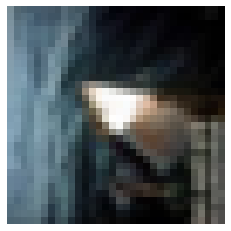

1


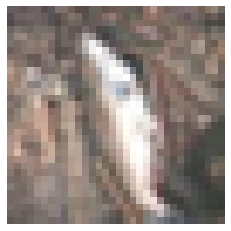

1


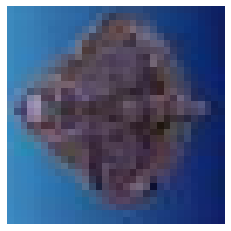

1


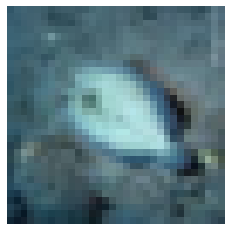

2


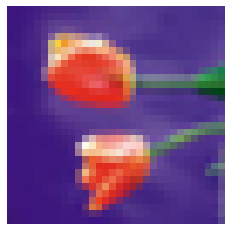

2


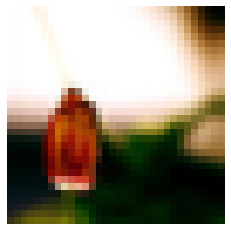

In [35]:
for i in range(69, 130):
    figure = plt.figure()
    img, label = dataset2[i]
    print(label)
    plt.axis("off")
    plt.imshow(img.squeeze().T, cmap="gray")
    plt.show()

In [36]:
img_dict4 = {}
for i in range(num_classes4):
    img_dict4[MetaClasses[i]] = 0
for i in range(dataset_size4):
    img, label = dataset2[i]
    img_dict4[MetaClasses[label]] += 1
img_dict4

{'Fish1': 69,
 'Fish2': 59,
 'Flowers': 50,
 'Kitchen': 43,
 'Fruits': 37,
 'Technology': 31,
 'Furniture': 27,
 'Insects': 23,
 'Jungle': 20,
 'Buildings': 17,
 'Nature': 15,
 'Desert': 13,
 'Forest': 11,
 'Sea': 9,
 'Gender': 8,
 'Savage': 7,
 'Domestic': 6,
 'Trees': 5,
 'Vehicles': 4,
 'Big_Vehicles': 4}

In [37]:
Liste3 = list(img_dict4.values())

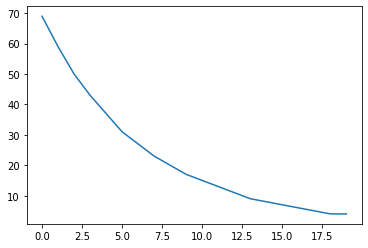

In [38]:
plt.plot(Liste3)

In [39]:
#Let's apply Joly's method with the joint species/genera couple
Genres = []
All = []
q1, a1 = 10, 4
q2, a2 = 2, 2
N_images = 10000
for i in range(1, 21): #Les genres
    Int = []
    for j in range(1, 6): #les especes
        element = (1/(i+q1)**(a1))*(1/(j+q2)**(a2))
        Int.append(element)
    print(Int)
    Genres.append(Int)
    All.extend(Int)
    
    
        
        

[7.589038392945229e-06, 4.2688340960316914e-06, 2.7320538214602825e-06, 1.8972595982363072e-06, 1.3939050109491236e-06]
[5.358367626886145e-06, 3.0140817901234566e-06, 1.9290123456790124e-06, 1.3395919067215363e-06, 9.841899722852103e-07]
[3.89030885161973e-06, 2.1882987290360982e-06, 1.4005111865831029e-06, 9.725772129049325e-07, 7.145465237668891e-07]
[2.89231338794021e-06, 1.6269262807163682e-06, 1.0412328196584756e-06, 7.230783469850525e-07, 5.312412345196304e-07]
[2.194787379972565e-06, 1.234567901234568e-06, 7.901234567901235e-07, 5.486968449931413e-07, 4.0312421264802214e-07]
[1.6954210069444444e-06, 9.5367431640625e-07, 6.103515625e-07, 4.238552517361111e-07, 3.114038584183673e-07]
[1.3303374134781805e-06, 7.483147950814765e-07, 4.789214688521449e-07, 3.325843533695451e-07, 2.4434768818986987e-07]
[1.0584429880268929e-06, 5.953741807651273e-07, 3.8103947568968147e-07, 2.646107470067232e-07, 1.9440789576004154e-07]
[8.525955994130732e-07, 4.795850246698537e-07, 3.069344157887063

In [40]:
Genres

[[7.589038392945229e-06,
  4.2688340960316914e-06,
  2.7320538214602825e-06,
  1.8972595982363072e-06,
  1.3939050109491236e-06],
 [5.358367626886145e-06,
  3.0140817901234566e-06,
  1.9290123456790124e-06,
  1.3395919067215363e-06,
  9.841899722852103e-07],
 [3.89030885161973e-06,
  2.1882987290360982e-06,
  1.4005111865831029e-06,
  9.725772129049325e-07,
  7.145465237668891e-07],
 [2.89231338794021e-06,
  1.6269262807163682e-06,
  1.0412328196584756e-06,
  7.230783469850525e-07,
  5.312412345196304e-07],
 [2.194787379972565e-06,
  1.234567901234568e-06,
  7.901234567901235e-07,
  5.486968449931413e-07,
  4.0312421264802214e-07],
 [1.6954210069444444e-06,
  9.5367431640625e-07,
  6.103515625e-07,
  4.238552517361111e-07,
  3.114038584183673e-07],
 [1.3303374134781805e-06,
  7.483147950814765e-07,
  4.789214688521449e-07,
  3.325843533695451e-07,
  2.4434768818986987e-07],
 [1.0584429880268929e-06,
  5.953741807651273e-07,
  3.8103947568968147e-07,
  2.646107470067232e-07,
  1.9440789

In [41]:
All

[7.589038392945229e-06,
 4.2688340960316914e-06,
 2.7320538214602825e-06,
 1.8972595982363072e-06,
 1.3939050109491236e-06,
 5.358367626886145e-06,
 3.0140817901234566e-06,
 1.9290123456790124e-06,
 1.3395919067215363e-06,
 9.841899722852103e-07,
 3.89030885161973e-06,
 2.1882987290360982e-06,
 1.4005111865831029e-06,
 9.725772129049325e-07,
 7.145465237668891e-07,
 2.89231338794021e-06,
 1.6269262807163682e-06,
 1.0412328196584756e-06,
 7.230783469850525e-07,
 5.312412345196304e-07,
 2.194787379972565e-06,
 1.234567901234568e-06,
 7.901234567901235e-07,
 5.486968449931413e-07,
 4.0312421264802214e-07,
 1.6954210069444444e-06,
 9.5367431640625e-07,
 6.103515625e-07,
 4.238552517361111e-07,
 3.114038584183673e-07,
 1.3303374134781805e-06,
 7.483147950814765e-07,
 4.789214688521449e-07,
 3.325843533695451e-07,
 2.4434768818986987e-07,
 1.0584429880268929e-06,
 5.953741807651273e-07,
 3.8103947568968147e-07,
 2.646107470067232e-07,
 1.9440789576004154e-07,
 8.525955994130732e-07,
 4.79585

In [42]:
a = sum(All)
a

7.197013346795171e-05

In [43]:
for i in range(len(All)):
    All[i] = All[i]*N_images/a
All

[1054.4705181524537,
 593.1396664607552,
 379.60938653488336,
 263.6176295381134,
 193.67825843616492,
 744.5265652136417,
 418.7961929326735,
 268.029563476911,
 186.13164130341042,
 136.74977728413828,
 540.5448988575356,
 304.0565056073638,
 194.59616358871284,
 135.1362247143839,
 99.28375693301673,
 401.876896508488,
 226.05575428602452,
 144.6756827430557,
 100.469224127122,
 73.8141238484978,
 304.9580811115076,
 171.53892062522306,
 109.78490920014276,
 76.2395202778769,
 56.012708775583036,
 235.57285852462883,
 132.50973292010372,
 84.80622906886639,
 58.89321463115721,
 43.26848421880938,
 184.84576162007252,
 103.97574091129079,
 66.54447418322609,
 46.21144040501813,
 33.95126233838066,
 147.06697584466997,
 82.72517391262686,
 52.9441113040812,
 36.76674396116749,
 27.01230168575571,
 118.46519637103826,
 66.63667295870901,
 42.64747069357377,
 29.616299092759565,
 21.75891361917029,
 96.49064285168798,
 54.27598660407448,
 34.73663142660768,
 24.122660712921995,
 17.7227

In [44]:
for element in Genres:
    for i in range(len(element)):
            element[i] = element[i]*N_images/a
Genres


[[1054.4705181524537,
  593.1396664607552,
  379.60938653488336,
  263.6176295381134,
  193.67825843616492],
 [744.5265652136417,
  418.7961929326735,
  268.029563476911,
  186.13164130341042,
  136.74977728413828],
 [540.5448988575356,
  304.0565056073638,
  194.59616358871284,
  135.1362247143839,
  99.28375693301673],
 [401.876896508488,
  226.05575428602452,
  144.6756827430557,
  100.469224127122,
  73.8141238484978],
 [304.9580811115076,
  171.53892062522306,
  109.78490920014276,
  76.2395202778769,
  56.012708775583036],
 [235.57285852462883,
  132.50973292010372,
  84.80622906886639,
  58.89321463115721,
  43.26848421880938],
 [184.84576162007252,
  103.97574091129079,
  66.54447418322609,
  46.21144040501813,
  33.95126233838066],
 [147.06697584466997,
  82.72517391262686,
  52.9441113040812,
  36.76674396116749,
  27.01230168575571],
 [118.46519637103826,
  66.63667295870901,
  42.64747069357377,
  29.616299092759565,
  21.75891361917029],
 [96.49064285168798,
  54.275986604

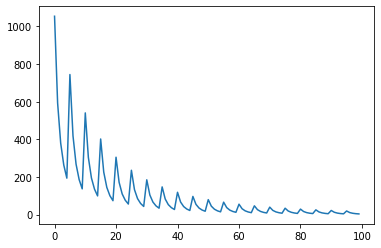

In [45]:
#Représentons graphiquement les trois courbes de Joly
plt.plot(All)

In [46]:
All2 = All.copy()

In [47]:
All2.sort(reverse=True)
All2

[1054.4705181524537,
 744.5265652136417,
 593.1396664607552,
 540.5448988575356,
 418.7961929326735,
 401.876896508488,
 379.60938653488336,
 304.9580811115076,
 304.0565056073638,
 268.029563476911,
 263.6176295381134,
 235.57285852462883,
 226.05575428602452,
 194.59616358871284,
 193.67825843616492,
 186.13164130341042,
 184.84576162007252,
 171.53892062522306,
 147.06697584466997,
 144.6756827430557,
 136.74977728413828,
 135.1362247143839,
 132.50973292010372,
 118.46519637103826,
 109.78490920014276,
 103.97574091129079,
 100.469224127122,
 99.28375693301673,
 96.49064285168798,
 84.80622906886639,
 82.72517391262686,
 79.3830906683433,
 76.2395202778769,
 73.8141238484978,
 66.63667295870901,
 66.54447418322609,
 65.90440738452835,
 58.89321463115721,
 56.012708775583036,
 55.168838219810794,
 54.27598660407448,
 52.9441113040812,
 46.532910325852605,
 46.21144040501813,
 44.65298850094311,
 43.26848421880938,
 42.64747069357377,
 39.522567312051386,
 37.0712291537972,
 36.76674

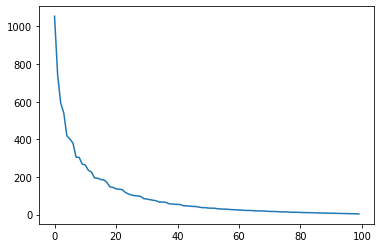

In [48]:
plt.plot(All2)

In [49]:
import math as m
All3 = []
for element in All2:
    All3.append(m.log(element))
All3

[6.960794041398504,
 6.612748533439985,
 6.3854298964949425,
 6.29257770274584,
 6.037384388536424,
 5.996145814130952,
 5.939142793866523,
 5.7201743281831465,
 5.717213557842278,
 5.5910972859080035,
 5.574499680278613,
 5.462020243632861,
 5.420781669227391,
 5.270926455213858,
 5.266198320624097,
 5.226454172320095,
 5.219521756367122,
 5.144810183279584,
 4.990888101007328,
 4.97449456659897,
 4.9181528126655785,
 4.906283341625949,
 4.8866560987293,
 4.774619215926225,
 4.698523080651165,
 4.6441576114635605,
 4.6098514530110615,
 4.597981981971432,
 4.5694460383760225,
 4.44036899610088,
 4.415523956103766,
 4.374285381698295,
 4.333879967063256,
 4.301550093356545,
 4.199255071022663,
 4.19787050883514,
 4.188205319158723,
 4.075725882512971,
 4.025578607408739,
 4.010398268875387,
 3.994081893472461,
 3.9692368534753464,
 3.840159811200204,
 3.8332273952472318,
 3.7989212367947327,
 3.7674245228584544,
 3.7529679683942434,
 3.676871833119183,
 3.6128411742551614,
 3.6045937398

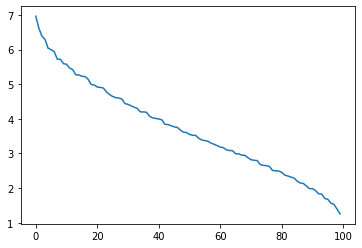

In [50]:
plt.plot(All3)

In [51]:
#Echantillons de manière réaliste à la Joly
class CIFAR100Nils(CIFAR100):
    def __init__(self, root, train=True, transform=None, target_transform=None, download=False):
        super(CIFAR100Nils, self).__init__(root, train, transform, target_transform, download)

        # update labels
        coarse_labels = np.array([ 20,  5, 70,  40,  0,  30,  35,  36, 90,  15,
                                   16, 71,  45, 91, 37, 55,  17,  46,  38, 56,
                                   31, 57,  25, 50,  39,  32, 65, 75,  18, 76, 
                                   1, 58,  6, 51, 60, 72, 80, 47, 59, 26,
                                   27, 95,  41,  42, 77, 66, 73, 85, 92, 52,
                                   81, 21, 86,  22,  10,  2, 87,  23, 93, 88,
                                   53, 19,  11, 61, 62, 82, 63,  7,  48, 96, 
                                   12, 54,  3,  8, 83, 64,  49, 67, 78, 68,
                                  84, 97,  13,  24,  33, 98,  28,  29,  43, 99,
                                  94,  9,  14, 79,  34,  4, 89,  44, 74, 69])
        self.targets = coarse_labels[self.targets]

        # update classes
        self.classes = ['beaver', 'dolphin', 'otter', 'seal', 'whale',
                        'aquarium_fish', 'flatfish', 'ray', 'shark', 'trout',
                        'orchid', 'poppy', 'rose', 'sunflower', 'tulip',
                        'bottle', 'bowl', 'can', 'cup', 'plate',
                        'apple', 'mushroom', 'orange', 'pear', 'sweet_pepper',
                        'clock', 'keyboard', 'lamp', 'telephone', 'television',
                        'bed', 'chair', 'couch', 'table', 'wardrobe',
                        'bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach',
                        'bear', 'leopard', 'lion', 'tiger', 'wolf',
                        'bridge', 'castle', 'house', 'road', 'skyscraper',
                        'cloud', 'forest', 'mountain', 'plain', 'sea',
                        'camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo',
                        'fox', 'porcupine', 'possum', 'raccoon', 'skunk',
                        'crab', 'lobster', 'snail', 'spider', 'worm',
                        'baby', 'boy', 'girl', 'man', 'woman',
                        'crocodile', 'dinosaur', 'lizard', 'snake', 'turtle',
                        'hamster', 'mouse', 'rabbit', 'shrew', 'squirrel',
                        'maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree',
                        'bicycle', 'bus', 'motorcycle', 'pickup_truck', 'train',
                        'lawn_mower', 'rocket', 'streetcar', 'tank', 'tractor']

In [52]:
class IMBALANCECIFAR100Realist(CIFAR100Nils):
    cls_num = 100

    def __init__(self, root, imb_type='ZM', a1=4, q1=10, a2 = 2, q2=2, rand_number=0, train=True,
                 transform=None, target_transform=None,
                 download=False):
        super(IMBALANCECIFAR100Realist, self).__init__(root, train, transform, target_transform, download)
        np.random.seed(rand_number)
        img_num_list = self.get_img_num_per_cls(self.cls_num, imb_type, a1, q1, a2, q2)
        self.gen_imbalanced_data(img_num_list)

    def get_img_num_per_cls(self, cls_num, imb_type, a1, q1, a2, q2):
        img_max = len(self.data) / cls_num
        img_num_per_cls = []
        if imb_type == 'exp':
            for cls_idx in range(cls_num):
                num = img_max * (imb_factor**(cls_idx / (cls_num - 1.0)))
                img_num_per_cls.append(int(num))
        if imb_type == 'ZM':
            Normalisation = 0
            for i in range(1, 21): #Les genres
                Int = []
                for j in range(1, 6): #les especes
                    Normalisation += (1/(i+q1)**(a1))*(1/(j+q2)**(a2))
            for cls_idx in range(cls_num):
                cls_genre = cls_idx % 5 + 1
                cls_espece = cls_idx // 5 + 1
                num = (1/(cls_espece+q1)**(a1))*(1/(cls_genre+q2)**(a2))
                img_num_per_cls.append(min(int(num*5000/Normalisation), 500))
        if imb_type == 'Zipf-Mandelbrot':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx+imb_factor2)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx+imb_factor2)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        elif imb_type == 'step':
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max))
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max * imb_factor))
        else:
            img_num_per_cls.extend([int(img_max)] * cls_num)
        return img_num_per_cls

    def gen_imbalanced_data(self, img_num_per_cls):
        new_data = []
        new_targets = []
        targets_np = np.array(self.targets, dtype=np.int64)
        classes = np.unique(targets_np)
        # np.random.shuffle(classes)
        self.num_per_cls_dict = dict()
        for the_class, the_img_num in zip(classes, img_num_per_cls):
            self.num_per_cls_dict[the_class] = the_img_num
            idx = np.where(targets_np == the_class)[0]
            np.random.shuffle(idx)
            selec_idx = idx[:the_img_num]
            new_data.append(self.data[selec_idx, ...])
            new_targets.extend([the_class, ] * the_img_num)
        new_data = np.vstack(new_data)
        self.data = new_data
        self.targets = new_targets
        
    def get_cls_num_list(self):
        cls_num_list = []
        for i in range(self.cls_num):
            cls_num_list.append(self.num_per_cls_dict[i])
        return cls_num_list

In [104]:
dataset_Realist = IMBALANCECIFAR100Realist(
    root="./data",
    download=True,
    transform=ToTensor()
)

Files already downloaded and verified


In [105]:
classes5 = dataset_Realist.classes
num_classes5 = len(dataset_Realist.classes)
dataset_size5 = len(dataset_Realist)
print(dataset_size5)
print(num_classes5)
print(classes5)

4927
100
['beaver', 'dolphin', 'otter', 'seal', 'whale', 'aquarium_fish', 'flatfish', 'ray', 'shark', 'trout', 'orchid', 'poppy', 'rose', 'sunflower', 'tulip', 'bottle', 'bowl', 'can', 'cup', 'plate', 'apple', 'mushroom', 'orange', 'pear', 'sweet_pepper', 'clock', 'keyboard', 'lamp', 'telephone', 'television', 'bed', 'chair', 'couch', 'table', 'wardrobe', 'bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach', 'bear', 'leopard', 'lion', 'tiger', 'wolf', 'bridge', 'castle', 'house', 'road', 'skyscraper', 'cloud', 'forest', 'mountain', 'plain', 'sea', 'camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo', 'fox', 'porcupine', 'possum', 'raccoon', 'skunk', 'crab', 'lobster', 'snail', 'spider', 'worm', 'baby', 'boy', 'girl', 'man', 'woman', 'crocodile', 'dinosaur', 'lizard', 'snake', 'turtle', 'hamster', 'mouse', 'rabbit', 'shrew', 'squirrel', 'maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree', 'bicycle', 'bus', 'motorcycle', 'pickup_truck', 'train', 'lawn_mower', 'rocket

0


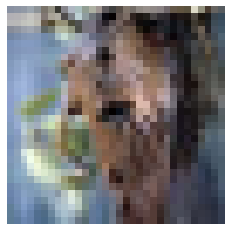

0


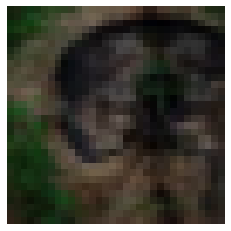

0


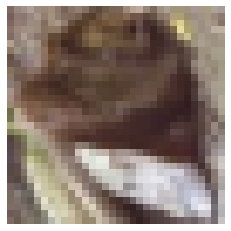

0


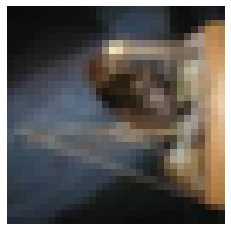

0


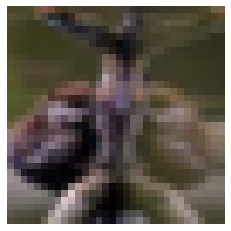

0


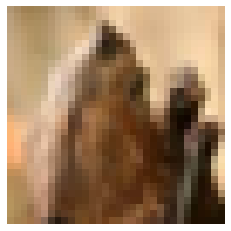

0


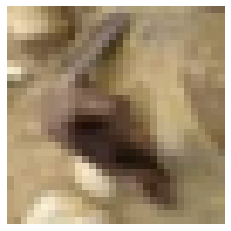

0


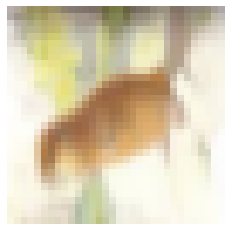

0


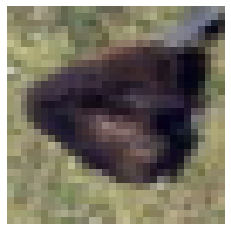

0


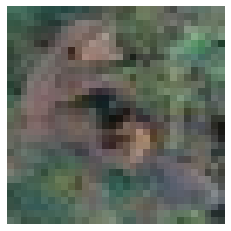

0


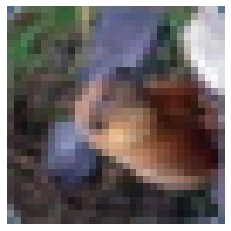

0


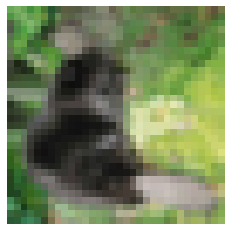

0


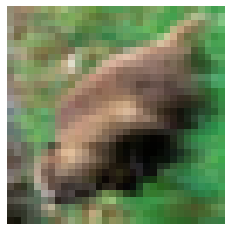

0


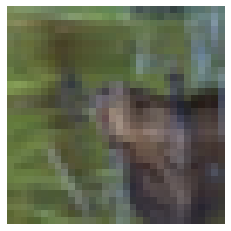

0


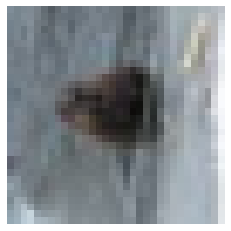

0


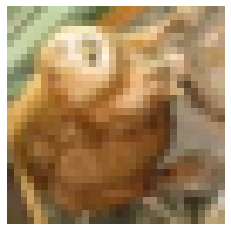

0


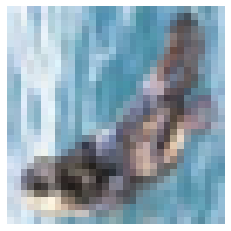

0


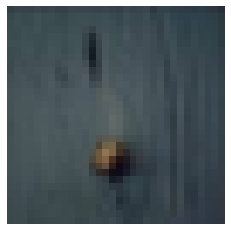

0


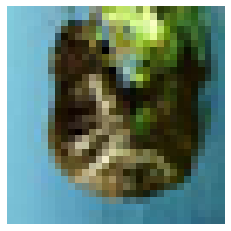

0


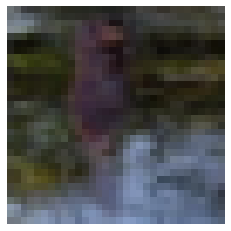

0


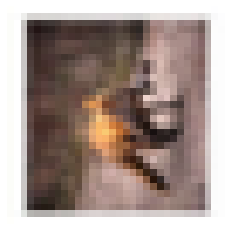

0


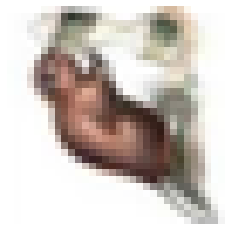

0


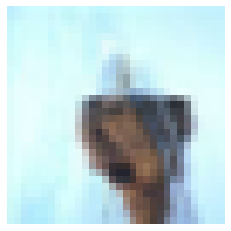

0


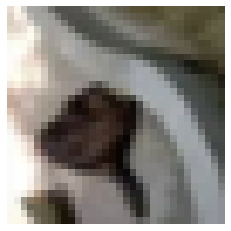

0


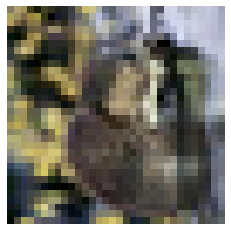

0


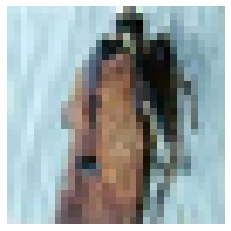

0


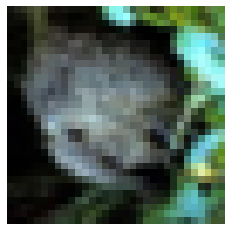

0


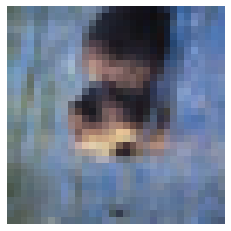

0


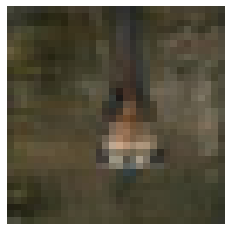

0


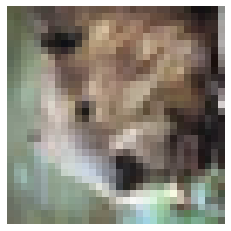

0


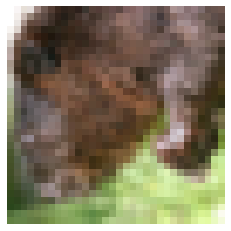

0


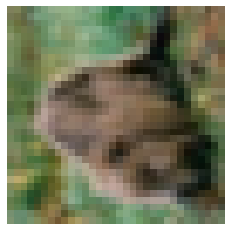

0


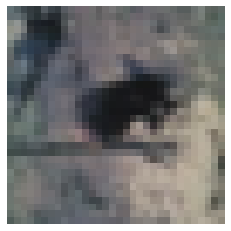

0


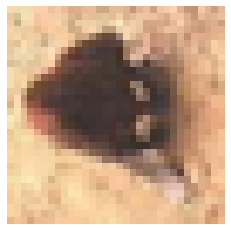

0


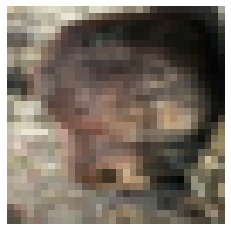

0


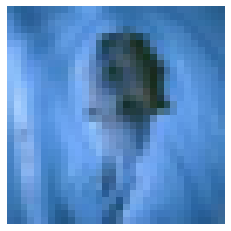

0


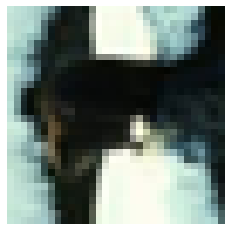

0


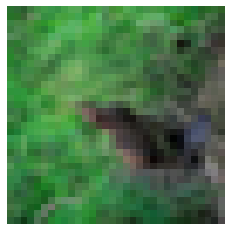

0


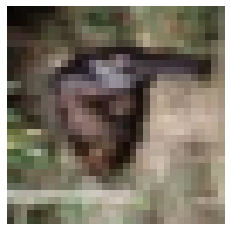

0


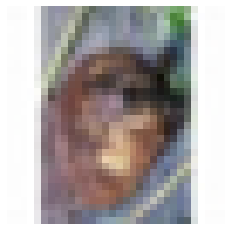

0


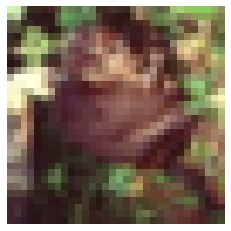

0


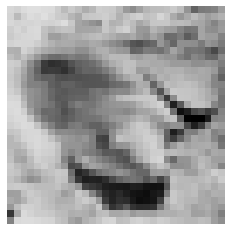

0


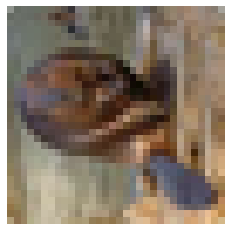

0


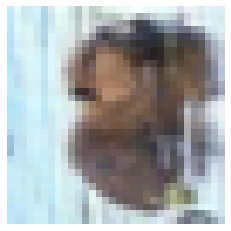

0


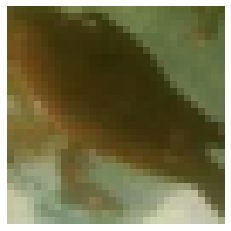

0


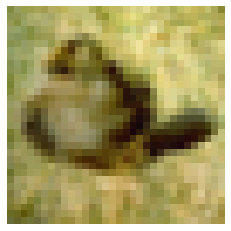

0


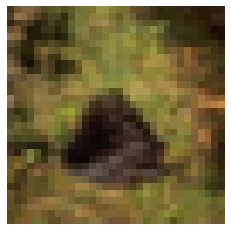

0


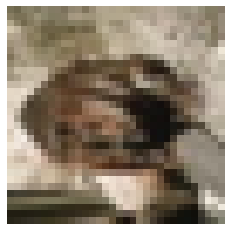

0


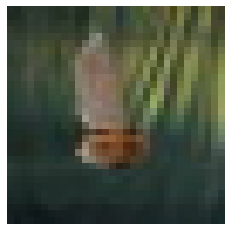

0


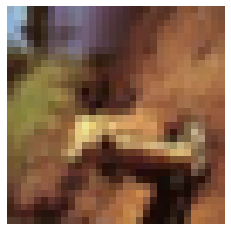

0


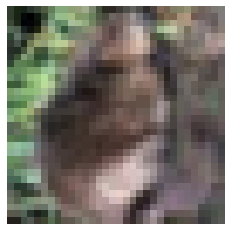

0


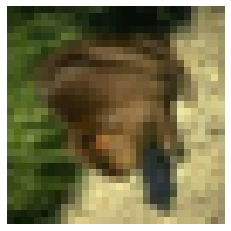

0


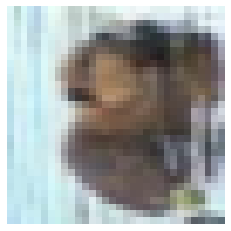

0


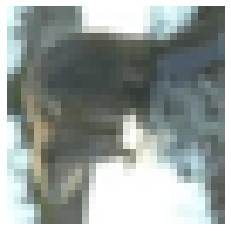

0


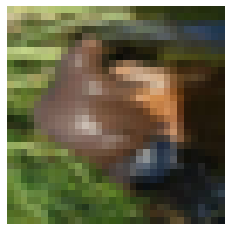

0


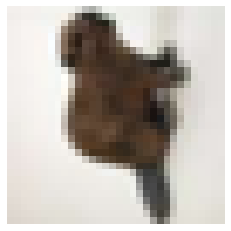

0


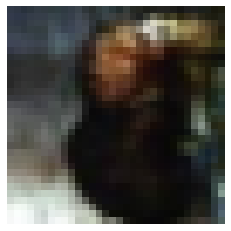

0


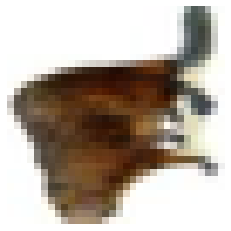

0


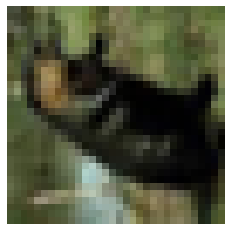

0


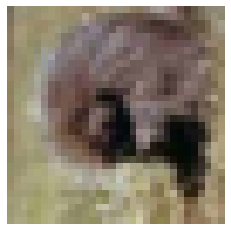

0


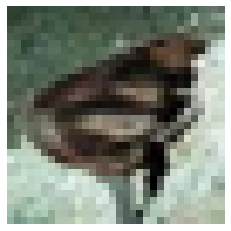

0


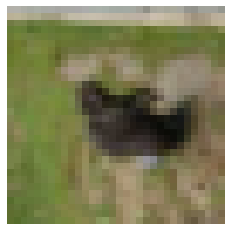

0


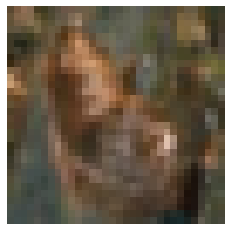

0


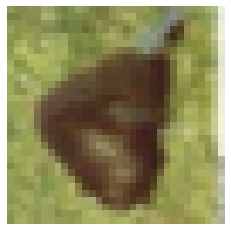

0


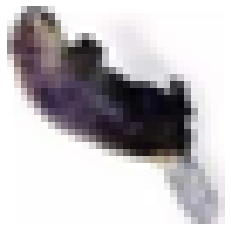

0


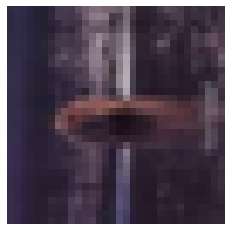

0


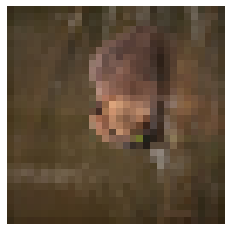

0


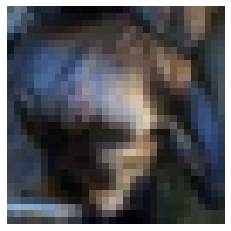

0


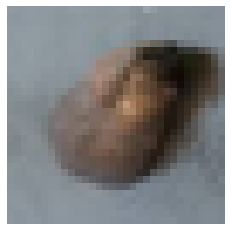

0


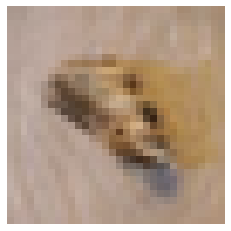

0


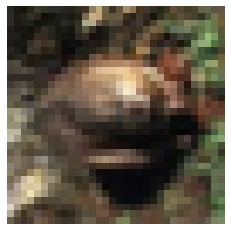

0


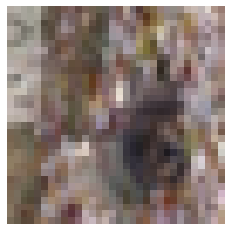

0


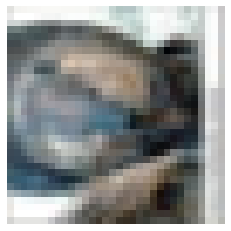

0


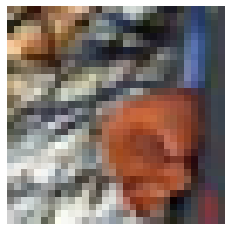

0


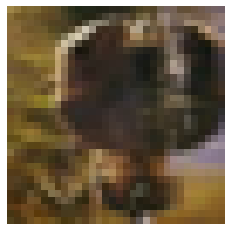

0


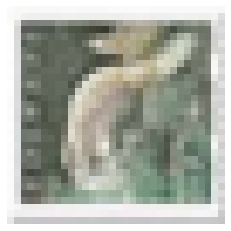

0


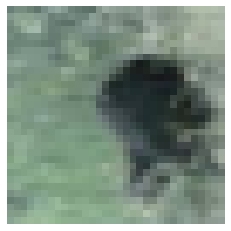

0


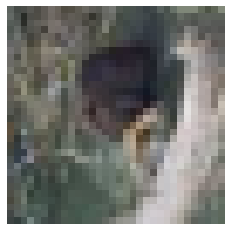

0


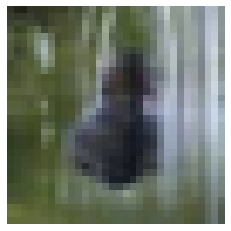

0


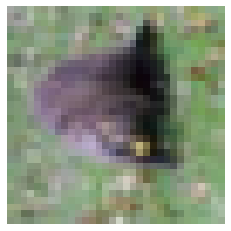

0


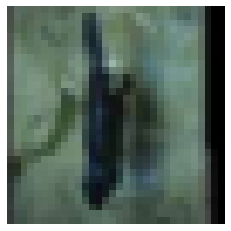

0


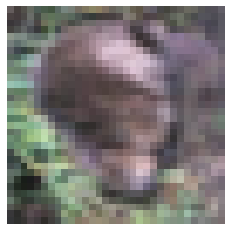

0


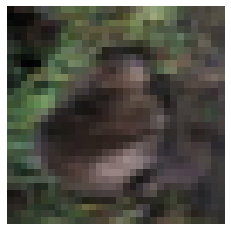

0


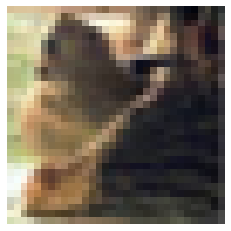

0


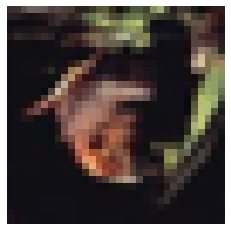

0


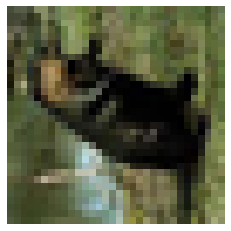

0


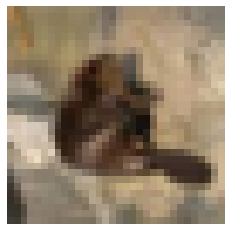

0


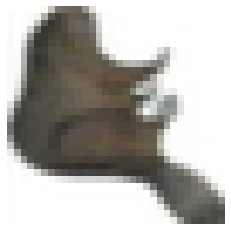

0


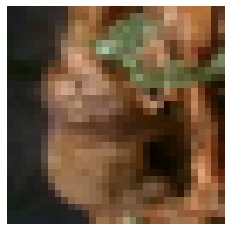

0


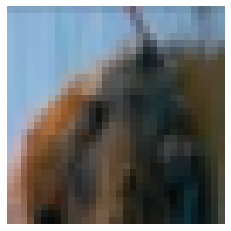

0


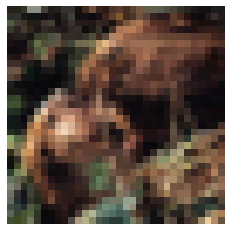

0


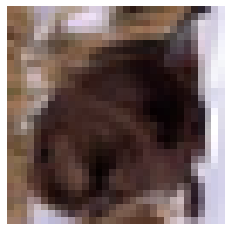

0


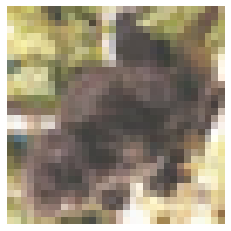

0


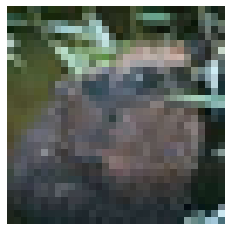

0


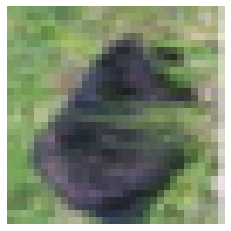

0


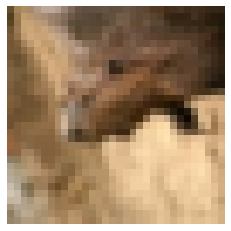

0


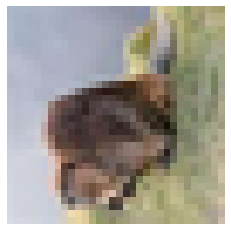

0


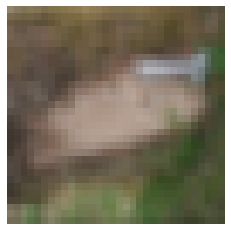

0


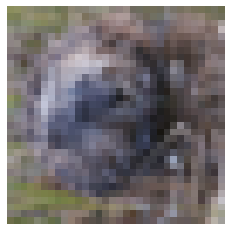

0


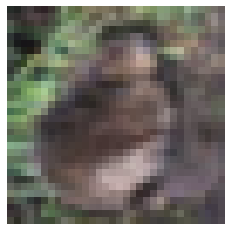

0


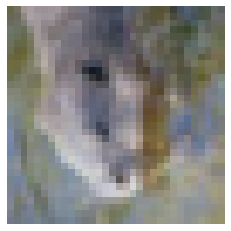

0


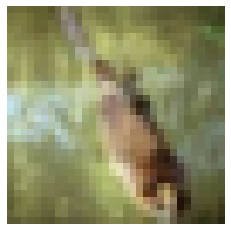

0


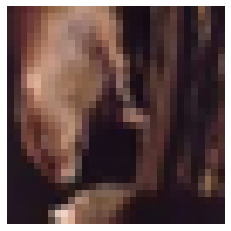

0


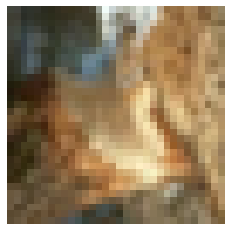

0


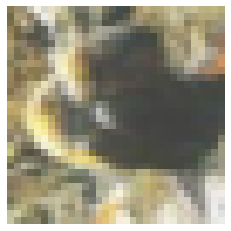

0


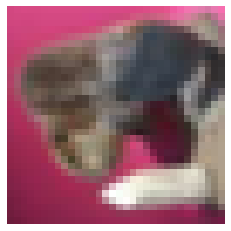

0


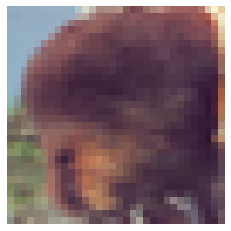

0


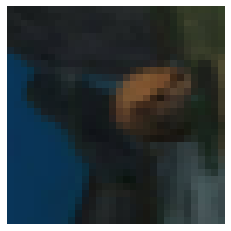

0


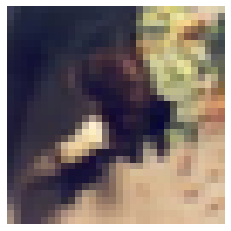

0


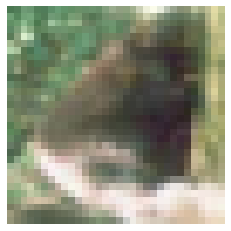

0


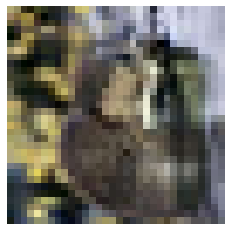

0


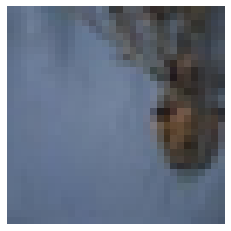

0


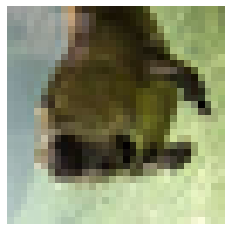

0


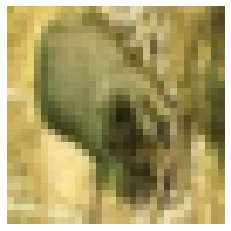

0


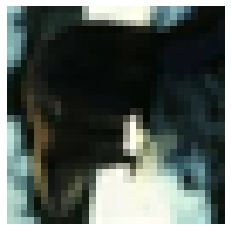

0


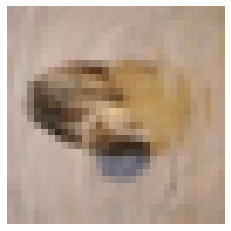

0


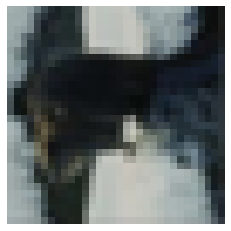

0


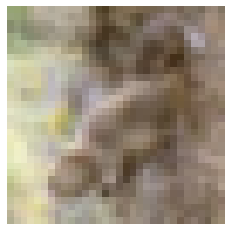

0


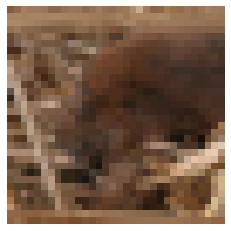

0


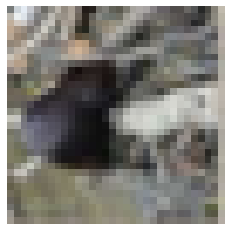

0


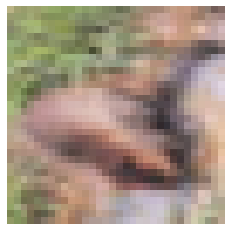

0


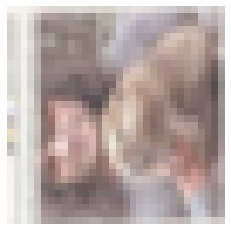

0


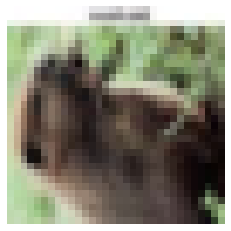

0


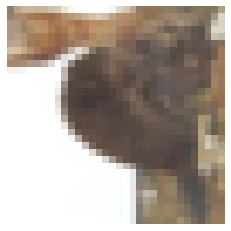

0


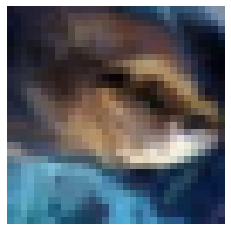

0


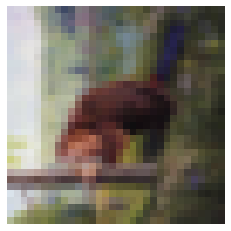

0


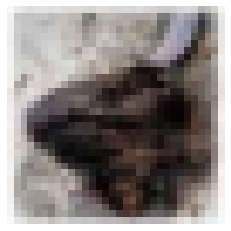

0


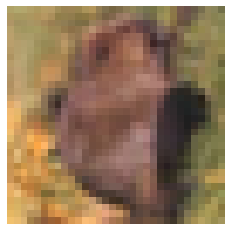

0


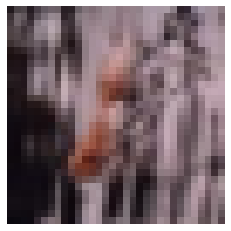

0


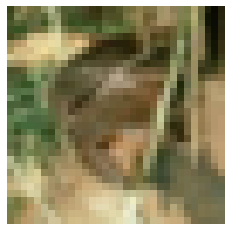

0


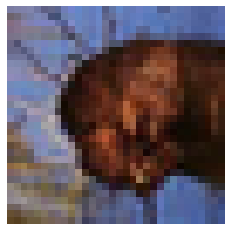

0


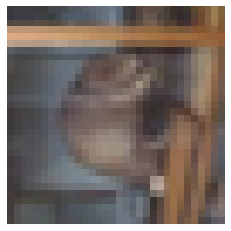

0


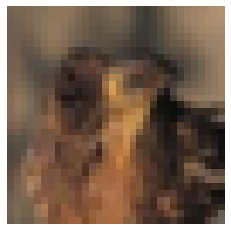

0


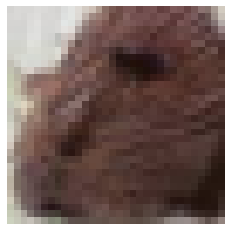

0


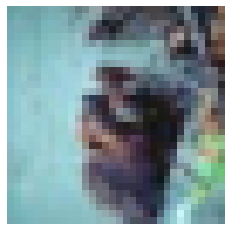

0


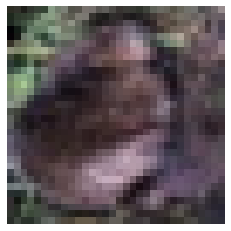

0


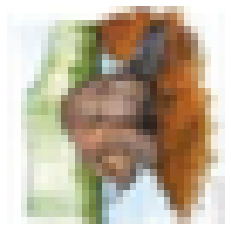

0


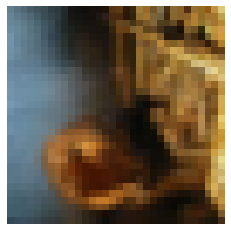

0


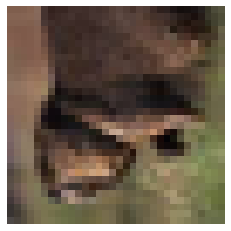

0


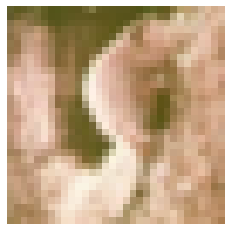

0


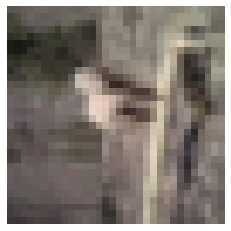

0


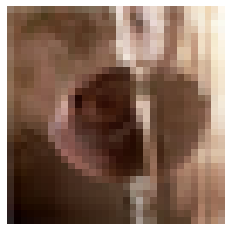

0


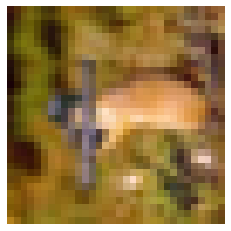

0


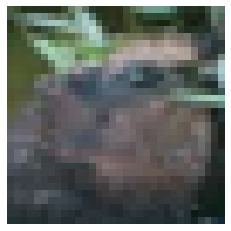

0


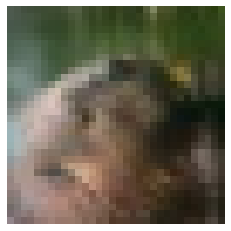

0


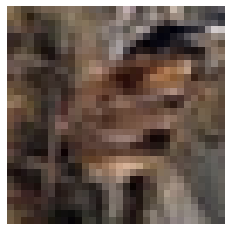

0


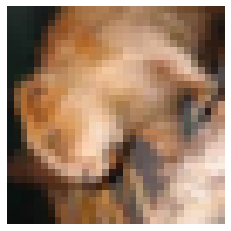

0


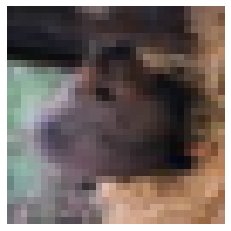

0


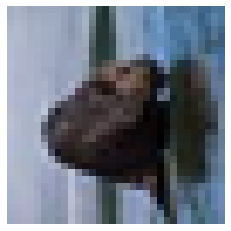

0


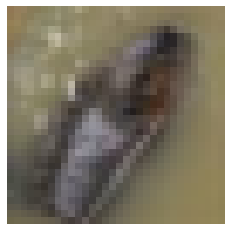

0


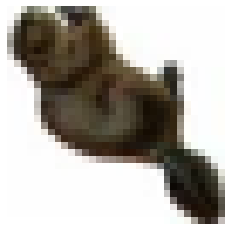

0


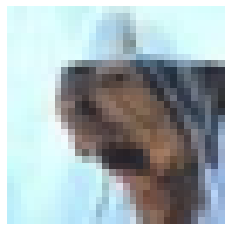

0


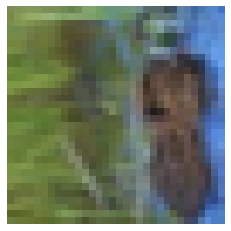

0


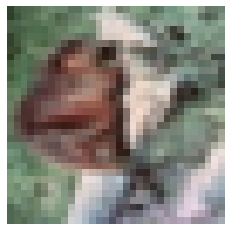

0


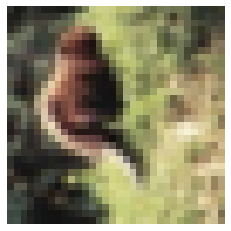

0


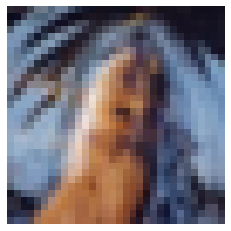

0


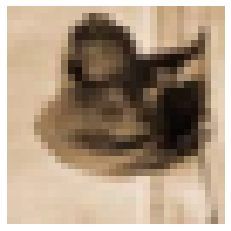

0


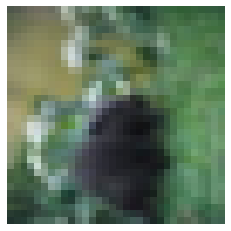

0


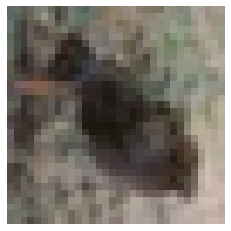

0


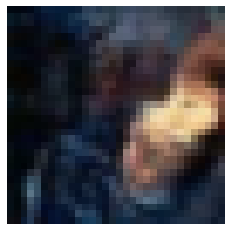

0


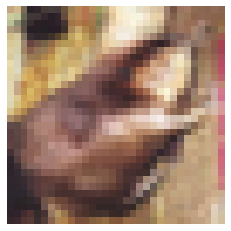

0


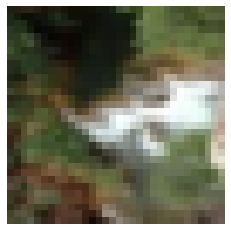

0


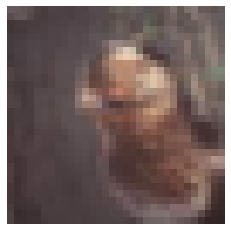

0


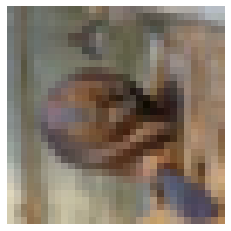

0


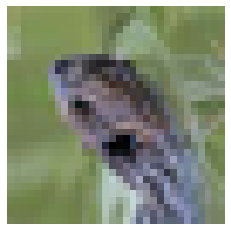

0


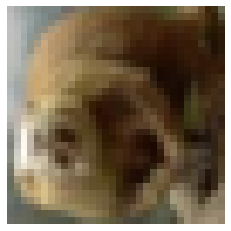

0


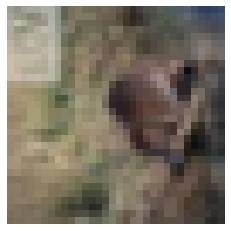

0


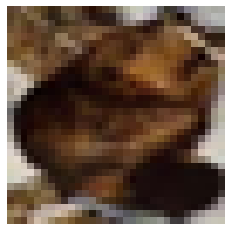

0


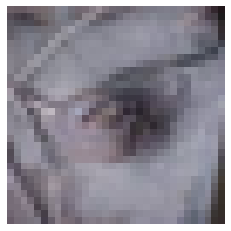

0


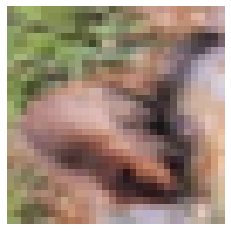

0


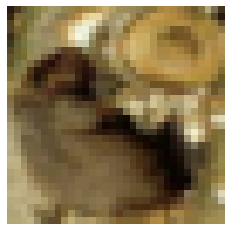

0


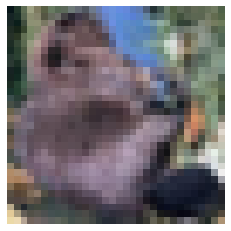

0


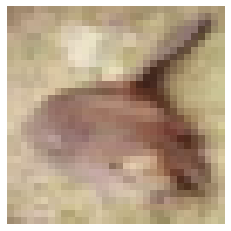

0


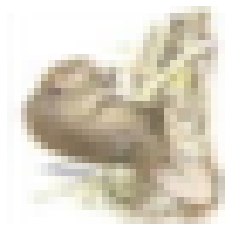

0


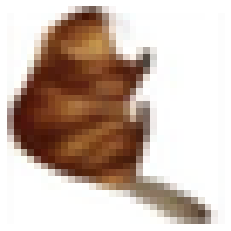

0


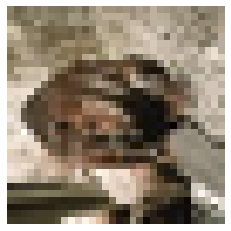

0


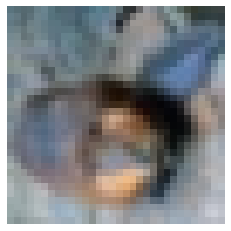

0


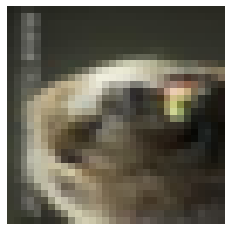

0


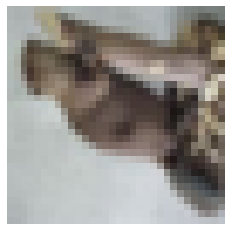

0


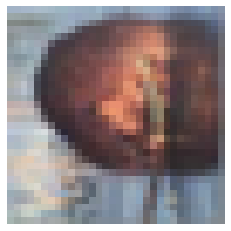

0


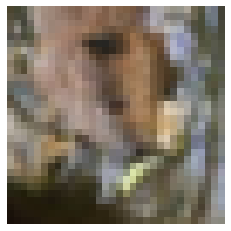

0


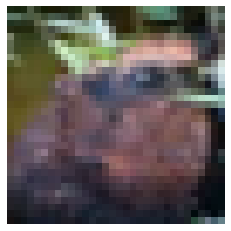

0


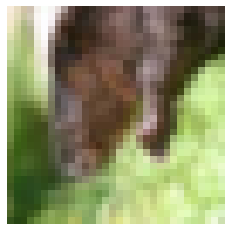

0


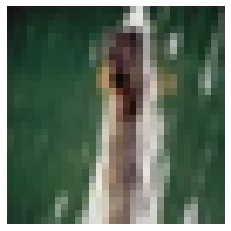

0


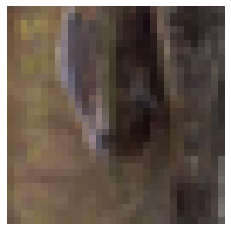

0


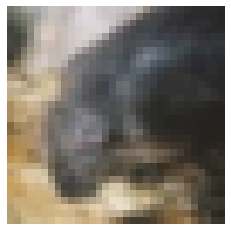

0


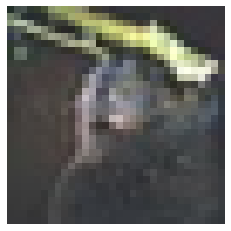

0


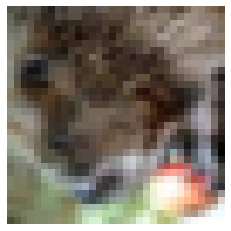

0


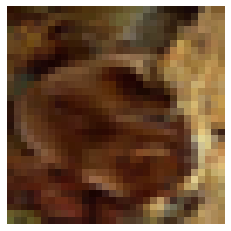

0


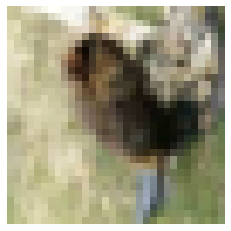

0


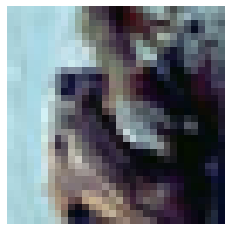

0


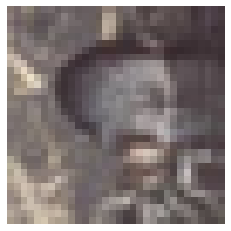

0


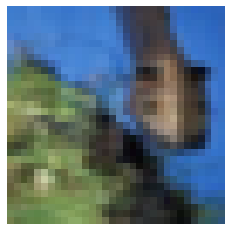

0


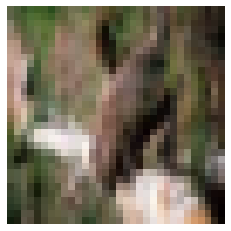

0


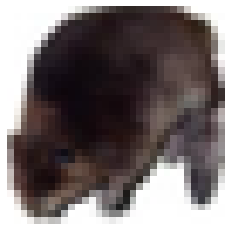

0


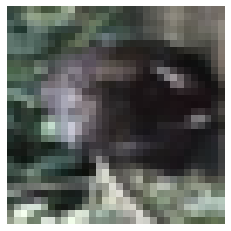

0


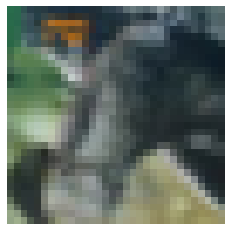

0


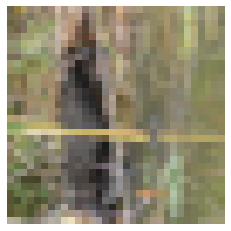

0


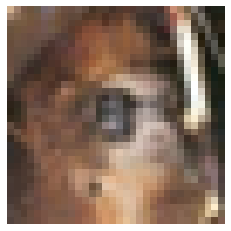

0


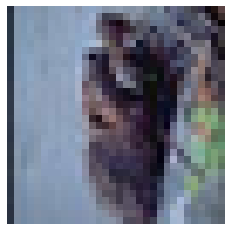

0


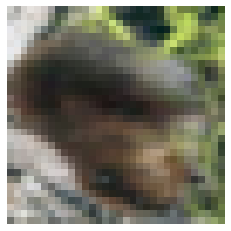

0


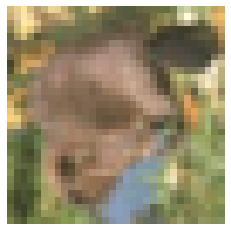

0


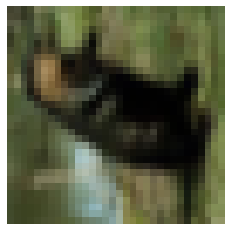

0


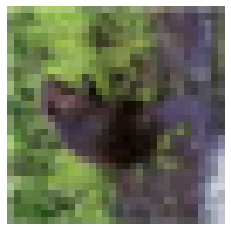

0


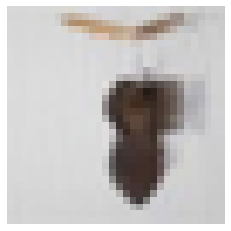

0


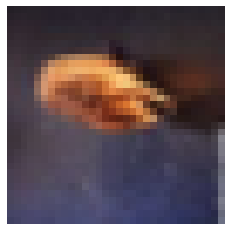

0


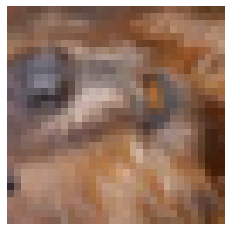

0


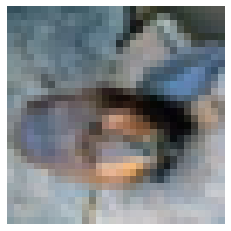

0


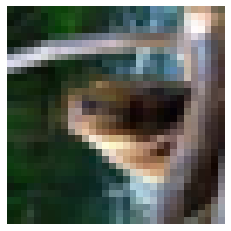

0


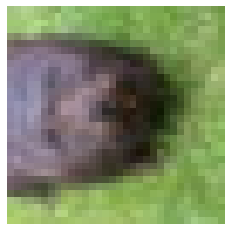

0


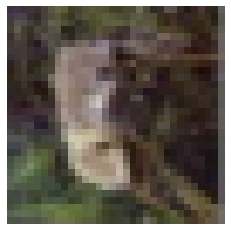

0


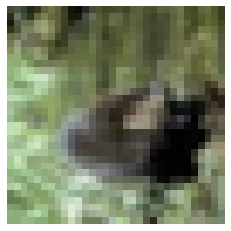

0


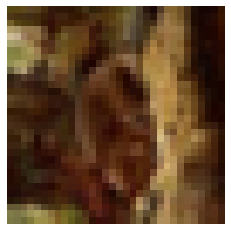

0


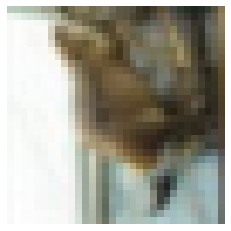

0


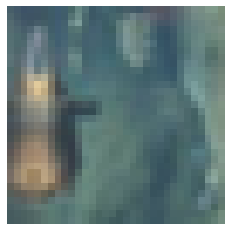

0


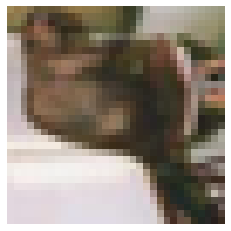

0


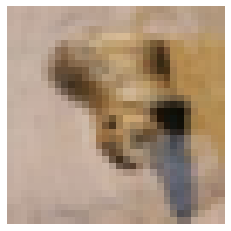

0


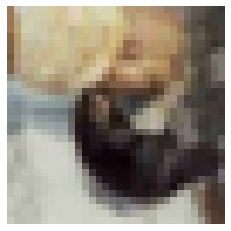

0


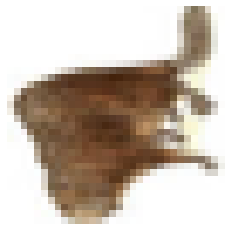

0


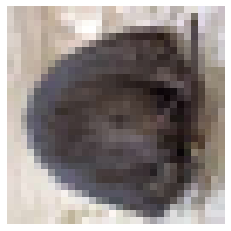

0


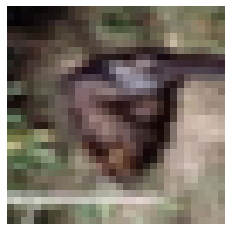

0


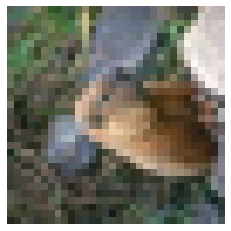

0


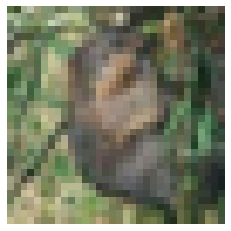

0


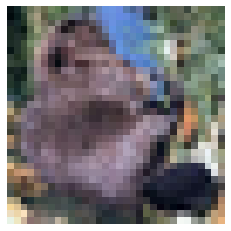

0


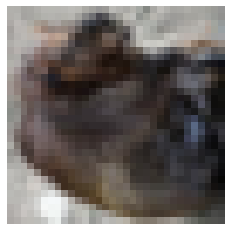

0


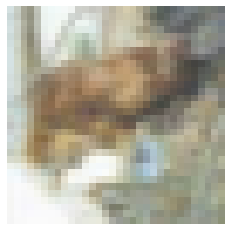

0


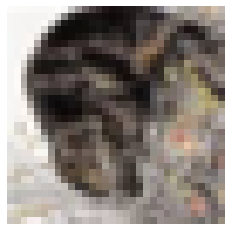

0


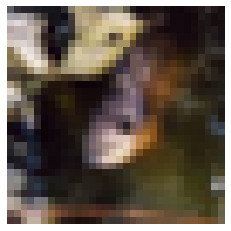

0


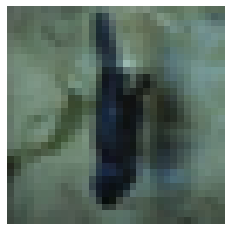

0


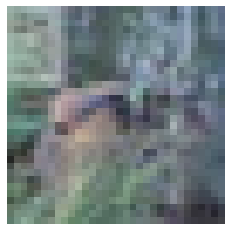

0


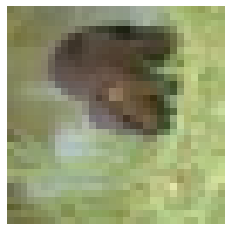

0


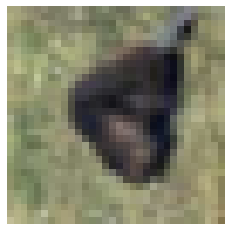

0


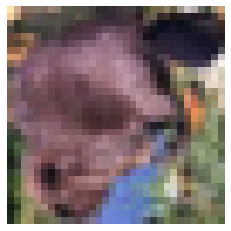

0


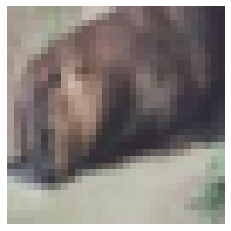

0


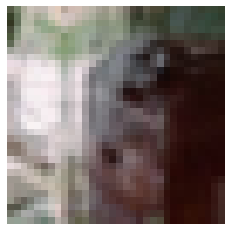

0


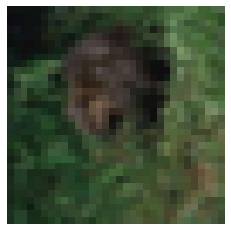

0


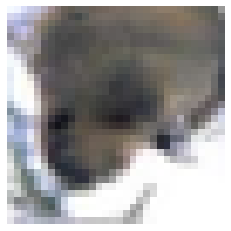

0


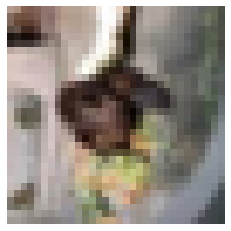

0


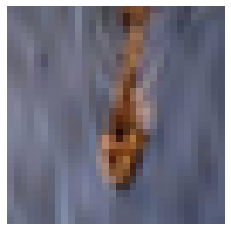

0


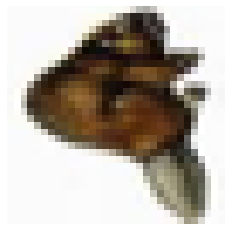

0


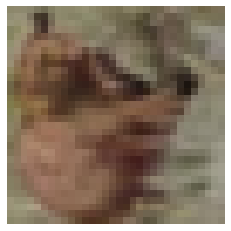

0


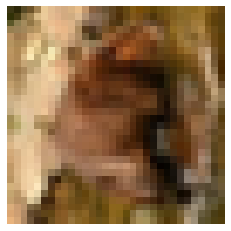

0


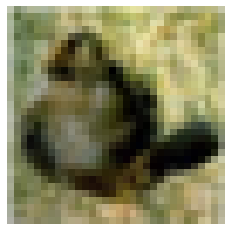

0


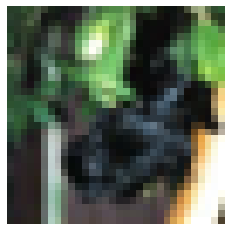

0


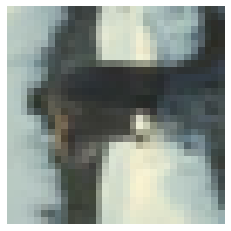

0


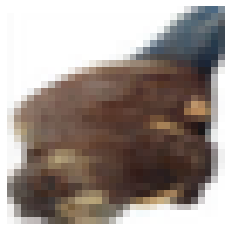

0


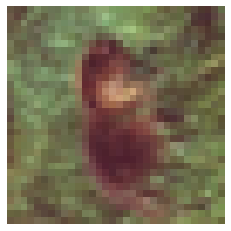

0


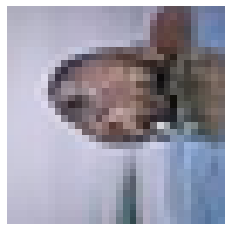

0


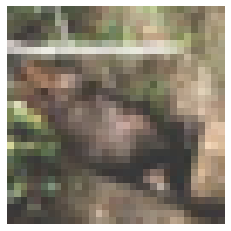

0


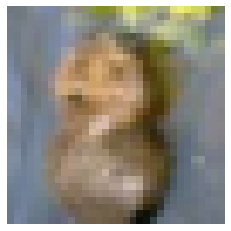

0


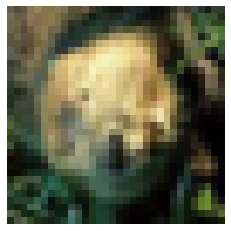

0


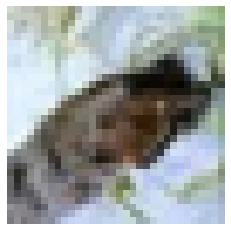

0


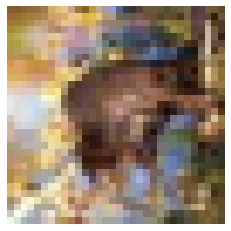

0


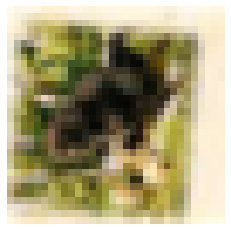

0


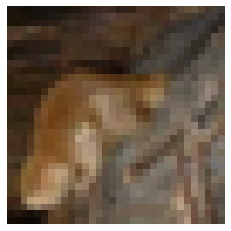

0


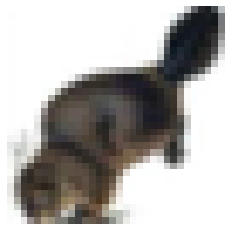

0


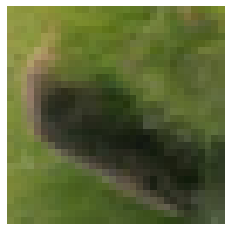

0


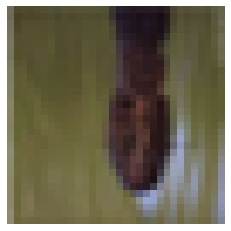

0


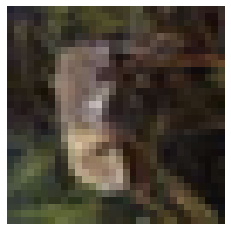

0


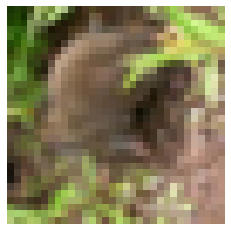

0


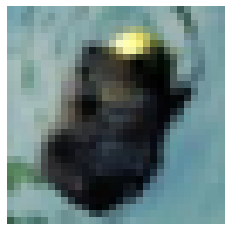

0


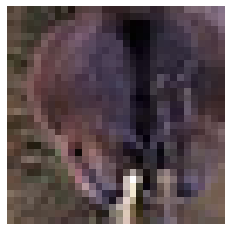

0


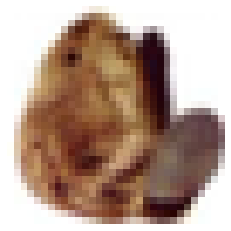

0


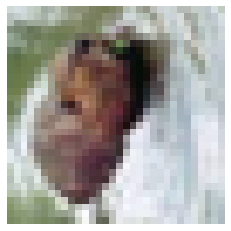

0


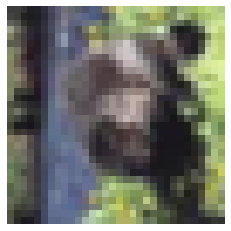

0


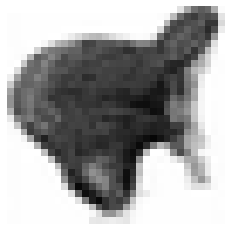

0


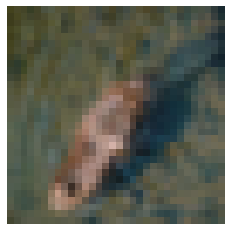

0


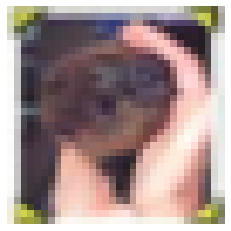

0


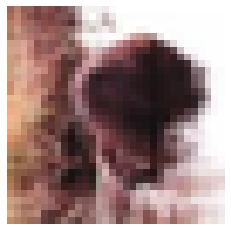

0


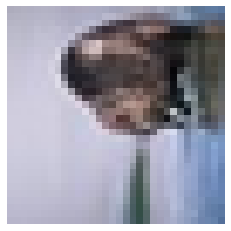

0


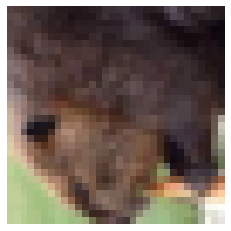

0


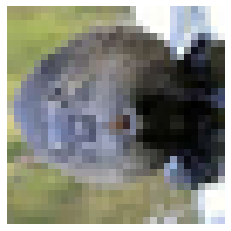

0


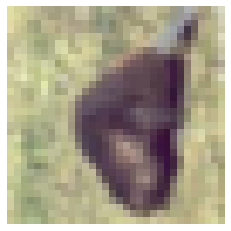

0


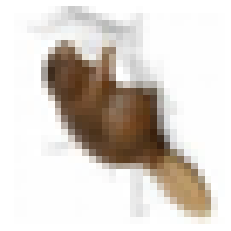

0


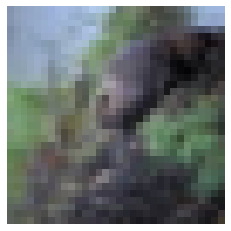

0


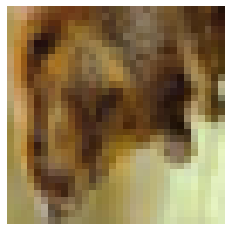

0


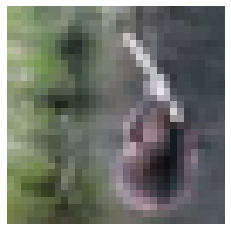

0


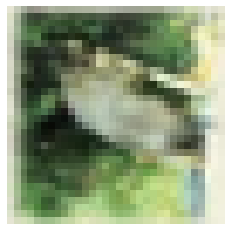

0


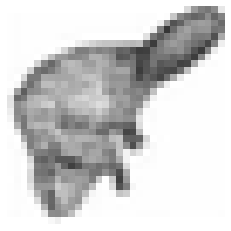

0


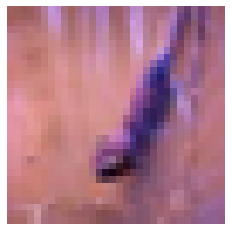

0


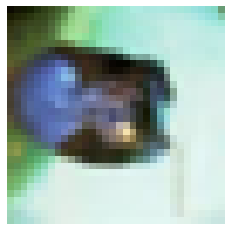

0


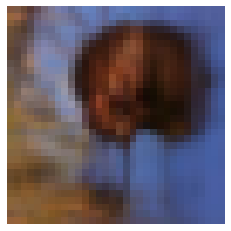

0


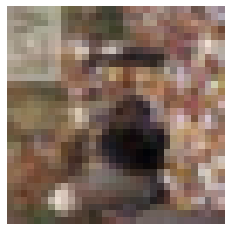

0


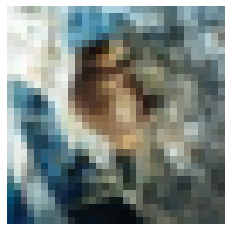

0


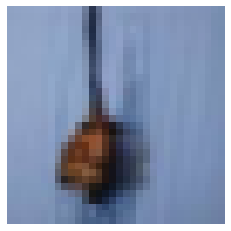

0


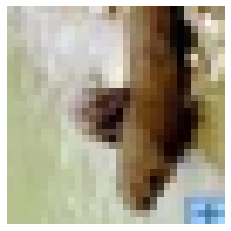

0


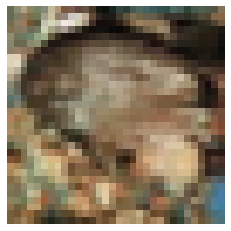

0


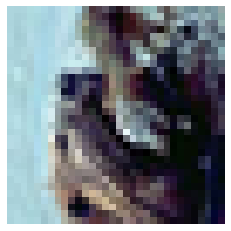

0


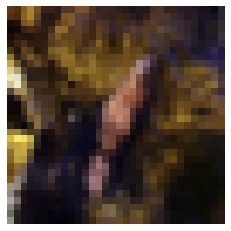

0


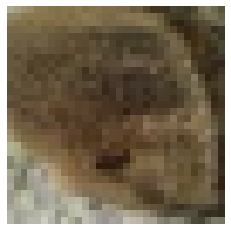

0


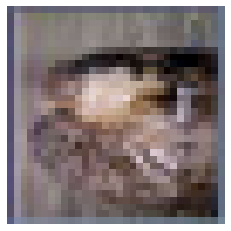

0


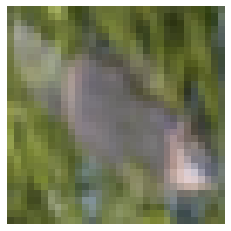

0


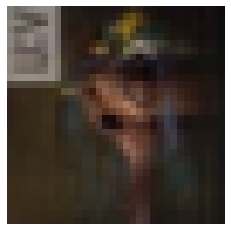

0


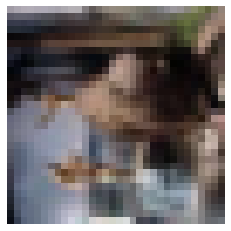

0


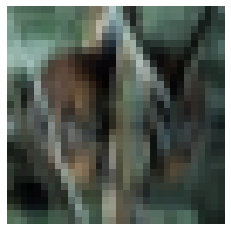

0


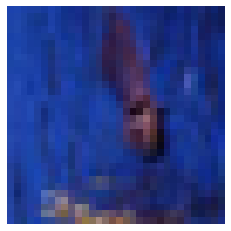

0


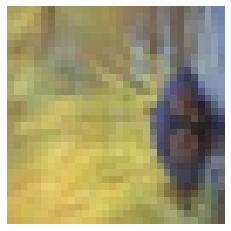

0


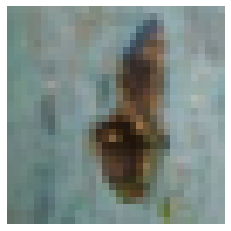

0


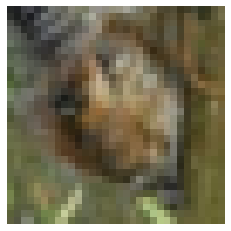

0


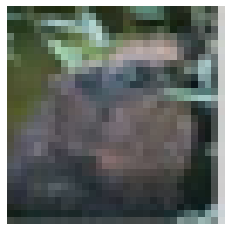

0


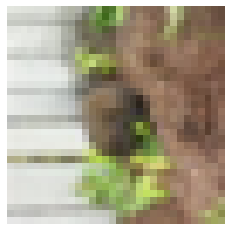

0


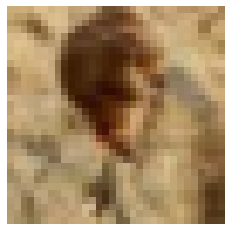

0


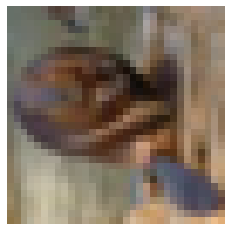

0


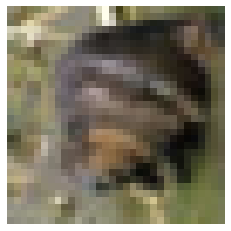

0


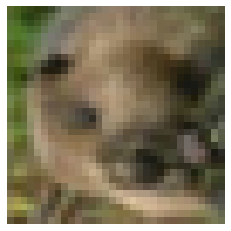

0


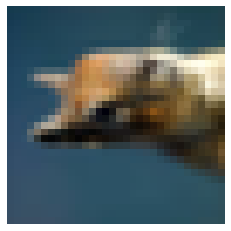

0


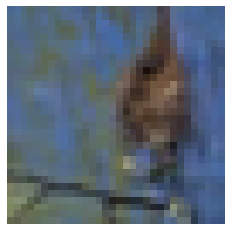

0


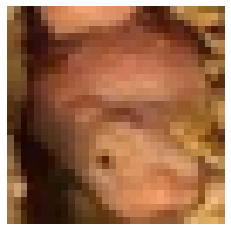

0


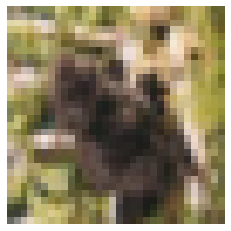

0


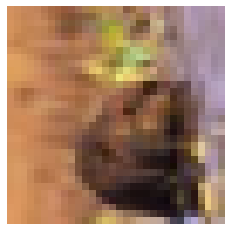

0


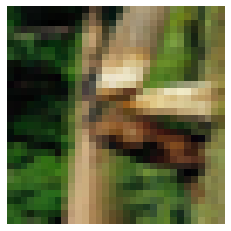

0


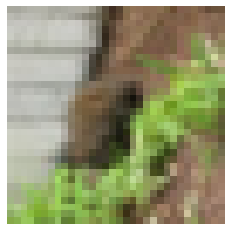

0


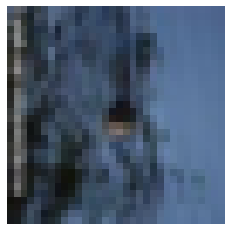

0


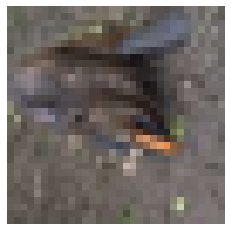

0


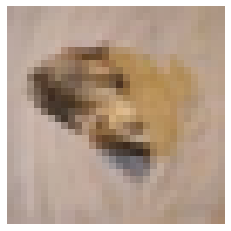

0


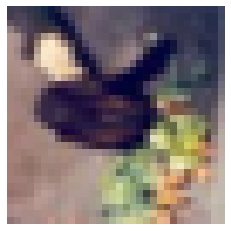

0


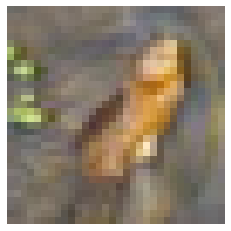

0


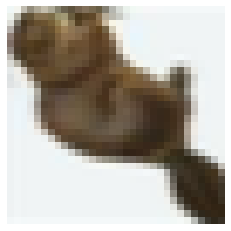

0


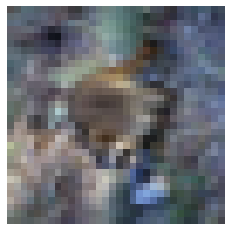

0


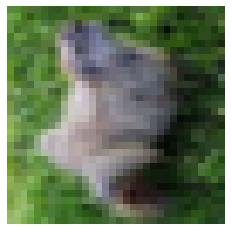

0


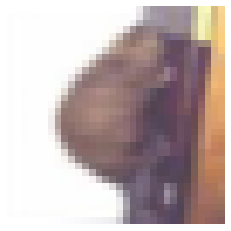

0


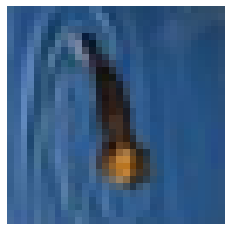

0


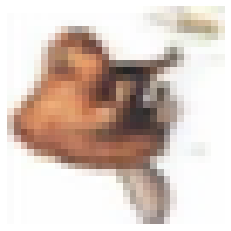

0


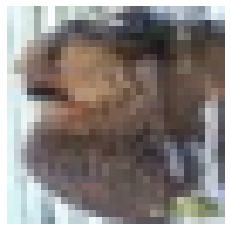

0


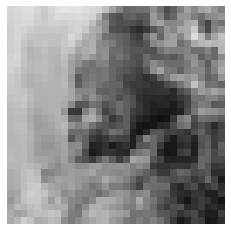

0


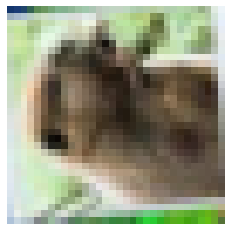

0


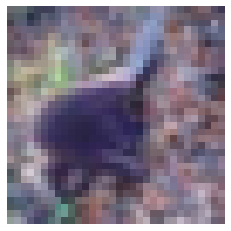

0


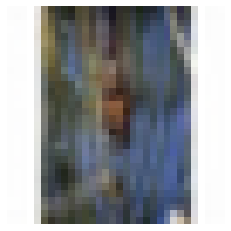

0


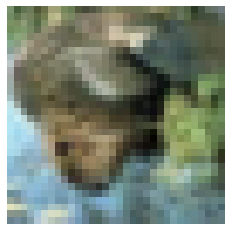

0


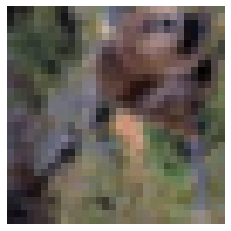

0


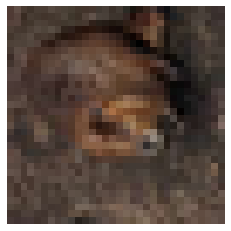

0


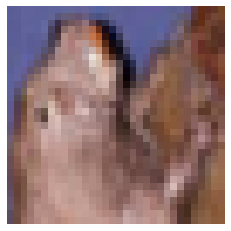

0


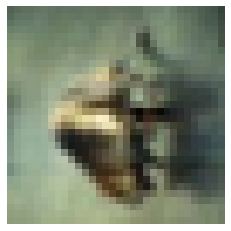

0


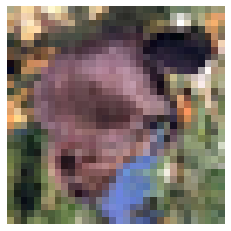

0


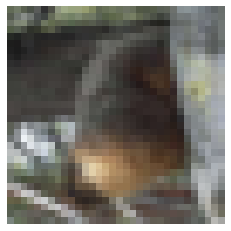

0


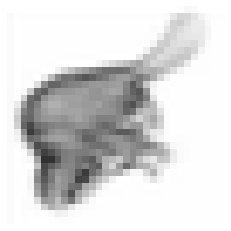

0


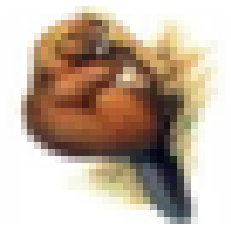

0


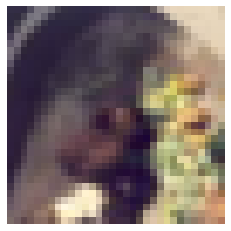

0


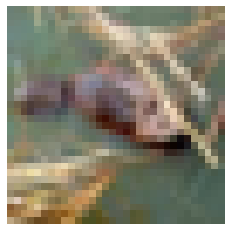

0


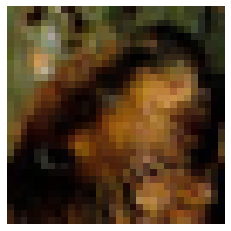

0


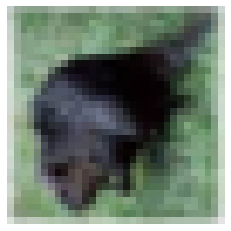

0


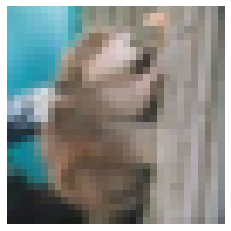

0


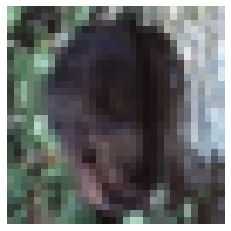

0


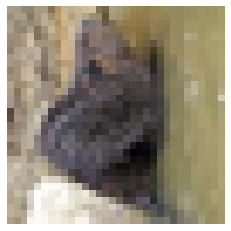

0


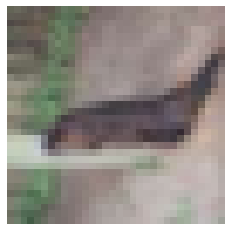

0


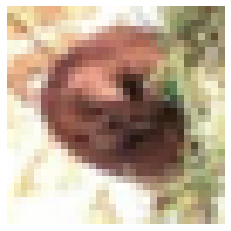

0


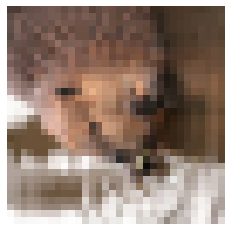

0


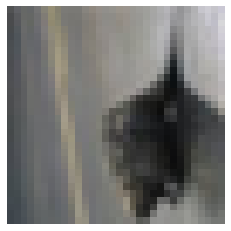

0


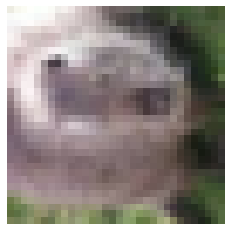

0


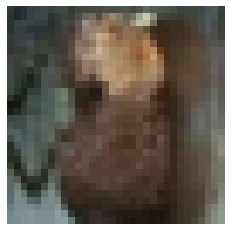

0


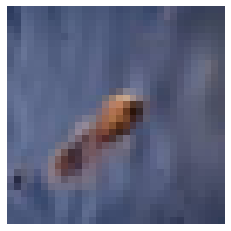

0


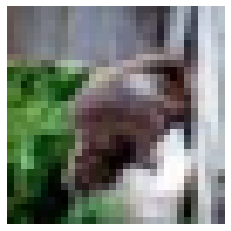

0


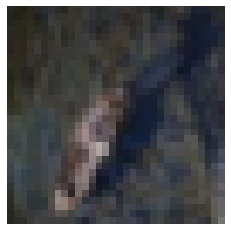

0


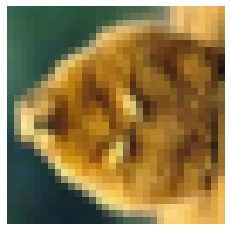

0


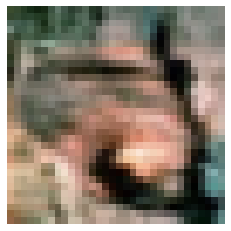

0


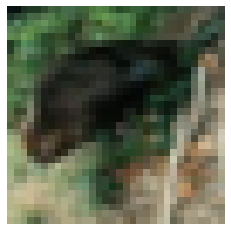

0


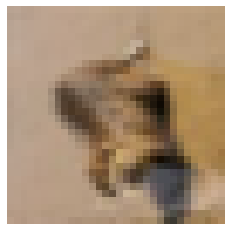

0


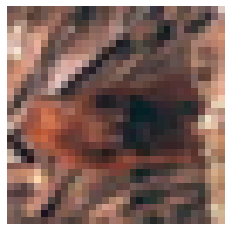

0


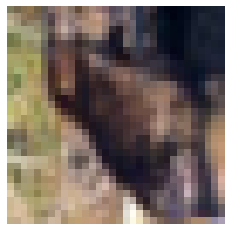

0


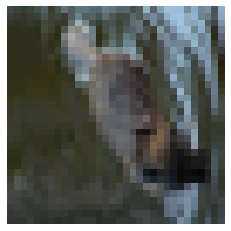

0


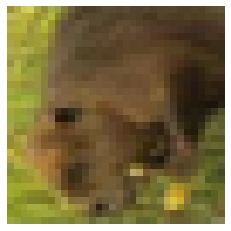

0


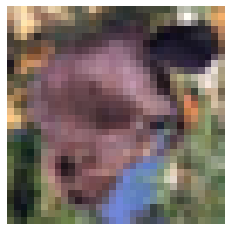

0


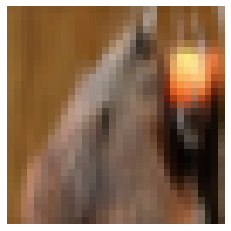

0


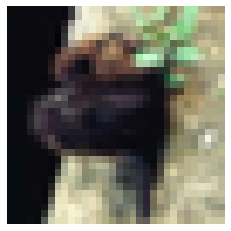

0


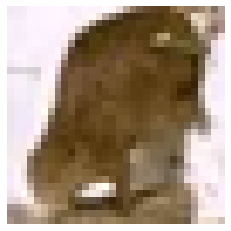

0


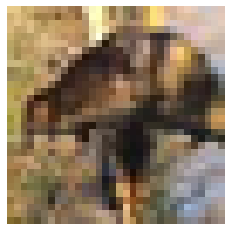

0


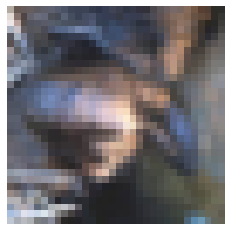

0


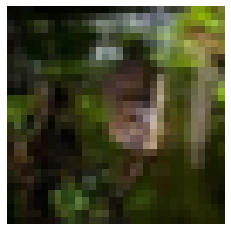

0


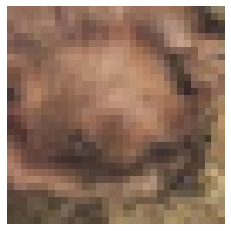

0


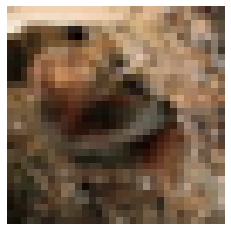

0


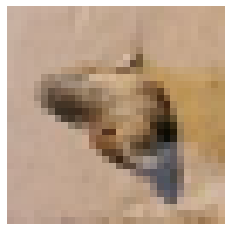

0


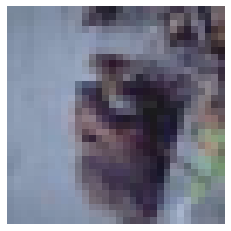

0


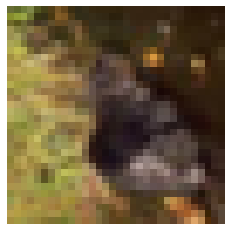

0


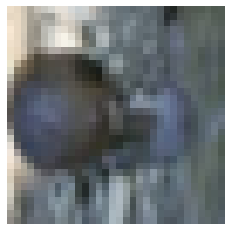

0


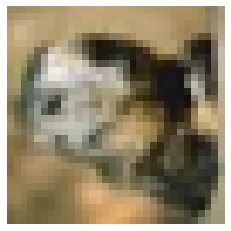

0


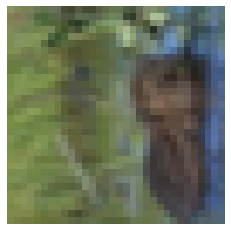

0


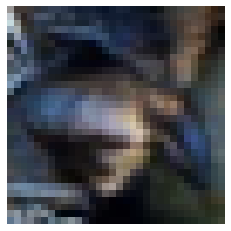

0


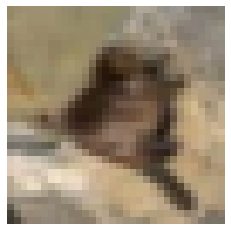

0


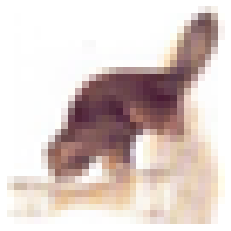

0


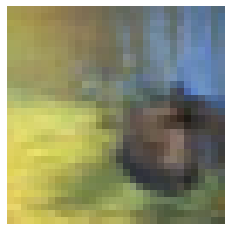

0


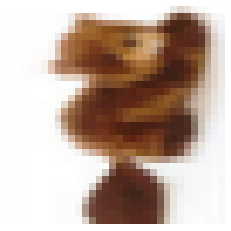

0


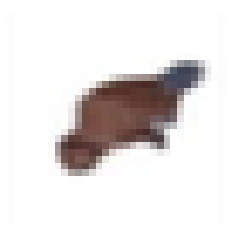

0


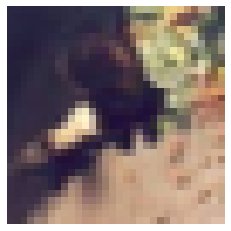

0


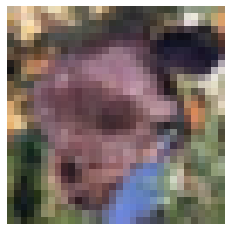

0


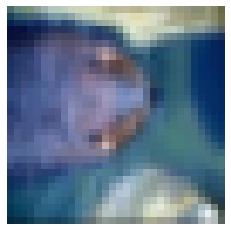

0


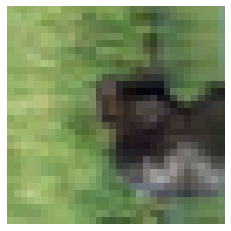

0


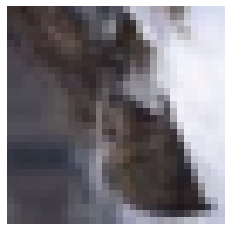

0


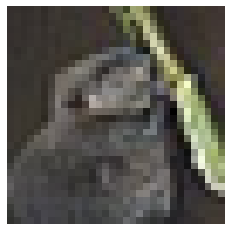

0


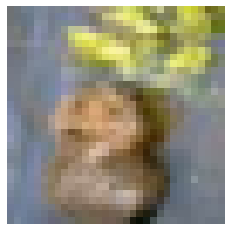

0


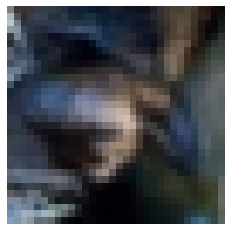

0


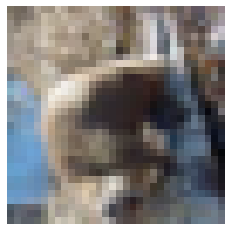

0


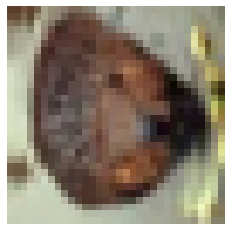

0


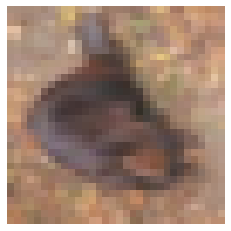

0


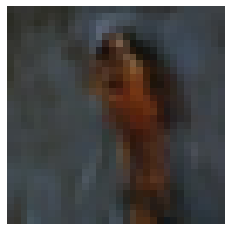

0


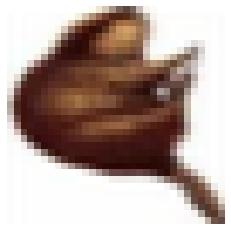

0


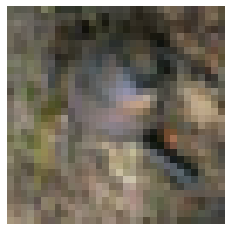

0


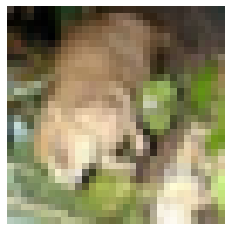

0


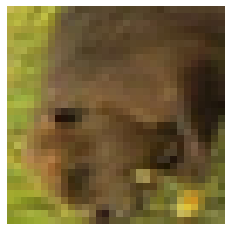

0


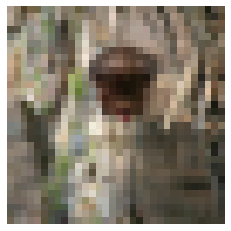

0


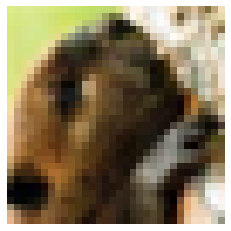

0


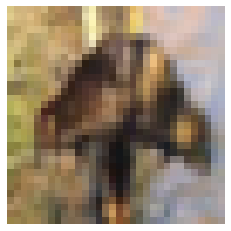

0


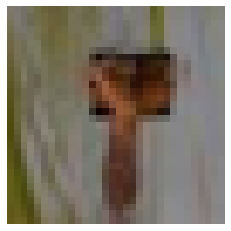

0


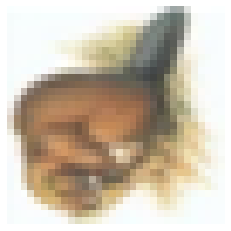

0


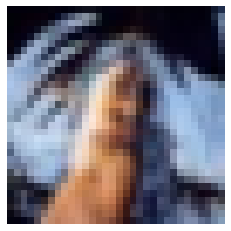

0


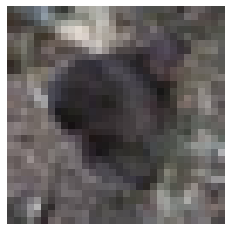

0


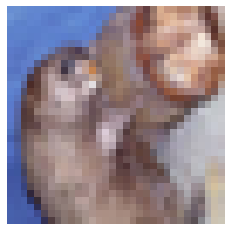

0


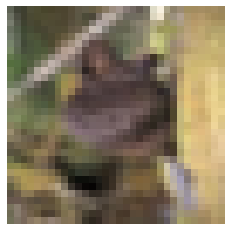

0


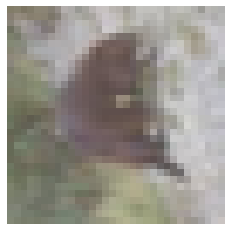

0


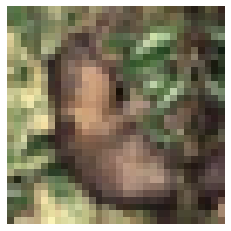

0


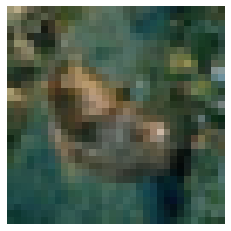

0


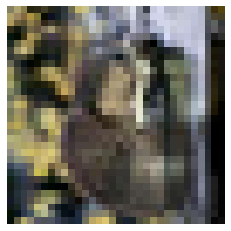

0


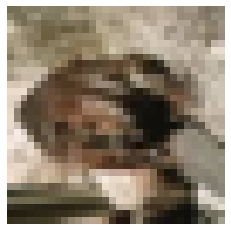

0


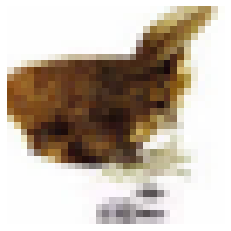

0


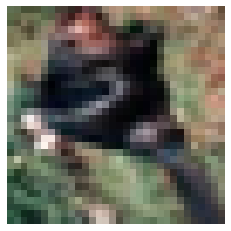

0


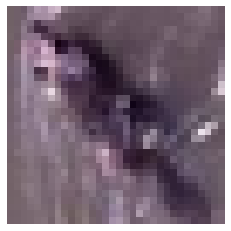

0


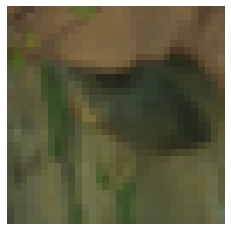

0


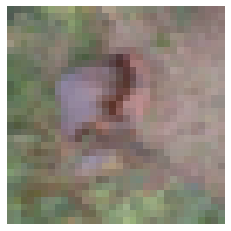

0


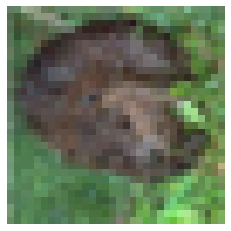

0


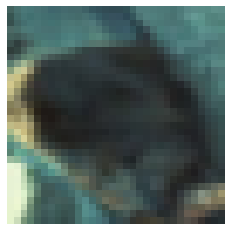

0


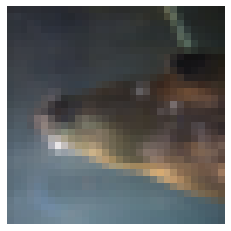

0


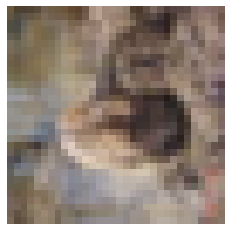

0


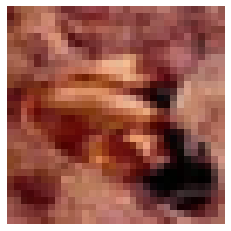

0


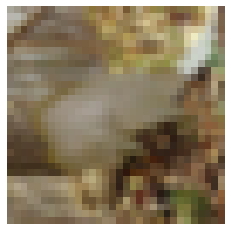

0


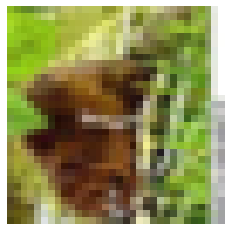

0


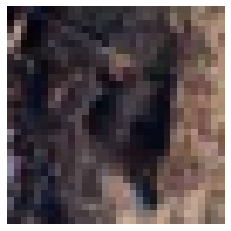

0


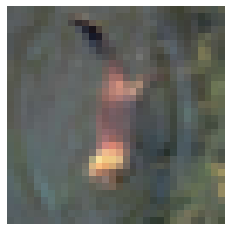

0


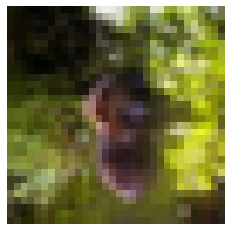

0


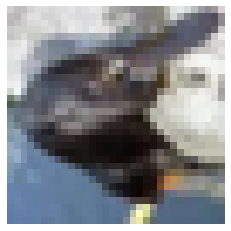

0


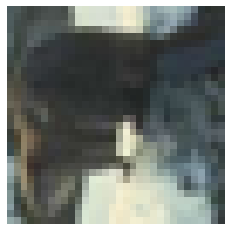

0


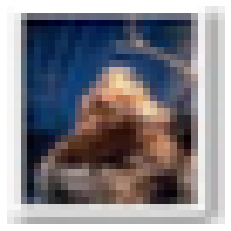

0


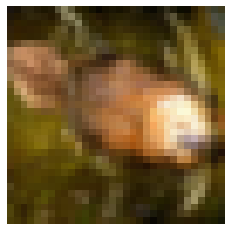

0


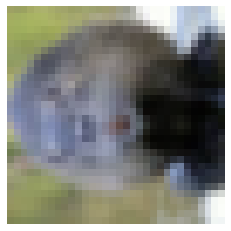

0


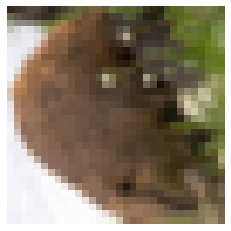

0


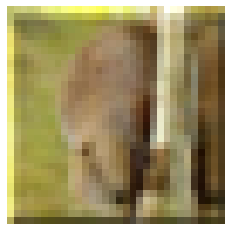

0


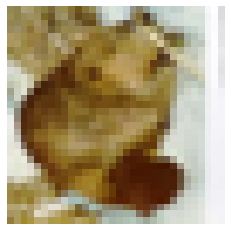

0


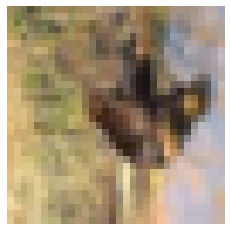

0


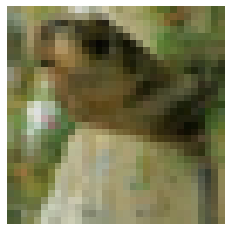

0


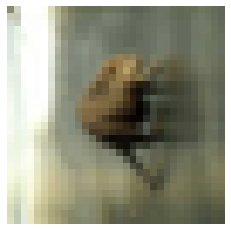

0


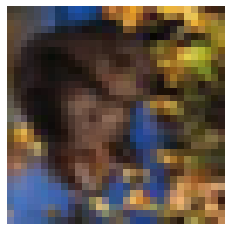

0


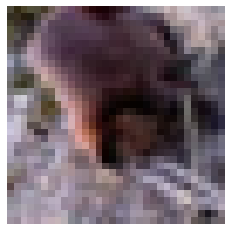

0


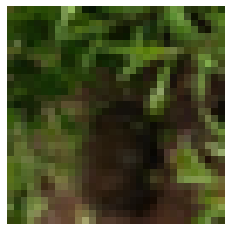

0


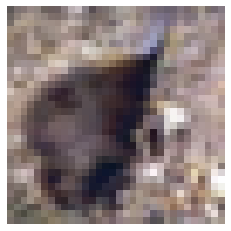

0


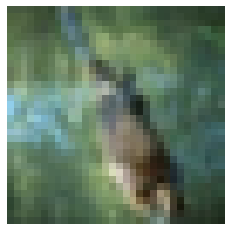

0


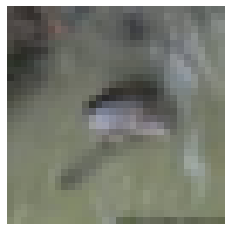

0


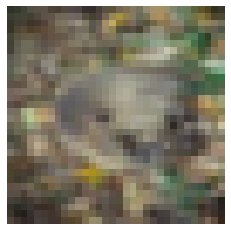

0


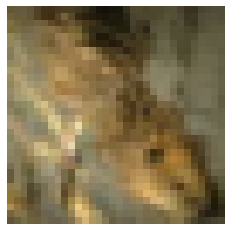

0


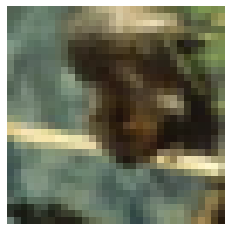

0


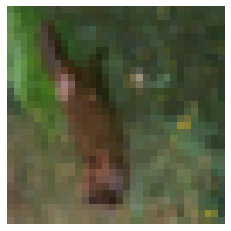

0


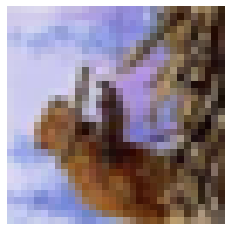

0


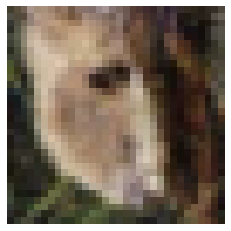

0


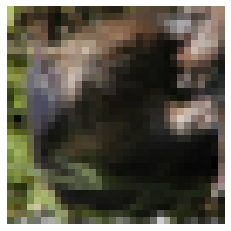

0


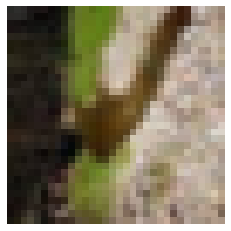

0


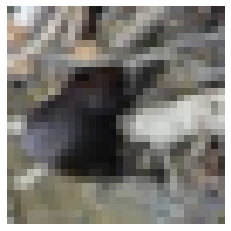

0


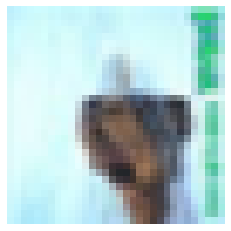

0


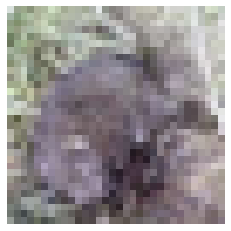

0


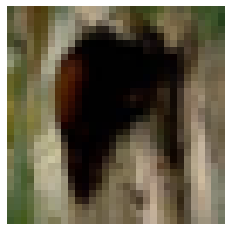

0


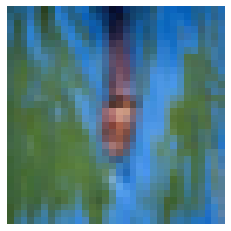

0


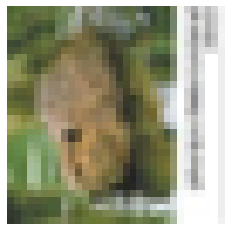

0


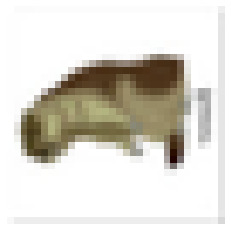

0


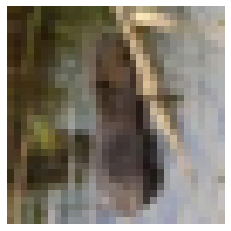

0


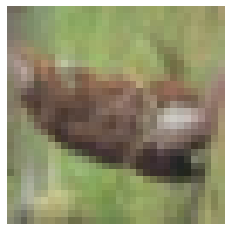

0


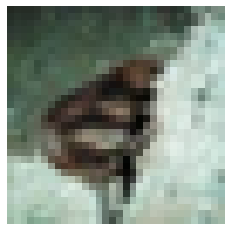

0


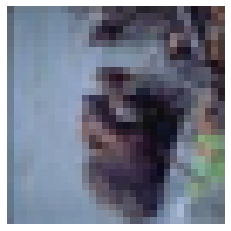

0


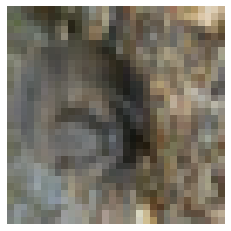

0


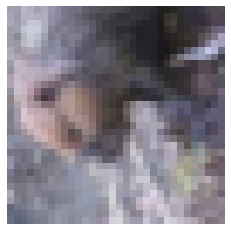

0


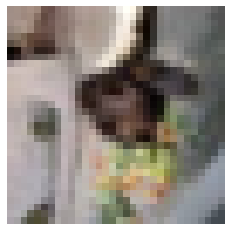

0


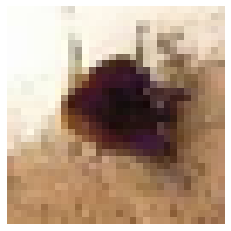

0


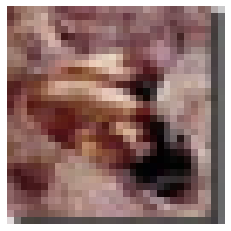

0


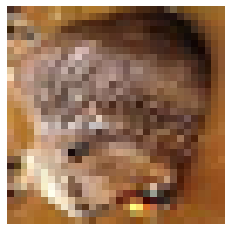

0


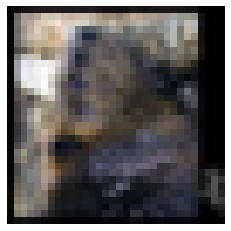

0


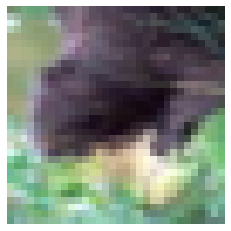

0


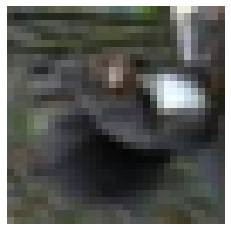

0


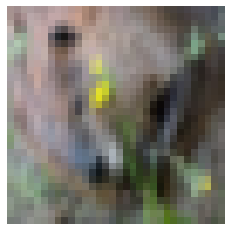

0


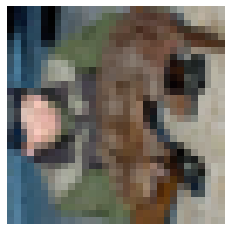

0


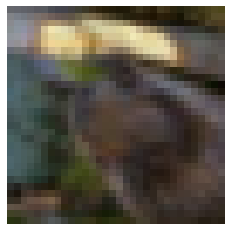

0


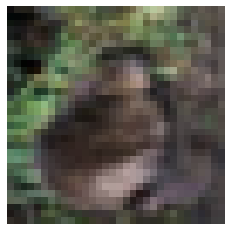

0


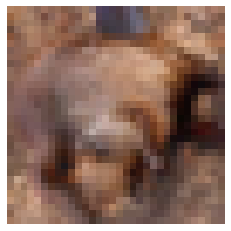

0


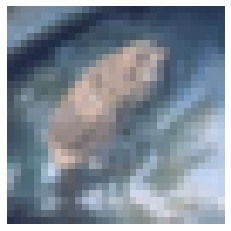

0


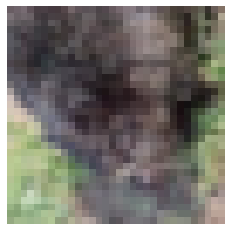

0


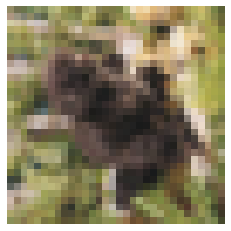

0


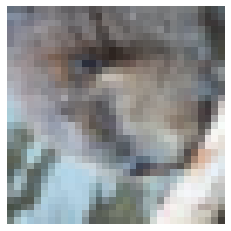

0


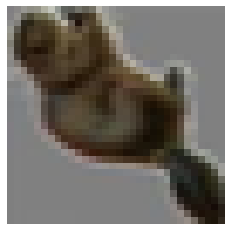

0


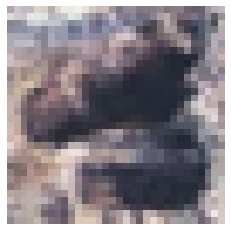

0


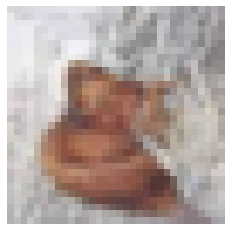

0


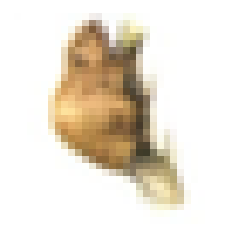

0


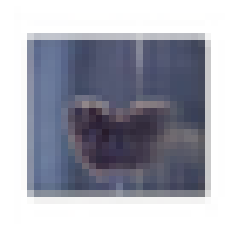

0


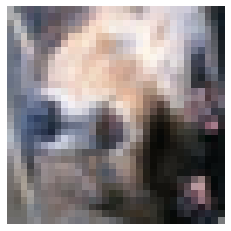

0


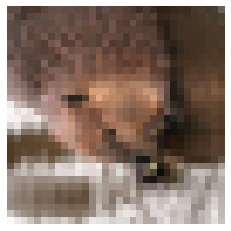

0


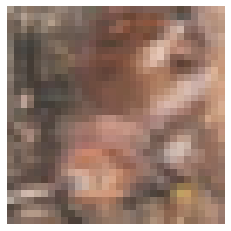

0


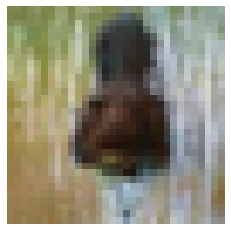

0


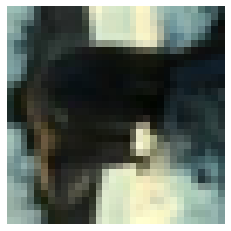

0


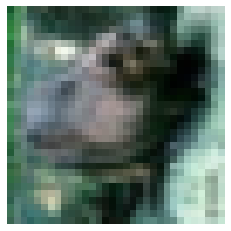

0


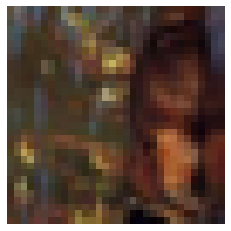

0


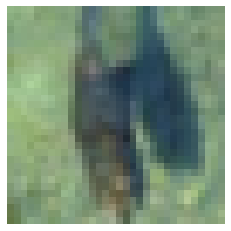

0


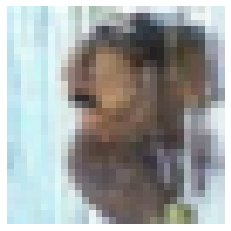

0


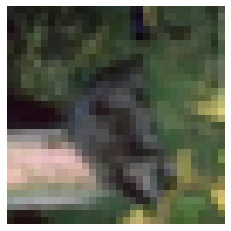

0


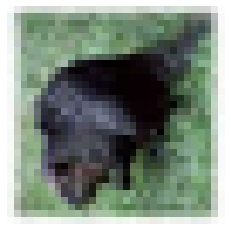

0


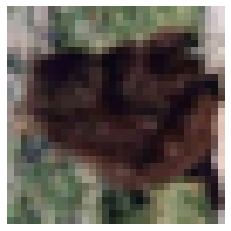

0


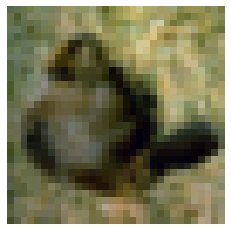

0


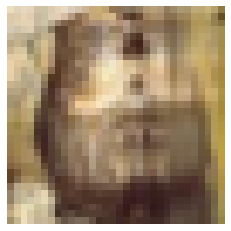

1


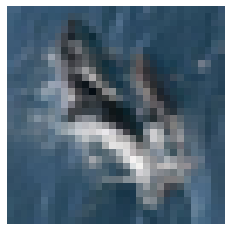

1


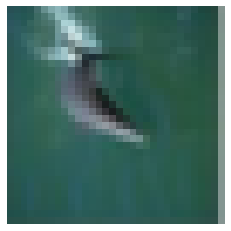

1


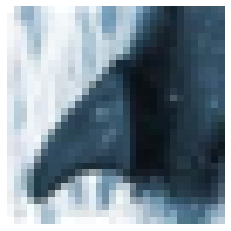

In [106]:
#figure = plt.figure()
for i in range(503):
    img, label = dataset_Realist[i]
    print(label)
    figure = plt.figure()
    plt.axis("off")
    plt.imshow(img.squeeze().T, cmap="gray")
    plt.show()
#print(label)

In [107]:
img_dict5 = {}
for i in range(num_classes5):
    img_dict5[classes5[i]] = 0
for i in range(dataset_size5):
    img, label = dataset_Realist[i]
    img_dict5[classes5[label]] += 1
img_dict5

{'beaver': 500,
 'dolphin': 296,
 'otter': 189,
 'seal': 131,
 'whale': 96,
 'aquarium_fish': 372,
 'flatfish': 209,
 'ray': 134,
 'shark': 93,
 'trout': 68,
 'orchid': 270,
 'poppy': 152,
 'rose': 97,
 'sunflower': 67,
 'tulip': 49,
 'bottle': 200,
 'bowl': 113,
 'can': 72,
 'cup': 50,
 'plate': 36,
 'apple': 152,
 'mushroom': 85,
 'orange': 54,
 'pear': 38,
 'sweet_pepper': 28,
 'clock': 117,
 'keyboard': 66,
 'lamp': 42,
 'telephone': 29,
 'television': 21,
 'bed': 92,
 'chair': 51,
 'couch': 33,
 'table': 23,
 'wardrobe': 16,
 'bee': 73,
 'beetle': 41,
 'butterfly': 26,
 'caterpillar': 18,
 'cockroach': 13,
 'bear': 59,
 'leopard': 33,
 'lion': 21,
 'tiger': 14,
 'wolf': 10,
 'bridge': 48,
 'castle': 27,
 'house': 17,
 'road': 12,
 'skyscraper': 8,
 'cloud': 39,
 'forest': 22,
 'mountain': 14,
 'plain': 9,
 'sea': 7,
 'camel': 32,
 'cattle': 18,
 'chimpanzee': 11,
 'elephant': 8,
 'kangaroo': 6,
 'fox': 27,
 'porcupine': 15,
 'possum': 9,
 'raccoon': 6,
 'skunk': 5,
 'crab': 23,
 '

In [108]:
Liste4 = list(img_dict5.values())

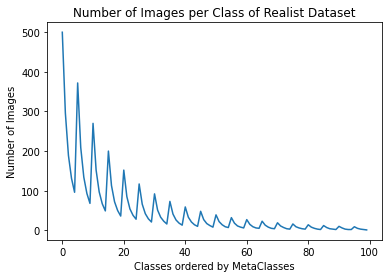

In [109]:
plt.figure()
plt.plot(Liste4)
plt.xlabel("Classes ordered by MetaClasses")
plt.ylabel("Number of Images")
plt.title("Number of Images per Class of Realist Dataset")
plt.show()

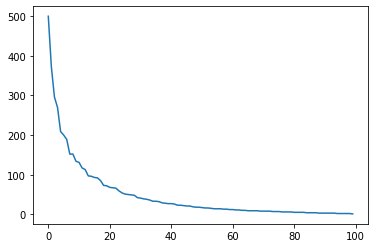

In [138]:
Liste4.sort(reverse=True)
plt.plot(Liste4)

In [110]:
dataset4 = CIFAR100Nils(
    root="./data",
    download=True,
    transform=ToTensor()
)

Files already downloaded and verified


In [111]:
classes6 = dataset4.classes
num_classes6 = len(dataset4.classes)
dataset_size6 = len(dataset4)
print(dataset_size6)
print(num_classes6)
print(classes6)

50000
100
['beaver', 'dolphin', 'otter', 'seal', 'whale', 'aquarium_fish', 'flatfish', 'ray', 'shark', 'trout', 'orchid', 'poppy', 'rose', 'sunflower', 'tulip', 'bottle', 'bowl', 'can', 'cup', 'plate', 'apple', 'mushroom', 'orange', 'pear', 'sweet_pepper', 'clock', 'keyboard', 'lamp', 'telephone', 'television', 'bed', 'chair', 'couch', 'table', 'wardrobe', 'bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach', 'bear', 'leopard', 'lion', 'tiger', 'wolf', 'bridge', 'castle', 'house', 'road', 'skyscraper', 'cloud', 'forest', 'mountain', 'plain', 'sea', 'camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo', 'fox', 'porcupine', 'possum', 'raccoon', 'skunk', 'crab', 'lobster', 'snail', 'spider', 'worm', 'baby', 'boy', 'girl', 'man', 'woman', 'crocodile', 'dinosaur', 'lizard', 'snake', 'turtle', 'hamster', 'mouse', 'rabbit', 'shrew', 'squirrel', 'maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree', 'bicycle', 'bus', 'motorcycle', 'pickup_truck', 'train', 'lawn_mower', 'rocke

In [112]:
#figure = plt.figure()
for i in range(dataset_size6):
    img, label = dataset4[i]
    print(label)
#plt.axis("off")
#plt.imshow(img.squeeze().T, cmap="gray")
#plt.show()
#print(label)

56
76
20
71
5
28
94
18
50
58
26
89
13
46
54
26
90
44
84
54
83
88
12
29
88
33
62
86
41
62
90
46
85
82
57
25
97
71
39
33
78
66
52
44
87
49
71
94
99
78
8
37
29
15
54
35
85
31
74
85
80
2
3
42
21
72
24
51
75
22
14
81
55
99
80
38
99
73
51
41
26
62
64
59
50
41
63
67
52
38
73
55
72
96
4
24
64
69
8
79
2
26
0
44
19
79
21
96
87
33
88
62
34
0
71
51
48
59
31
51
60
6
73
22
43
7
12
62
22
62
90
89
29
1
31
1
63
56
49
29
86
11
72
61
27
0
69
61
83
22
65
4
92
75
51
76
26
68
6
73
62
18
98
6
13
78
26
10
18
63
82
3
57
62
11
3
20
77
36
45
56
71
58
19
68
66
97
68
74
42
73
7
84
48
83
92
97
34
28
96
26
8
70
73
52
61
42
37
52
48
82
95
47
66
80
57
67
47
26
90
15
11
28
26
56
10
26
18
71
99
94
94
68
63
97
57
68
27
76
25
91
32
71
59
16
89
10
82
26
27
41
92
92
21
71
50
50
99
86
73
70
4
42
28
60
63
38
73
63
87
23
5
77
71
13
50
94
87
56
48
63
18
5
23
7
30
91
78
35
33
36
95
82
84
45
81
61
65
90
22
53
69
44
98
20
78
58
16
70
36
42
24
44
9
13
18
41
20
13
30
48
53
1
74
13
31
62
63
16
64
10
23
29
63
63
8
10
43
41
47
84
29
40

33
26
53
94
93
72
11
24
26
85
73
19
88
69
85
62
90
75
96
97
78
87
52
62
33
94
18
3
25
68
90
87
38
6
30
30
70
8
7
49
52
24
46
91
0
93
17
22
19
68
33
95
93
93
27
50
51
1
76
76
21
10
42
49
80
61
17
50
77
42
6
18
73
78
69
42
40
4
61
75
70
14
73
99
7
43
5
87
59
17
76
77
83
29
78
89
87
48
52
15
4
98
2
70
21
60
63
2
22
96
59
74
83
64
20
93
84
59
17
59
83
0
91
54
26
2
47
0
22
89
92
33
72
69
48
68
3
34
89
67
67
59
15
47
3
29
64
84
88
11
82
90
7
27
44
6
86
37
41
95
47
29
26
22
8
88
67
8
12
17
48
2
6
69
29
12
5
72
8
18
78
11
25
34
55
20
44
97
22
74
72
18
96
44
18
7
62
60
12
66
64
8
1
54
84
61
98
52
42
35
78
31
99
83
32
71
9
69
13
50
37
57
87
28
56
54
85
37
67
93
2
90
27
54
41
20
44
16
95
22
3
6
45
61
33
0
9
24
21
98
70
66
40
49
61
60
19
46
0
69
57
40
53
6
68
36
53
49
49
61
44
27
75
84
91
51
66
67
95
54
22
2
8
82
58
0
27
12
25
60
70
86
38
29
63
31
12
22
31
69
51
49
40
73
10
52
27
96
59
72
15
64
6
93
58
72
22
68
94
11
64
39
9
40
2
72
9
99
62
63
36
8
19
68
87
48
31
93
30
43
92
86
94
88
55
67
5
19
48

70
52
33
32
22
58
53
37
44
15
15
88
26
73
99
84
0
69
12
48
55
48
15
31
61
43
40
26
84
5
58
29
23
50
55
16
67
28
67
34
19
49
23
86
68
34
54
4
97
54
26
12
57
44
53
30
10
36
58
64
8
31
37
95
25
59
31
84
68
7
52
22
37
59
84
83
1
74
4
59
99
37
69
65
16
99
95
9
41
56
65
26
23
37
44
4
90
76
90
1
46
51
91
29
22
25
28
44
65
75
93
63
49
88
5
73
46
99
58
3
79
97
56
73
14
44
77
4
46
75
47
20
29
25
53
45
18
81
98
55
65
70
95
68
81
47
7
2
38
17
5
8
79
33
11
65
49
96
36
82
43
80
71
56
7
77
77
25
84
90
37
35
56
46
60
58
91
35
91
1
0
49
79
53
78
31
76
88
57
5
78
35
70
89
27
21
95
54
43
85
2
8
8
15
67
90
17
77
54
54
86
3
59
50
67
62
35
11
62
0
91
92
15
60
25
90
26
34
93
29
6
5
42
48
73
99
93
33
77
12
85
98
69
13
34
95
22
52
17
64
85
78
74
20
1
78
62
95
65
56
70
56
81
14
94
39
81
80
87
26
69
60
22
48
49
69
45
29
49
31
23
91
57
50
57
56
16
27
59
20
66
47
53
87
39
67
8
98
50
30
50
68
89
40
72
38
28
67
95
8
93
75
40
57
92
9
95
64
56
42
91
29
45
77
46
5
44
99
23
33
55
81
44
61
36
42
73
93
54
41
95
28
45
54
1

61
78
62
57
13
14
49
15
17
88
92
13
13
61
38
3
92
68
9
96
37
15
6
2
71
40
92
40
84
78
5
91
1
69
25
77
18
24
81
59
81
10
99
16
72
59
79
0
20
30
32
69
74
97
34
88
61
69
33
87
3
44
34
67
17
30
93
70
20
25
38
81
60
95
60
81
2
71
56
55
60
74
54
46
85
54
2
25
92
4
17
48
30
3
87
22
91
82
77
97
22
37
10
96
44
90
65
88
32
6
18
66
70
45
26
35
31
42
56
57
29
71
12
7
75
53
45
24
79
95
97
57
53
17
81
27
3
25
16
83
19
48
74
63
5
15
90
36
61
48
71
70
52
12
53
30
57
1
13
83
43
62
43
33
23
17
50
33
96
22
4
92
50
24
80
90
42
69
73
30
45
78
2
5
23
28
59
14
55
37
86
97
84
50
24
78
29
4
31
23
89
72
23
5
23
14
78
64
84
79
94
90
2
83
66
57
30
79
6
80
56
75
10
63
21
37
83
24
92
37
97
47
80
28
95
77
53
84
99
82
44
36
68
7
77
47
69
45
12
57
81
65
96
34
83
60
7
49
93
61
76
3
51
45
30
73
5
27
15
72
45
67
78
6
88
85
28
54
20
0
81
49
84
44
16
68
72
52
21
37
80
50
2
85
98
48
19
22
39
92
62
59
3
27
97
4
48
98
1
85
64
59
64
31
73
69
92
9
61
60
45
17
99
91
95
77
22
85
84
15
82
43
96
56
18
51
62
54
49
83
61
10
69
66
58


73
59
23
81
78
3
83
31
76
18
45
57
62
85
16
24
31
83
67
27
12
54
42
24
16
23
76
79
26
13
84
86
74
37
40
20
72
67
40
39
9
64
58
27
26
52
95
69
8
35
46
38
77
1
69
21
83
57
24
65
8
27
28
51
75
28
6
2
36
32
49
43
13
66
97
74
36
14
22
64
54
12
96
88
79
35
37
98
89
69
94
80
11
42
97
96
80
82
63
7
45
45
38
97
61
37
46
34
27
94
80
72
10
77
16
88
41
79
45
19
91
81
60
17
79
26
66
49
13
15
53
12
67
95
10
74
54
81
65
86
45
45
20
86
17
90
55
97
71
75
5
54
85
92
69
73
36
40
68
43
82
88
12
25
14
88
72
75
81
93
29
12
11
61
60
67
54
64
64
6
52
90
70
42
21
84
6
40
8
51
23
21
76
0
19
3
56
10
34
58
39
4
89
97
77
74
73
70
79
97
8
7
70
41
15
0
76
33
21
53
68
25
52
41
6
10
95
17
24
23
19
50
84
15
60
43
92
63
88
32
57
83
13
55
24
90
22
46
46
50
73
28
50
12
58
87
54
55
7
52
72
91
84
96
52
9
34
78
46
47
27
65
27
35
43
28
67
76
67
90
21
87
37
50
87
59
64
63
87
7
46
73
11
56
95
36
84
21
48
40
55
14
99
26
15
58
54
3
6
77
99
45
27
31
53
27
22
90
83
84
40
78
40
69
21
26
0
59
9
58
37
78
60
32
74
3
38
68
10
7
19
6
84


87
32
17
12
57
70
3
6
38
64
43
58
12
0
92
26
68
98
68
15
40
20
14
49
17
81
99
58
57
91
63
97
78
66
80
24
60
25
20
29
19
67
44
1
68
68
72
36
1
41
26
18
61
84
63
88
8
20
59
50
43
44
90
65
47
34
4
23
23
68
84
6
84
91
61
75
70
47
56
4
64
92
85
24
25
80
17
33
48
38
20
19
7
1
9
99
3
64
15
41
10
18
50
67
26
23
21
30
5
44
52
8
89
52
42
45
58
46
84
66
52
76
6
18
65
71
0
40
90
69
36
98
30
72
13
41
60
71
51
73
93
58
56
58
8
79
72
89
55
42
58
20
33
84
62
97
57
67
57
13
56
59
58
80
15
16
35
66
7
84
3
25
39
60
71
77
76
97
66
73
41
7
76
5
20
50
27
59
52
15
9
57
11
56
30
28
60
27
97
21
93
11
78
4
94
68
86
19
67
71
38
98
6
83
7
80
58
9
98
70
4
65
50
9
39
97
50
38
79
91
19
96
37
5
79
98
26
97
68
73
69
98
24
85
11
3
12
26
88
55
27
63
74
82
6
36
92
44
32
12
29
45
10
41
46
22
34
97
0
5
75
38
75
89
41
23
60
8
36
83
83
76
86
48
4
94
87
31
7
82
10
14
92
23
7
62
16
89
35
85
24
87
43
81
0
2
54
37
46
24
63
34
24
62
10
29
54
91
39
29
99
76
83
47
35
68
29
5
55
87
86
22
23
50
69
88
59
93
67
36
9
63
64
37
4
95
46
2


29
39
52
79
8
42
29
8
9
69
83
18
86
79
58
31
36
91
40
74
86
85
78
75
17
43
37
55
71
31
65
35
34
66
0
7
28
26
93
9
90
96
94
25
63
12
66
62
31
21
44
5
28
16
58
32
25
53
32
18
86
41
33
10
45
81
5
68
32
94
8
2
54
6
16
21
71
24
58
21
5
68
6
19
8
79
36
93
95
45
44
9
31
94
21
54
2
10
47
46
1
56
94
90
93
29
24
54
64
90
79
77
67
63
20
43
57
65
82
9
20
80
84
61
84
66
7
93
89
10
21
15
43
57
88
22
82
98
16
47
29
7
27
46
63
31
85
29
37
46
94
58
7
54
1
94
71
88
43
30
38
40
19
1
3
54
16
26
50
19
32
84
47
95
56
43
31
96
54
67
20
80
77
62
75
13
70
35
35
29
44
10
59
1
25
64
10
26
11
97
31
90
26
69
97
50
7
29
22
34
82
90
4
31
39
11
71
98
44
35
99
19
68
36
80
24
46
57
79
6
99
10
30
13
1
43
1
88
84
0
88
54
14
3
7
14
80
90
12
18
68
44
26
49
52
65
14
63
73
23
75
48
19
28
85
53
19
41
27
46
90
11
25
53
28
21
40
79
45
60
60
81
89
43
24
1
24
3
41
75
27
38
41
75
57
53
75
88
53
68
77
36
46
14
42
79
52
41
99
46
14
60
19
14
39
95
77
89
74
30
58
86
64
73
34
18
25
93
57
25
9
37
63
82
53
78
70
36
60
73
51
25
7
60
48
19

9
13
22
48
40
92
56
99
74
1
54
71
70
34
51
85
97
1
16
28
41
46
36
93
56
85
48
75
59
96
6
76
74
9
23
8
5
21
69
96
96
56
78
87
19
30
93
98
96
98
89
91
75
43
39
45
1
18
62
82
19
1
86
48
95
48
97
67
8
54
0
51
7
98
51
3
60
20
99
44
34
31
19
68
41
15
82
63
50
72
74
49
60
36
6
47
98
24
21
36
94
48
51
57
39
12
55
43
35
64
25
44
16
72
51
64
91
44
40
1
24
54
80
22
38
74
47
70
95
18
97
87
1
22
82
90
34
23
97
79
20
8
78
23
98
76
66
34
4
19
49
0
7
70
69
61
37
18
42
16
7
47
37
58
85
22
22
94
26
73
75
35
65
61
14
60
23
33
56
34
84
76
77
21
0
29
28
74
67
59
7
26
49
54
9
10
70
17
41
60
32
83
22
17
59
55
70
30
97
76
10
47
78
36
75
72
4
5
94
88
87
81
82
52
68
97
63
56
3
88
42
12
42
84
96
13
92
27
59
48
12
58
97
15
99
44
80
70
75
70
72
46
77
79
83
12
94
6
5
77
78
95
91
25
69
37
78
49
50
89
52
72
73
51
91
42
83
12
77
69
47
38
5
1
94
50
90
17
69
78
2
17
79
17
6
38
54
42
18
36
65
77
44
11
5
45
83
36
66
94
40
37
14
31
77
27
97
82
90
55
15
0
38
75
27
54
68
30
60
27
44
43
74
29
36
56
39
47
73
92
50
24
75
45
60


83
30
6
72
75
59
55
63
65
54
14
46
93
12
2
4
32
47
44
7
86
21
28
49
24
6
16
56
64
41
95
6
89
37
40
67
17
47
77
75
54
54
95
66
13
8
75
16
19
98
9
20
64
77
63
8
77
58
57
46
83
18
38
47
8
75
78
39
45
65
62
24
91
97
79
52
51
77
47
91
40
53
47
52
39
97
78
71
57
78
57
28
40
74
86
75
6
56
68
70
72
81
52
56
59
82
62
6
15
53
22
56
36
39
61
66
39
17
27
44
43
3
20
70
88
93
55
53
67
26
65
42
72
52
43
50
64
7
79
4
64
91
92
85
56
86
3
59
58
47
46
47
12
95
23
79
33
32
66
85
34
88
2
39
96
63
30
63
35
80
80
89
71
7
12
86
66
73
23
93
30
53
77
14
0
45
68
39
92
25
10
64
20
15
28
44
82
89
27
5
97
97
67
88
84
94
71
59
81
16
81
45
42
57
47
17
39
15
3
63
19
30
83
87
19
55
17
73
1
30
95
16
93
56
32
31
45
3
16
12
85
27
57
9
82
97
44
80
42
90
96
1
62
12
76
56
52
23
59
1
56
2
22
74
24
90
43
73
36
51
75
15
51
14
97
0
32
74
65
62
73
30
46
44
26
49
27
81
26
27
78
59
8
61
17
68
87
3
80
1
54
35
98
55
19
8
27
36
28
66
96
2
53
20
75
21
13
15
51
60
24
85
75
61
27
60
58
98
25
71
57
94
28
96
5
40
57
76
17
33
24
76
66
6
28


86
20
35
97
38
3
12
22
84
48
83
36
25
6
60
10
28
35
4
13
77
84
9
89
36
80
57
40
20
2
84
72
73
56
54
11
40
75
86
28
96
31
67
68
60
41
23
97
92
83
35
65
5
36
75
40
33
8
24
56
3
16
73
11
20
99
48
97
43
49
17
95
92
70
33
29
22
65
58
14
31
91
90
58
30
52
36
13
11
86
43
69
25
66
24
84
97
61
18
42
37
98
45
95
37
62
62
44
5
3
10
24
12
65
11
71
31
42
89
28
41
5
6
38
53
80
2
55
16
69
90
41
50
31
36
88
90
20
50
39
58
22
31
18
71
9
5
70
16
74
93
4
32
77
47
14
84
9
10
58
45
26
23
53
40
27
47
17
84
44
62
74
87
39
19
87
57
94
76
1
23
65
29
72
66
8
36
73
65
69
50
95
46
60
60
90
95
39
65
43
83
18
35
67
82
69
11
90
15
30
68
80
72
44
45
82
88
37
94
63
34
24
88
18
1
85
52
82
17
30
89
11
42
9
66
88
5
73
90
63
79
27
1
68
61
55
63
99
79
93
90
43
12
16
58
93
23
93
68
78
60
44
93
82
98
1
66
55
27
20
51
10
64
29
16
51
5
11
75
27
66
14
6
64
64
71
3
97
7
80
35
68
8
47
84
91
54
8
13
56
58
9
93
9
94
3
95
65
58
72
80
87
44
31
41
37
7
53
74
14
16
0
16
85
15
87
28
85
34
78
97
84
70
3
85
10
60
75
30
19
49
0
20
32
69
52

37
11
47
12
30
60
51
59
75
78
81
15
35
21
48
88
92
56
10
46
96
56
21
79
62
13
2
27
34
17
13
84
37
10
1
92
40
55
47
85
64
86
5
97
96
97
57
91
50
49
97
68
74
53
14
65
43
33
79
63
72
34
19
51
56
84
94
74
84
55
37
81
60
69
74
60
60
44
61
54
85
16
69
61
18
58
73
70
98
91
0
40
48
77
55
73
75
81
45
82
22
85
11
63
57
25
94
46
91
3
52
44
89
3
44
40
50
31
40
55
56
42
39
26
84
61
41
83
77
63
4
49
80
99
83
45
78
82
6
76
23
51
61
7
58
74
67
22
21
4
43
41
80
27
44
36
11
78
25
7
85
17
22
29
55
74
85
63
68
10
6
38
85
0
29
15
44
49
96
43
78
90
16
86
95
7
1
26
52
62
83
23
21
12
50
68
68
54
22
43
78
73
98
41
82
79
79
99
51
72
74
43
45
81
44
55
4
73
58
83
83
96
35
86
64
74
5
59
82
67
98
24
99
76
31
5
16
72
80
6
13
27
11
86
16
89
79
87
50
39
57
40
41
33
48
73
92
23
74
73
45
3
42
46
35
50
60
39
25
53
30
77
6
84
31
6
94
6
16
28
11
33
73
53
73
74
33
83
91
58
25
5
78
6
61
75
32
26
4
12
8
88
12
94
63
18
28
0
76
25
41
44
95
4
72
5
22
92
75
44
9
81
90
46
20
46
98
46
16
42
35
4
6
77
24
81
62
75
89
71
14
8
3
41
86


90
34
10
97
60
80
31
27
12
68
37
56
67
65
41
60
4
86
62
58
5
38
0
35
16
84
76
99
65
84
99
23
37
76
68
95
13
18
35
59
74
21
59
0
33
61
34
5
84
83
36
50
9
62
60
63
20
62
35
95
30
36
24
70
26
86
58
24
98
11
10
67
95
8
25
56
80
51
25
76
37
44
55
11
33
60
79
57
80
89
46
65
89
43
70
91
99
63
35
50
6
24
23
90
82
83
56
53
30
39
90
64
87
85
35
82
8
28
34
10
44
92
45
58
21
37
33
58
69
63
22
34
95
27
8
35
48
50
64
7
48
51
98
59
50
2
28
91
63
81
84
42
25
9
46
80
19
12
35
68
74
49
93
36
32
3
10
23
6
21
67
68
55
5
48
92
76
94
85
67
38
39
38
38
76
26
32
20
31
31
58
26
33
78
18
88
52
25
93
35
30
63
15
21
32
4
65
61
33
99
96
65
77
52
41
77
87
11
11
71
5
41
4
55
71
69
8
35
9
91
86
68
34
76
83
59
56
10
74
91
61
7
57
88
90
15
58
63
73
13
64
45
9
36
91
64
19
76
26
69
26
50
9
49
23
10
82
23
25
20
20
83
99
55
59
46
51
72
67
66
62
45
80
21
84
3
5
0
51
55
34
24
75
77
1
51
64
23
88
92
76
43
41
7
96
29
51
80
71
19
29
6
66
37
33
60
53
62
54
75
41
94
38
56
99
44
43
13
41
96
97
37
87
88
14
64
13
32
0
83
45
86
28
38

98
92
25
32
10
34
85
19
37
2
91
22
92
80
35
0
20
61
3
25
47
68
57
40
79
65
3
72
47
90
75
33
16
10
12
37
14
62
51
82
12
79
15
15
23
20
79
72
31
18
20
97
55
83
72
17
40
66
13
76
62
22
41
5
7
78
74
65
23
53
92
63
53
55
47
9
12
72
1
83
82
27
53
32
42
37
37
57
76
95
44
95
60
27
89
30
66
15
29
69
91
89
90
12
90
24
46
80
25
3
99
46
33
61
2
49
81
11
66
79
62
56
47
97
77
74
44
8
0
54
65
96
21
3
40
11
33
14
96
89
29
82
60
49
46
41
64
98
72
49
89
1
39
35
8
66
1
86
8
64
91
87
97
14
88
54
94
72
12
0
62
53
63
30
4
54
80
16
96
90
71
35
31
57
88
63
52
1
78
4
89
38
75
93
85
86
49
17
55
70
65
95
25
19
31
37
76
34
75
98
25
92
59
67
21
53
41
65
60
66
33
65
71
41
3
12
12
14
79
87
42
69
10
89
6
31
33
88
21
14
31
39
21
22
60
56
92
88
28
33
51
81
33
46
83
57
20
35
25
22
13
37
60
91
55
56
37
90
13
29
12
17
75
0
38
15
53
87
29
4
17
26
89
49
10
71
12
61
92
15
48
12
96
71
69
10
13
25
91
94
91
92
50
18
5
63
20
55
78
80
47
91
30
27
96
54
37
86
57
69
88
77
19
54
59
52
86
11
68
1
90
80
57
57
88
35
52
20
67
53
89
65
7

87
95
52
0
48
33
23
16
79
78
25
80
49
70
83
70
90
7
11
81
5
36
32
27
92
93
16
43
67
72
64
78
39
8
18
4
19
35
68
7
58
51
17
67
55
69
32
81
66
58
90
93
9
62
80
97
76
76
83
49
43
17
95
15
72
0
50
98
27
37
84
86
83
42
2
73
4
35
87
36
66
29
80
99
26
77
40
49
60
32
69
82
57
14
38
37
50
40
81
12
43
0
72
16
1
4
98
96
76
93
2
41
27
31
91
99
40
63
82
36
57
95
15
57
68
66
35
82
96
48
37
46
88
93
28
35
78
59
42
22
63
73
76
47
71
67
62
23
1
24
31
76
11
73
51
10
7
77
64
83
75
55
93
50
50
93
59
81
12
81
21
21
99
69
40
88
91
84
42
77
28
52
16
26
43
4
87
29
31
90
8
77
72
43
80
22
18
97
5
66
43
86
19
12
42
51
14
11
59
64
25
54
32
17
70
59
75
75
14
20
78
37
15
80
27
29
29
0
20
31
28
10
21
65
59
10
26
13
21
78
86
48
11
66
70
3
92
54
50
30
26
46
79
70
59
8
32
73
33
21
89
51
55
25
31
87
68
10
22
33
90
36
42
46
61
22
68
1
80
16
93
40
78
73
11
97
68
31
76
17
39
56
28
9
35
39
66
55
35
38
54
83
9
56
85
97
95
2
40
92
41
21
62
26
25
14
22
25
94
89
97
15
9
62
28
50
80
85
92
8
19
37
54
5
71
11
64
26
10
57
4
56
96
4

80
24
98
65
80
79
7
50
50
63
26
28
17
79
68
76
79
5
71
89
4
12
90
96
78
32
8
46
65
16
9
81
17
53
93
84
80
67
23
32
15
44
57
0
19
22
90
12
97
80
68
80
94
34
43
7
12
1
28
27
42
95
47
24
85
49
7
68
63
60
16
27
77
0
72
68
43
51
69
3
91
69
60
20
94
48
96
33
8
28
7
1
20
71
11
15
52
51
30
32
38
24
10
17
95
32
42
6
49
16
17
84
9
94
72
54
97
96
74
49
8
13
85
75
96
26
20
81
70
93
91
86
85
89
83
72
16
46
17
42
13
13
94
56
0
18
91
16
8
67
35
1
47
62
56
5
44
81
1
48
71
43
59
79
94
50
65
53
30
80
21
90
61
14
86
86
58
11
6
35
12
95
14
73
54
33
89
37
15
4
86
16
50
40
66
87
62
77
47
12
20
95
15
74
84
69
63
53
88
81
10
74
52
66
5
71
15
59
87
36
6
0
67
96
69
35
67
65
43
88
49
91
52
83
78
30
56
38
0
9
84
12
21
0
64
24
31
67
85
47
86
79
75
75
88
31
41
81
17
30
3
8
72
36
60
35
68
7
19
84
99
11
1
16
60
97
83
57
48
51
87
20
92
1
2
70
79
29
99
69
36
0
6
11
35
3
94
18
87
45
17
63
77
50
35
36
15
25
84
46
56
10
65
43
44
16
1
86
65
34
42
5
1
19
12
40
11
35
64
84
37
96
11
23
58
40
52
34
41
69
46
26
8
12
10
44
55
69

35
82
2
67
69
19
24
21
20
4
82
79
23
76
5
79
97
65
99
87
4
59
16
80
56
79
85
33
54
58
18
3
79
58
45
24
34
57
31
29
94
82
27
69
74
44
17
39
29
17
49
68
57
31
39
47
99
90
61
83
99
2
48
11
6
0
93
90
10
45
33
27
62
78
13
9
68
9
12
90
29
80
58
73
39
58
47
13
10
65
48
85
97
5
62
97
72
73
13
64
99
46
27
18
34
9
96
59
88
90
4
45
45
90
42
12
25
81
70
47
46
98
5
50
6
29
92
59
41
54
89
72
60
9
85
0
57
16
4
79
19
91
29
50
56
66
3
89
22
99
70
59
79
4
93
67
88
52
97
86
71
46
45
1
22
91
76
5
59
52
55
44
49
89
28
20
57
97
63
88
59
91
97
50
9
69
51
35
58
24
91
10
79
34
1
90
58
60
21
29
77
74
78
81
90
21
55
25
32
25
31
25
91
35
3
85
81
72
90
82
20
98
32
12
75
21
66
15
69
20
32
38
40
64
16
74
55
94
92
92
30
44
29
93
16
67
9
98
81
42
1
13
67
55
84
27
84
34
6
66
24
24
29
82
30
68
56
23
67
27
52
32
72
30
58
78
98
98
87
72
7
43
71
77
18
63
94
27
36
70
2
69
24
89
38
87
53
29
44
63
97
59
31
80
58
0
80
78
11
14
95
35
59
36
43
5
87
72
81
10
36
28
89
54
51
44
14
88
60
30
91
49
68
90
98
37
20
98
6
67
4
14
69
62
13

26
61
69
12
36
24
83
77
30
61
49
98
9
22
16
23
4
22
94
82
57
59
79
55
9
83
85
51
64
94
50
50
18
28
17
97
49
7
71
61
33
69
73
20
28
4
64
42
6
18
77
67
22
4
53
98
94
92
69
56
8
78
17
97
20
54
74
30
62
62
93
84
54
94
48
2
36
2
87
0
44
68
16
73
57
92
55
46
40
10
69
14
23
47
86
4
21
5
38
44
98
41
27
75
0
85
49
75
78
34
31
43
2
30
5
87
89
63
63
26
40
1
36
34
14
15
28
20
39
98
29
39
92
66
35
97
38
26
51
42
21
51
66
68
28
91
19
55
47
41
84
62
59
12
39
38
4
50
90
5
28
40
99
13
76
72
45
72
81
47
48
15
18
55
13
93
67
77
74
66
19
58
83
77
6
67
58
89
54
19
2
62
65
41
85
25
48
99
28
83
64
53
67
5
89
8
10
71
55
83
70
32
7
69
37
73
1
29
64
58
87
10
12
51
5
45
39
99
4
15
32
74
76
59
23
98
56
56
19
15
35
3
62
78
82
63
27
82
29
95
9
83
27
46
35
49
54
63
72
84
71
55
96
18
72
30
46
86
9
38
81
67
4
18
50
86
53
52
61
60
3
44
26
42
92
75
48
40
33
59
57
84
0
71
9
16
76
23
45
16
68
73
94
95
93
88
83
65
44
32
79
53
96
75
11
86
31
64
74
13
40
25
7
11
60
59
11
23
28
77
94
62
56
55
69
73
37
21
52
90
6
66
54
7
74
99

10
45
30
82
88
68
35
73
38
6
22
67
66
85
90
42
7
4
26
88
55
59
75
76
93
91
9
36
88
60
84
30
96
82
28
90
91
18
30
92
73
83
97
25
96
57
66
47
1
0
67
45
39
89
42
90
63
76
34
11
93
91
47
56
33
14
37
1
19
91
61
12
5
82
70
89
97
72
45
14
21
19
81
36
71
31
60
39
72
24
66
89
73
19
81
97
66
93
2
73
63
10
91
21
55
81
38
7
64
42
99
1
92
0
2
0
6
76
9
4
0
3
64
17
69
7
23
21
4
32
21
3
39
9
65
6
16
52
1
14
34
37
94
16
8
36
86
67
83
12
33
86
67
39
53
3
91
54
2
91
14
34
88
44
93
22
4
59
81
62
51
29
97
52
54
48
94
44
33
21
36
69
50
25
47
41
97
46
99
91
71
46
35
33
45
2
65
1
83
27
55
44
54
7
43
38
97
89
28
64
79
60
32
63
46
35
43
31
29
33
84
54
91
18
29
29
21
66
59
37
8
13
49
76
66
55
32
41
43
40
56
26
39
40
75
50
89
33
8
83
94
19
61
57
7
85
72
16
49
44
24
75
3
76
88
53
46
55
28
4
7
81
76
39
37
52
15
98
16
80
22
58
53
55
45
22
26
93
28
51
53
16
10
42
64
22
38
18
66
74
73
58
7
58
30
63
49
33
5
84
42
74
33
56
44
92
56
54
42
98
77
7
43
36
55
14
83
48
71
18
32
94
53
3
24
77
97
20
87
87
39
65
97
71
39
71
0
24

In [113]:
img_dict6 = {}
for i in range(num_classes6):
    img_dict6[classes6[i]] = 0
for i in range(dataset_size6):
    img, label = dataset4[i]
    img_dict6[classes6[label-1]] += 1
img_dict6

{'beaver': 500,
 'dolphin': 500,
 'otter': 500,
 'seal': 500,
 'whale': 500,
 'aquarium_fish': 500,
 'flatfish': 500,
 'ray': 500,
 'shark': 500,
 'trout': 500,
 'orchid': 500,
 'poppy': 500,
 'rose': 500,
 'sunflower': 500,
 'tulip': 500,
 'bottle': 500,
 'bowl': 500,
 'can': 500,
 'cup': 500,
 'plate': 500,
 'apple': 500,
 'mushroom': 500,
 'orange': 500,
 'pear': 500,
 'sweet_pepper': 500,
 'clock': 500,
 'keyboard': 500,
 'lamp': 500,
 'telephone': 500,
 'television': 500,
 'bed': 500,
 'chair': 500,
 'couch': 500,
 'table': 500,
 'wardrobe': 500,
 'bee': 500,
 'beetle': 500,
 'butterfly': 500,
 'caterpillar': 500,
 'cockroach': 500,
 'bear': 500,
 'leopard': 500,
 'lion': 500,
 'tiger': 500,
 'wolf': 500,
 'bridge': 500,
 'castle': 500,
 'house': 500,
 'road': 500,
 'skyscraper': 500,
 'cloud': 500,
 'forest': 500,
 'mountain': 500,
 'plain': 500,
 'sea': 500,
 'camel': 500,
 'cattle': 500,
 'chimpanzee': 500,
 'elephant': 500,
 'kangaroo': 500,
 'fox': 500,
 'porcupine': 500,
 'p

In [114]:
Liste5 = Liste4.copy()
Liste5.sort(reverse=True)

In [115]:
#On veut maintenant construire nos datasets respectant différents critères, même nombre d'images, ils doivent suivre la même distribution selon les espèces, chaque classe doit avoir au moins une image
#Faisons quelquels test ici et puis on les fera au propre dans un autre notebook
#Commençons par créer un dataset échantillonné suivant les espèces
class GoodIMBALANCECIFAR10(torchvision.datasets.CIFAR10):
    cls_num = 10

    def __init__(self, root, imb_type='Good', imb_factor=2.3, imb_factor2=54.7, rand_number=0, train=True,
                 transform=None, target_transform=None,
                 download=False):
        super(GoodIMBALANCECIFAR10, self).__init__(root, train, transform, target_transform, download)
        np.random.seed(rand_number)
        img_num_list = self.get_img_num_per_cls(self.cls_num, imb_type, imb_factor, imb_factor2)
        self.gen_imbalanced_data(img_num_list)

    def get_img_num_per_cls(self, cls_num, imb_type, imb_factor, imb_factor2):
        img_max = len(self.data) / cls_num
        img_num_per_cls = []
        if imb_type == 'exp':
            for cls_idx in range(cls_num):
                num = img_max * (imb_factor**(cls_idx / (cls_num - 1.0)))
                img_num_per_cls.append(int(num))
        if imb_type == 'Good':
            for cls_idx in range(cls_num):
                num = Liste5[cls_idx]
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf-Mandelbrot':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx+imb_factor2)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx+imb_factor2)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        elif imb_type == 'step':
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max))
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max * imb_factor))
        else:
            img_num_per_cls.extend([int(img_max)] * cls_num)
        return img_num_per_cls

    def gen_imbalanced_data(self, img_num_per_cls):
        new_data = []
        new_targets = []
        targets_np = np.array(self.targets, dtype=np.int64)
        classes = np.unique(targets_np)
        # np.random.shuffle(classes)
        self.num_per_cls_dict = dict()
        for the_class, the_img_num in zip(classes, img_num_per_cls):
            self.num_per_cls_dict[the_class] = the_img_num
            idx = np.where(targets_np == the_class)[0]
            np.random.shuffle(idx)
            selec_idx = idx[:the_img_num]
            new_data.append(self.data[selec_idx, ...])
            new_targets.extend([the_class, ] * the_img_num)
        new_data = np.vstack(new_data)
        self.data = new_data
        self.targets = new_targets
        
    def get_cls_num_list(self):
        cls_num_list = []
        for i in range(self.cls_num):
            cls_num_list.append(self.num_per_cls_dict[i])
        return cls_num_list

In [116]:
class GoodIMBALANCECIFAR100(GoodIMBALANCECIFAR10):
    """`CIFAR100 <https://www.cs.toronto.edu/~kriz/cifar.html>`_ Dataset.
    This is a subclass of the `CIFAR10` Dataset.
    """
    base_folder = 'cifar-100-python'
    url = "https://www.cs.toronto.edu/~kriz/cifar-100-python.tar.gz"
    filename = "cifar-100-python.tar.gz"
    tgz_md5 = 'eb9058c3a382ffc7106e4002c42a8d85'
    train_list = [
        ['train', '16019d7e3df5f24257cddd939b257f8d'],
    ]

    test_list = [
        ['test', 'f0ef6b0ae62326f3e7ffdfab6717acfc'],
    ]
    meta = {
        'filename': 'meta',
        'key': 'fine_label_names',
        'md5': '7973b15100ade9c7d40fb424638fde48',
    }
    cls_num = 100


In [117]:
dataset_Species = GoodIMBALANCECIFAR100(root='./data', train=True,
                    download=True, transform=transform)

Files already downloaded and verified


In [118]:
dataset_Species

Dataset GoodIMBALANCECIFAR100
    Number of datapoints: 4927
    Root location: ./data
    Split: Train
    StandardTransform
Transform: Compose(
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )

In [119]:
classes7 = dataset_Species.classes
num_classes7 = len(dataset_Species.classes)
dataset_size7 = len(dataset_Species)
print(dataset_size7)
print(num_classes7)
print(classes7)

4927
100
['apple', 'aquarium_fish', 'baby', 'bear', 'beaver', 'bed', 'bee', 'beetle', 'bicycle', 'bottle', 'bowl', 'boy', 'bridge', 'bus', 'butterfly', 'camel', 'can', 'castle', 'caterpillar', 'cattle', 'chair', 'chimpanzee', 'clock', 'cloud', 'cockroach', 'couch', 'crab', 'crocodile', 'cup', 'dinosaur', 'dolphin', 'elephant', 'flatfish', 'forest', 'fox', 'girl', 'hamster', 'house', 'kangaroo', 'keyboard', 'lamp', 'lawn_mower', 'leopard', 'lion', 'lizard', 'lobster', 'man', 'maple_tree', 'motorcycle', 'mountain', 'mouse', 'mushroom', 'oak_tree', 'orange', 'orchid', 'otter', 'palm_tree', 'pear', 'pickup_truck', 'pine_tree', 'plain', 'plate', 'poppy', 'porcupine', 'possum', 'rabbit', 'raccoon', 'ray', 'road', 'rocket', 'rose', 'sea', 'seal', 'shark', 'shrew', 'skunk', 'skyscraper', 'snail', 'snake', 'spider', 'squirrel', 'streetcar', 'sunflower', 'sweet_pepper', 'table', 'tank', 'telephone', 'television', 'tiger', 'tractor', 'train', 'trout', 'tulip', 'turtle', 'wardrobe', 'whale', 'will

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0


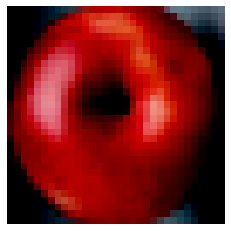

1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


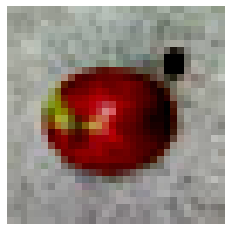

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2


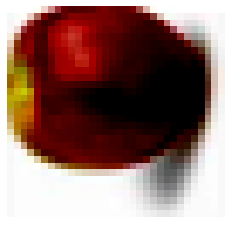

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3


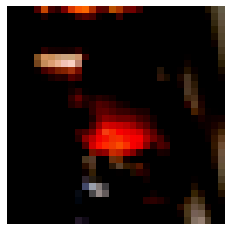

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4


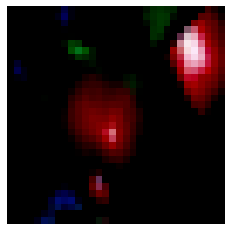

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5


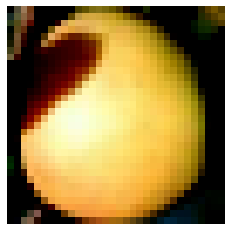

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


6


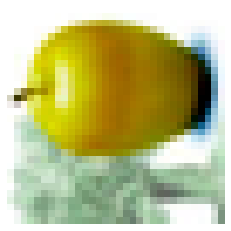

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


7


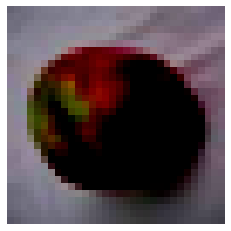

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


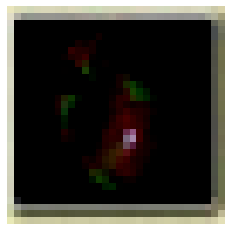

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


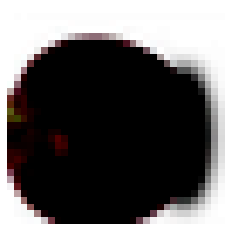

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


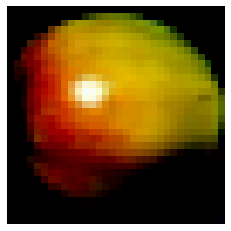

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


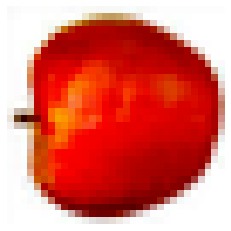

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


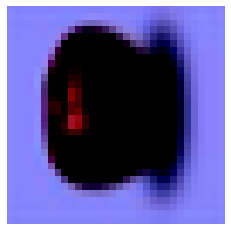

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


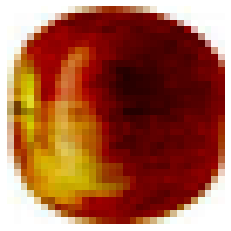

14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


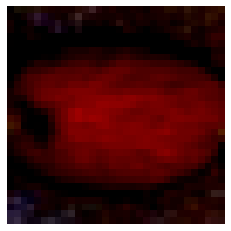

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


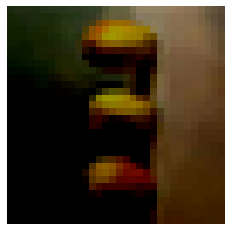

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


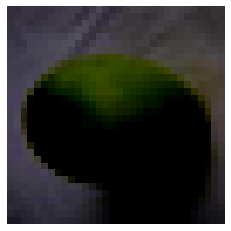

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17


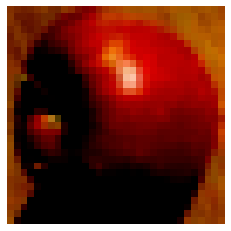

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


18


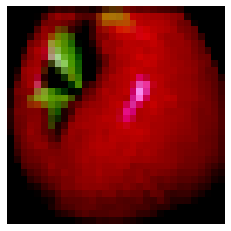

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19


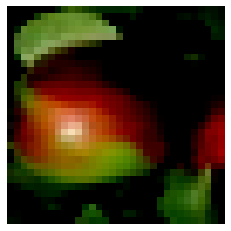

20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


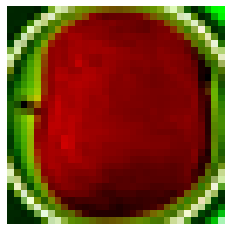

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


21


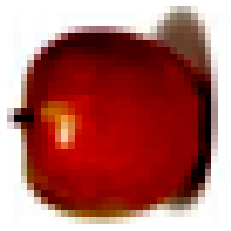

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


22


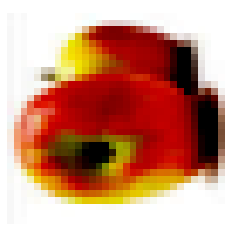

23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


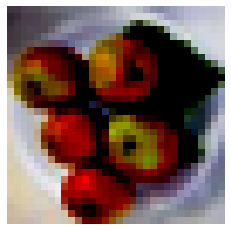

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


24


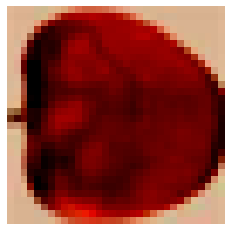

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


25


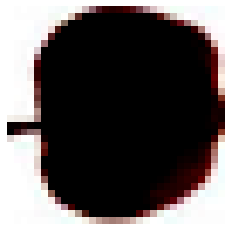

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


26


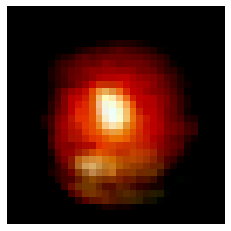

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


27


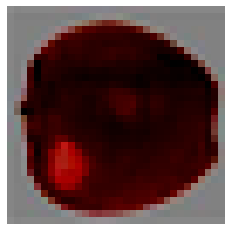

28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


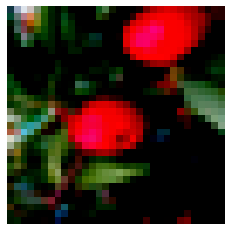

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


29


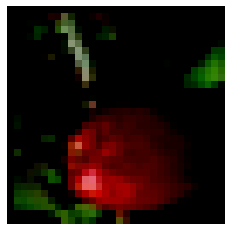

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


30


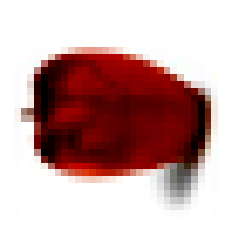

31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


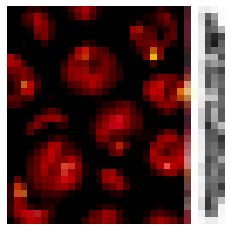

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


32


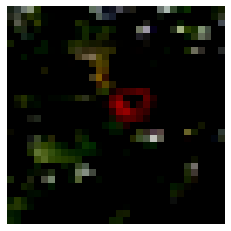

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


33


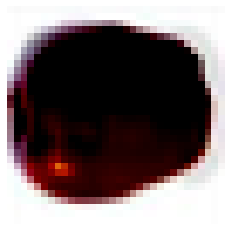

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


34


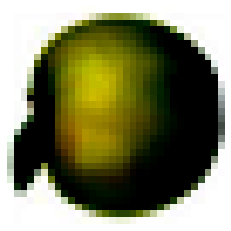

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


35


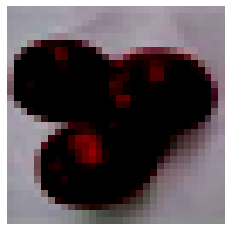

36


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


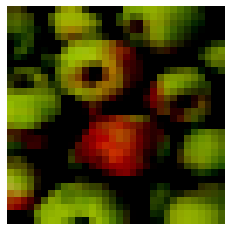

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


37


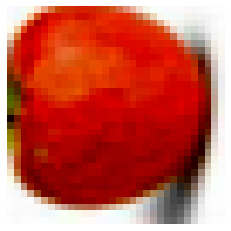

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


38


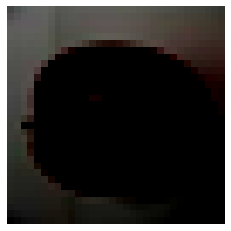

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


39


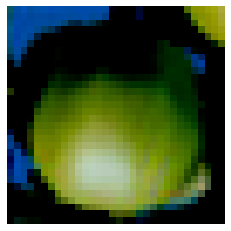

40


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


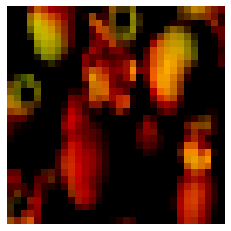

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


41


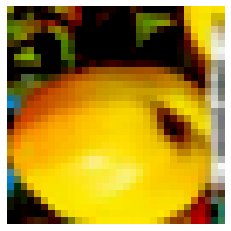

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


42


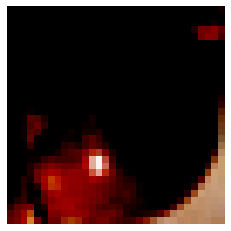

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


43


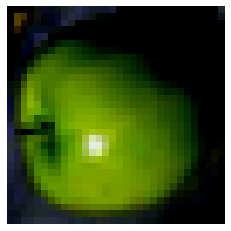

44


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


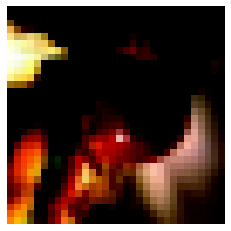

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


45


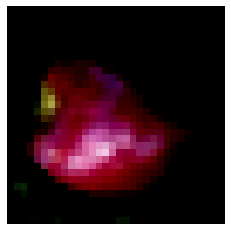

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


46


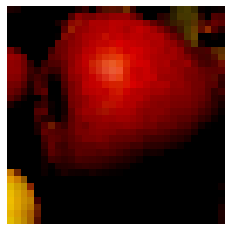

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


47


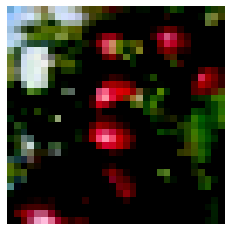

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


48


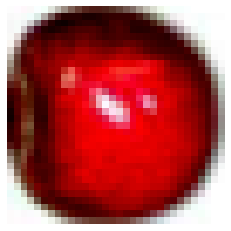

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


49


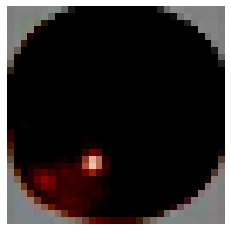

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


50


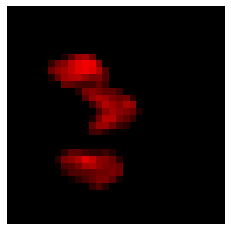

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


51


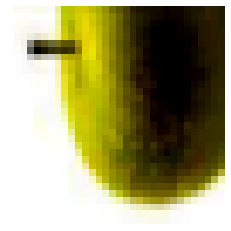

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


52


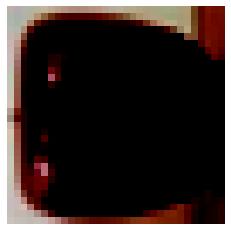

53


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


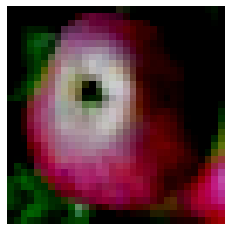

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


54


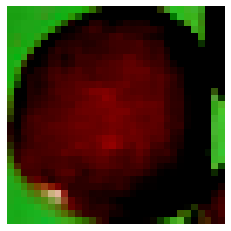

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


55


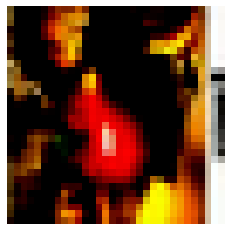

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


56


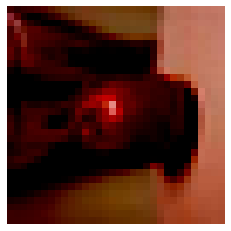

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


57


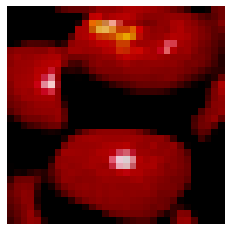

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


58


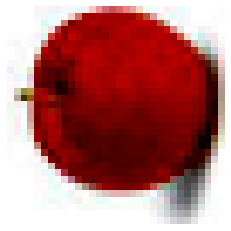

59


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


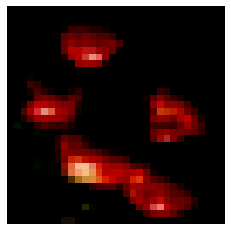

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


60


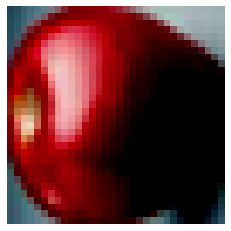

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


61


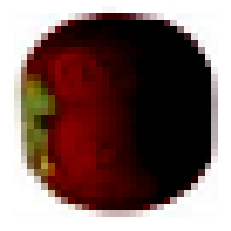

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


62


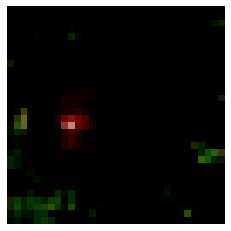

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


63


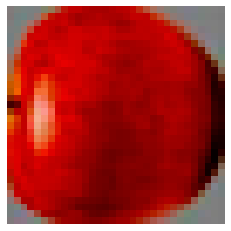

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


64


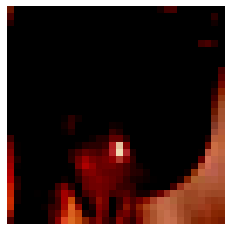

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


65


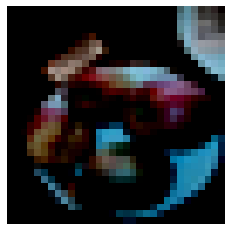

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


66


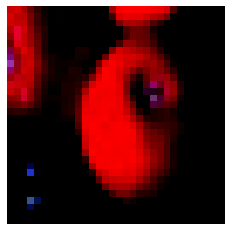

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


67


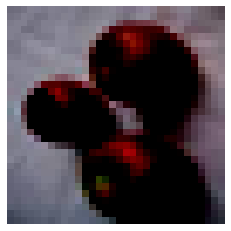

68


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


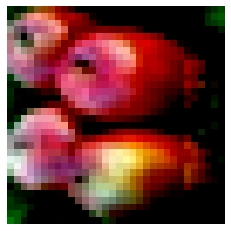

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


69


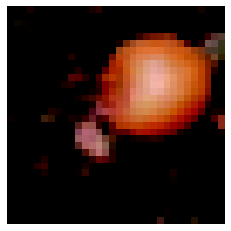

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


70


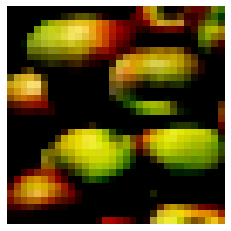

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


71


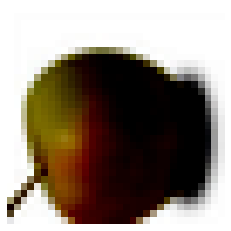

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


72


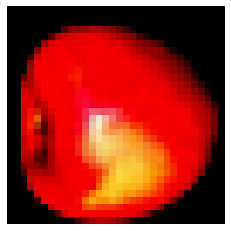

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


73


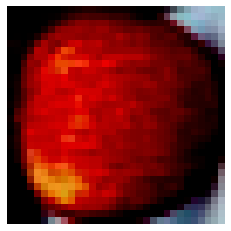

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


74


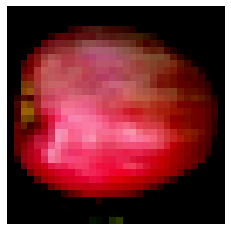

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


75


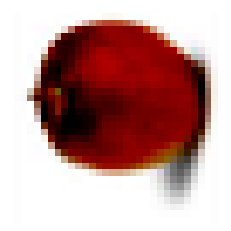

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


76


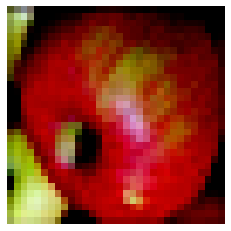

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


77


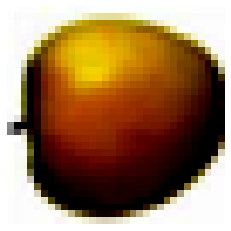

78


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


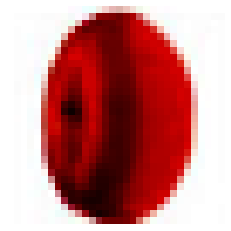

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


79


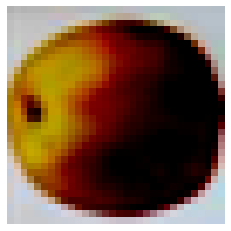

80


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


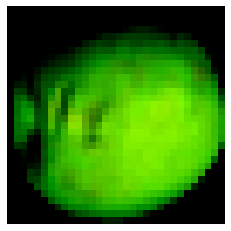

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


81


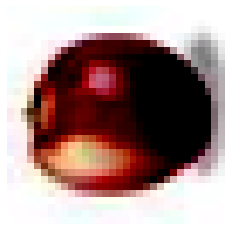

82


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


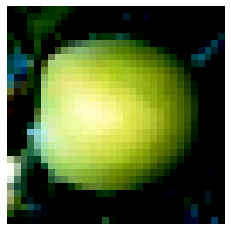

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


83


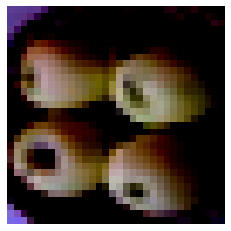

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


84


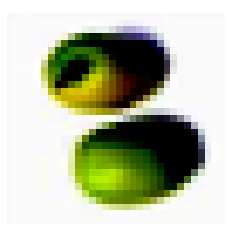

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


85


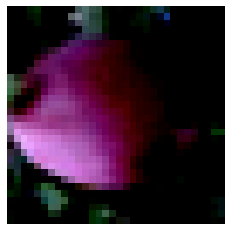

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


86


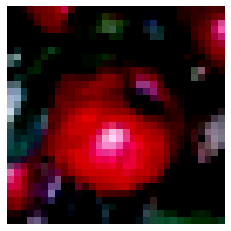

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


87


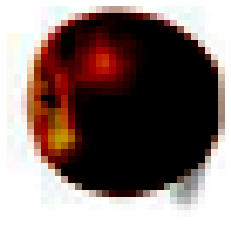

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


88


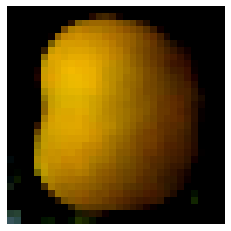

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


89


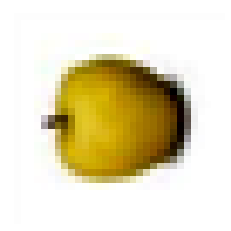

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


90


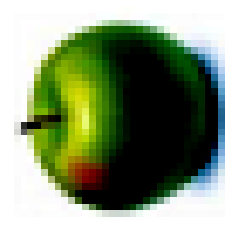

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


91


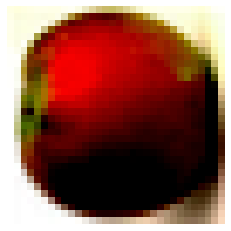

92


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


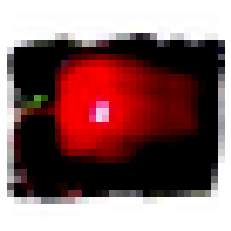

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


93


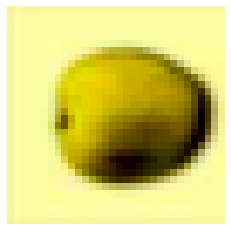

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


94


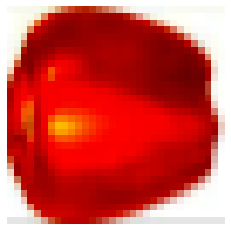

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


95


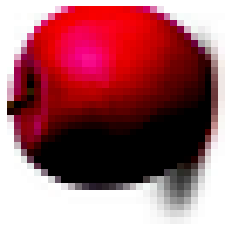

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


96


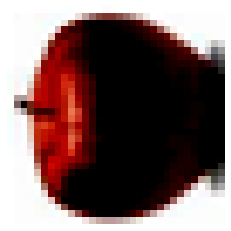

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


97


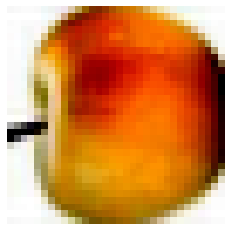

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


98


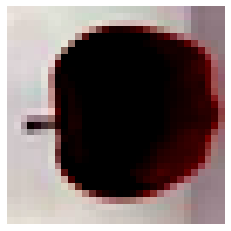

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


99


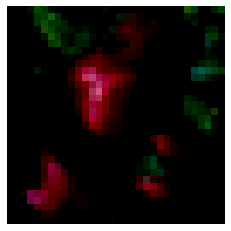

100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


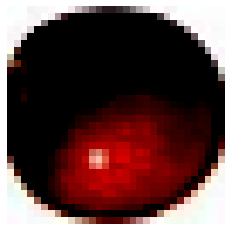

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


101


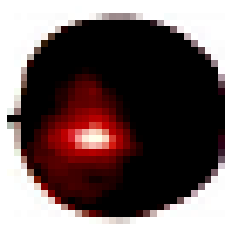

102


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


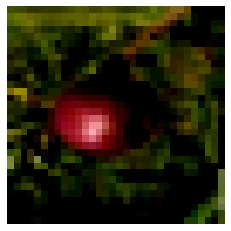

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


103


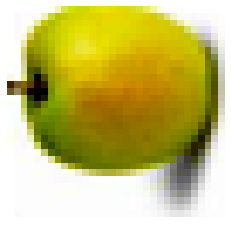

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


104


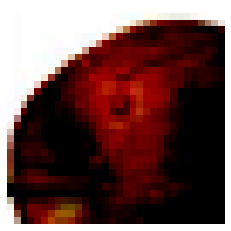

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


105


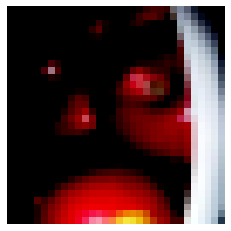

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


106


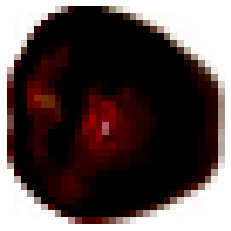

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


107


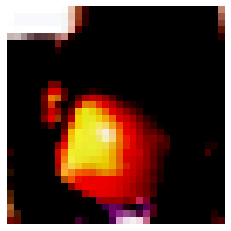

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


108


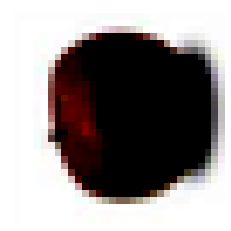

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


109


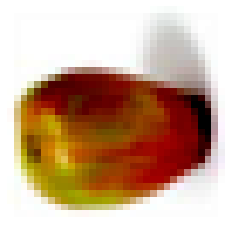

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


110


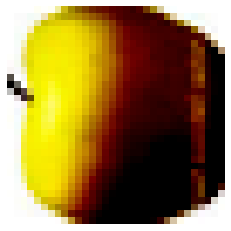

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


111


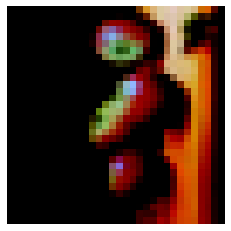

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


112


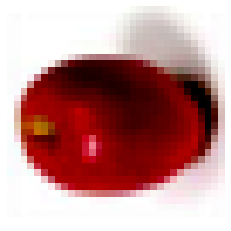

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


113


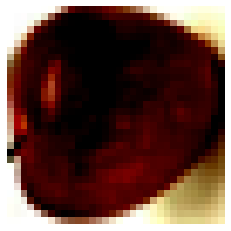

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


114


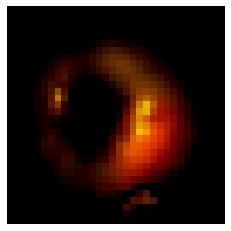

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


115


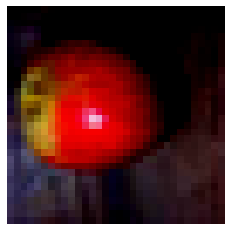

116


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


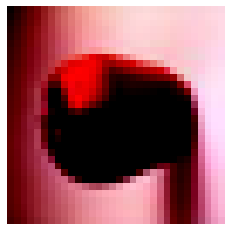

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


117


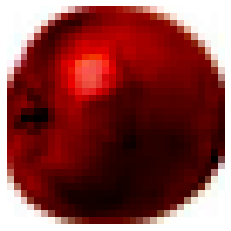

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


118


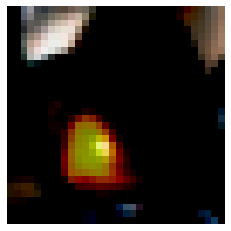

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


119


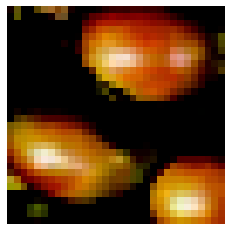

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


120


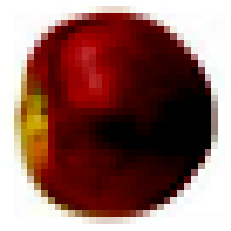

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


121


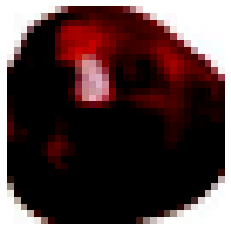

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


122


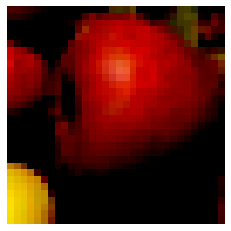

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


123


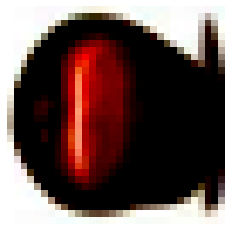

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


124


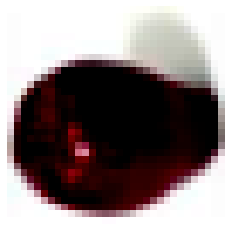

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


125


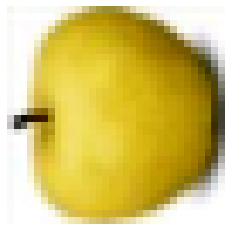

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


126


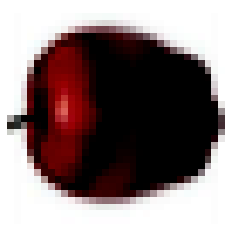

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


127


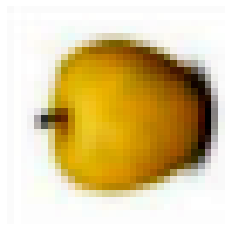

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


128


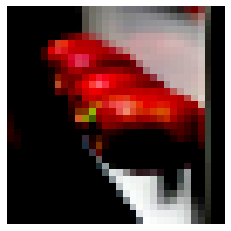

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


129


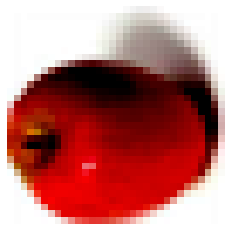

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


130


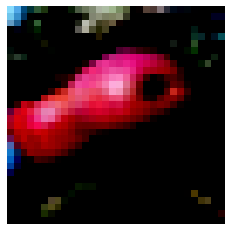

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


131


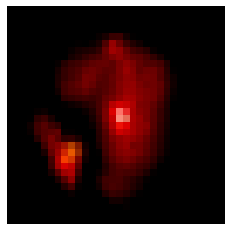

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


132


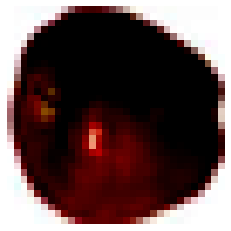

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


133


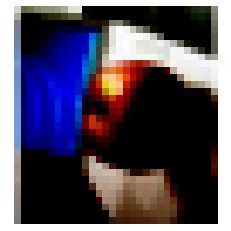

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


134


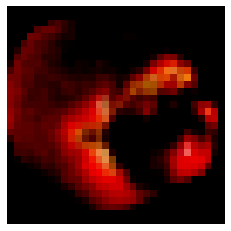

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


135


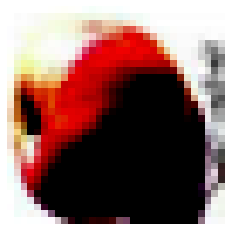

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


136


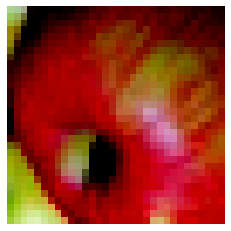

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


137


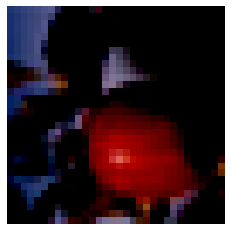

138


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


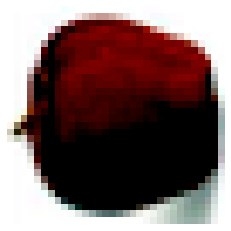

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


139


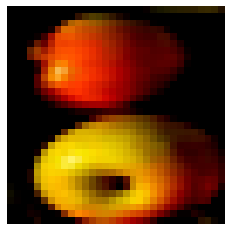

140


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


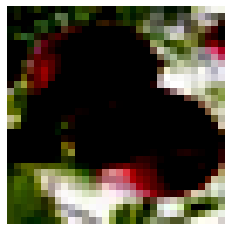

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


141


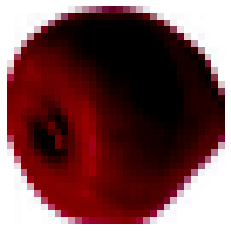

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


142


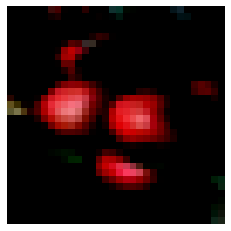

143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


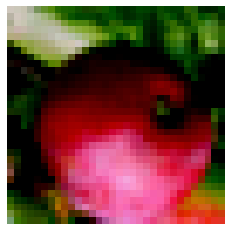

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


144


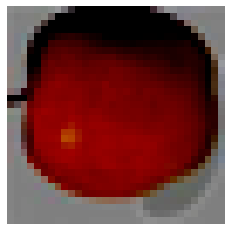

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


145


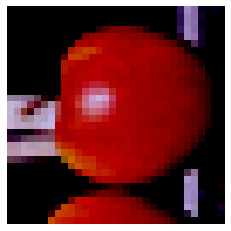

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


146


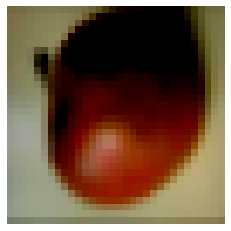

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


147


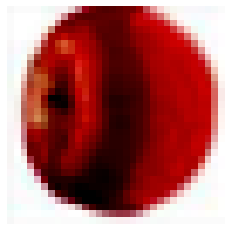

148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


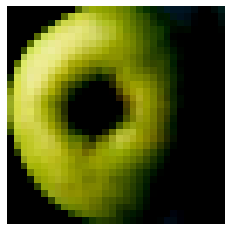

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


149


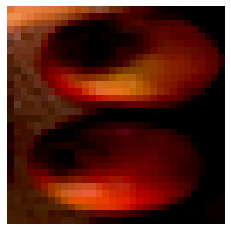

150


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


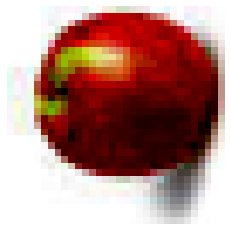

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


151


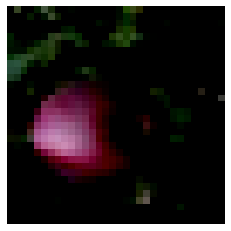

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


152


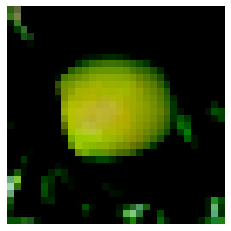

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


153


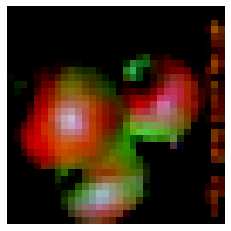

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


154


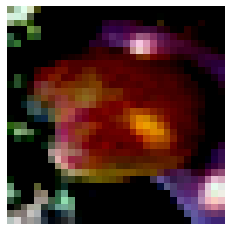

155


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


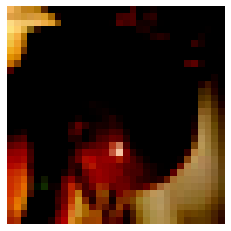

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


156


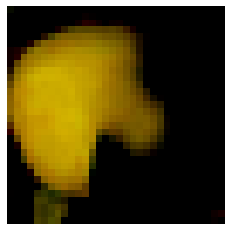

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


157


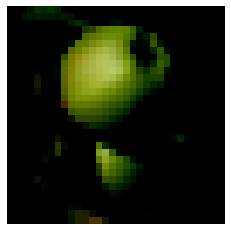

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


158


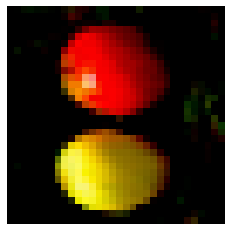

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


159


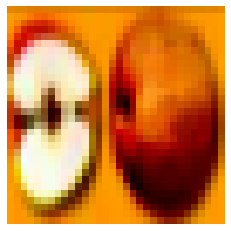

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


160


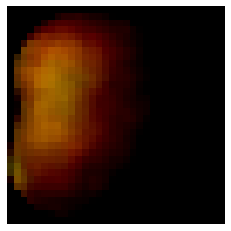

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


161


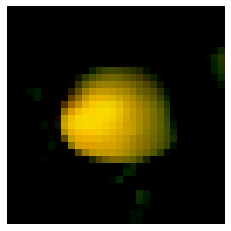

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


162


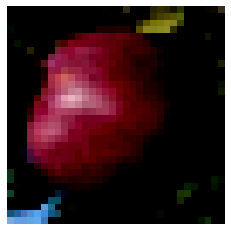

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


163


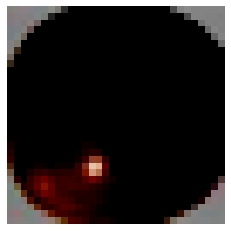

164


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


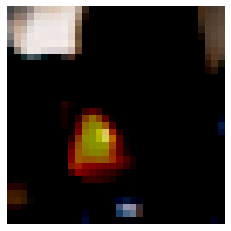

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


165


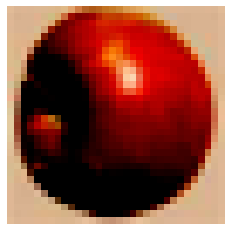

166


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


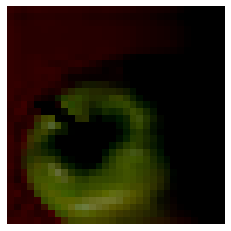

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


167


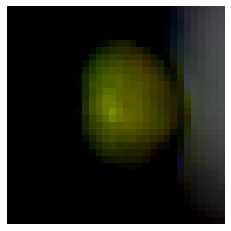

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


168


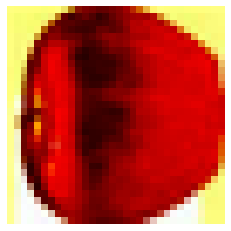

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


169


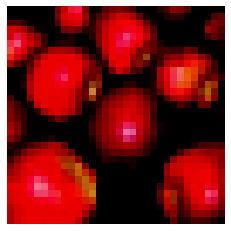

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


170


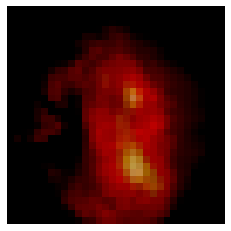

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


171


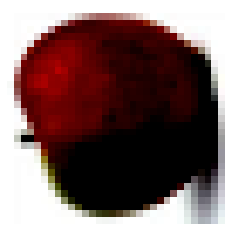

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


172


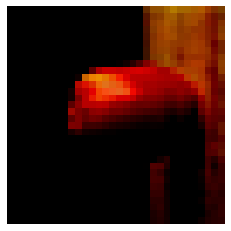

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


173


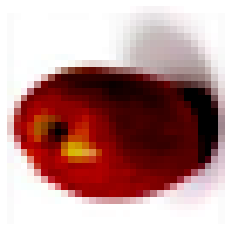

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


174


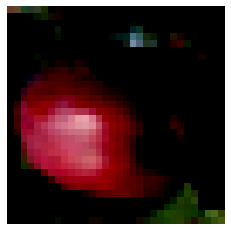

175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


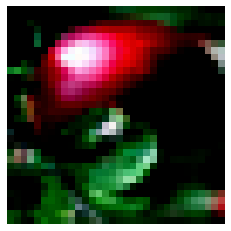

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


176


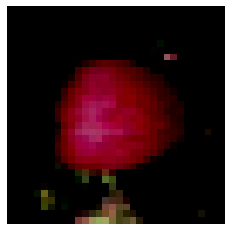

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


177


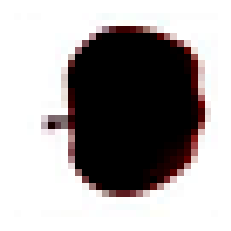

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


178


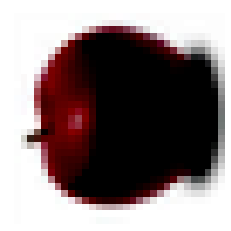

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


179


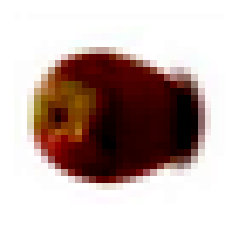

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


180


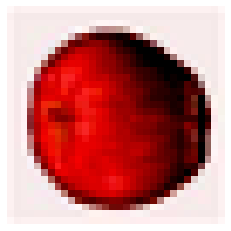

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


181


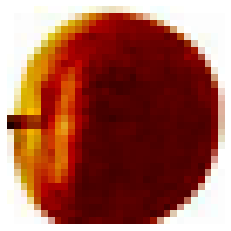

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


182


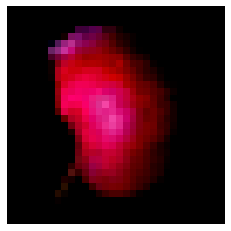

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


183


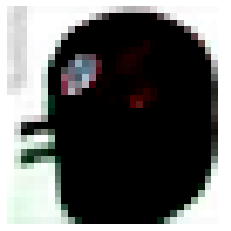

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


184


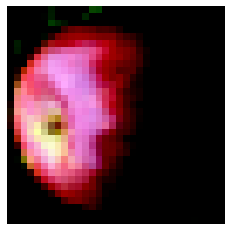

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


185


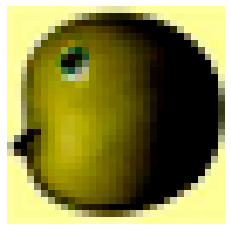

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


186


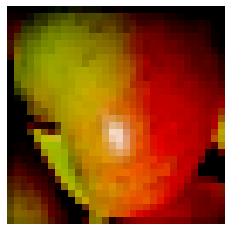

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


187


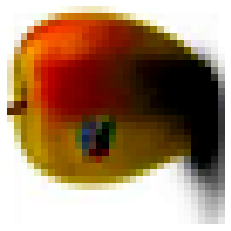

188


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


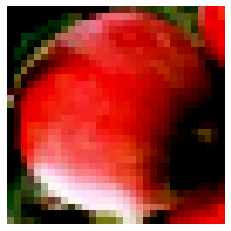

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


189


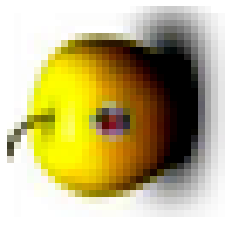

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


190


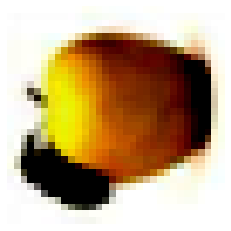

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


191


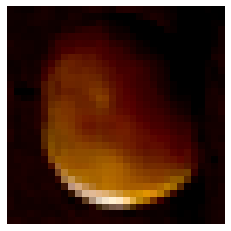

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


192


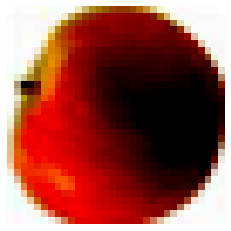

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


193


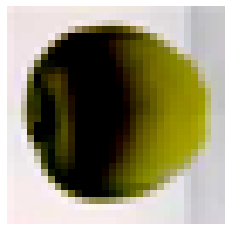

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


194


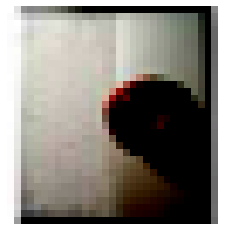

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


195


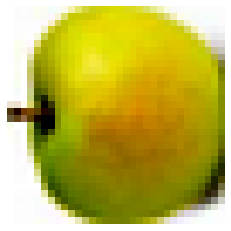

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


196


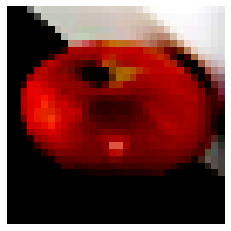

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


197


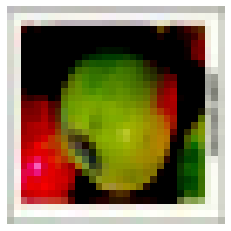

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


198


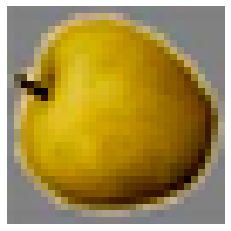

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


199


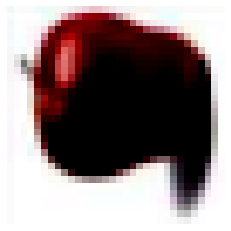

200


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


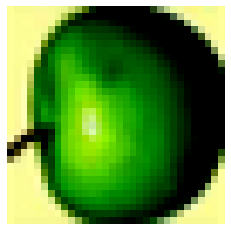

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


201


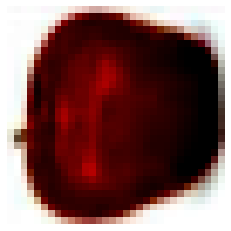

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


202


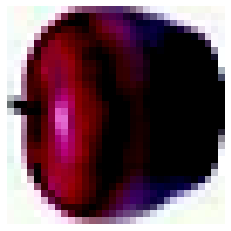

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


203


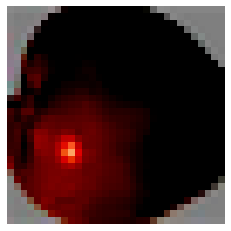

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


204


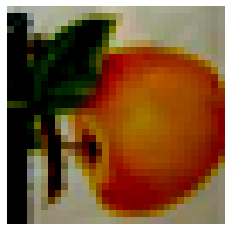

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


205


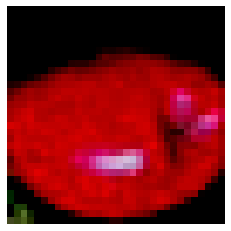

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


206


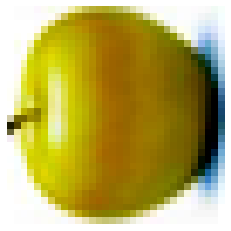

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


207


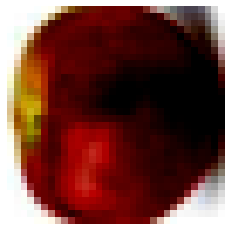

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


208


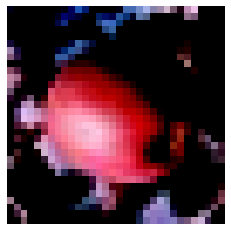

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


209


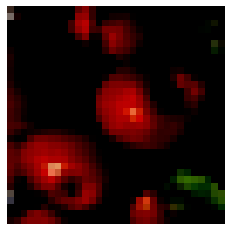

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


210


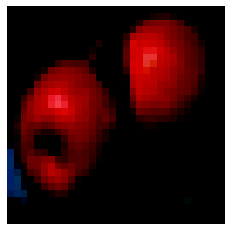

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


211


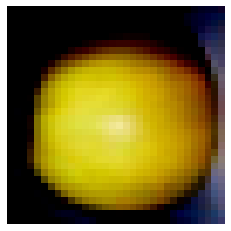

212


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


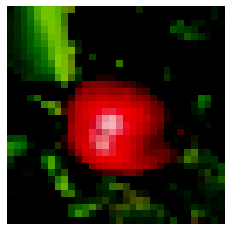

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


213


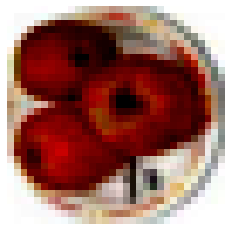

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


214


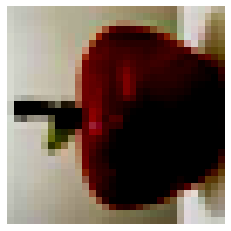

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


215


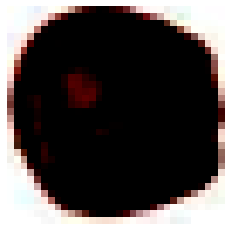

216

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


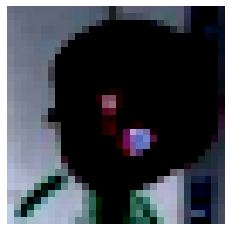

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


217


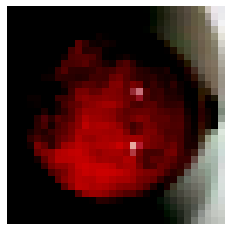

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


218


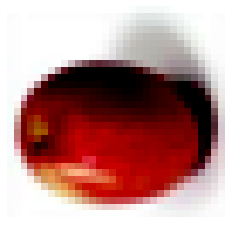

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


219


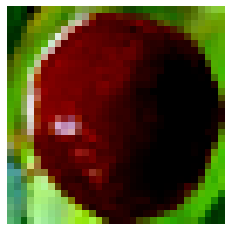

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


220


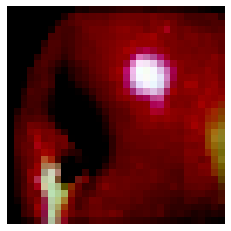

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


221


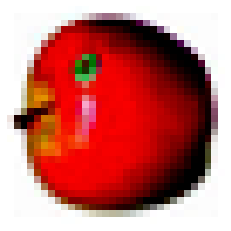

222


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


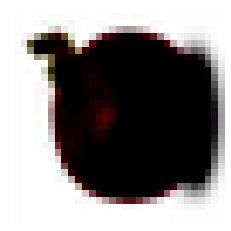

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


223


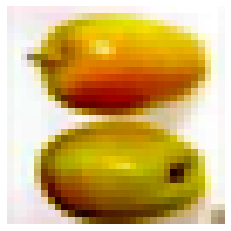

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


224


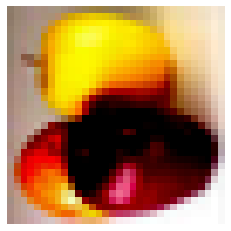

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


225


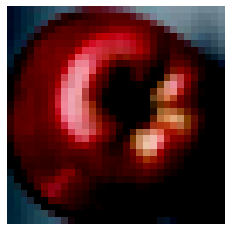

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


226


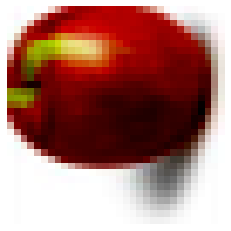

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


227


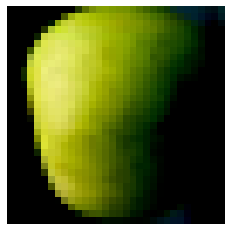

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


228


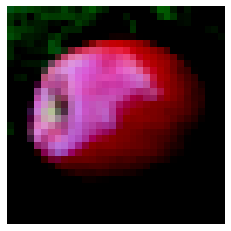

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


229


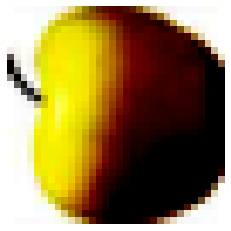

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


230


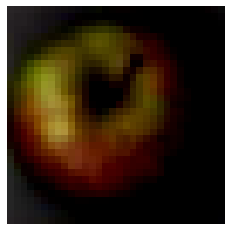

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


231


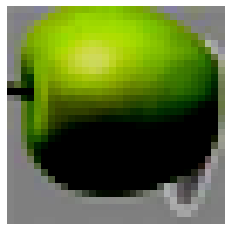

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


232


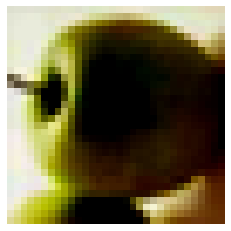

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


233


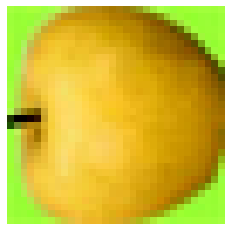

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


234


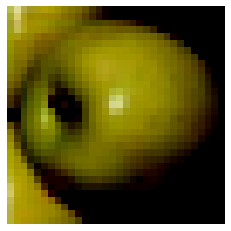

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


235


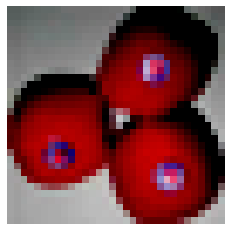

236


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


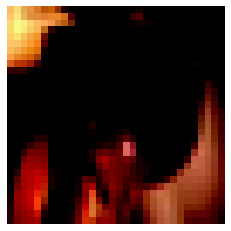

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


237


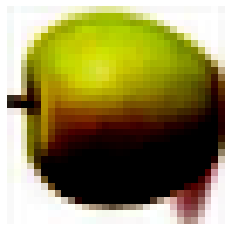

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


238


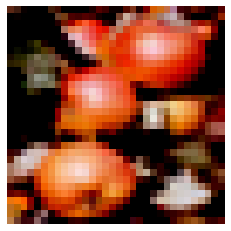

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


239


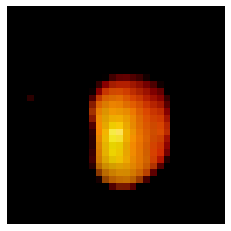

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


240


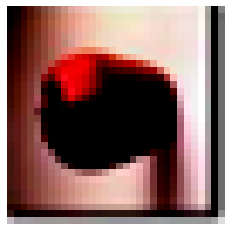

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


241


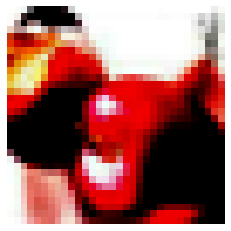

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


242


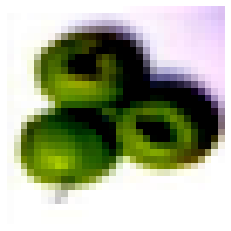

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


243


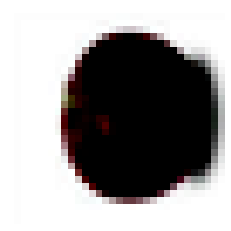

244


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


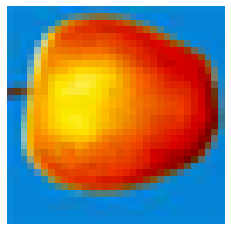

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


245


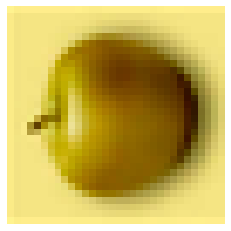

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


246


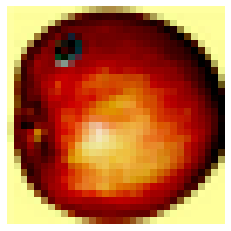

247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


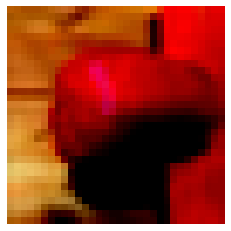

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


248


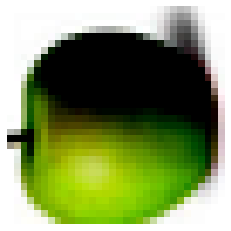

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


249


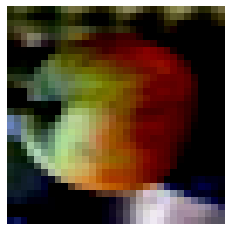

250


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


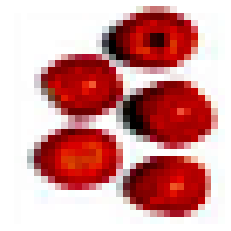

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


251


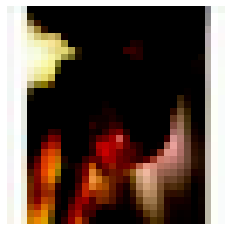

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


252


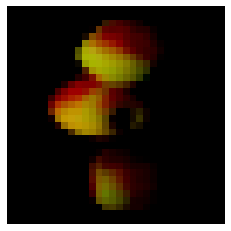

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


253


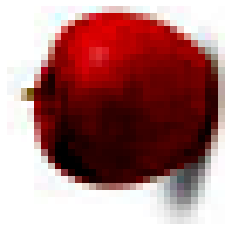

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


254


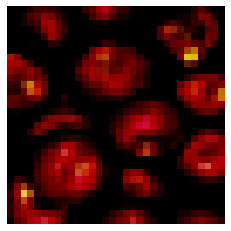

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


255


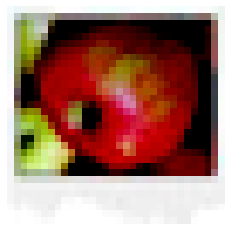

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


256


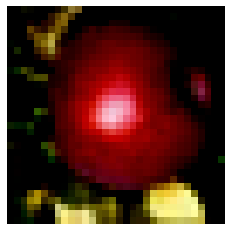

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


257


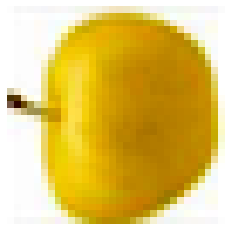

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


258


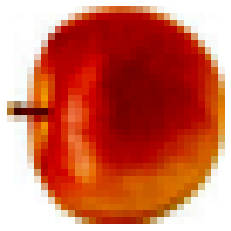

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


259


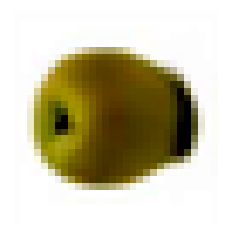

260


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


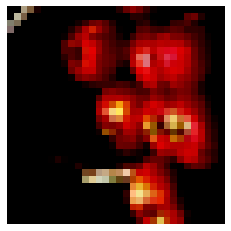

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


261


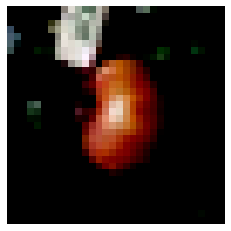

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


262


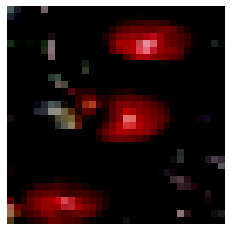

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


263


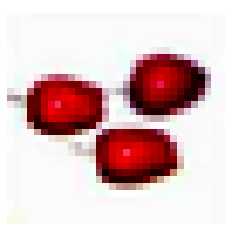

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


264


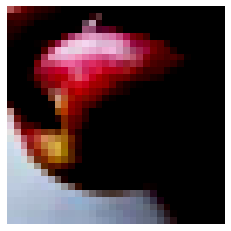

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


265


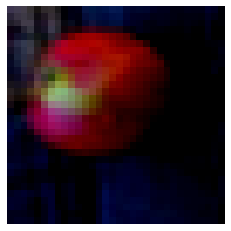

266


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


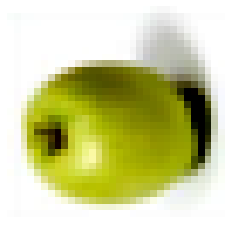

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


267


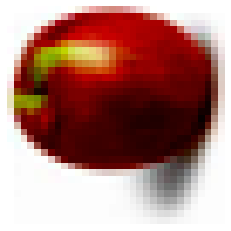

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


268


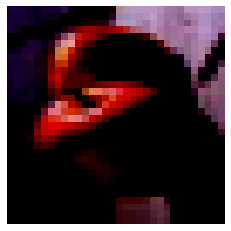

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


269


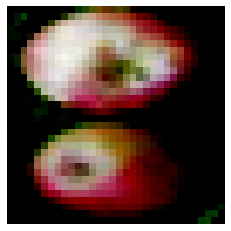

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


270


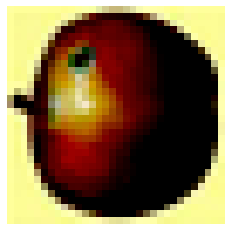

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


271


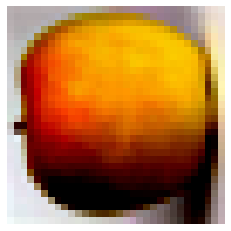

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


272


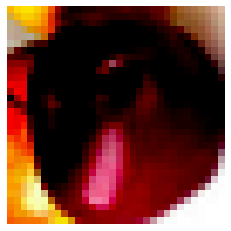

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


273


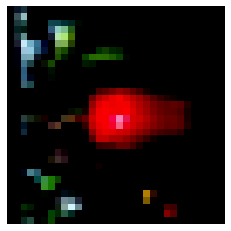

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


274


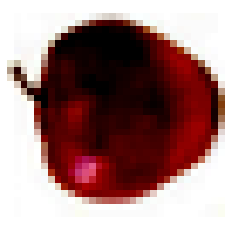

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


275


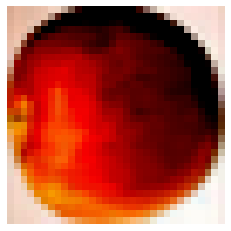

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


276


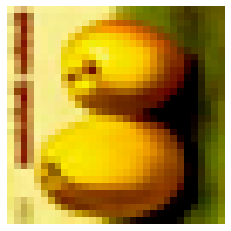

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


277


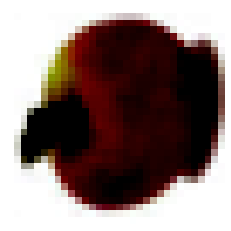

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


278


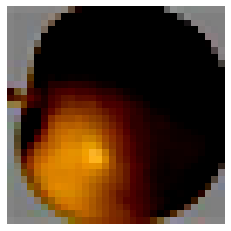

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


279


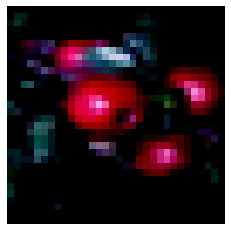

280


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


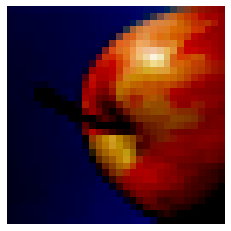

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


281


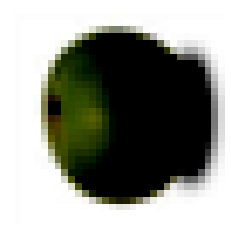

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


282


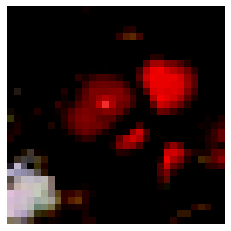

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


283


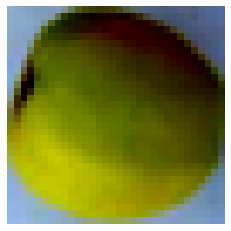

284


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


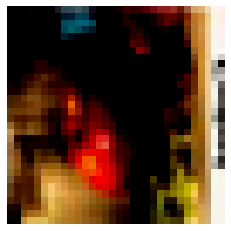

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


285


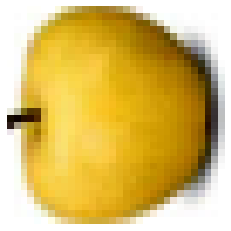

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


286


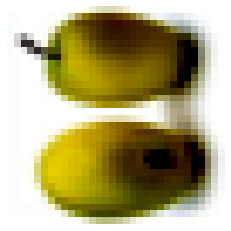

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


287


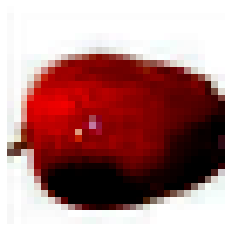

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


288


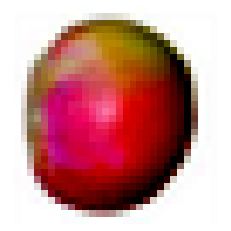

289


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


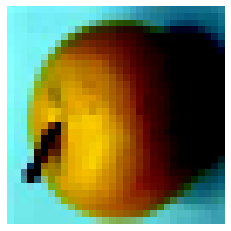

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


290


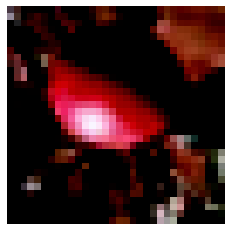

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


291


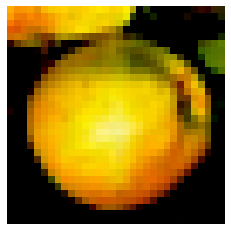

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


292


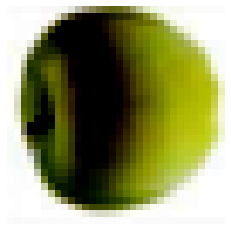

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


293


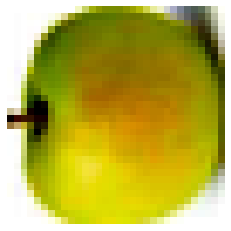

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


294


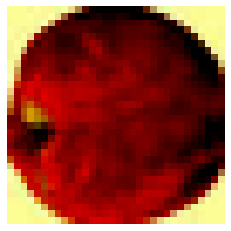

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


295


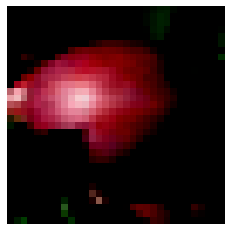

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


296


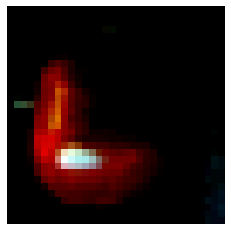

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


297


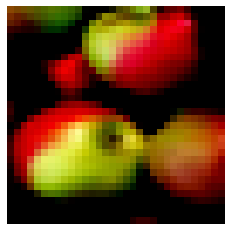

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


298


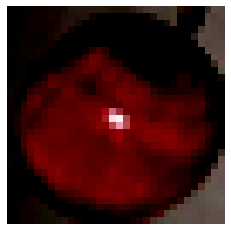

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


299


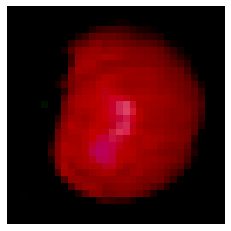

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


300


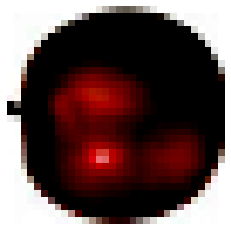

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


301


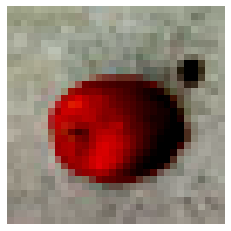

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


302


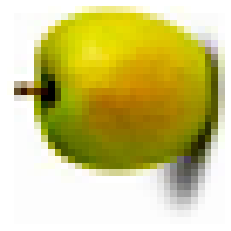

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


303


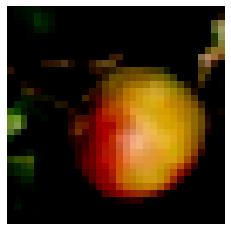

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


304


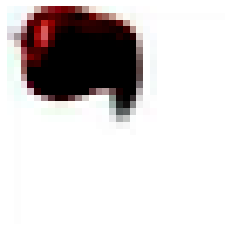

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


305


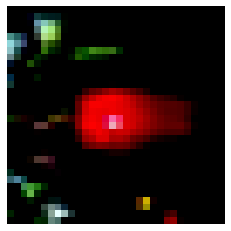

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


306


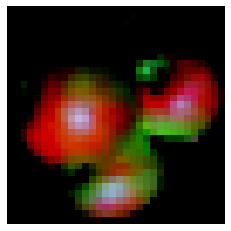

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


307


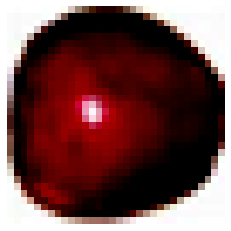

308


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


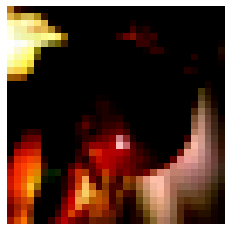

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


309


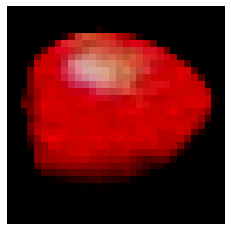

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


310


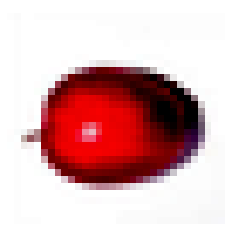

311


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


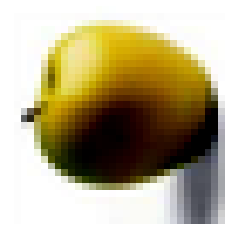

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


312


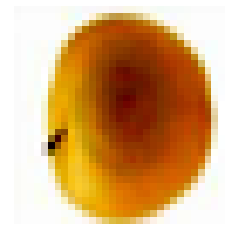

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


313


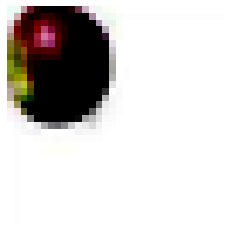

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


314


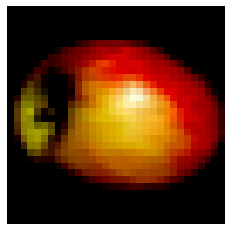

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


315


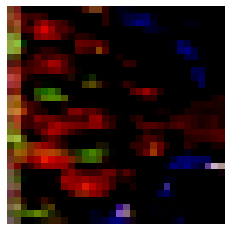

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


316


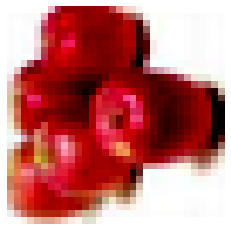

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


317


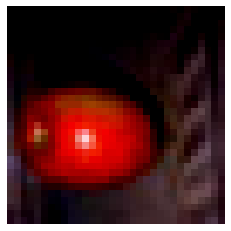

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


318


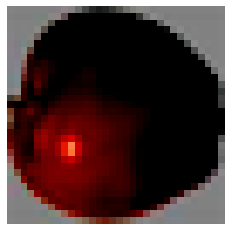

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


319


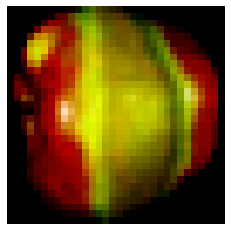

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


320


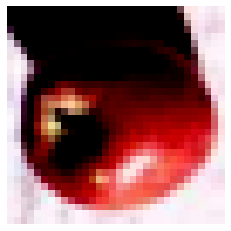

321


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


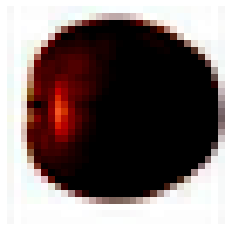

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


322


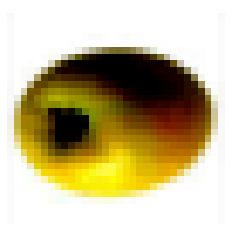

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


323


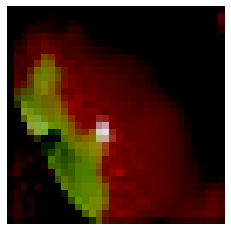

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


324


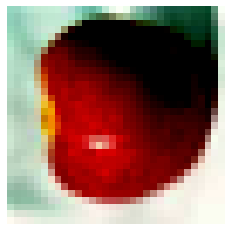

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


325


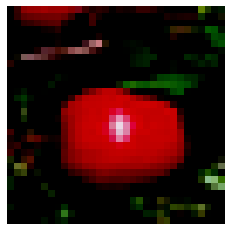

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


326


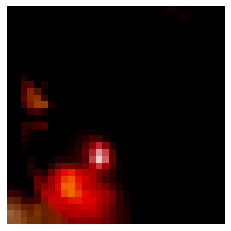

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


327


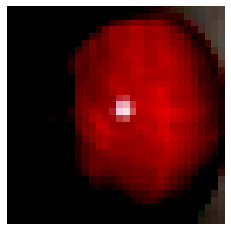

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


328


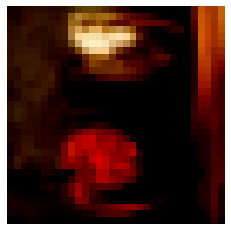

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


329


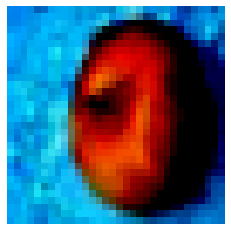

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


330


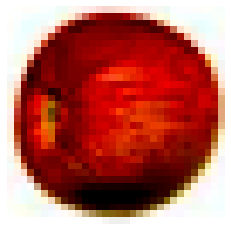

331


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


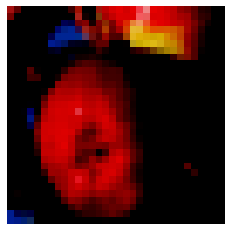

332


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


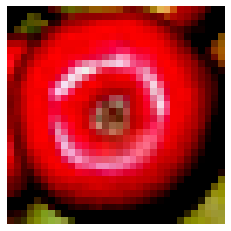

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


333


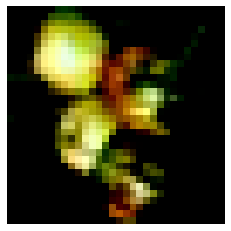

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


334


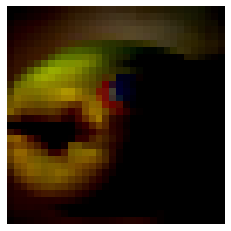

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


335


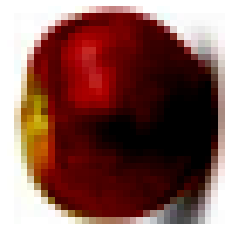

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


336


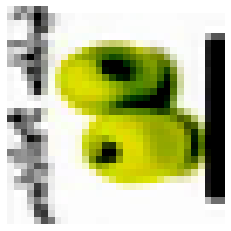

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


337


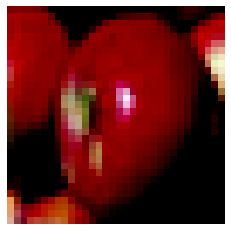

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


338


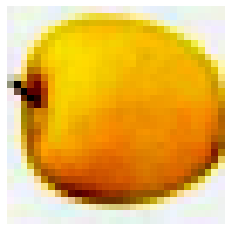

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


339


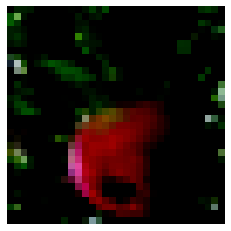

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


340


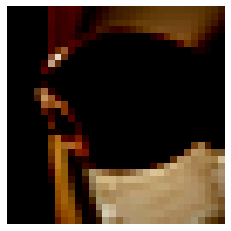

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


341


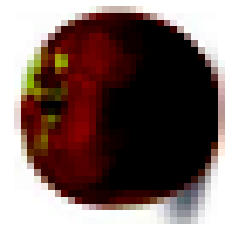

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


342


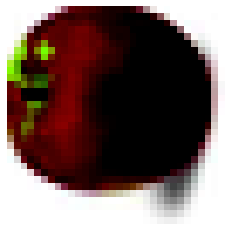

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


343


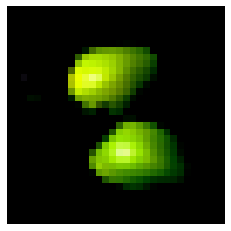

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


344


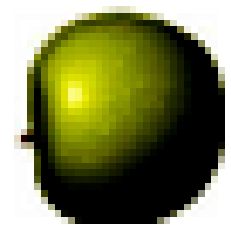

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


345


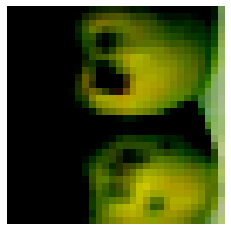

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


346


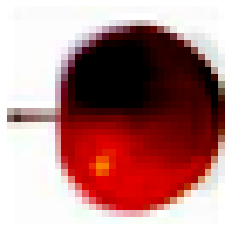

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


347


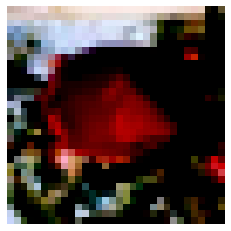

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


348


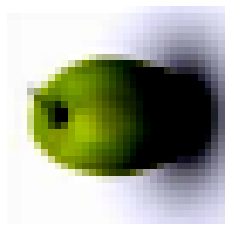

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


349


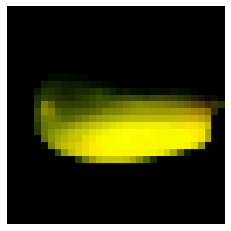

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


350


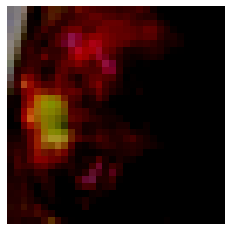

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


351


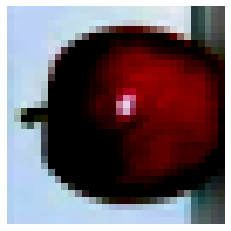

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


352


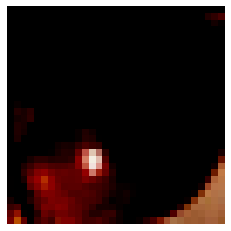

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


353


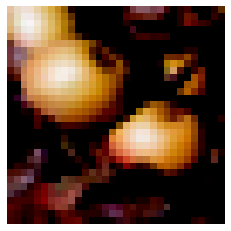

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


354


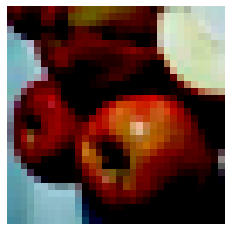

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


355


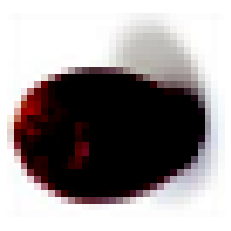

356


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


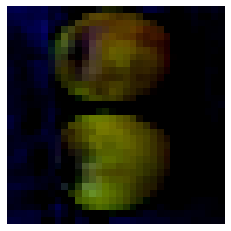

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


357


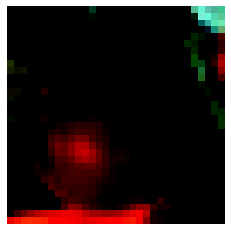

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


358


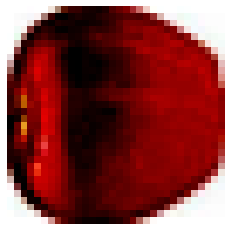

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


359


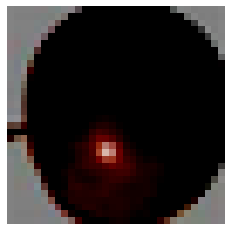

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


360


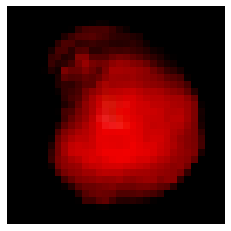

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


361


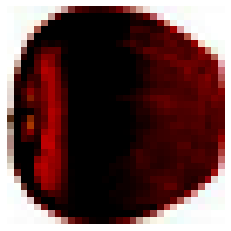

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


362


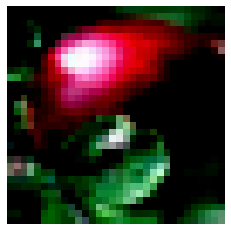

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


363


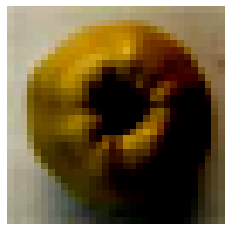

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


364


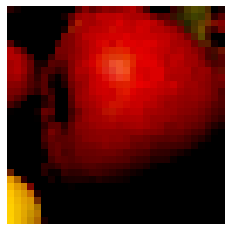

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


365


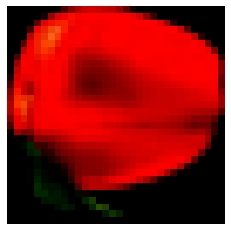

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


366


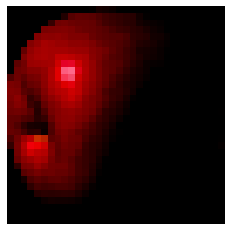

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


367


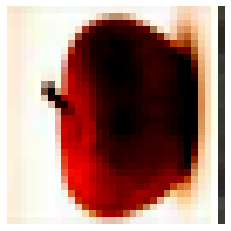

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


368


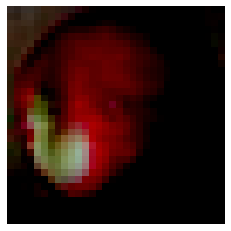

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


369


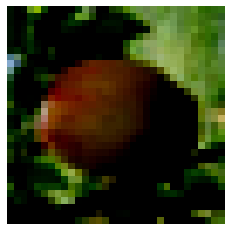

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


370


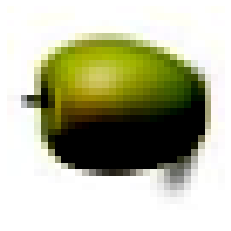

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


371


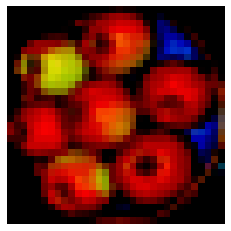

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


372


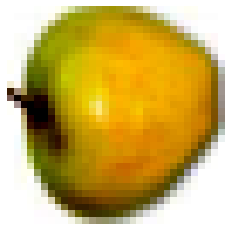

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


373


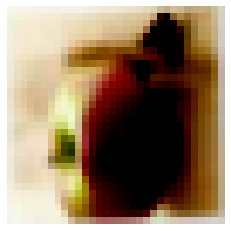

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


374


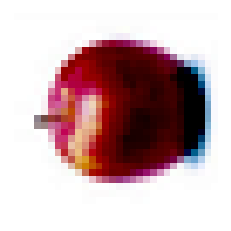

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


375


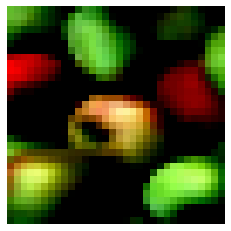

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


376


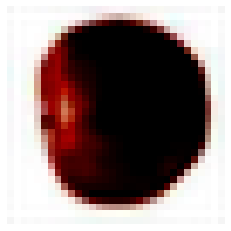

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


377


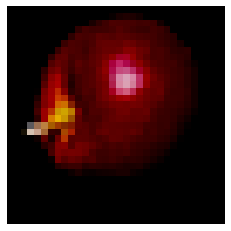

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


378


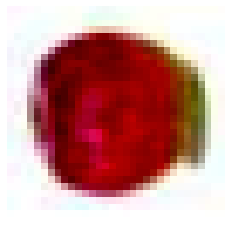

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


379


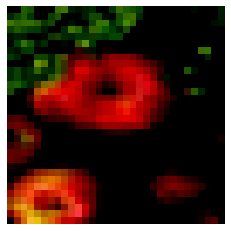

380


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


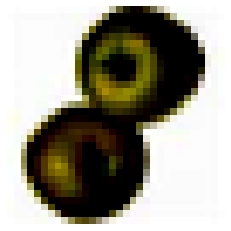

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


381


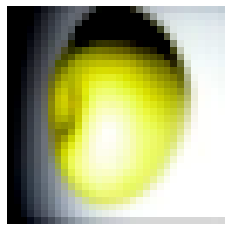

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


382


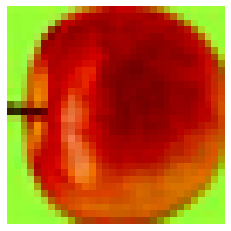

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


383


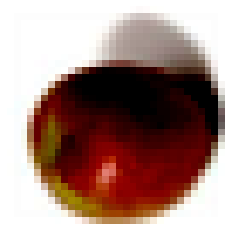

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


384


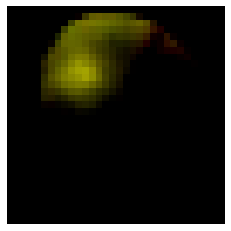

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


385


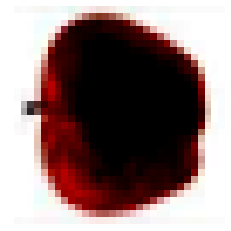

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


386


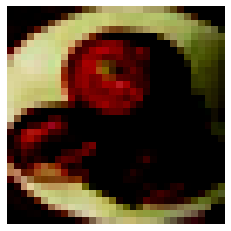

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


387


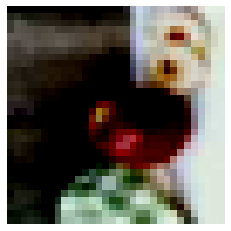

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


388


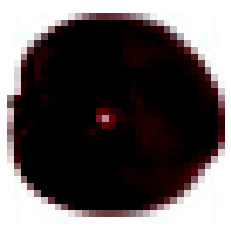

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


389


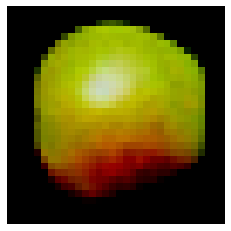

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


390


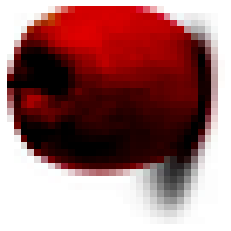

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


391


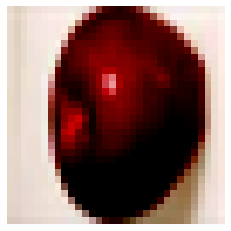

392


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


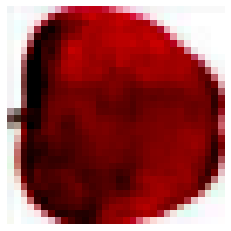

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


393


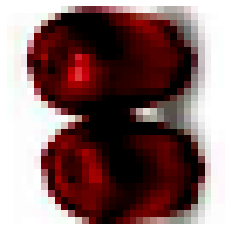

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


394


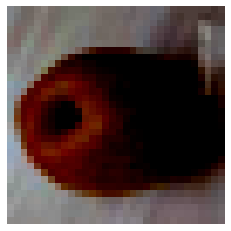

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


395


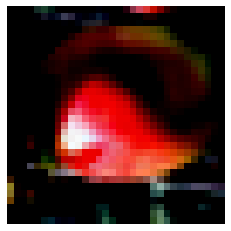

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


396


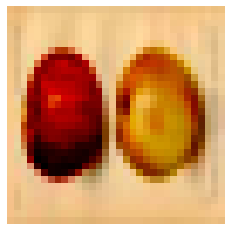

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


397


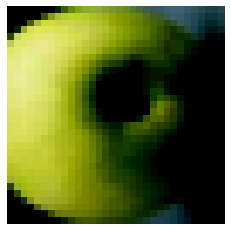

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


398


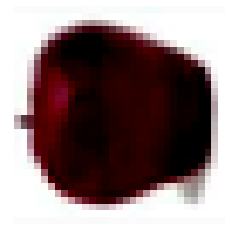

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


399


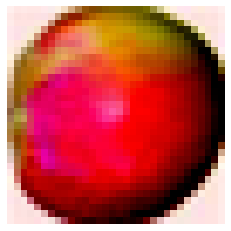

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


400


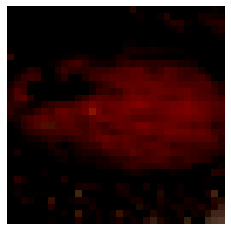

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


401


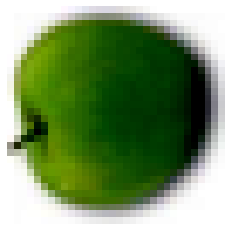

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


402


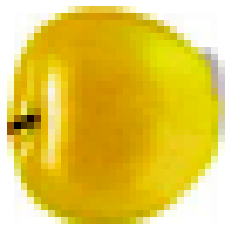

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


403


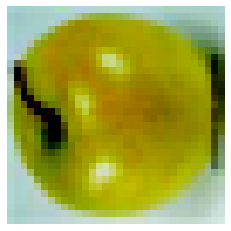

404


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


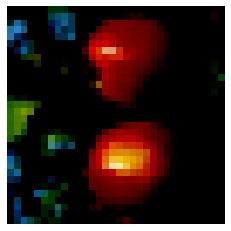

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


405


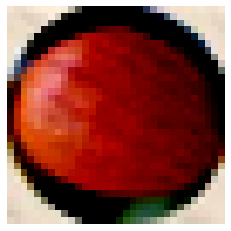

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


406


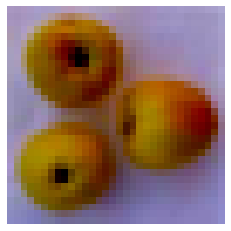

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


407


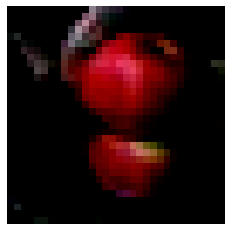

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


408


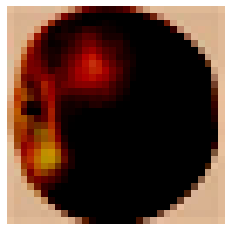

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


409


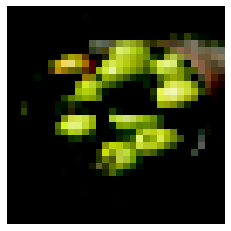

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


410


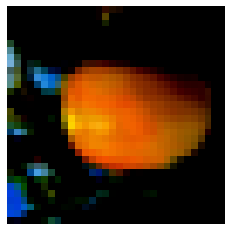

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


411


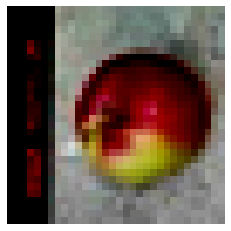

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


412


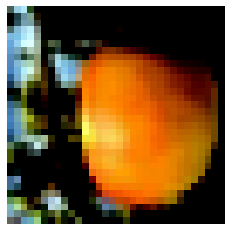

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


413


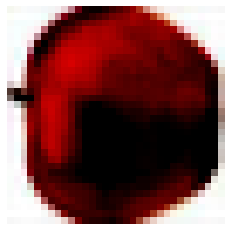

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


414


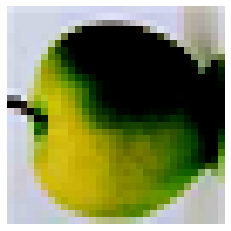

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


415


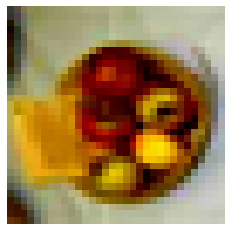

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


416


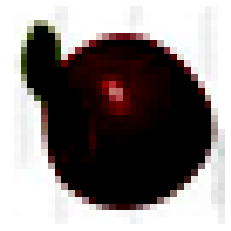

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


417


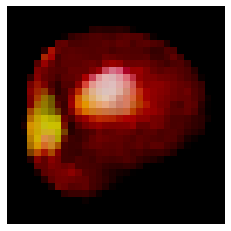

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


418


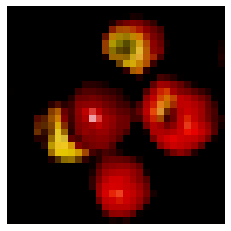

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


419


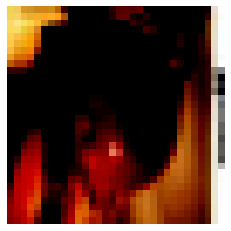

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


420


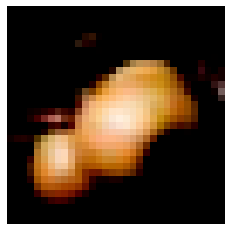

421


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


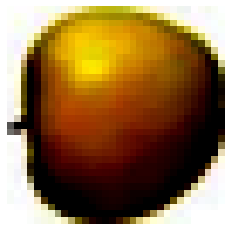

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


422


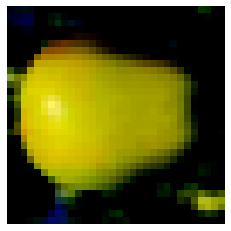

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


423


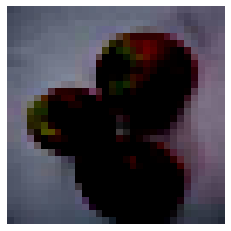

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


424


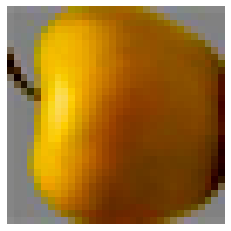

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


425


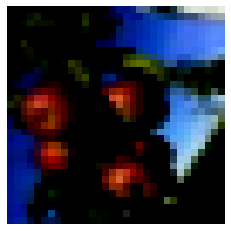

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


426


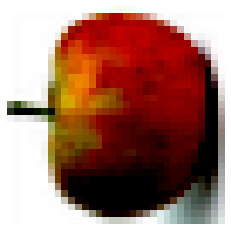

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


427


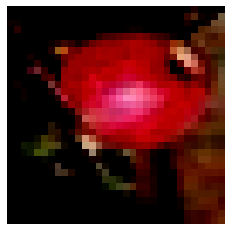

428


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


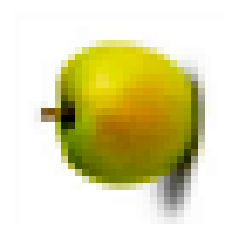

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


429


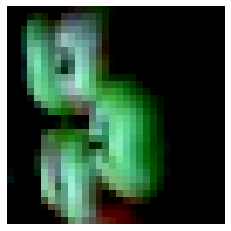

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


430


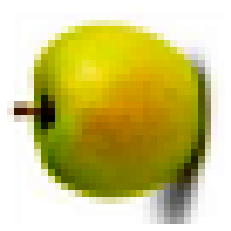

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


431


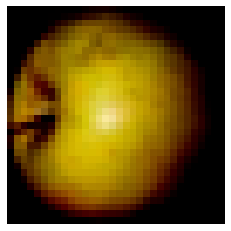

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


432


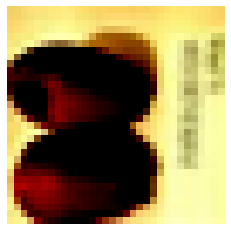

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


433


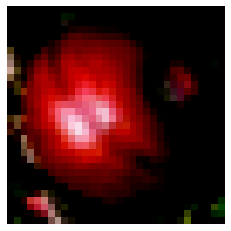

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


434


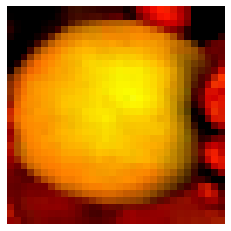

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


435


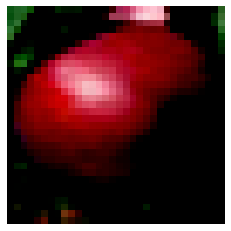

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


436


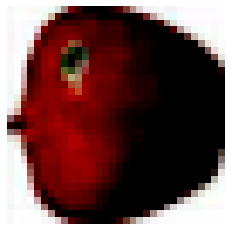

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


437


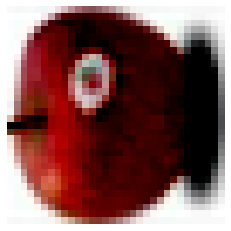

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


438


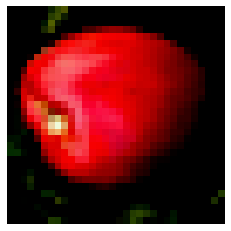

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


439


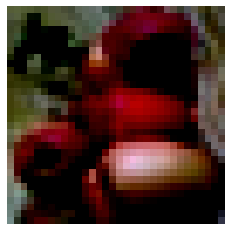

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


440


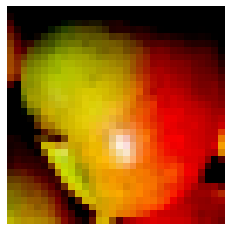

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


441


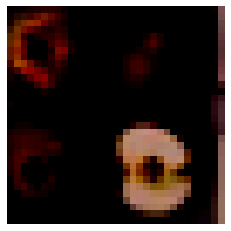

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


442


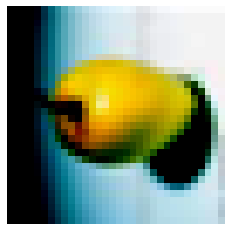

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


443


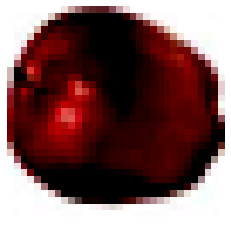

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


444


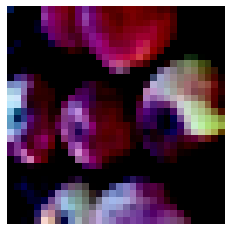

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


445


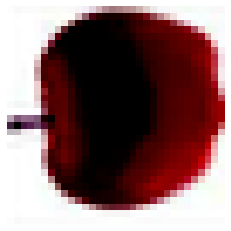

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


446


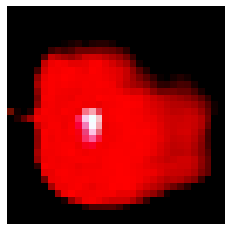

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


447


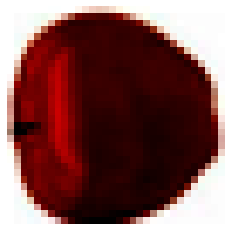

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


448


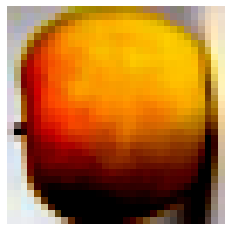

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


449


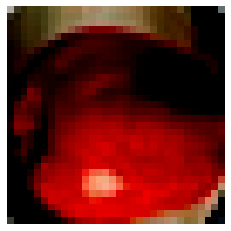

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


450


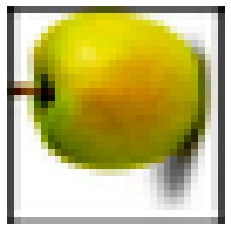

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


451


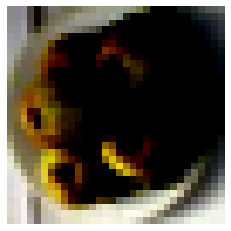

452


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


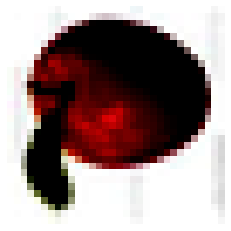

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


453


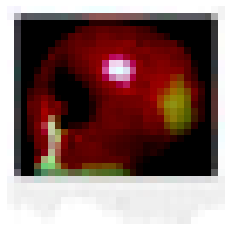

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


454


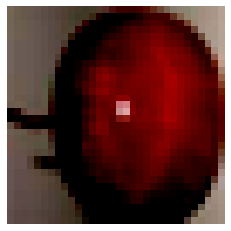

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


455


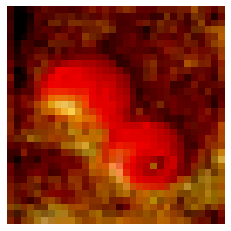

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


456


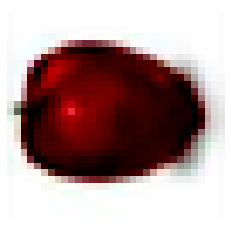

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


457


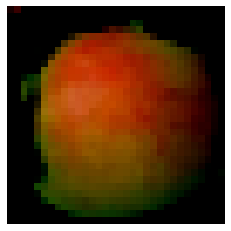

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


458


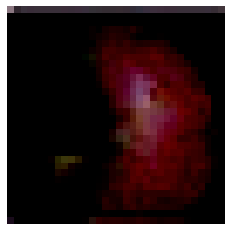

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


459


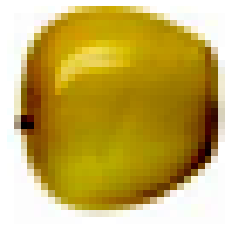

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


460


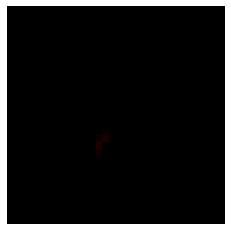

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


461


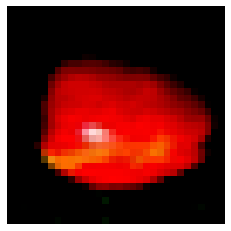

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


462


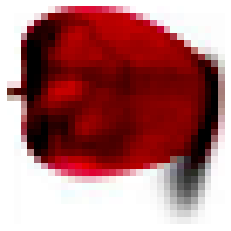

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


463


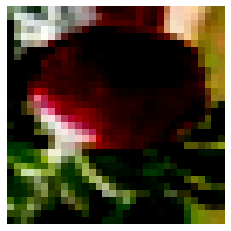

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


464


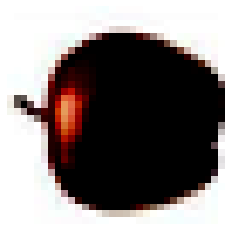

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


465


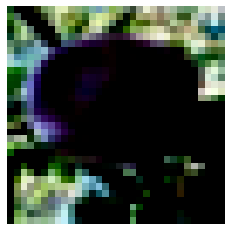

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


466


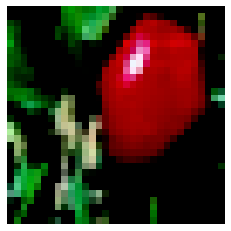

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


467


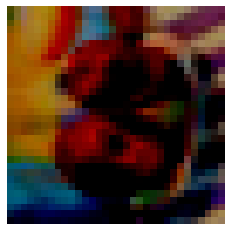

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


468


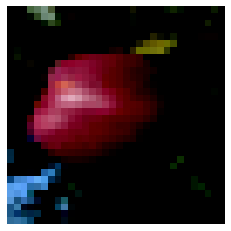

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


469


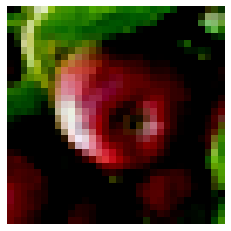

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


470


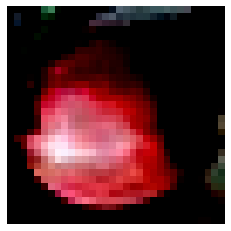

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


471


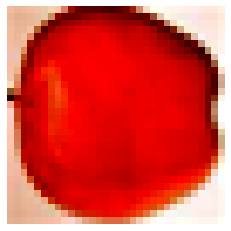

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


472


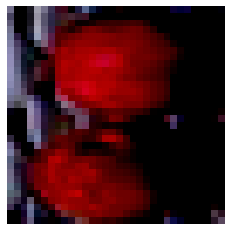

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


473


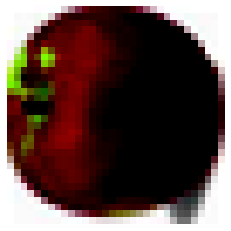

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


474


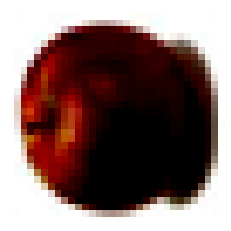

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


475


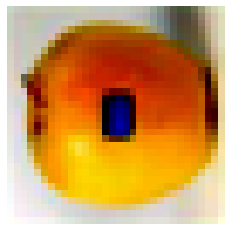

476


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


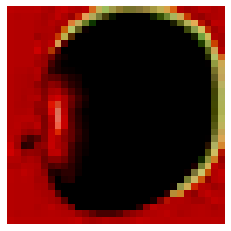

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


477


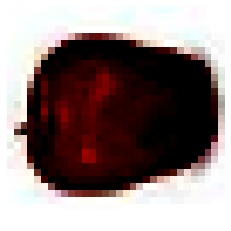

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


478


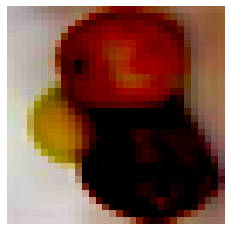

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


479


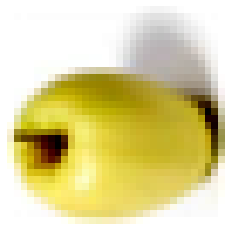

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


480


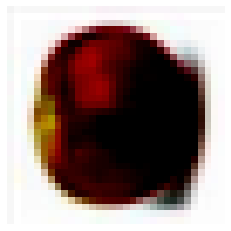

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


481


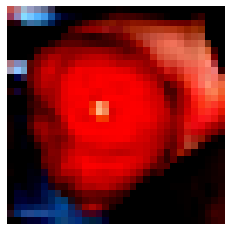

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


482


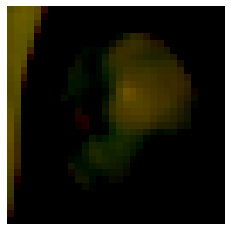

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


483


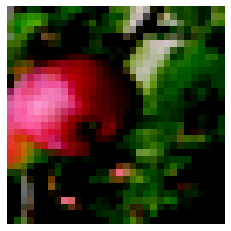

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


484


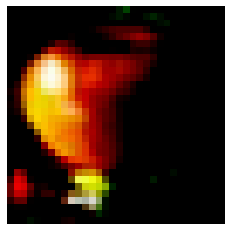

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


485


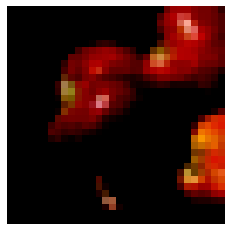

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


486


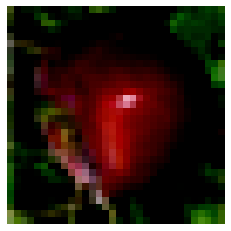

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


487


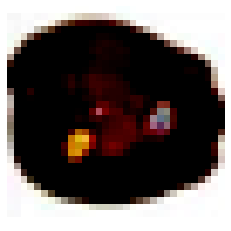

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


488


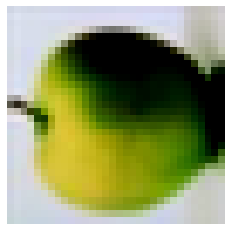

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


489


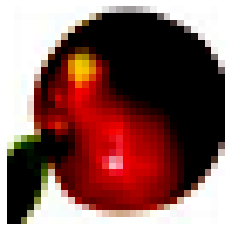

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


490


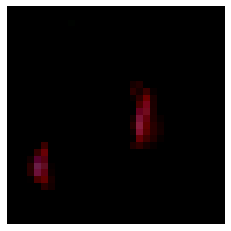

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


491


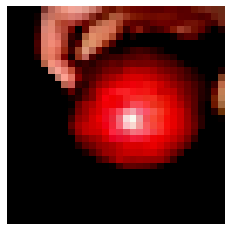

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


492


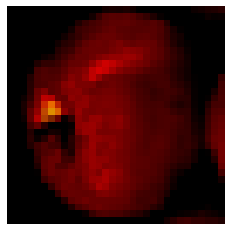

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


493


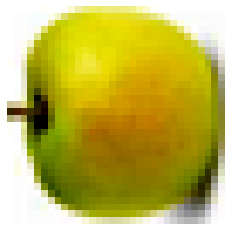

494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


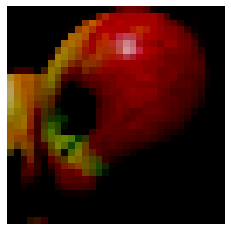

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


495


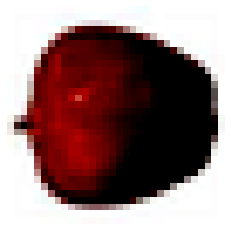

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


496


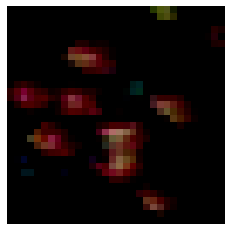

497


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


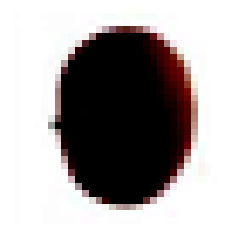

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


498


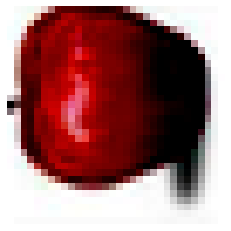

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


499


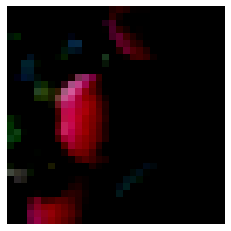

500


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


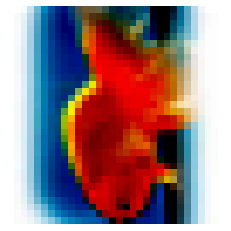

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


501


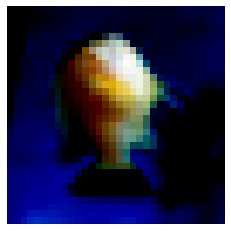

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


502


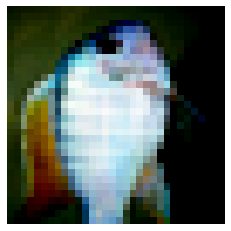

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


503


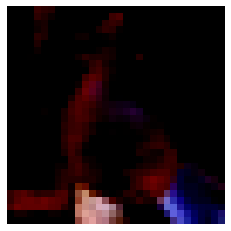

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


504


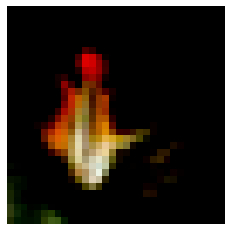

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


505


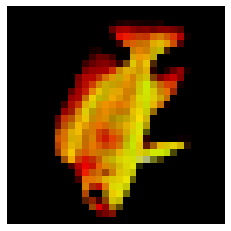

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


506


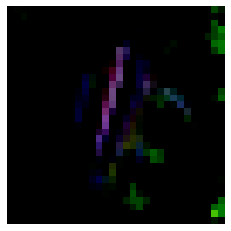

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


507


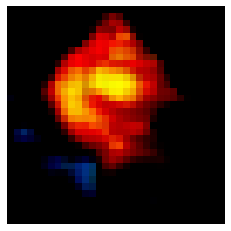

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


508


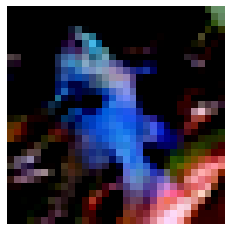

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


509


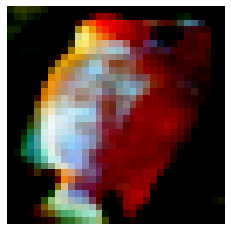

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


510


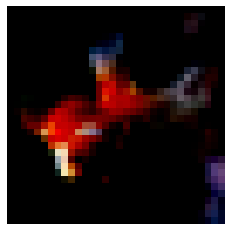

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


511


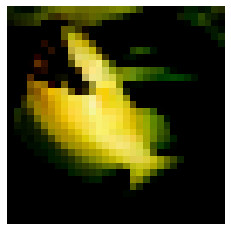

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


512


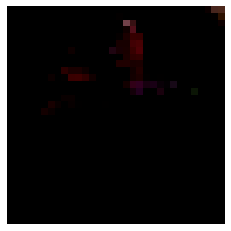

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


513


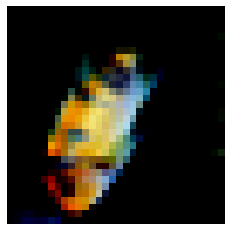

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


514


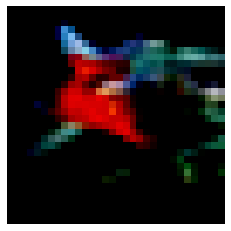

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


515


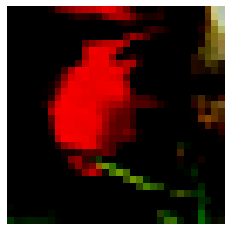

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


516


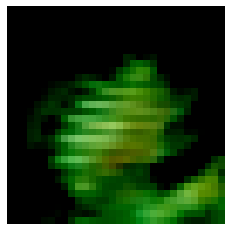

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


517


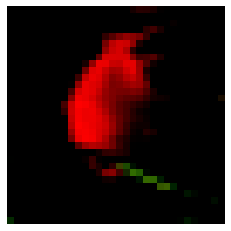

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


518


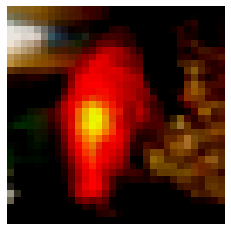

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


519


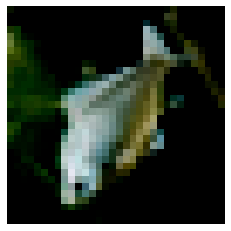

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


520


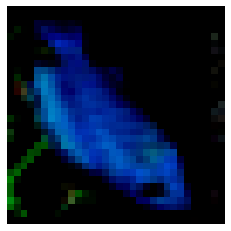

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


521


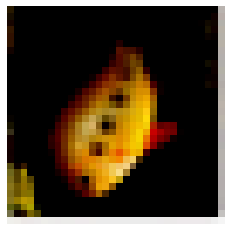

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


522


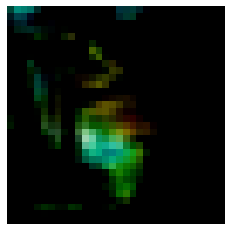

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


523


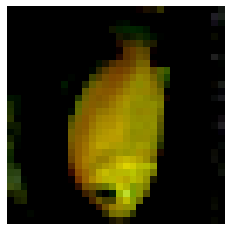

524


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


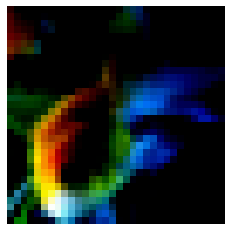

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


525


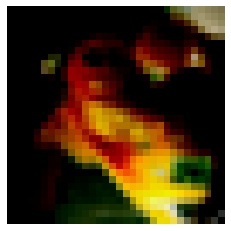

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


526


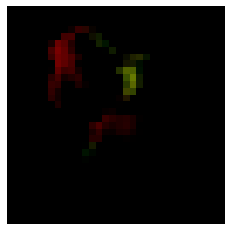

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


527


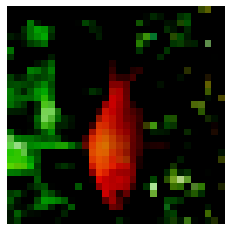

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


528


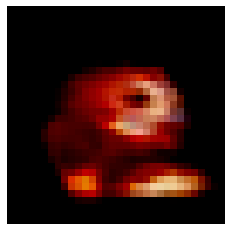

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


529


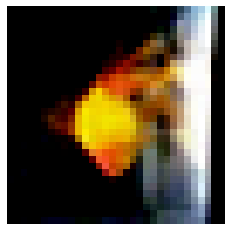

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


530


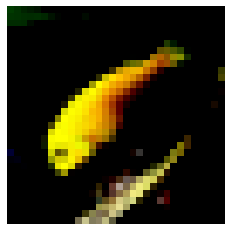

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


531


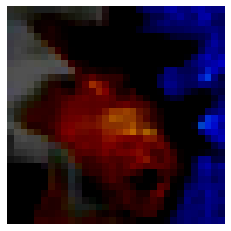

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


532


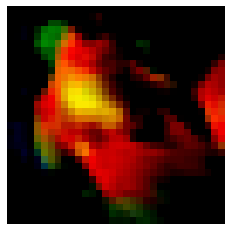

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


533


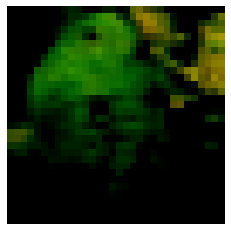

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


534


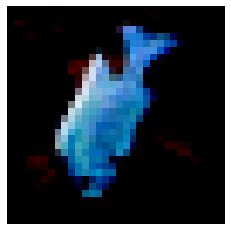

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


535


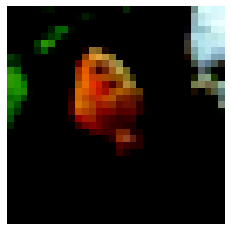

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


536


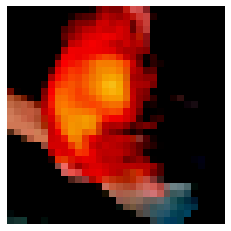

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


537


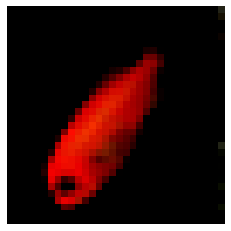

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


538


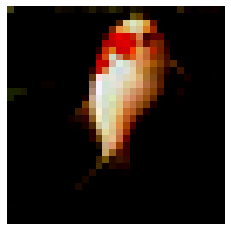

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


539


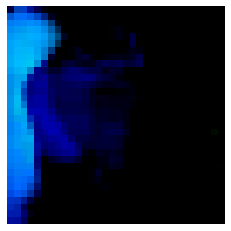

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


540


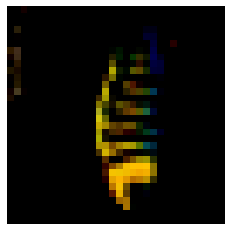

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


541


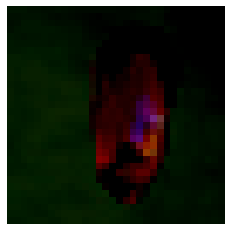

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


542


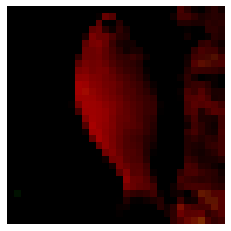

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


543


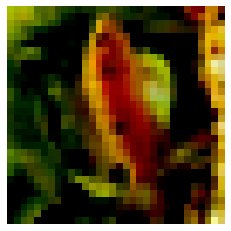

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


544


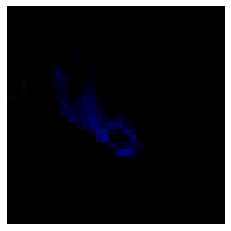

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


545


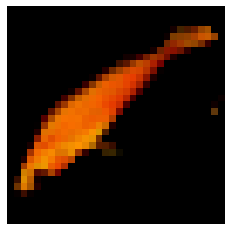

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


546


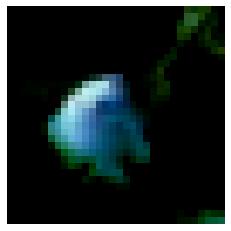

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


547


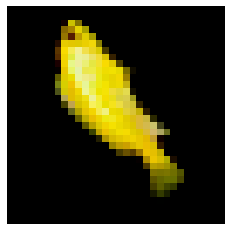

548


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


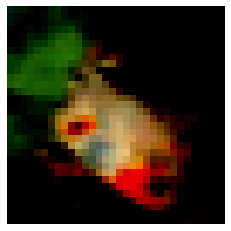

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


549


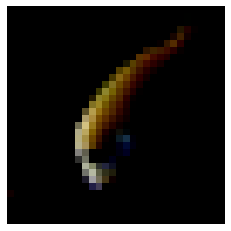

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


550


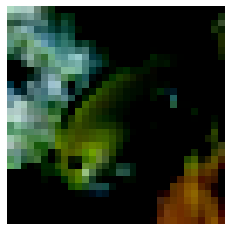

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


551


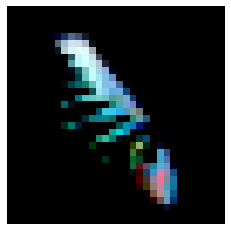

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


552


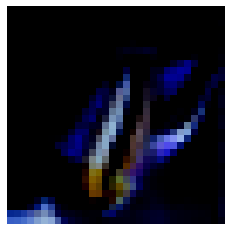

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


553


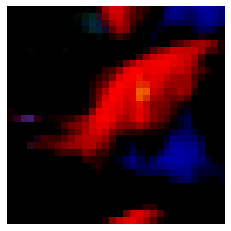

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


554


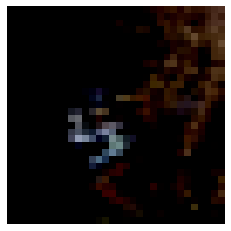

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


555


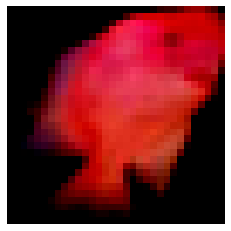

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


556


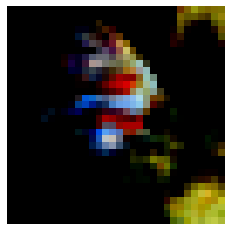

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


557


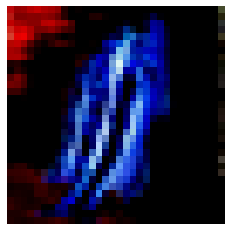

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


558


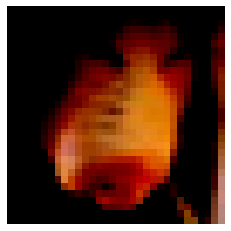

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


559


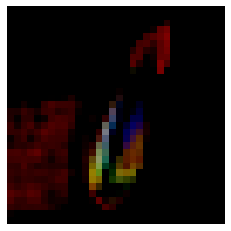

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


560


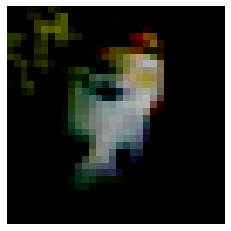

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


561


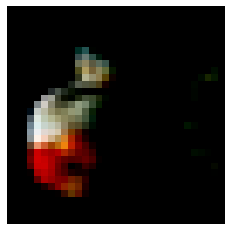

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


562


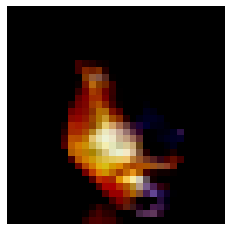

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


563


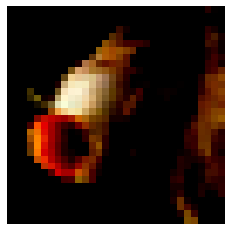

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


564


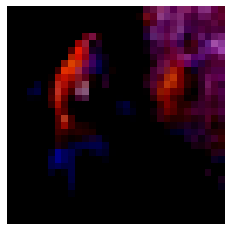

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


565


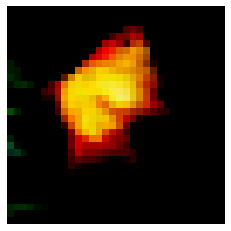

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


566


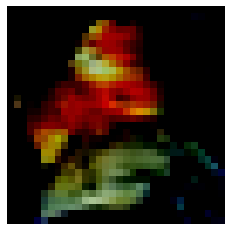

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


567


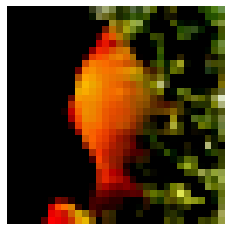

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


568


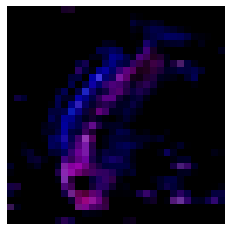

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


569


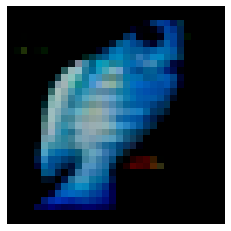

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


570


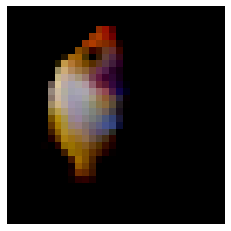

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


571


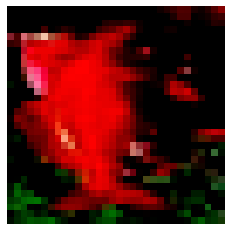

572


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


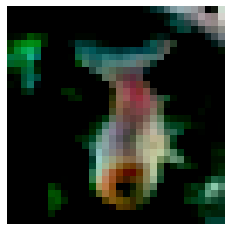

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


573


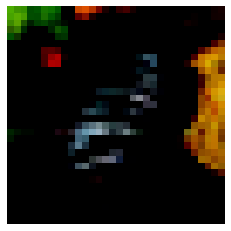

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


574


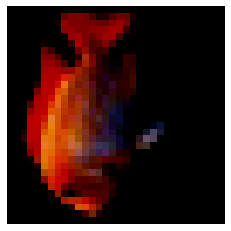

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


575


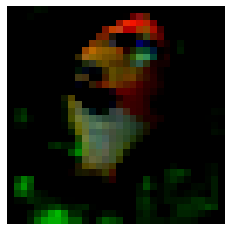

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


576


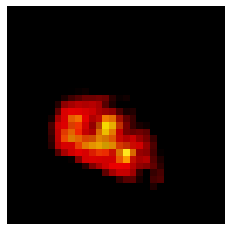

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


577


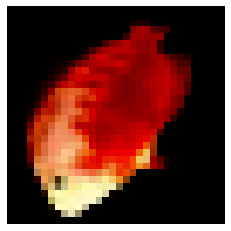

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


578


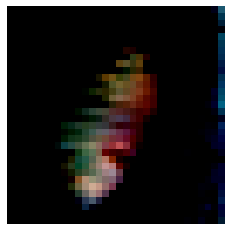

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


579


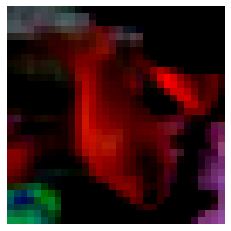

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


580


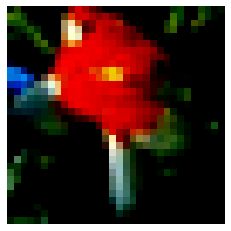

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


581


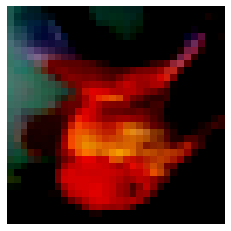

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


582


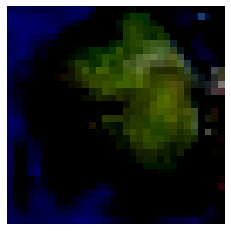

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


583


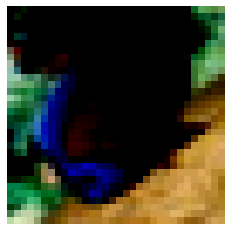

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


584


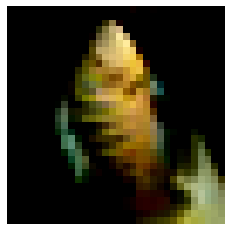

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


585


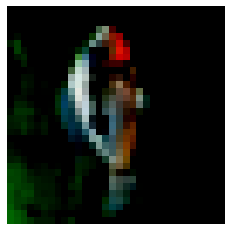

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


586


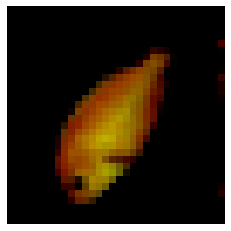

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


587


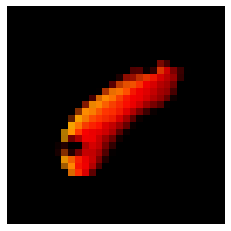

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


588


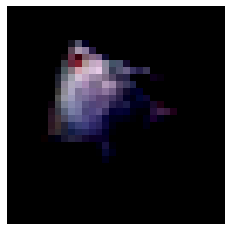

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


589


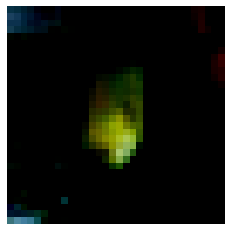

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


590


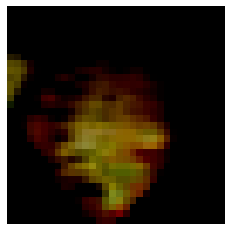

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


591


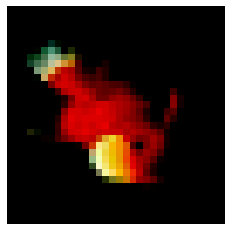

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


592


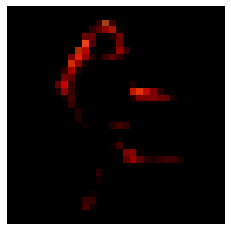

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


593


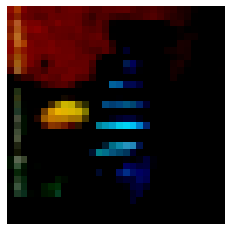

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


594


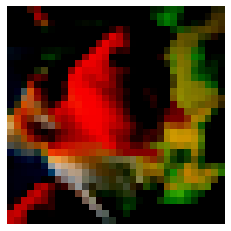

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


595


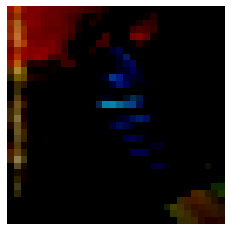

596


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


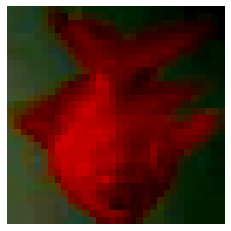

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


597


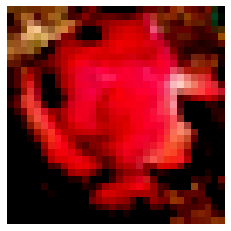

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


598


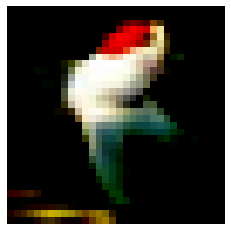

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


599


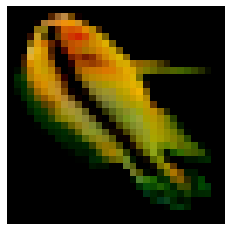

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


600


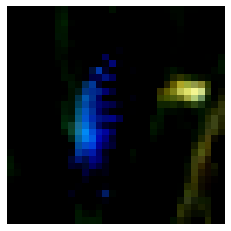

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


601


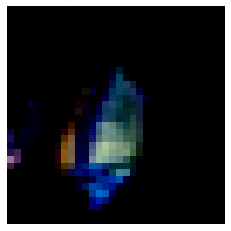

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


602


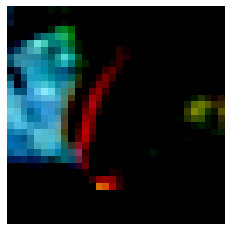

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


603


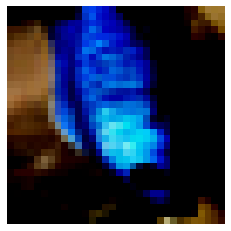

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


604


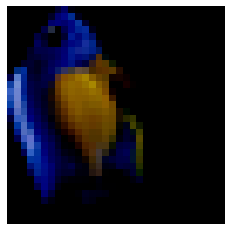

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


605


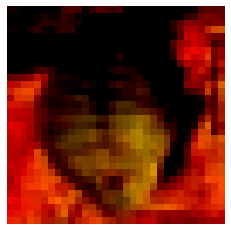

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


606


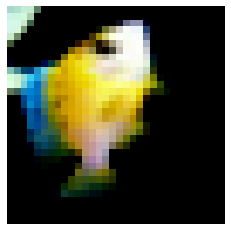

607


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


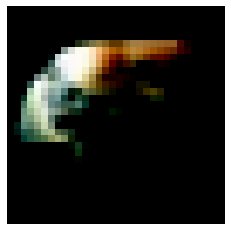

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


608


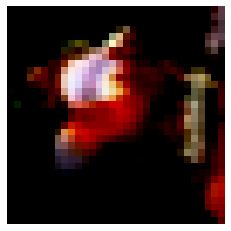

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


609


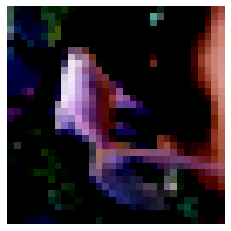

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


610


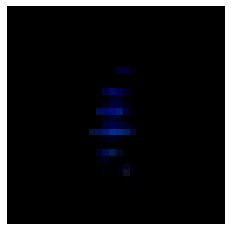

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


611


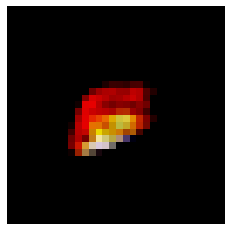

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


612


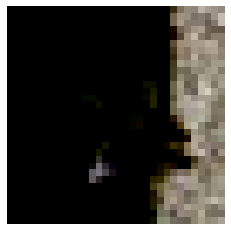

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


613


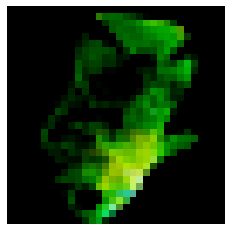

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


614


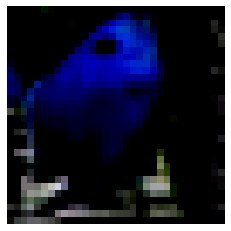

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


615


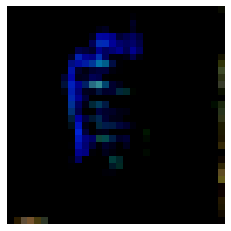

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


616


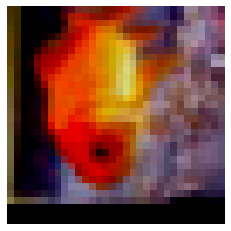

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


617


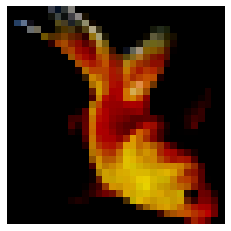

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


618


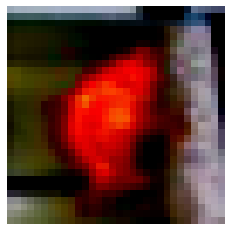

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


619


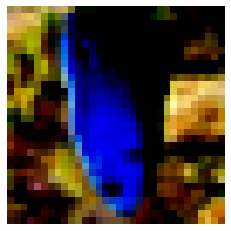

620


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


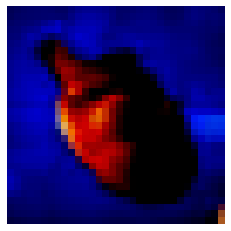

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


621


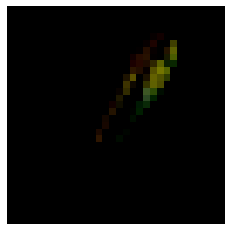

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


622


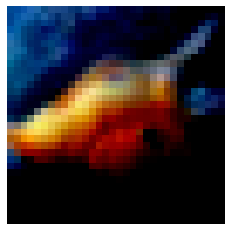

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


623


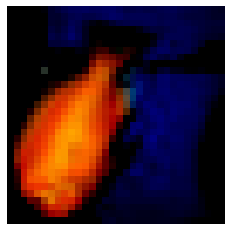

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


624


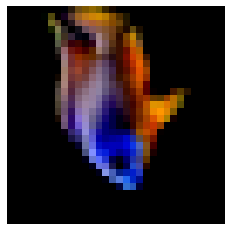

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


625


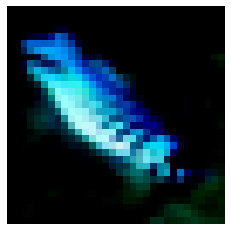

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


626


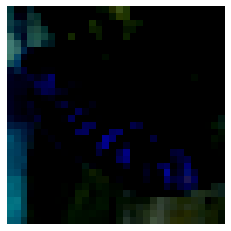

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


627


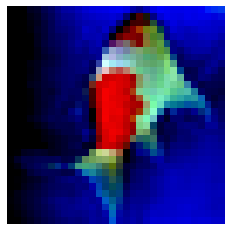

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


628


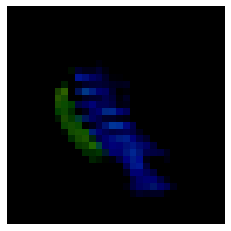

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


629


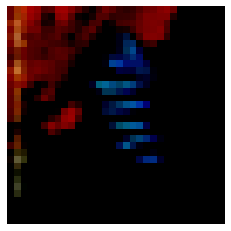

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


630


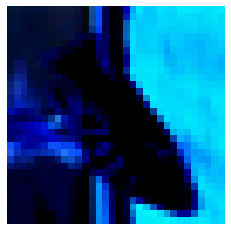

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


631


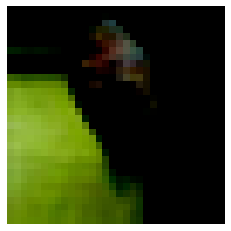

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


632


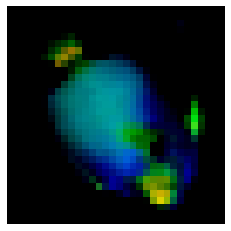

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


633


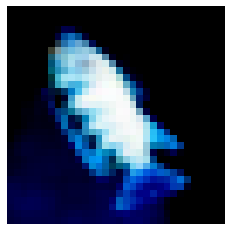

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


634


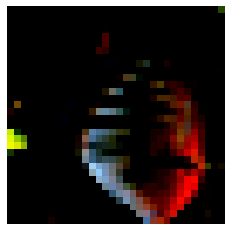

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


635


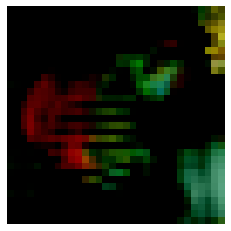

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


636


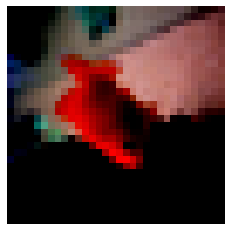

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


637


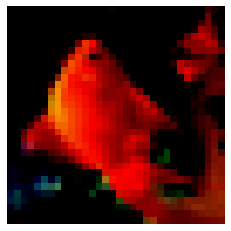

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


638


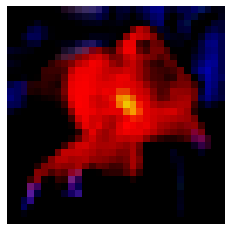

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


639


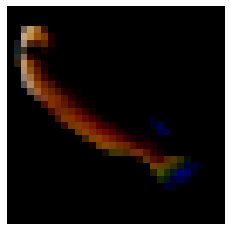

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


640


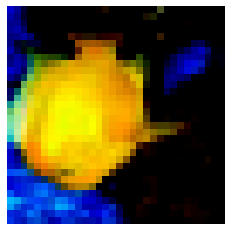

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


641


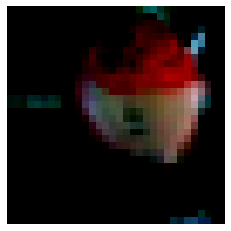

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


642


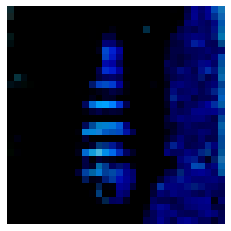

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


643


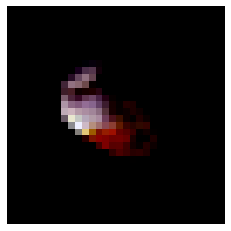

644


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


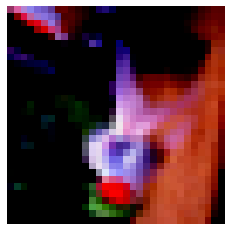

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


645


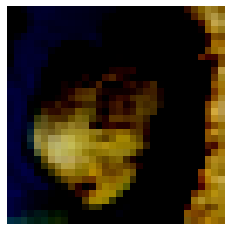

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


646


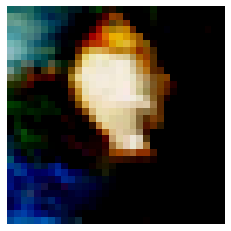

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


647


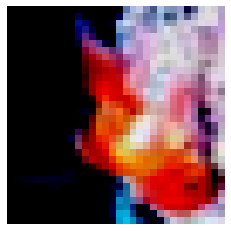

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


648


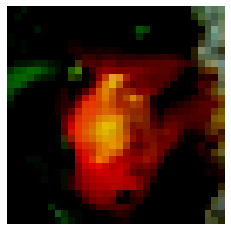

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


649


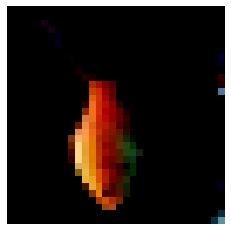

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


650


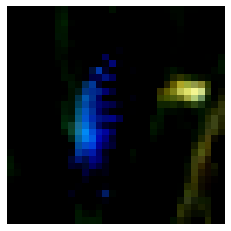

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


651


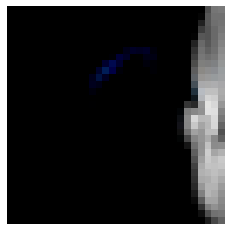

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


652


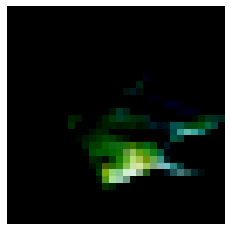

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


653


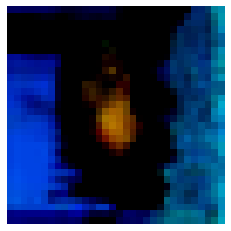

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


654


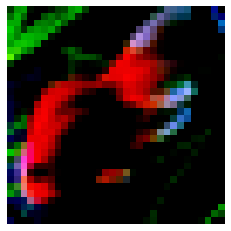

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


655


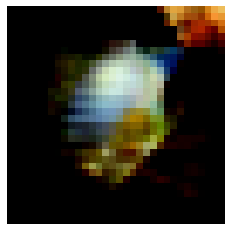

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


656


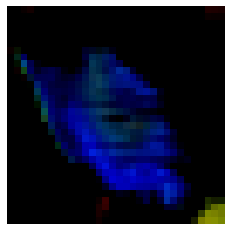

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


657


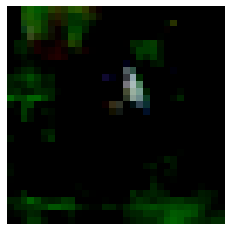

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


658


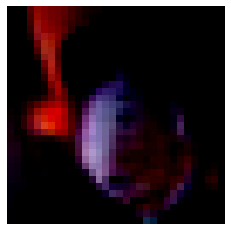

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


659


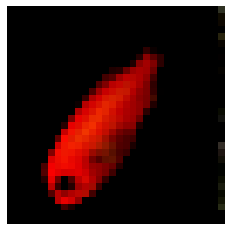

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


660


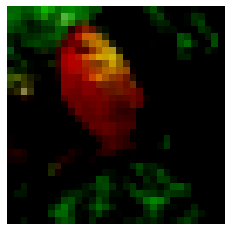

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


661


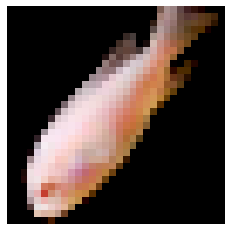

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


662


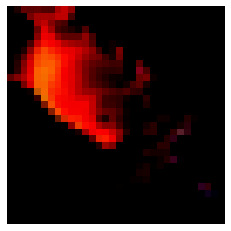

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


663


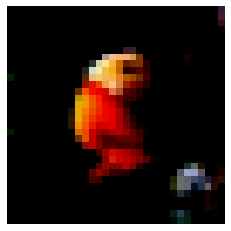

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


664


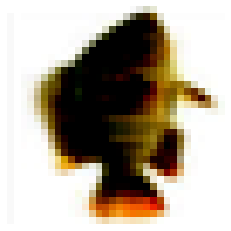

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


665


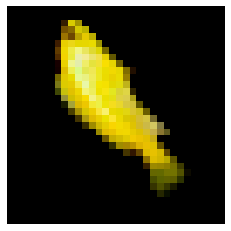

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


666


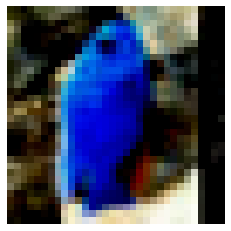

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


667


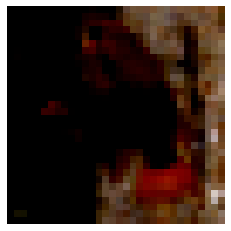

668


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


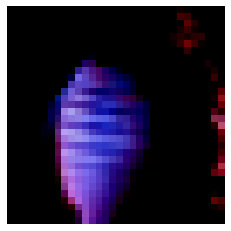

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


669


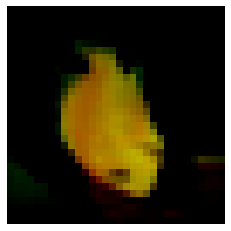

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


670


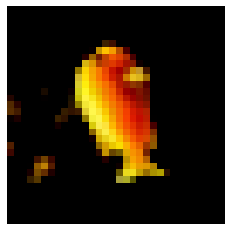

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


671


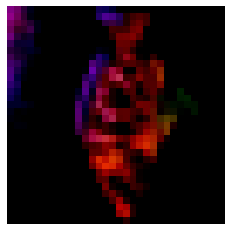

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


672


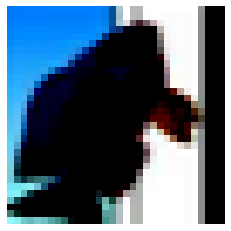

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


673


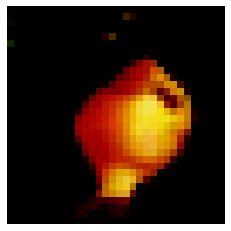

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


674


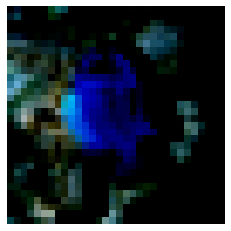

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


675


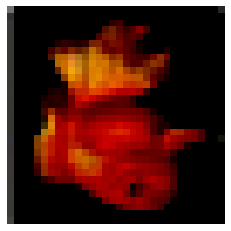

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


676


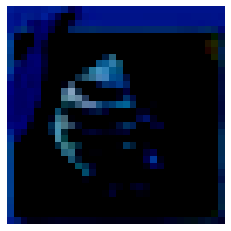

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


677


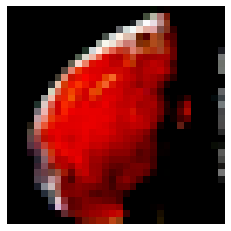

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


678


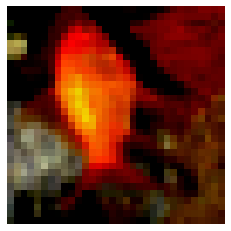

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


679


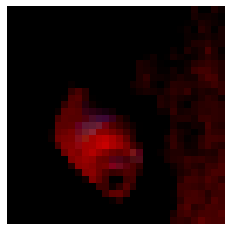

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


680


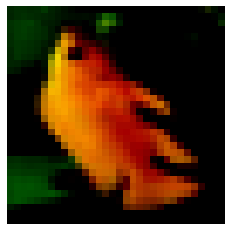

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


681


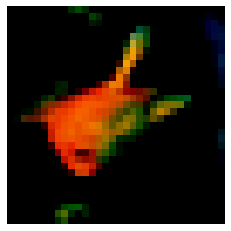

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


682


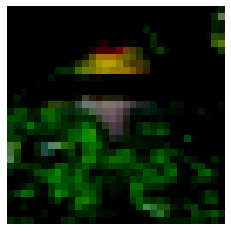

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


683


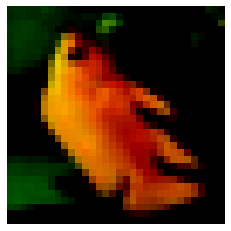

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


684


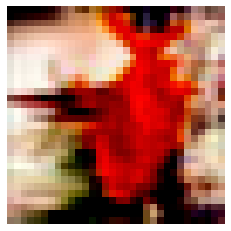

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


685


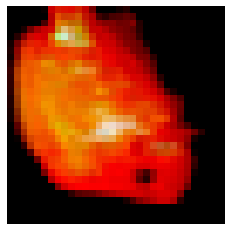

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


686


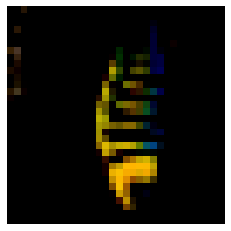

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


687


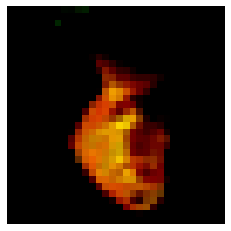

688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


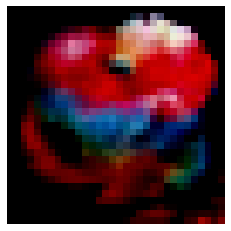

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


689


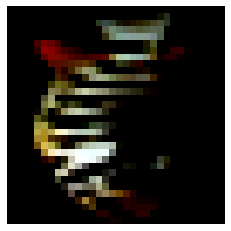

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


690


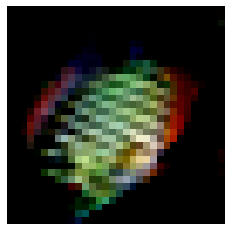

691


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


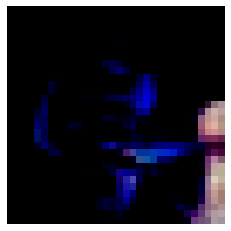

692


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


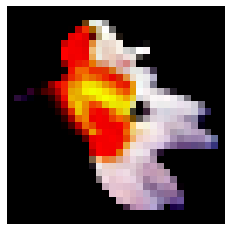

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


693


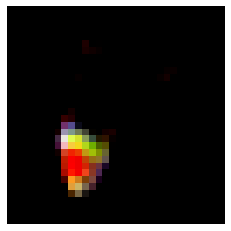

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


694


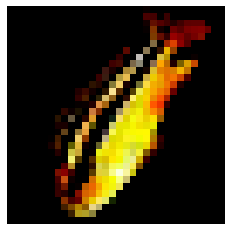

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


695


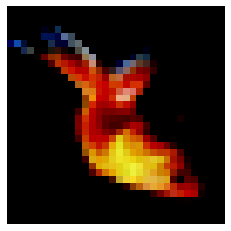

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


696


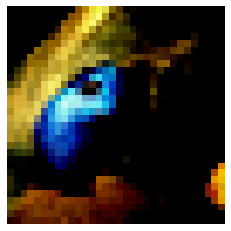

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


697


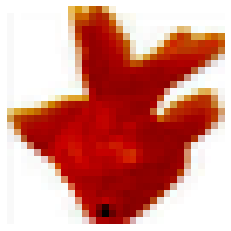

698


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


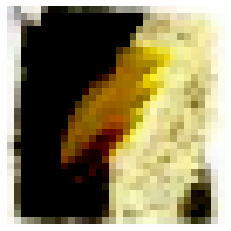

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


699


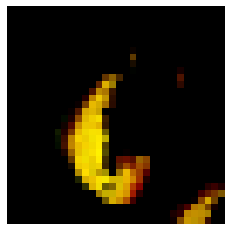

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


700


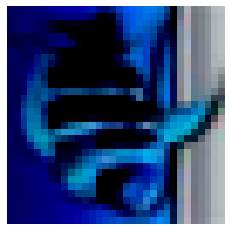

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


701


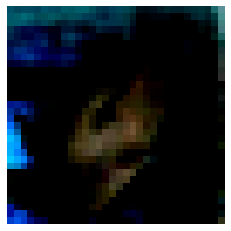

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


702


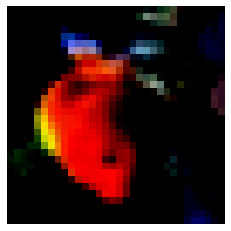

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


703


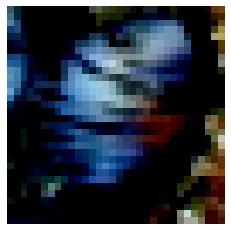

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


704


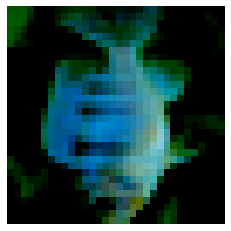

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


705


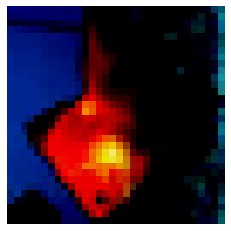

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


706


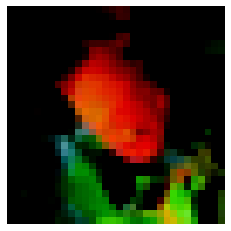

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


707


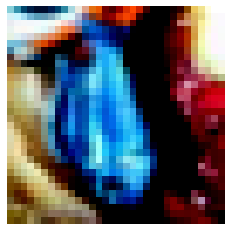

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


708


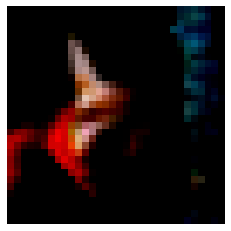

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


709


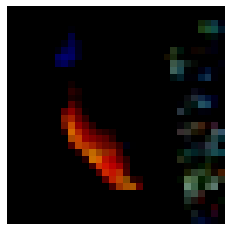

710


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


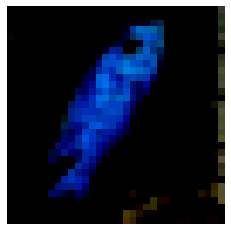

711


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


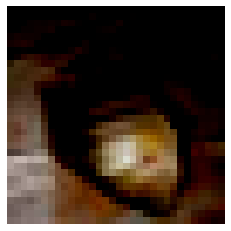

712


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


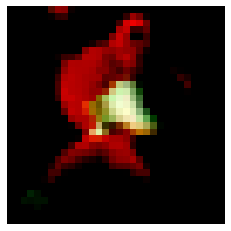

713


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


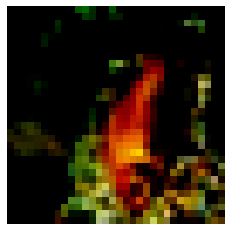

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


714


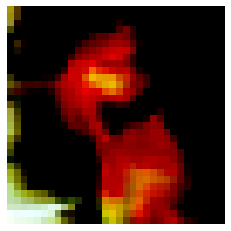

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


715


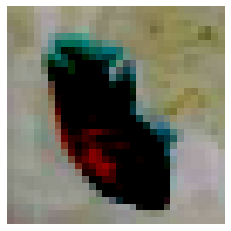

716


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


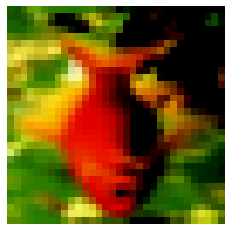

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


717


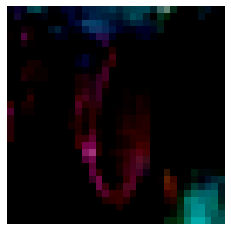

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


718


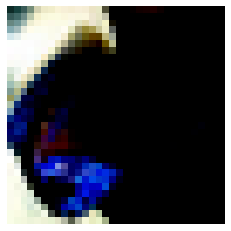

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


719


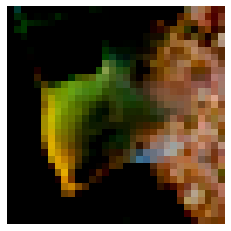

720


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


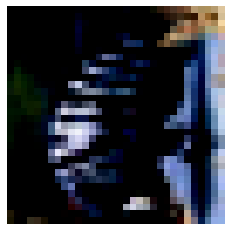

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


721


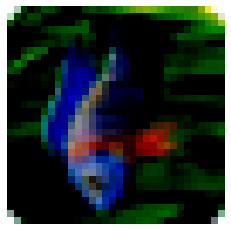

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


722


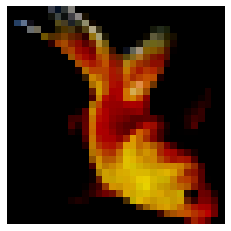

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


723


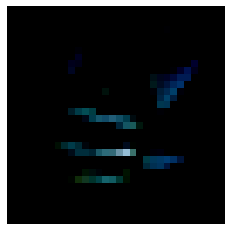

724


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


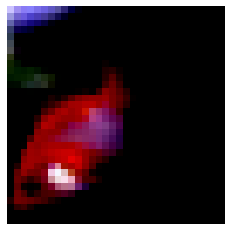

725


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


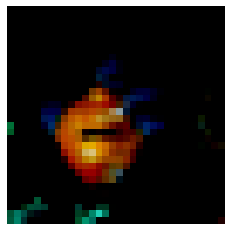

726


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


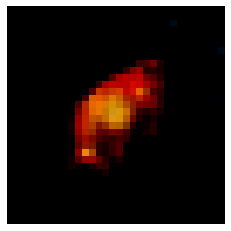

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


727


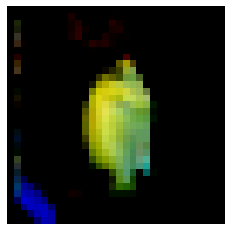

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


728


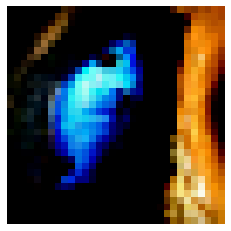

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


729


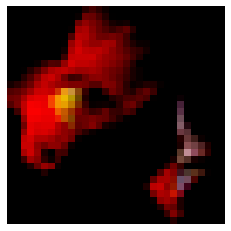

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


730


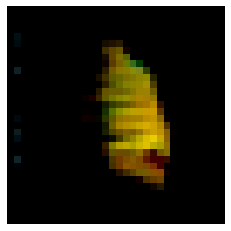

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


731


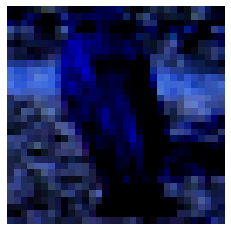

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


732


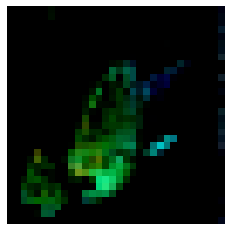

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


733


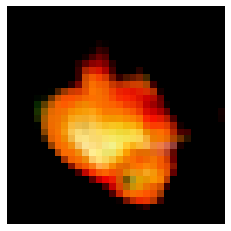

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


734


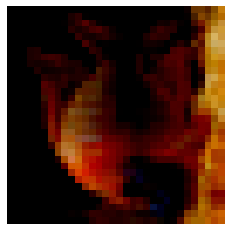

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


735


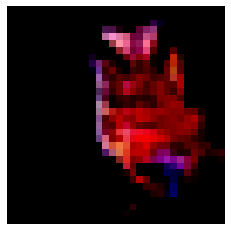

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


736


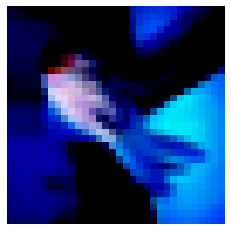

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


737


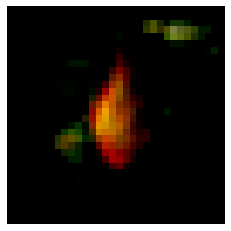

738


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


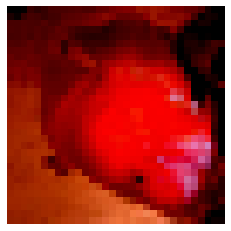

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


739


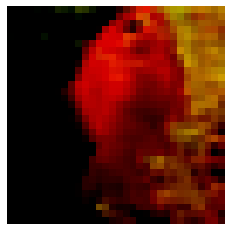

740


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


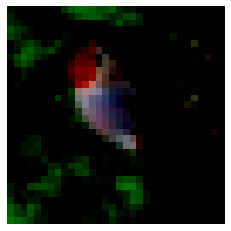

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


741


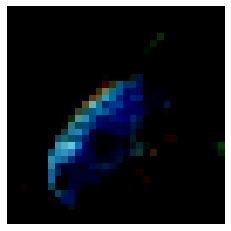

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


742


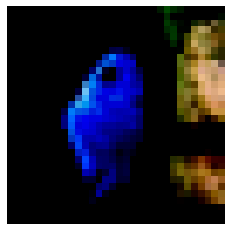

743


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


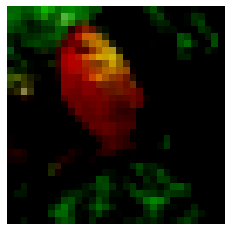

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


744


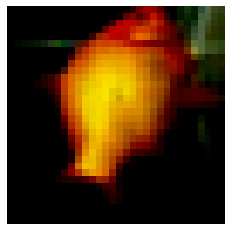

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


745


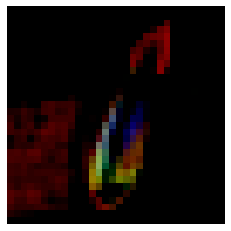

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


746


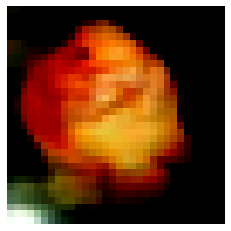

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


747


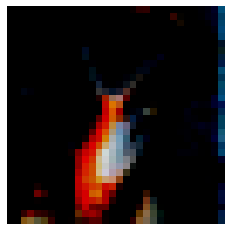

748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


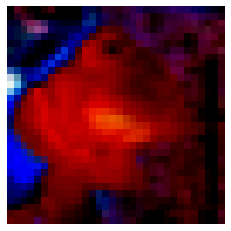

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


749


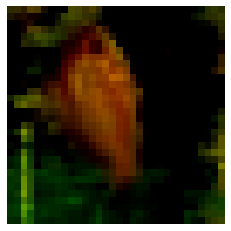

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


750


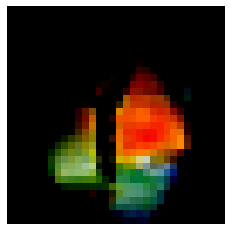

751


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


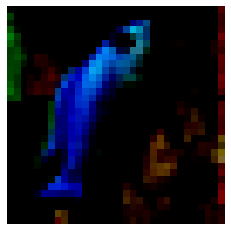

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


752


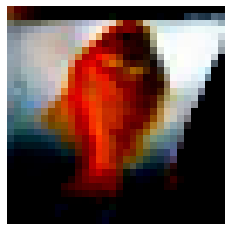

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


753


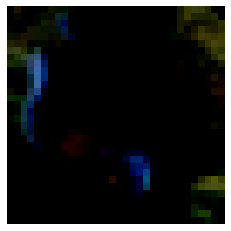

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


754


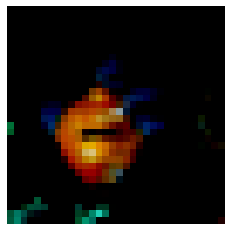

755


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


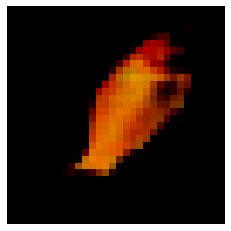

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


756


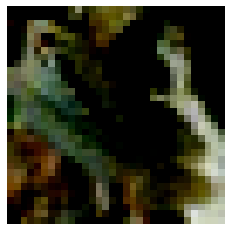

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


757


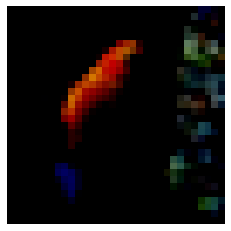

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


758


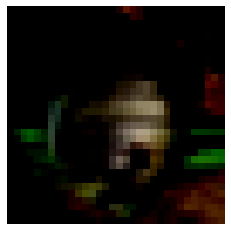

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


759


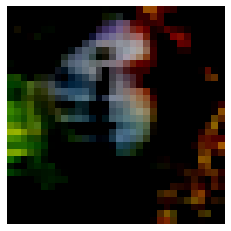

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


760


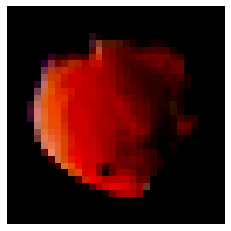

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


761


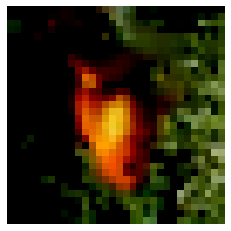

762


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


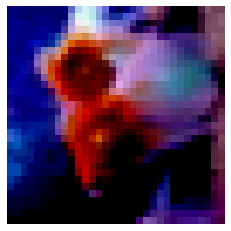

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


763


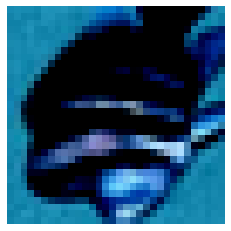

764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


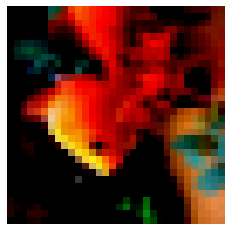

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


765


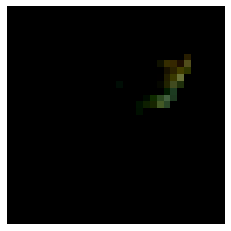

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


766


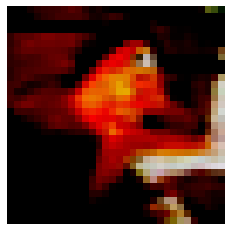

767


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


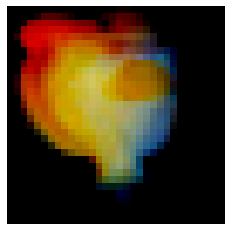

768


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


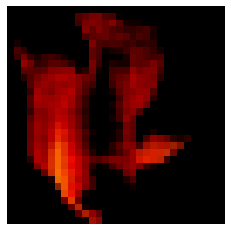

769


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


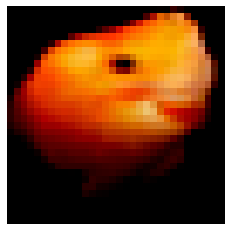

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


770


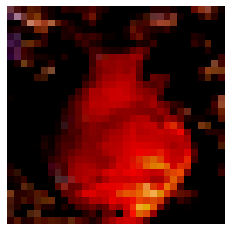

771


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


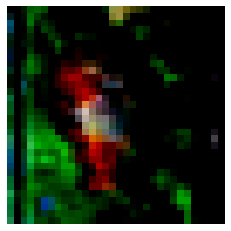

772


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


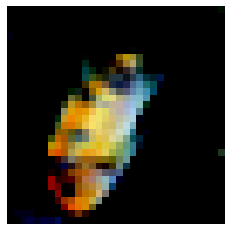

773


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


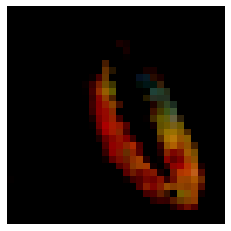

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


774


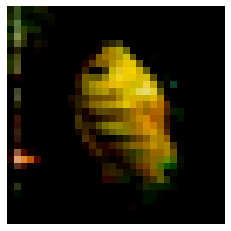

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


775


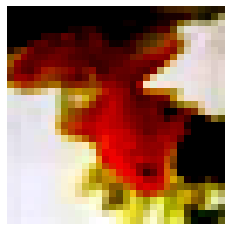

776


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


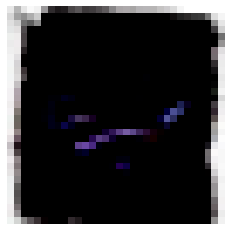

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


777


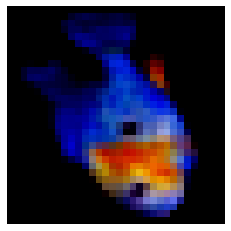

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


778


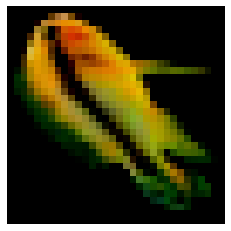

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


779


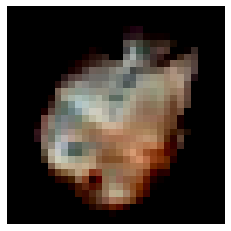

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


780


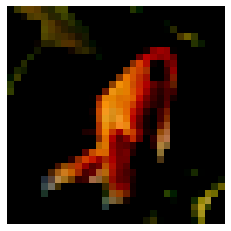

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


781


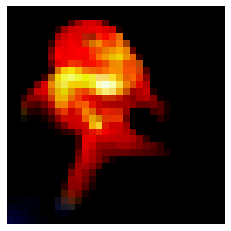

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


782


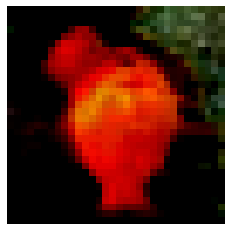

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


783


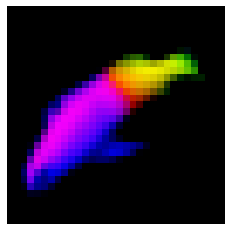

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


784


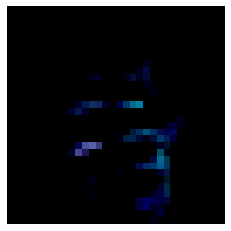

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


785


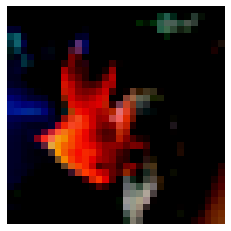

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


786


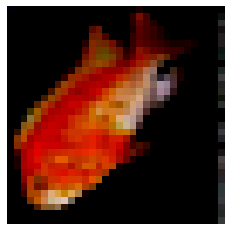

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


787


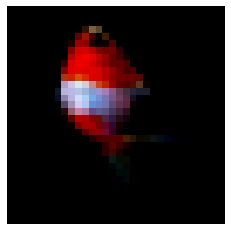

788


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


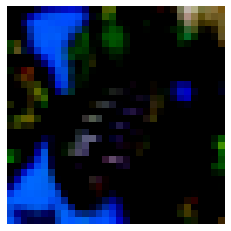

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


789


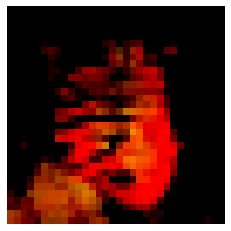

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


790


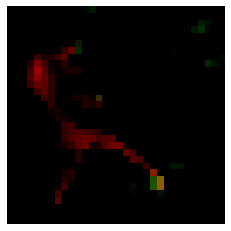

791


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


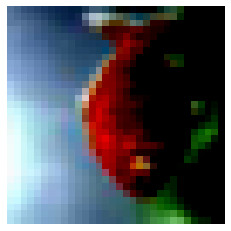

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


792


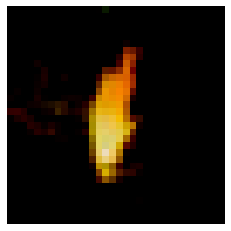

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


793


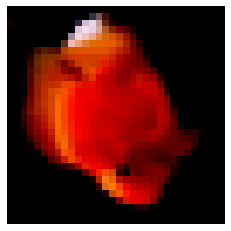

794


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


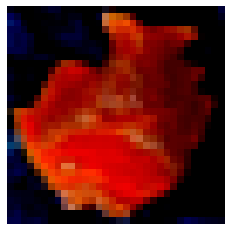

795


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


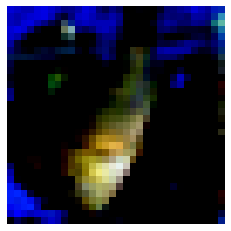

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


796


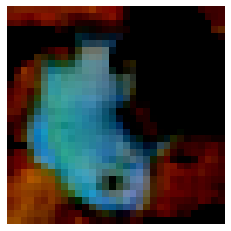

797


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


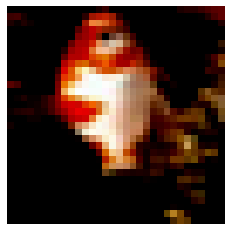

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


798


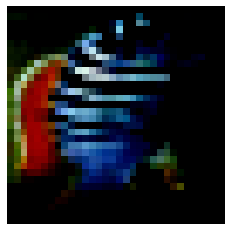

799


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


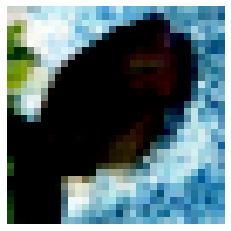

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


800


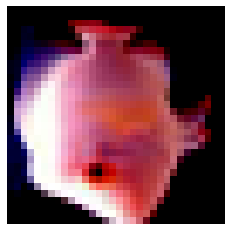

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


801


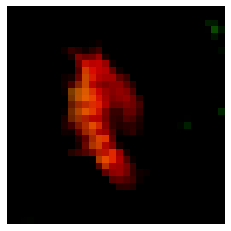

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


802


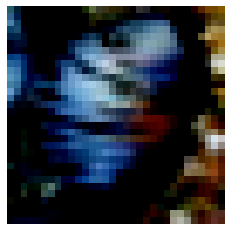

803


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


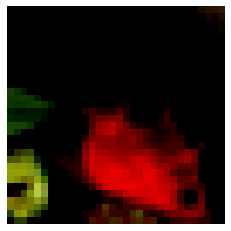

804


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


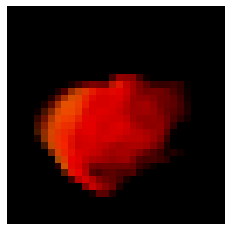

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


805


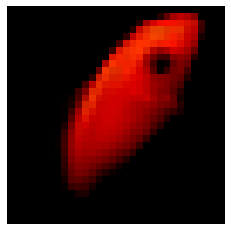

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


806


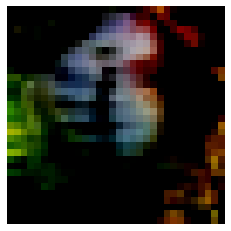

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


807


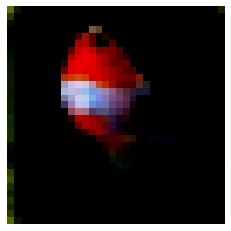

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


808


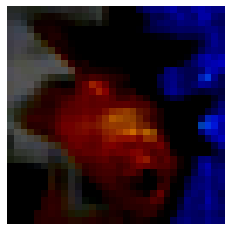

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


809


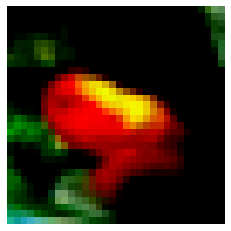

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


810


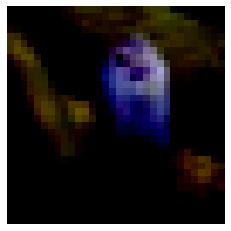

811


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


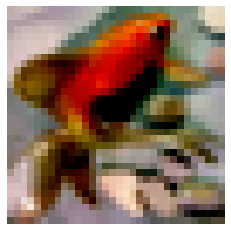

812


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


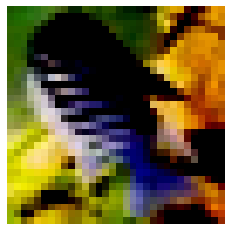

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


813


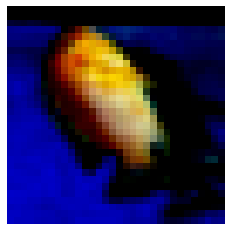

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


814


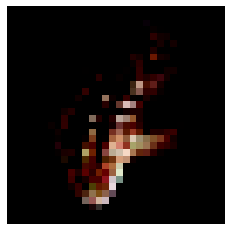

815


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


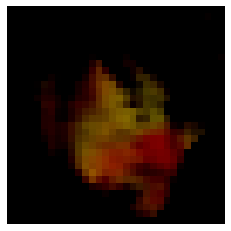

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


816


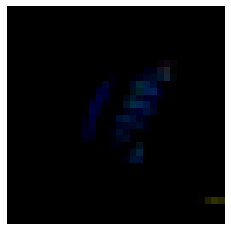

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


817


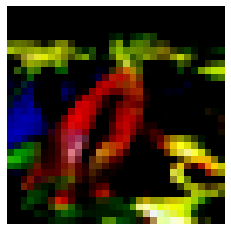

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


818


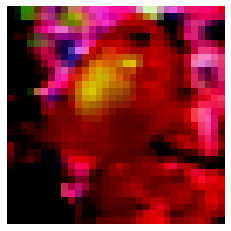

819


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


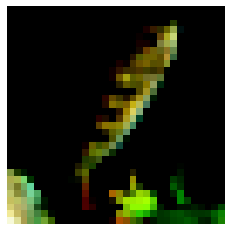

820


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


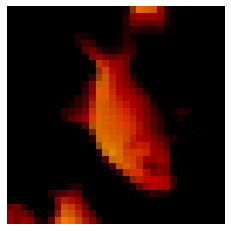

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


821


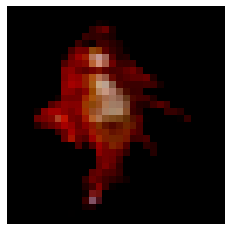

822


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


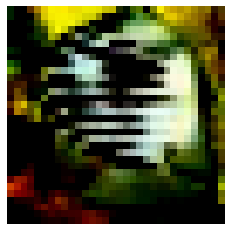

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


823


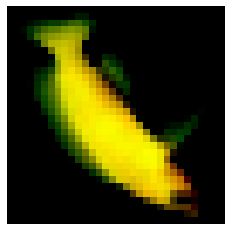

824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


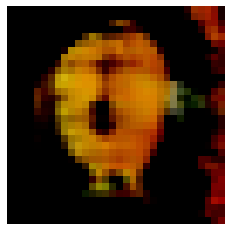

825


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


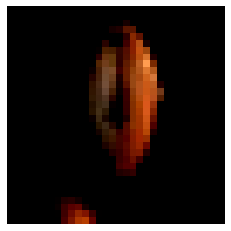

826


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


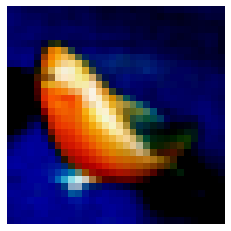

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


827


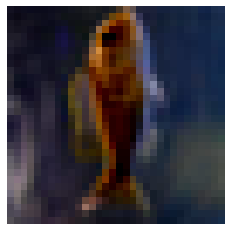

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


828


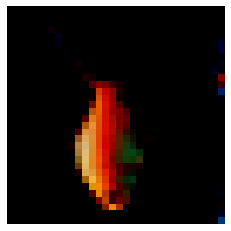

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


829


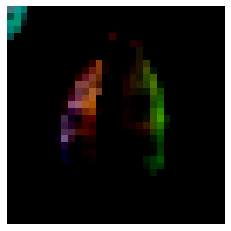

830


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


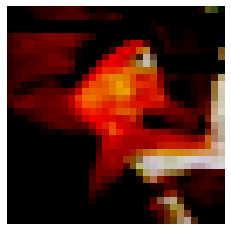

831


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


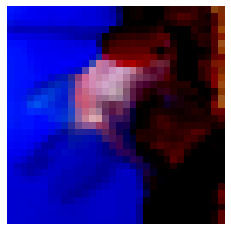

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


832


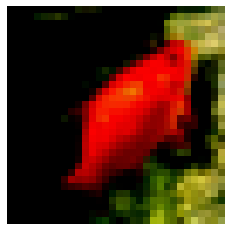

833


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


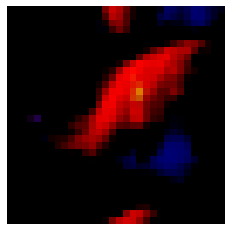

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


834


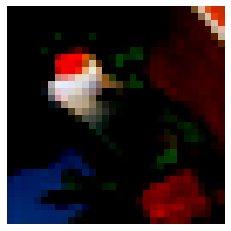

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


835


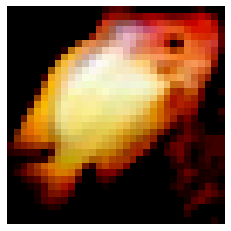

836


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


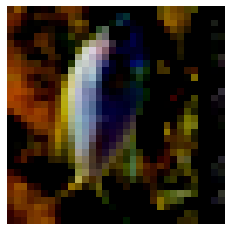

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


837


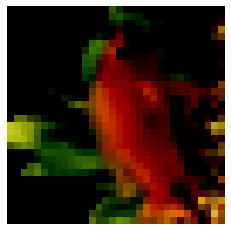

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


838


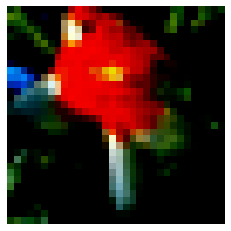

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


839


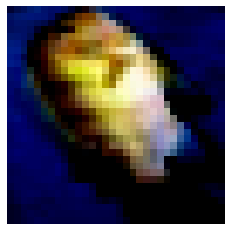

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


840


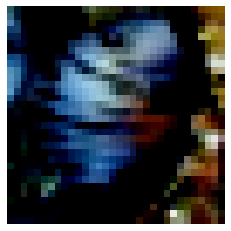

841


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


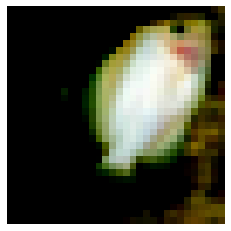

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


842


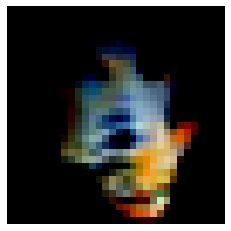

843


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


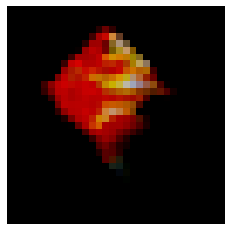

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


844


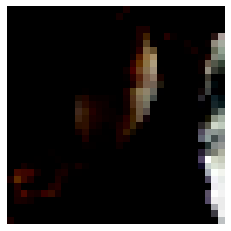

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


845


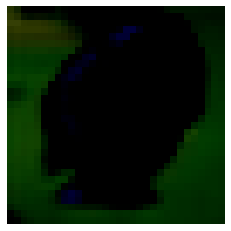

846


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


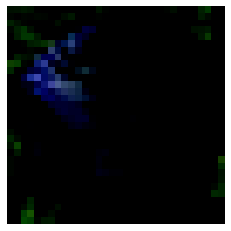

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


847


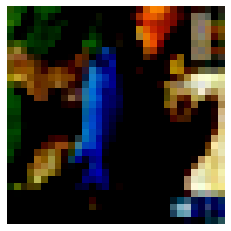

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


848


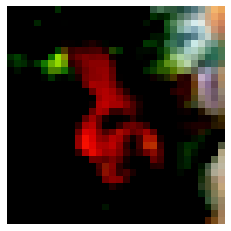

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


849


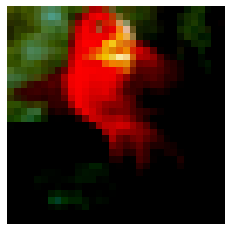

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


850


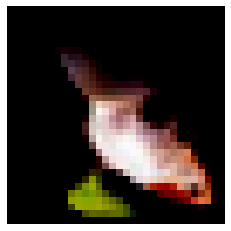

851


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


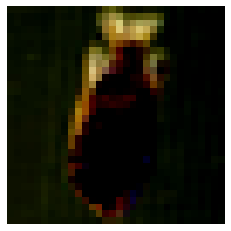

852


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


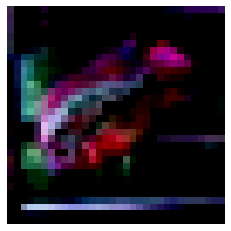

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


853


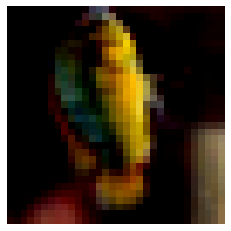

854


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


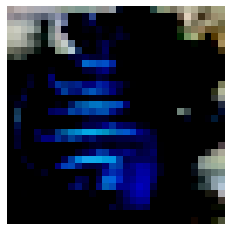

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


855


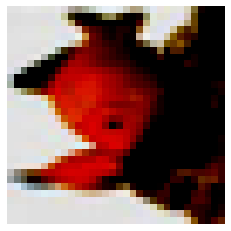

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


856


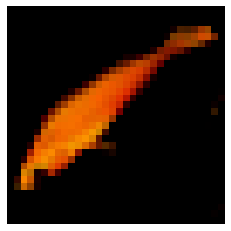

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


857


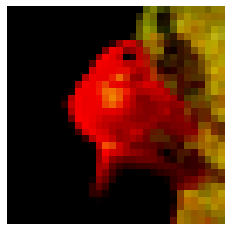

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


858


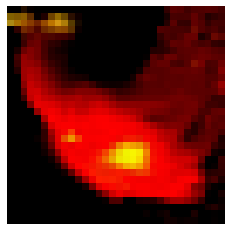

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


859


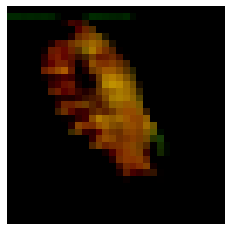

860


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


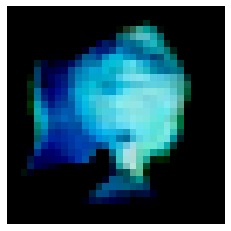

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


861


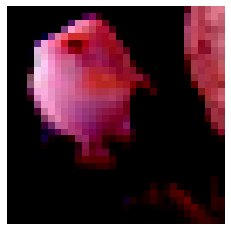

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


862


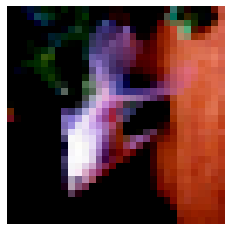

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


863


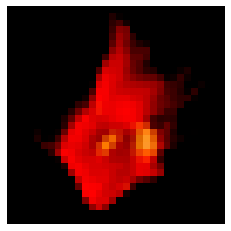

864


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


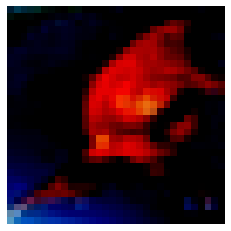

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


865


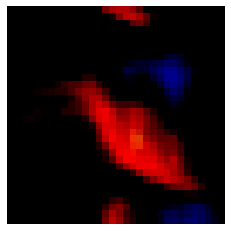

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


866


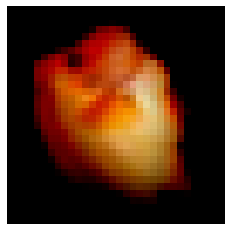

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


867


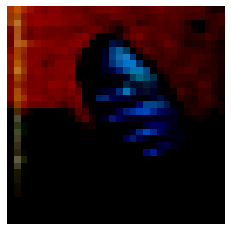

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


868


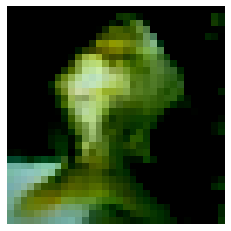

869


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


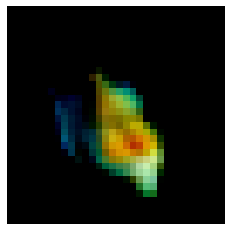

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


870


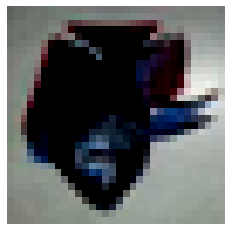

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


871


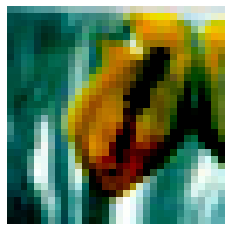

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


872


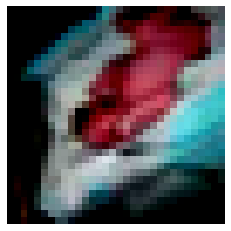

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


873


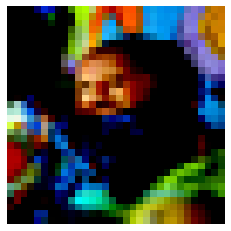

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


874


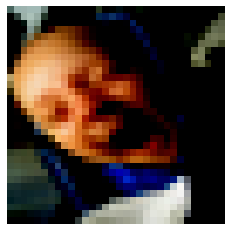

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


875


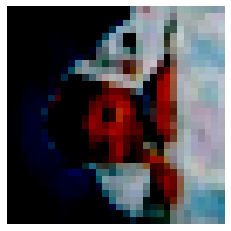

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


876


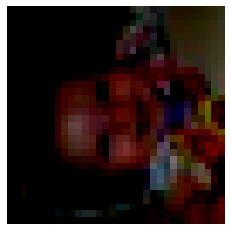

877


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


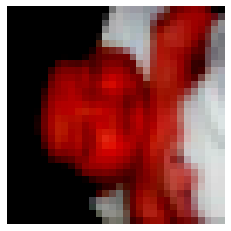

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


878


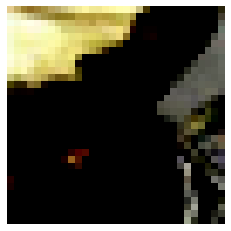

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


879


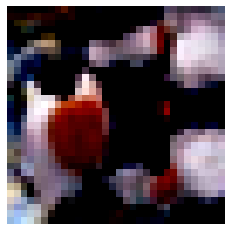

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


880


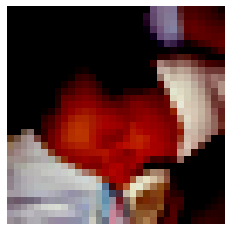

881


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


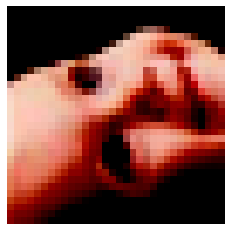

882


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


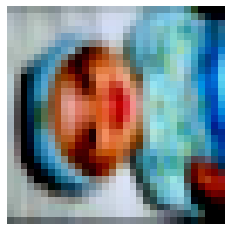

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


883


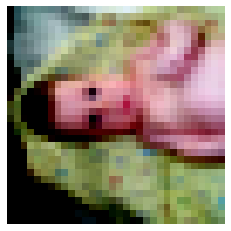

884


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


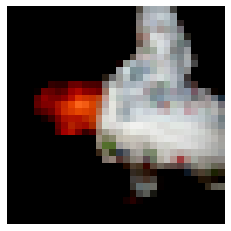

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


885


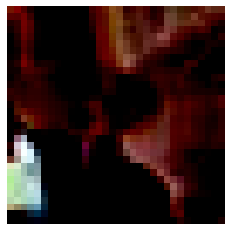

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


886


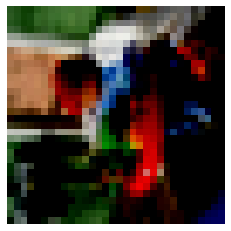

887


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


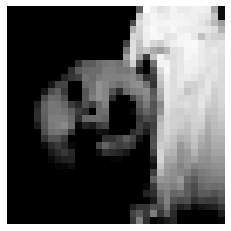

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


888


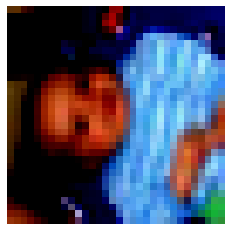

889


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


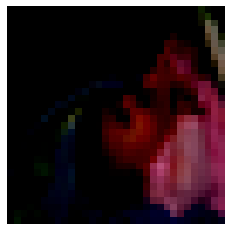

890


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


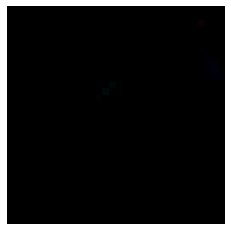

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


891


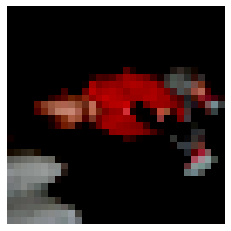

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


892


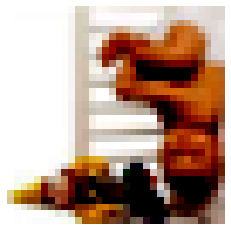

893


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


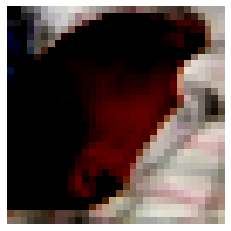

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


894


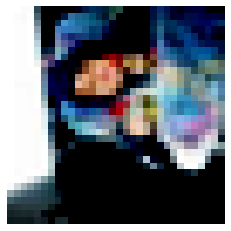

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


895


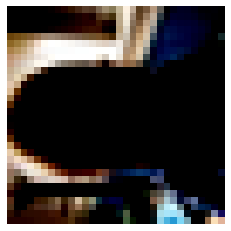

896


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


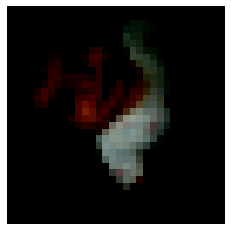

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


897


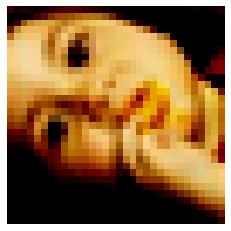

898


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


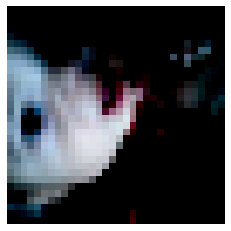

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


899


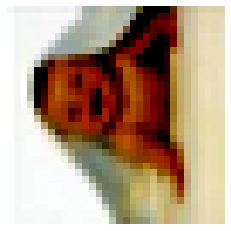

900


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


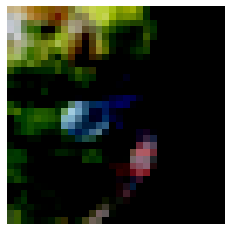

901


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


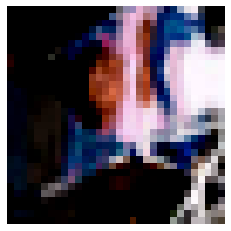

902


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


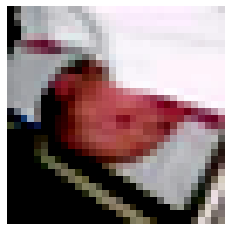

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


903


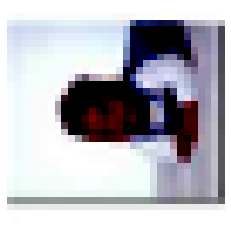

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


904


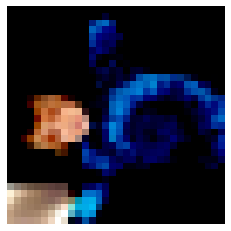

905


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


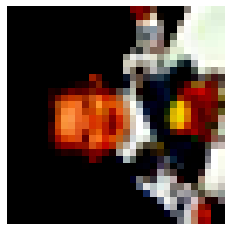

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


906


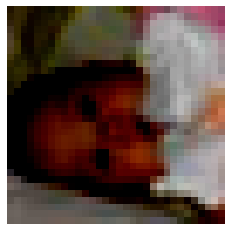

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


907


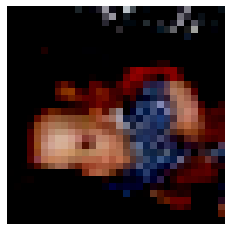

908


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


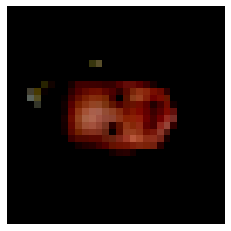

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


909


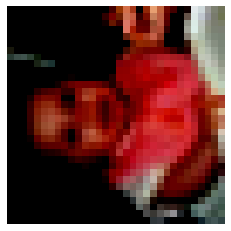

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


910


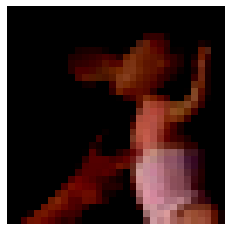

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


911


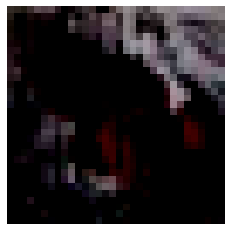

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


912


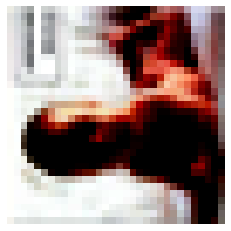

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


913


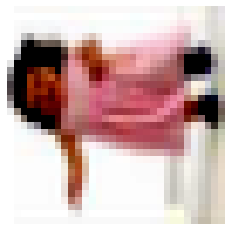

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


914


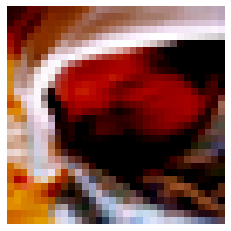

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


915


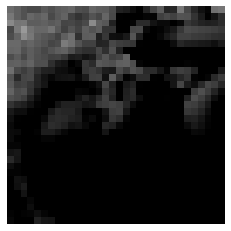

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


916


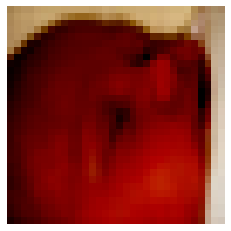

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


917


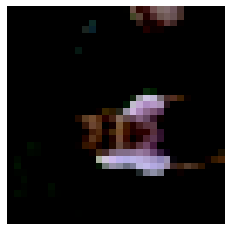

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


918


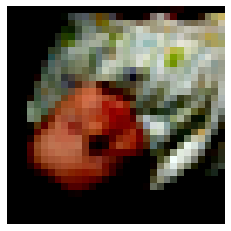

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


919


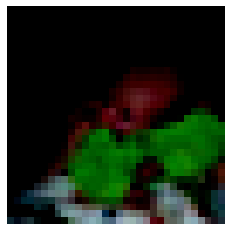

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


920


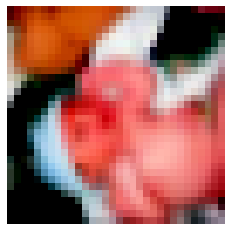

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


921


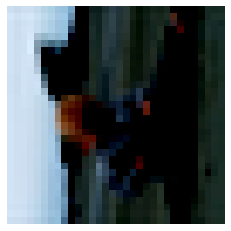

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


922


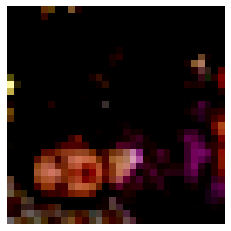

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


923


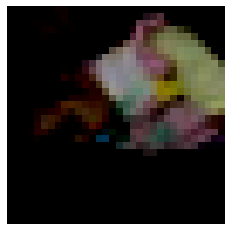

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


924


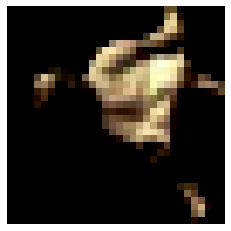

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


925


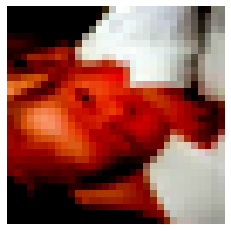

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


926


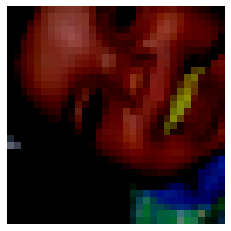

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


927


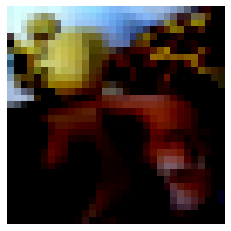

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


928


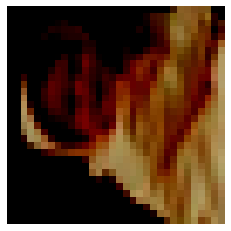

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


929


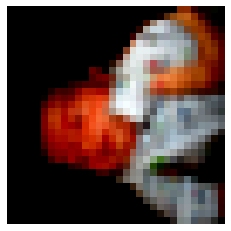

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


930


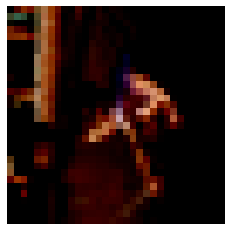

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


931


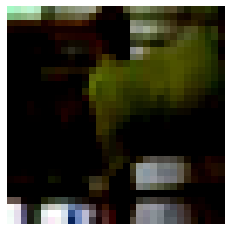

932


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


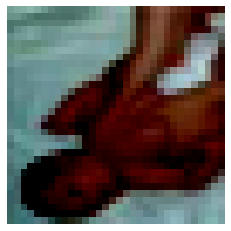

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


933


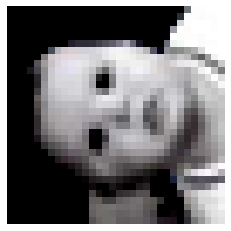

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


934


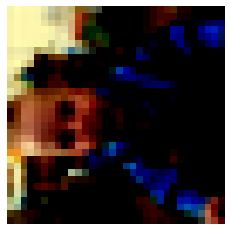

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


935


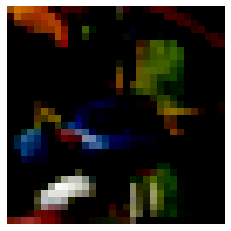

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


936


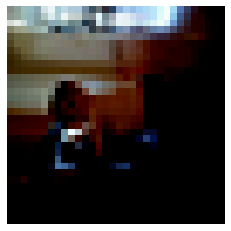

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


937


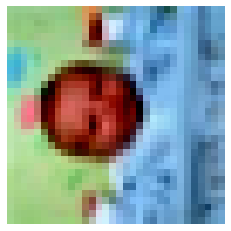

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


938


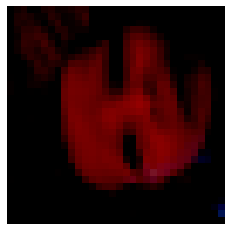

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


939


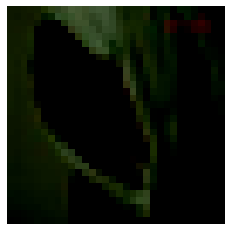

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


940


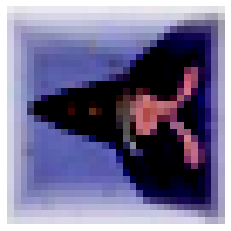

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


941


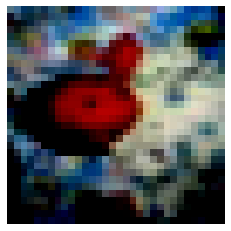

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


942


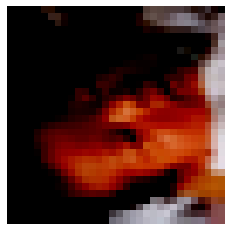

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


943


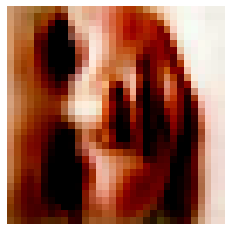

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


944


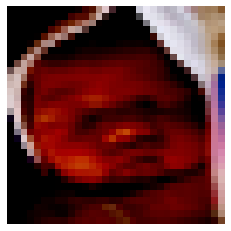

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


945


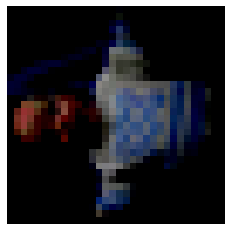

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


946


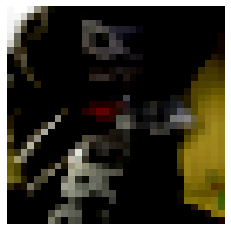

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


947


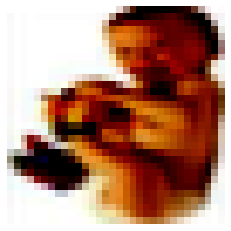

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


948


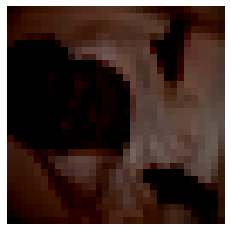

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


949


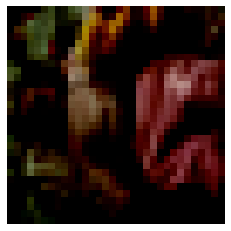

950


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


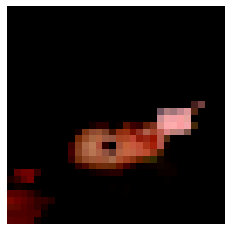

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


951


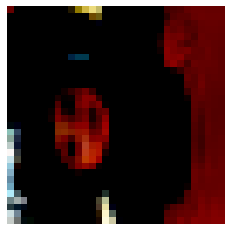

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


952


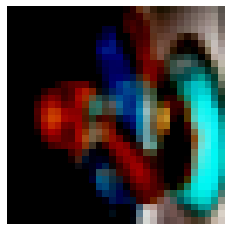

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


953


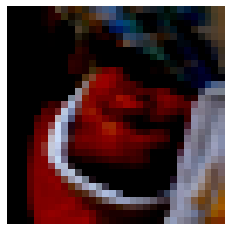

954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


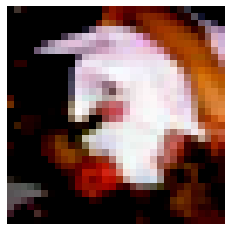

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


955


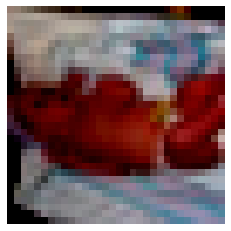

956


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


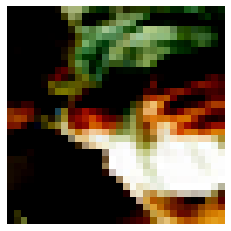

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


957


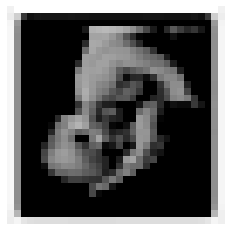

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


958


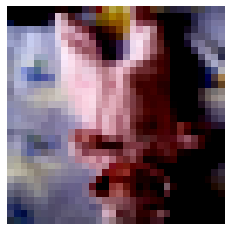

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


959


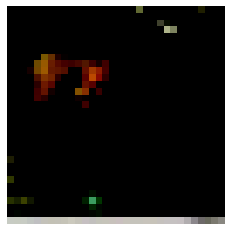

960


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


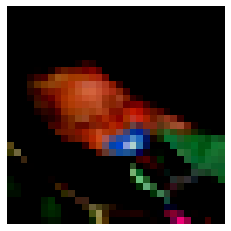

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


961


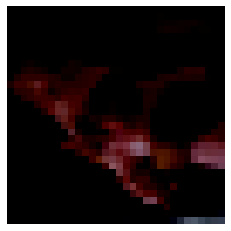

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


962


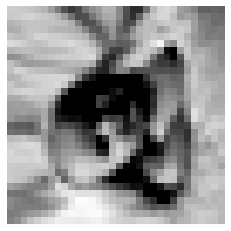

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


963


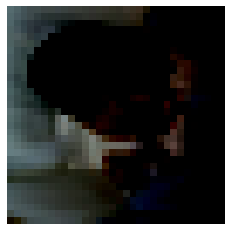

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


964


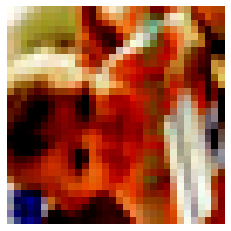

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


965


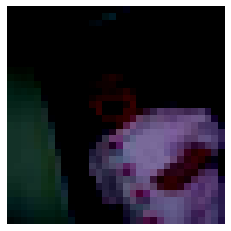

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


966


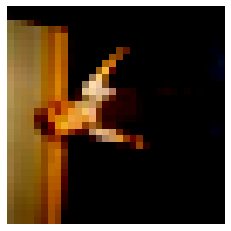

967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


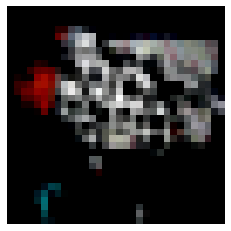

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


968


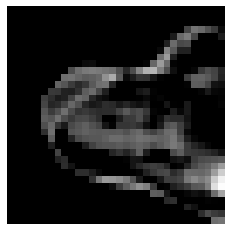

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


969


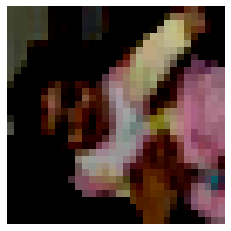

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


970


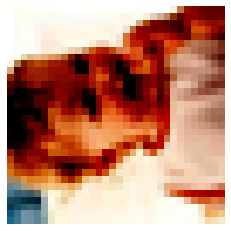

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


971


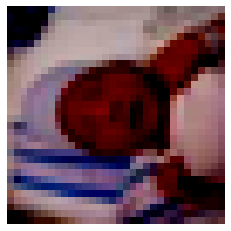

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


972


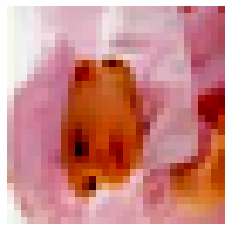

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


973


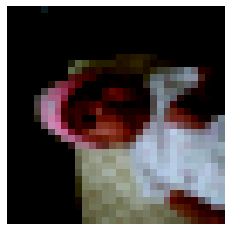

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


974


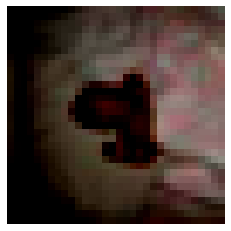

975


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


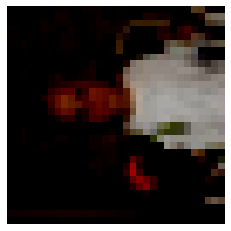

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


976


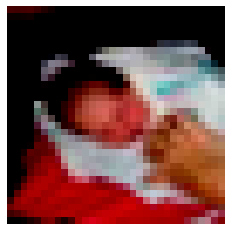

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


977


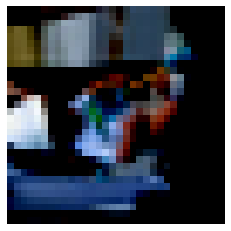

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


978


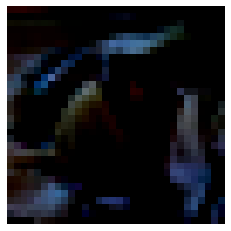

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


979


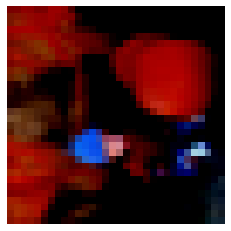

980


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


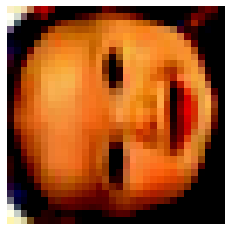

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


981


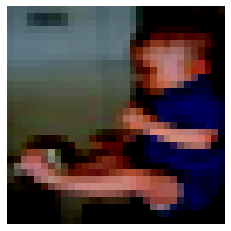

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


982


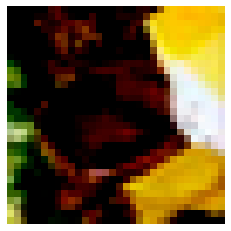

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


983


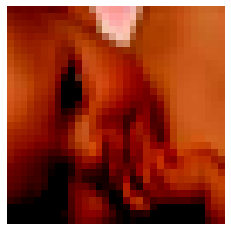

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


984


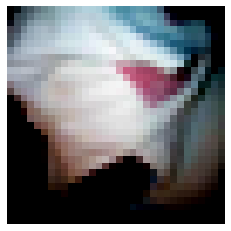

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


985


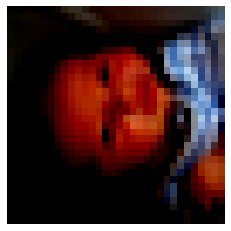

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


986


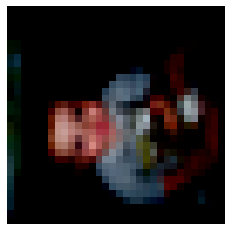

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


987


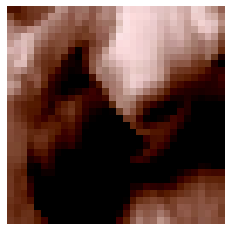

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


988


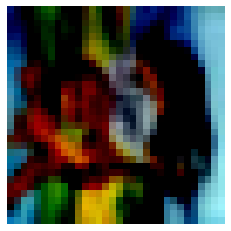

989


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


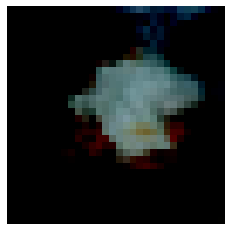

990


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


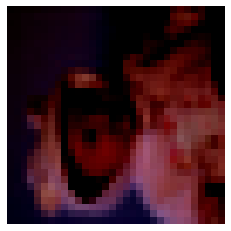

991


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


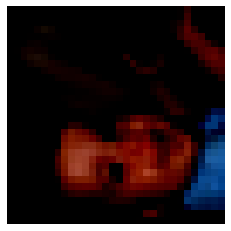

992


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


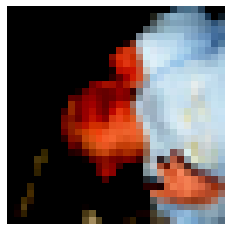

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


993


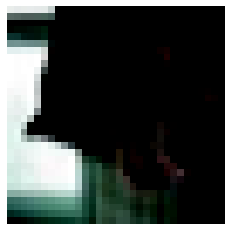

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


994


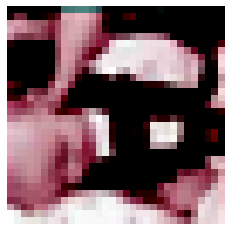

995


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


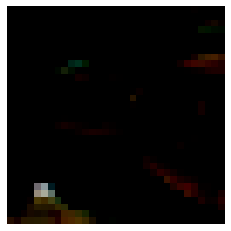

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


996


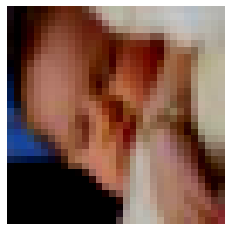

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


997


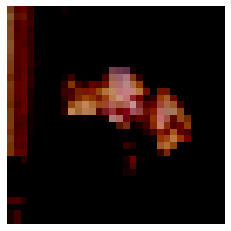

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


998


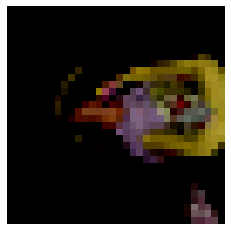

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


999


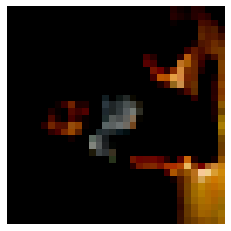

1000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


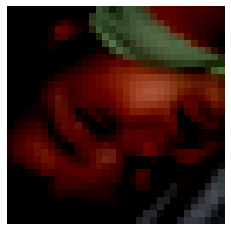

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1001


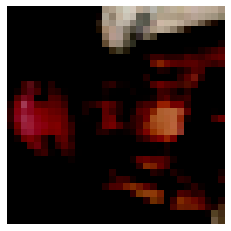

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1002


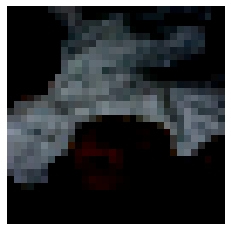

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1003


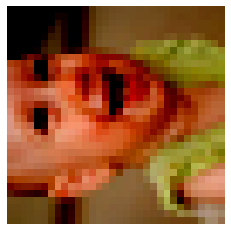

1004


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


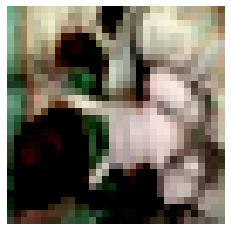

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1005


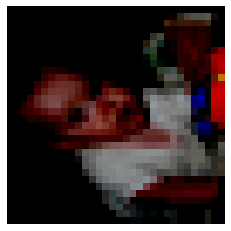

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1006


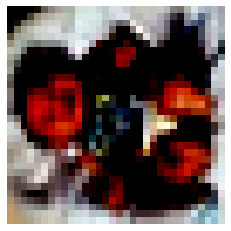

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1007


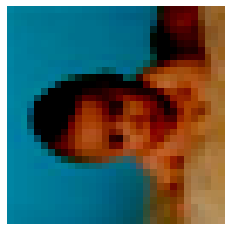

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1008


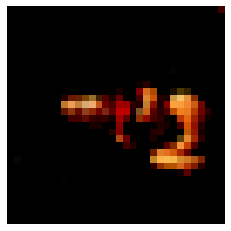

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1009


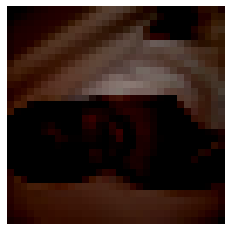

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1010


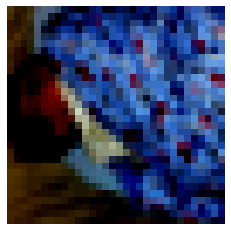

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1011


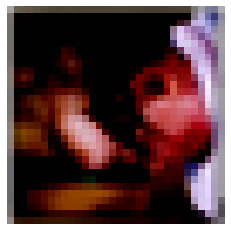

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1012


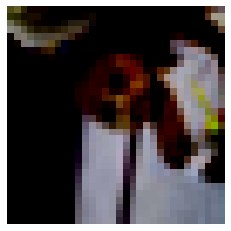

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1013


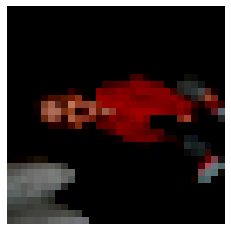

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1014


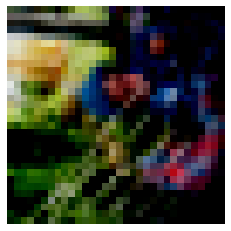

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1015


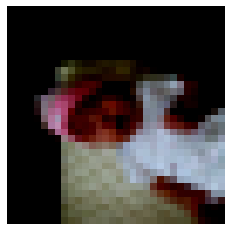

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1016


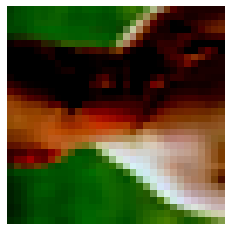

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1017


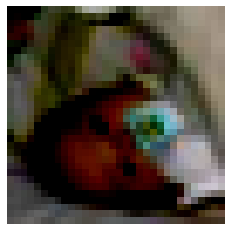

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1018


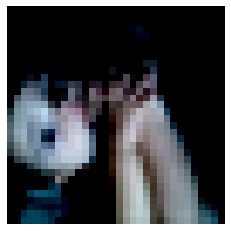

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1019


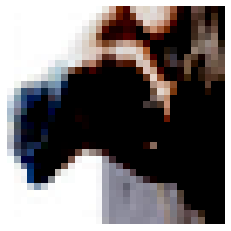

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1020


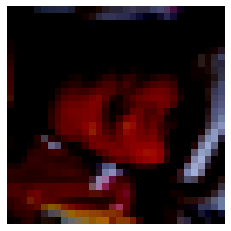

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1021


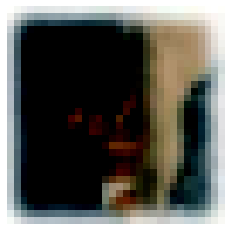

1022


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


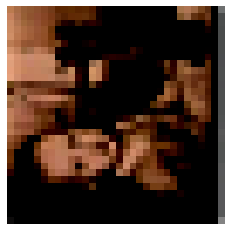

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1023


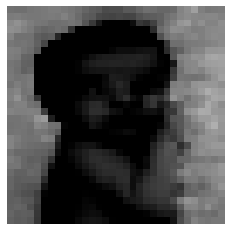

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1024


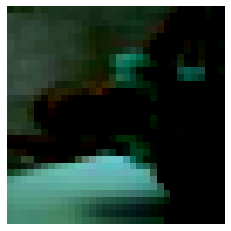

1025


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


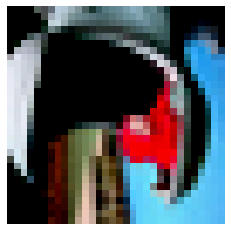

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1026


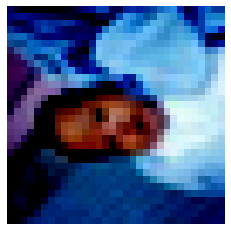

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1027


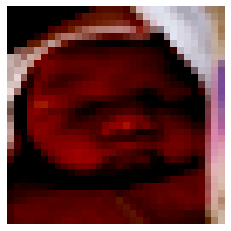

1028


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


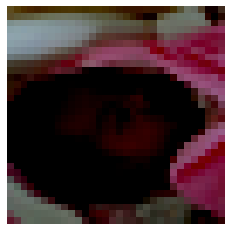

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1029


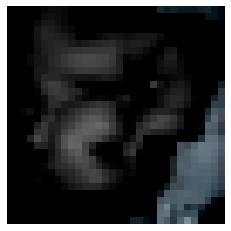

1030


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


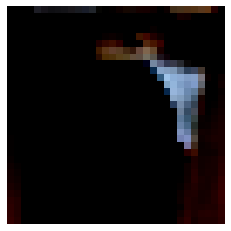

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1031


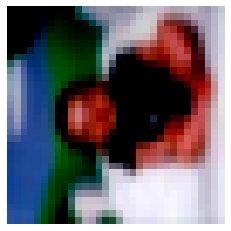

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1032


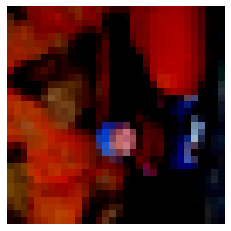

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1033


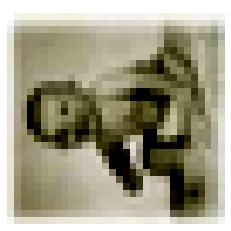

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1034


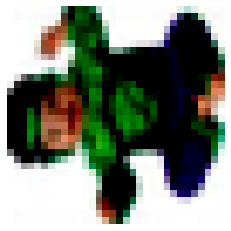

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1035


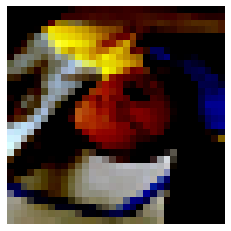

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1036


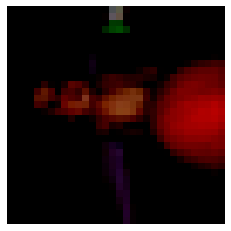

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1037


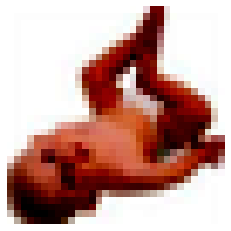

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1038


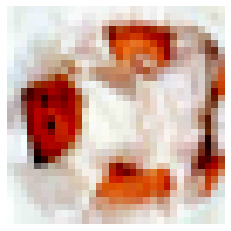

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1039


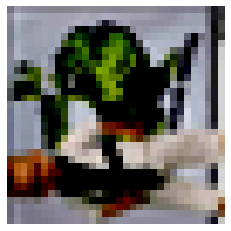

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1040


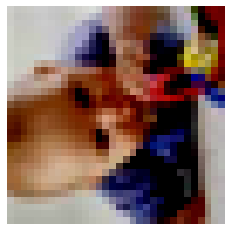

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1041


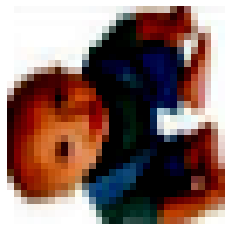

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1042


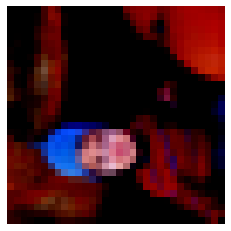

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1043


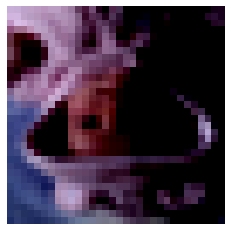

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1044


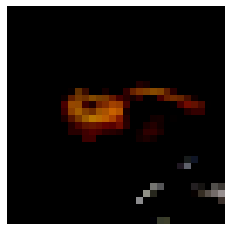

1045


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


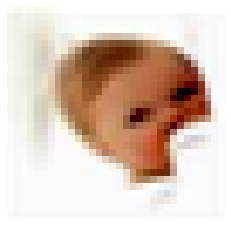

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1046


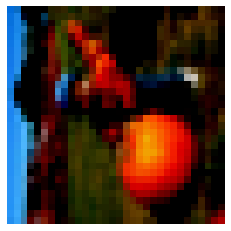

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1047


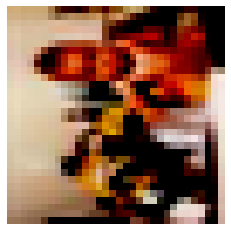

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1048


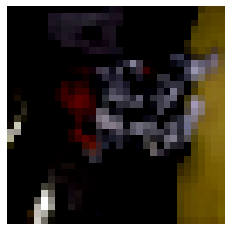

1049


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


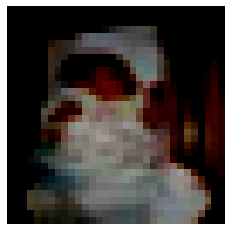

1050


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


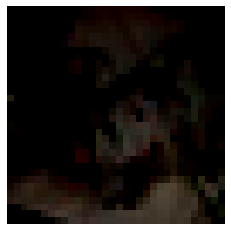

1051


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


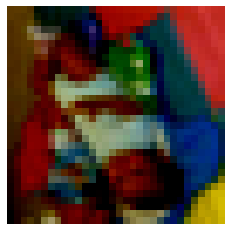

1052


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


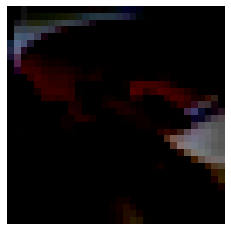

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1053


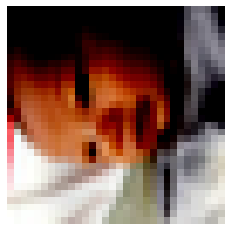

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1054


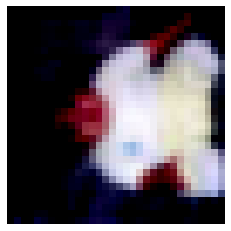

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1055


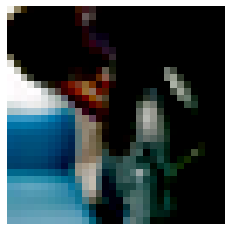

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1056


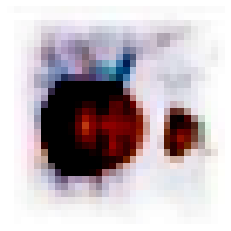

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1057


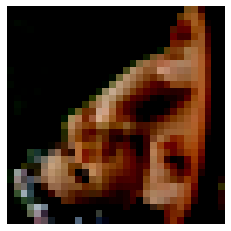

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1058


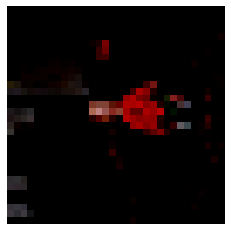

1059


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


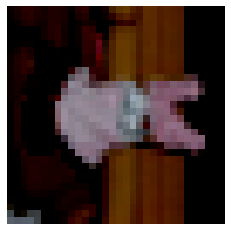

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1060


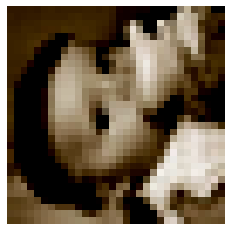

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1061


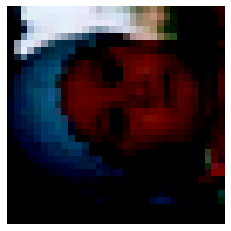

1062


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


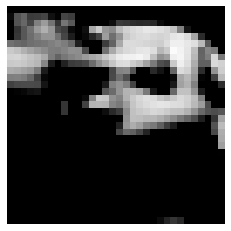

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1063


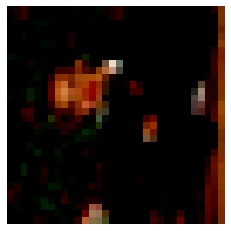

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1064


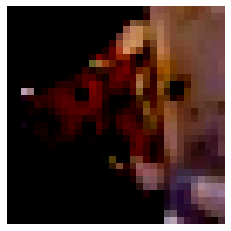

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1065


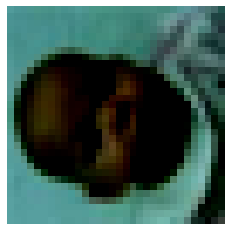

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1066


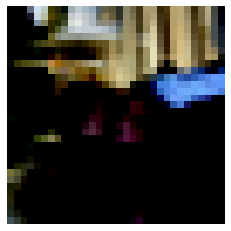

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1067


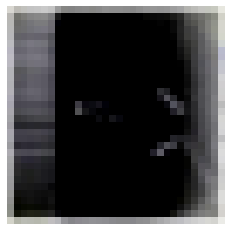

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1068


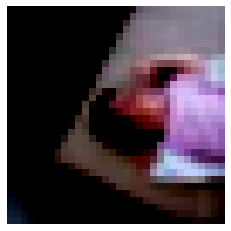

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1069


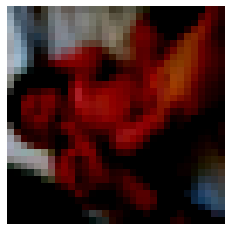

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1070


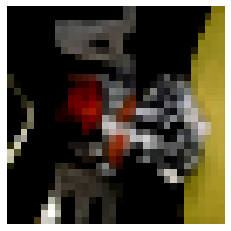

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1071


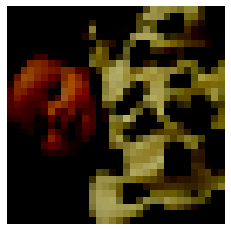

1072


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


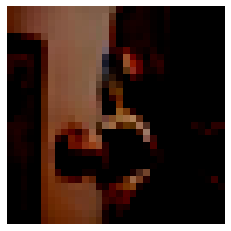

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1073


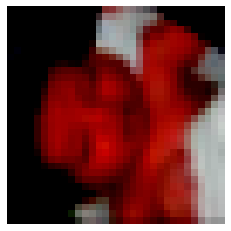

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1074


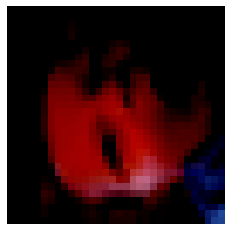

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1075


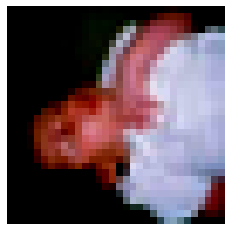

1076


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


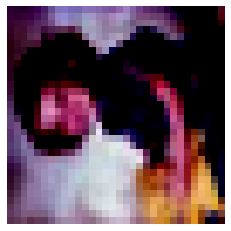

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1077


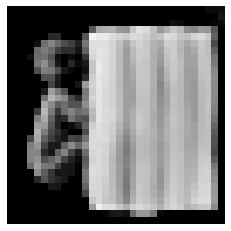

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1078


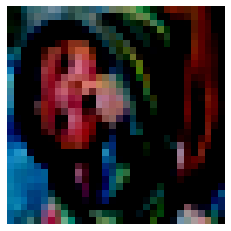

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1079


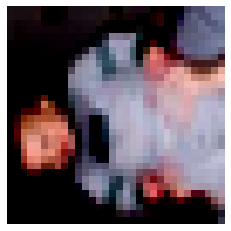

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1080


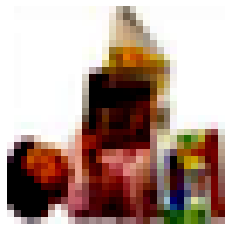

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1081


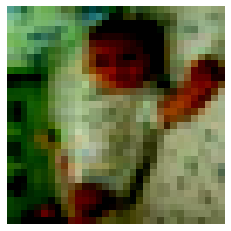

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1082


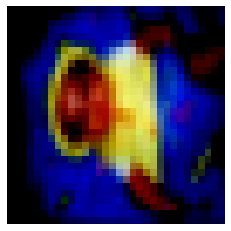

1083


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


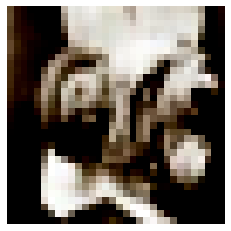

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1084


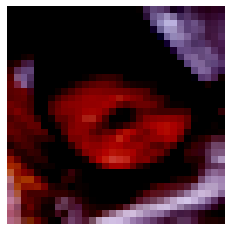

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1085


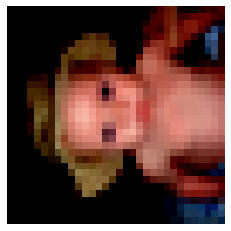

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1086


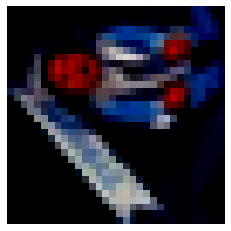

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1087


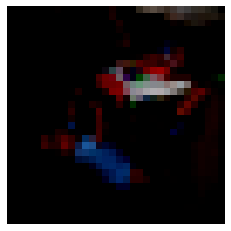

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1088


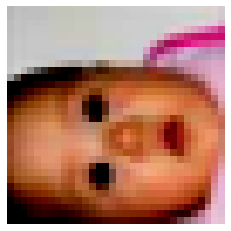

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1089


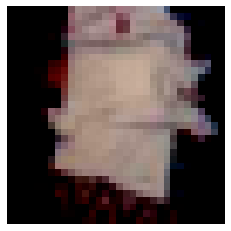

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1090


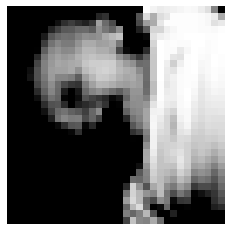

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1091


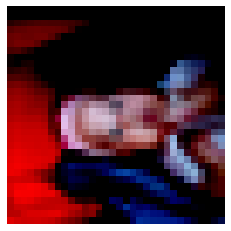

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1092


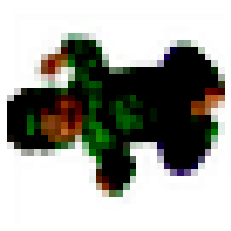

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1093


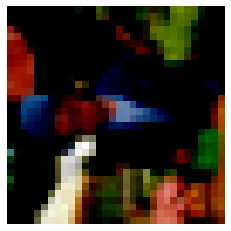

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1094


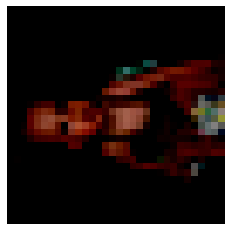

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1095


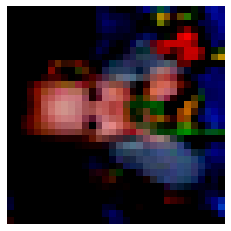

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1096


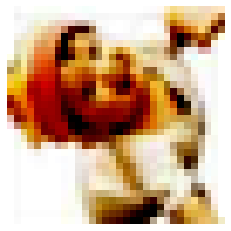

1097


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


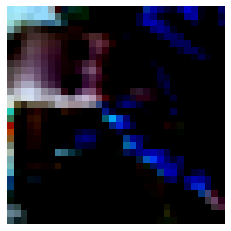

1098


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


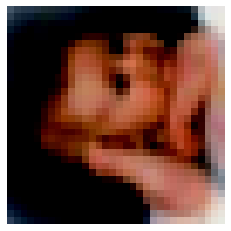

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1099


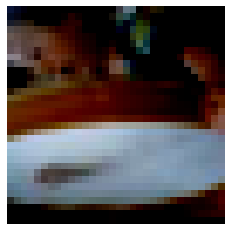

1100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


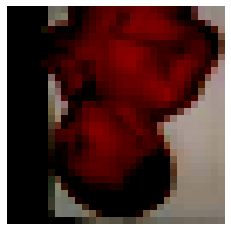

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1101


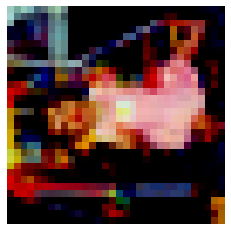

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1102


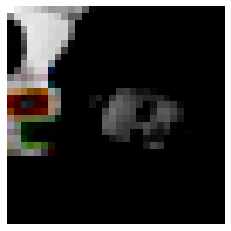

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1103


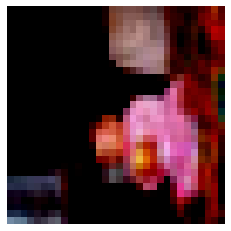

1104


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


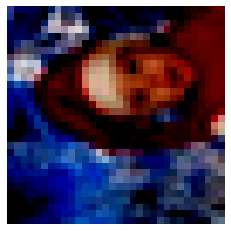

1105


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


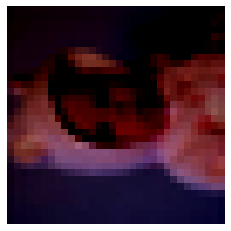

1106


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


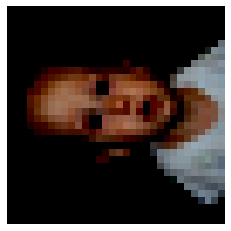

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1107


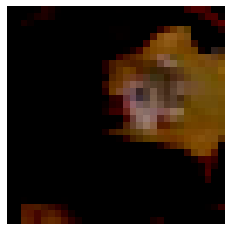

1108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


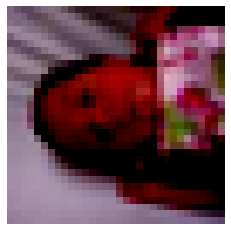

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1109


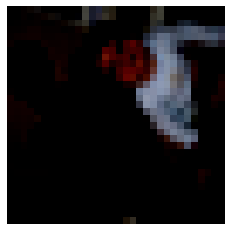

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1110


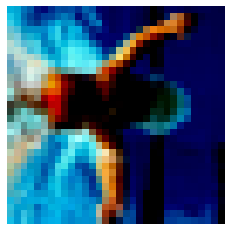

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1111


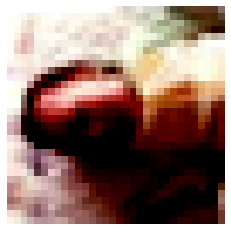

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1112


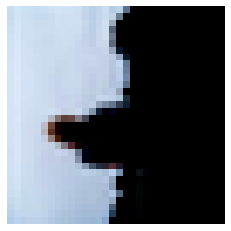

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1113


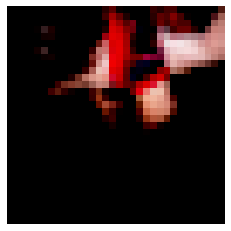

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1114


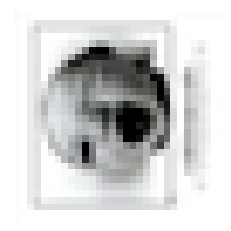

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1115


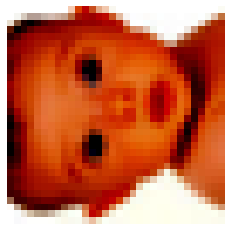

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1116


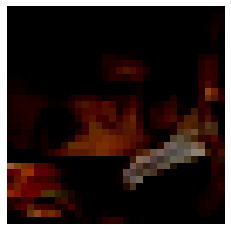

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1117


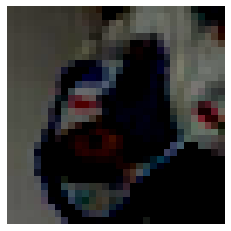

1118


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


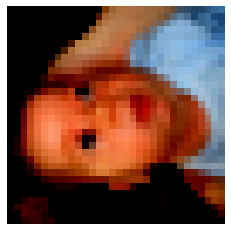

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1119


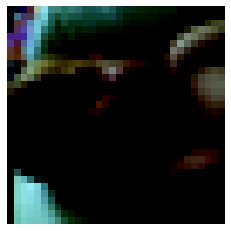

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1120


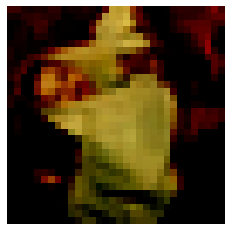

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1121


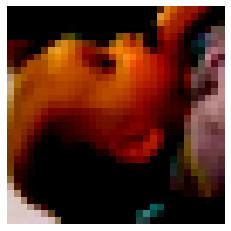

1122


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


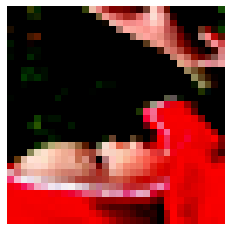

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1123


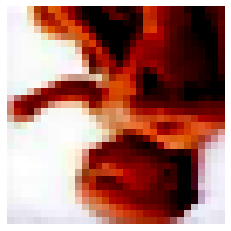

1124


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


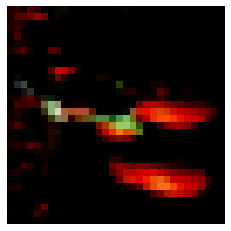

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1125


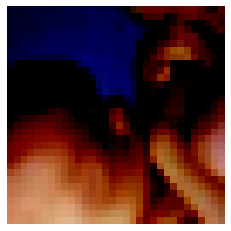

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1126


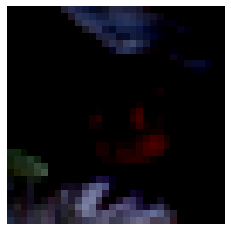

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1127


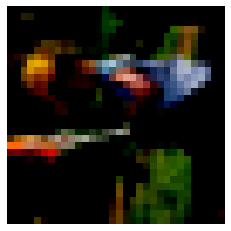

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1128


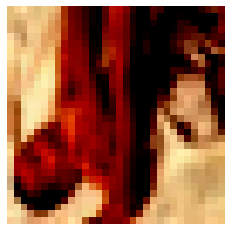

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1129


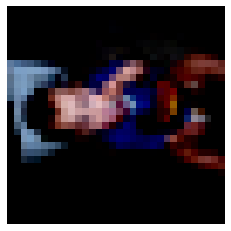

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1130


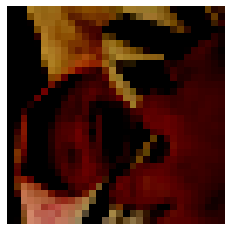

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1131


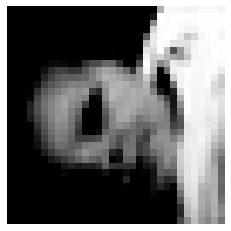

1132


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


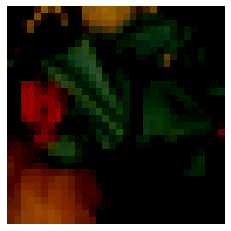

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1133


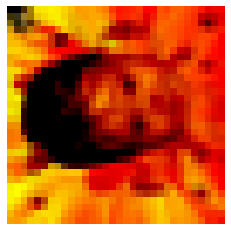

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1134


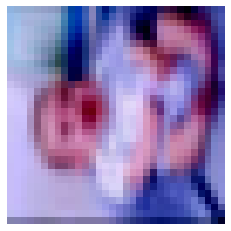

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1135


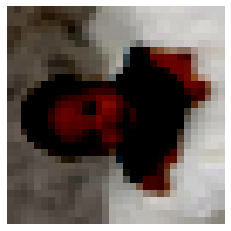

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1136


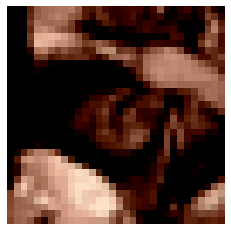

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1137


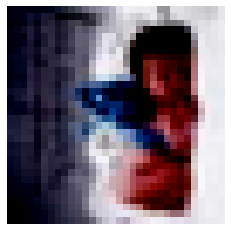

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1138


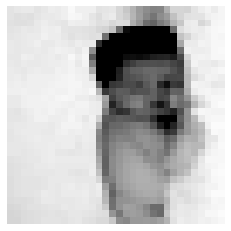

1139


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


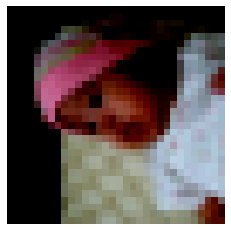

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1140


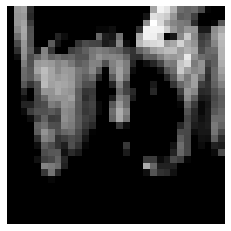

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1141


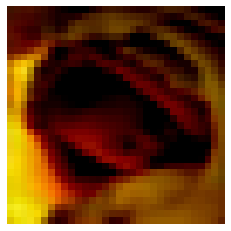

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1142


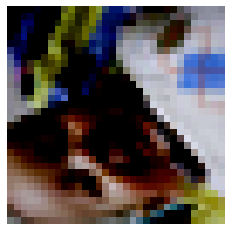

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1143


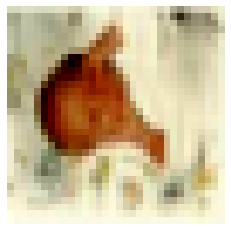

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1144


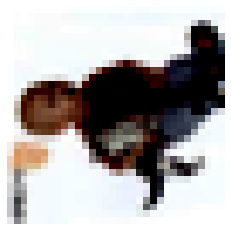

1145


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


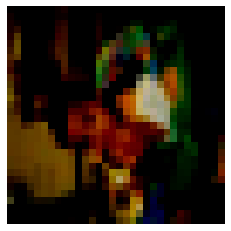

1146


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


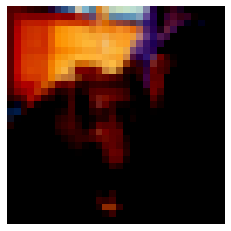

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1147


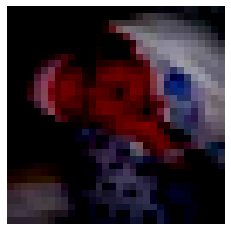

1148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


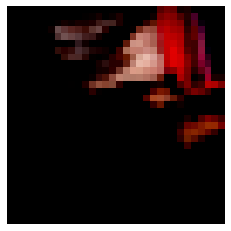

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1149


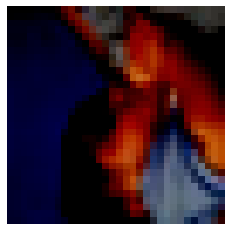

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1150


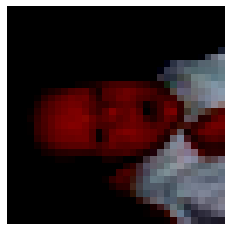

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1151


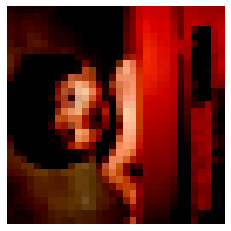

1152


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


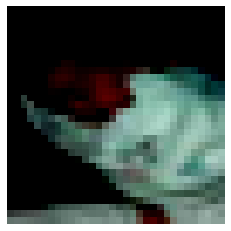

1153


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


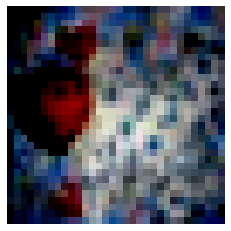

1154


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


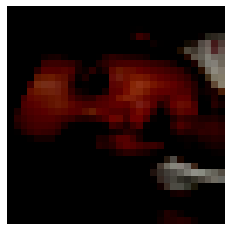

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1155


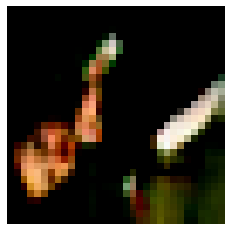

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1156


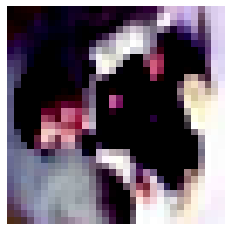

1157


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


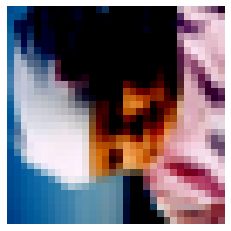

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1158


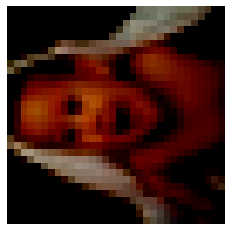

1159


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


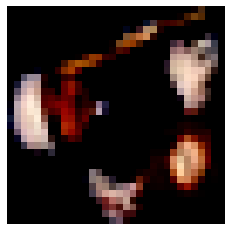

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1160


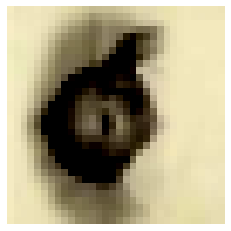

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1161


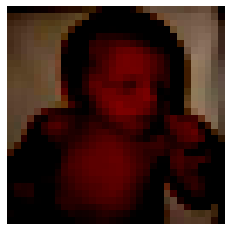

1162


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


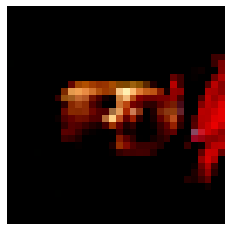

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1163


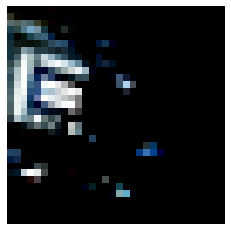

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1164


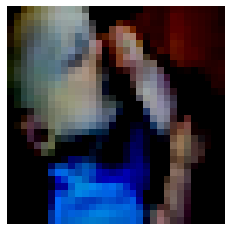

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1165


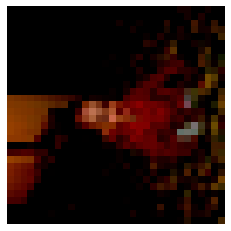

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1166


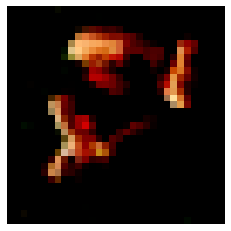

1167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


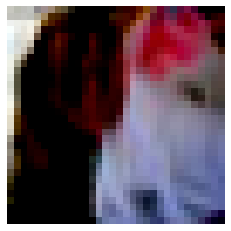

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1168


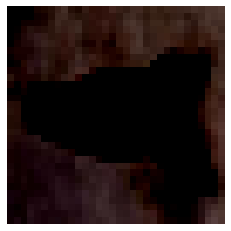

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1169


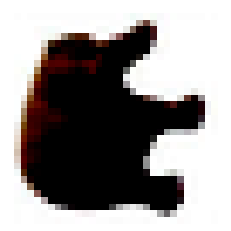

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1170


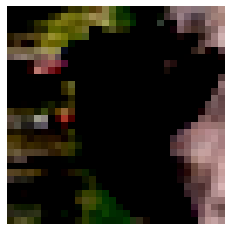

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1171


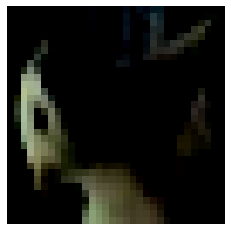

1172


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


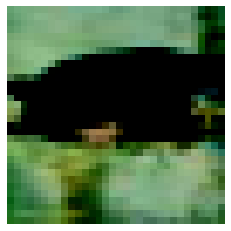

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1173


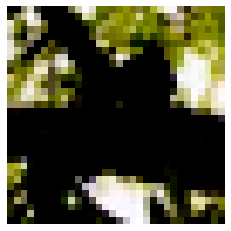

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1174


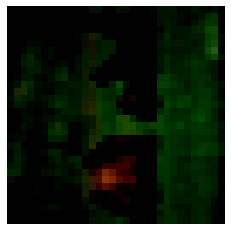

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1175


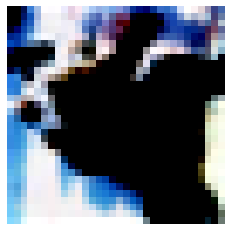

1176


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


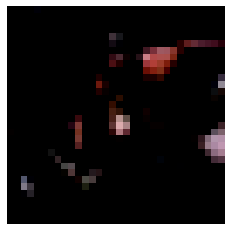

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1177


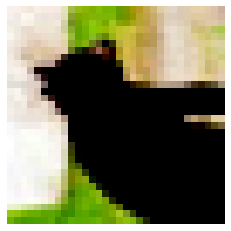

1178


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


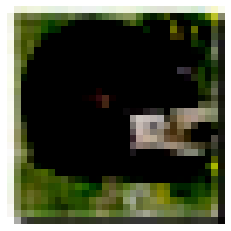

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1179


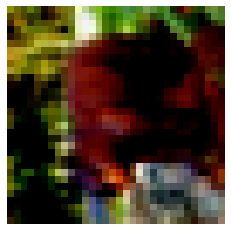

1180


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


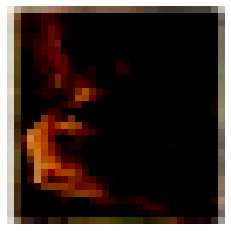

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1181


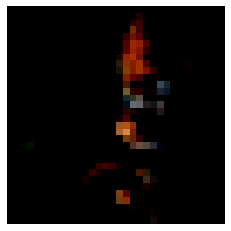

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1182


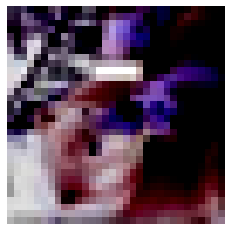

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1183


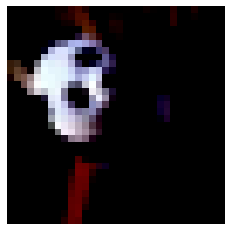

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1184


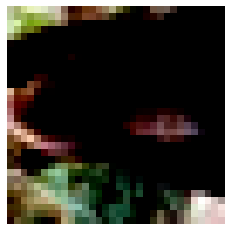

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1185


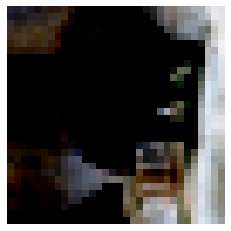

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1186


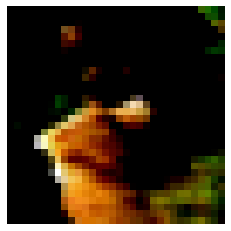

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1187


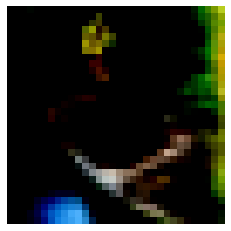

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1188


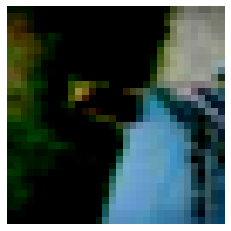

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1189


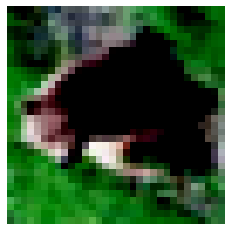

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1190


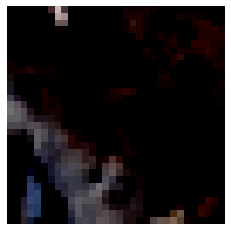

1191


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


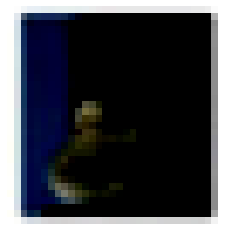

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1192


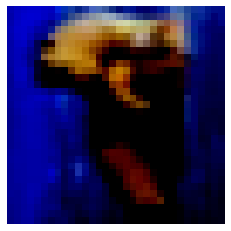

1193


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


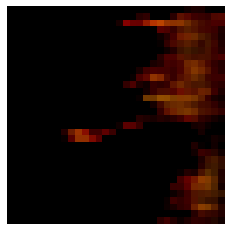

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1194


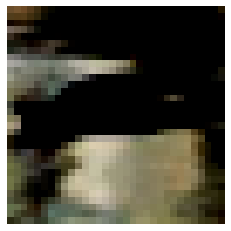

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1195


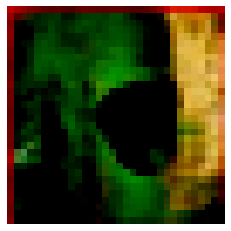

1196


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


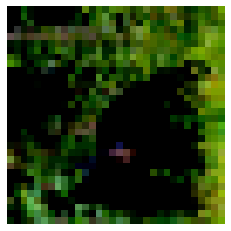

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1197


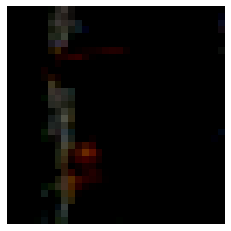

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1198


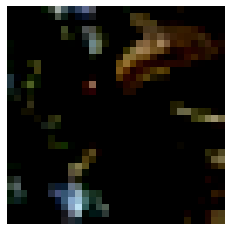

1199


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


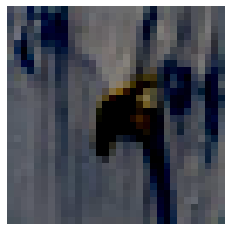

1200


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


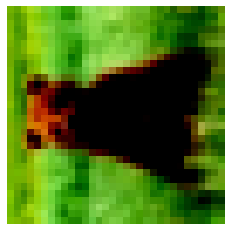

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1201


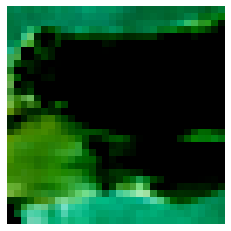

1202


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


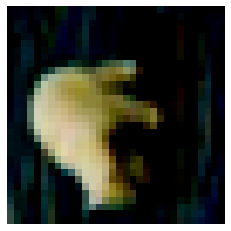

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1203


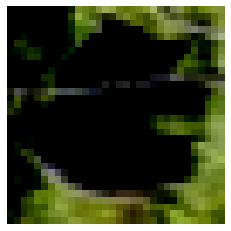

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1204


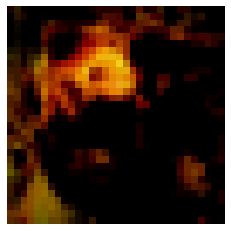

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1205


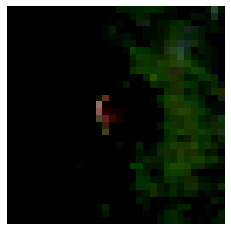

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1206


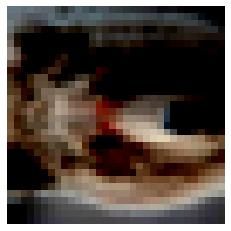

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1207


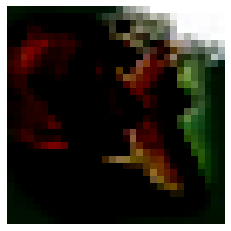

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1208


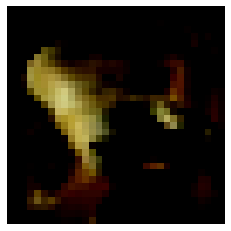

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1209


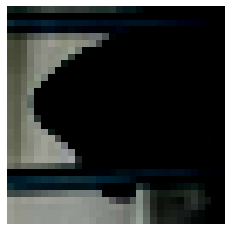

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1210


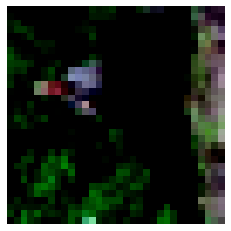

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1211


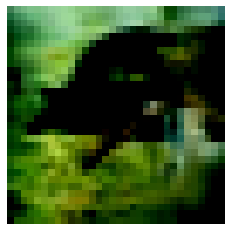

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1212


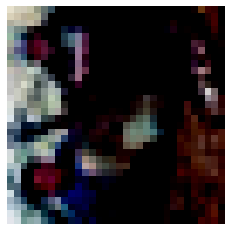

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1213


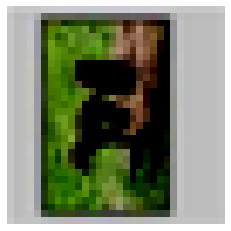

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1214


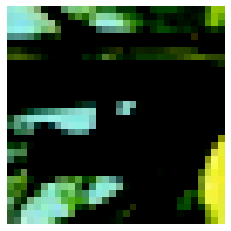

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1215


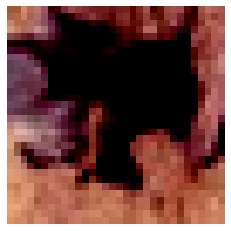

1216


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


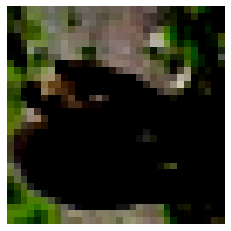

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1217


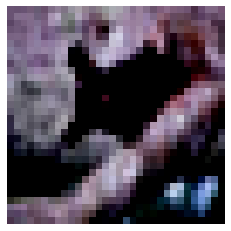

1218


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


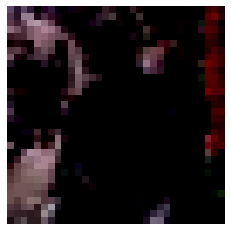

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1219


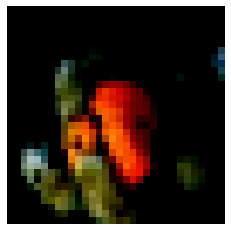

1220


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


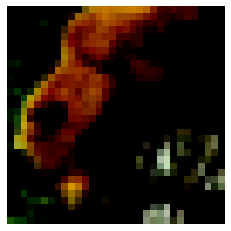

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1221


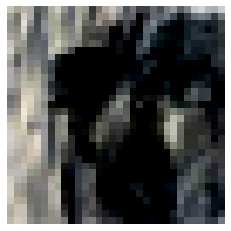

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1222


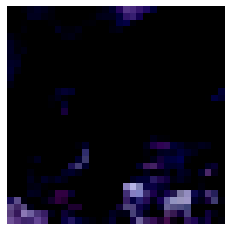

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1223


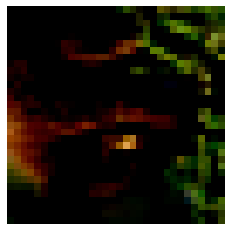

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1224


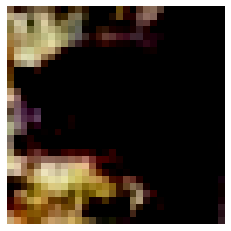

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1225


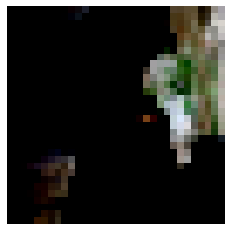

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1226


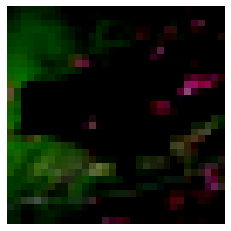

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1227


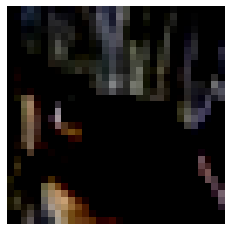

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1228


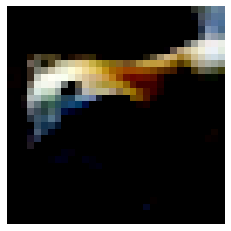

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1229


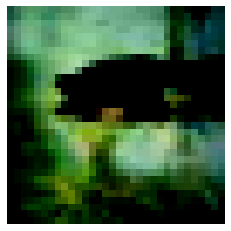

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1230


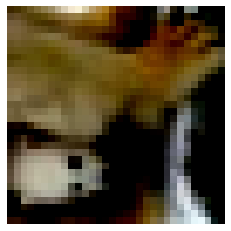

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1231


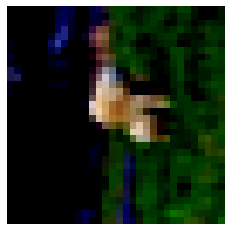

1232


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


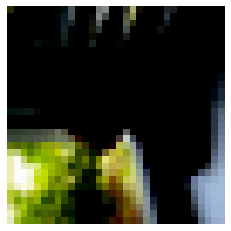

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1233


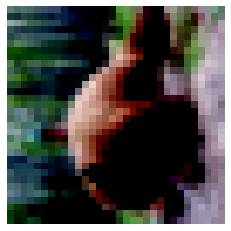

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1234


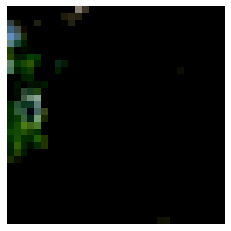

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1235


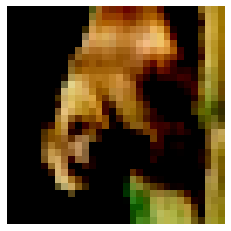

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1236


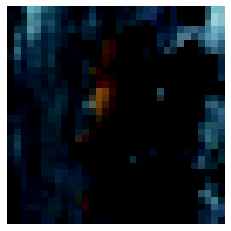

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1237


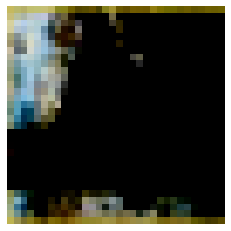

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1238


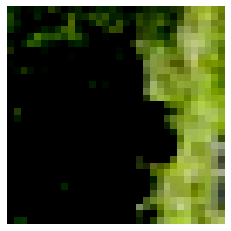

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1239


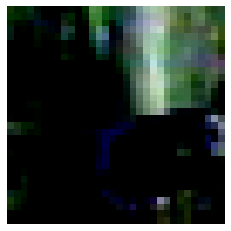

1240


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


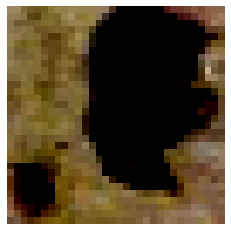

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1241


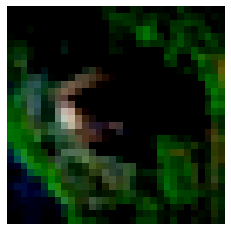

1242


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


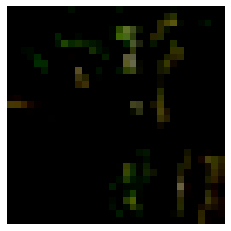

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1243


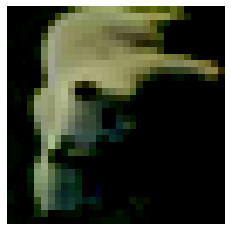

1244


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


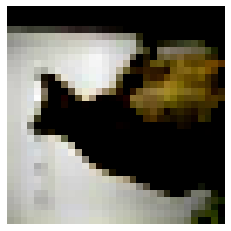

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1245


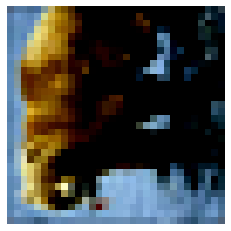

1246


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


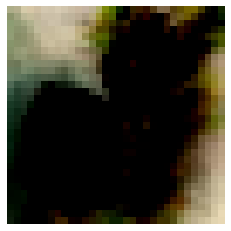

1247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


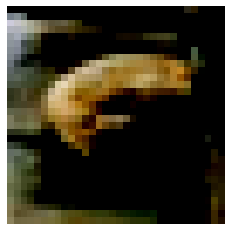

1248


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


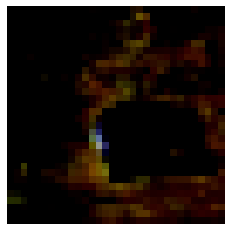

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1249


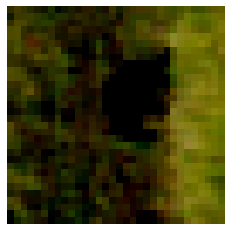

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1250


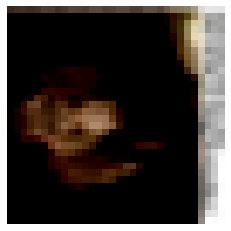

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1251


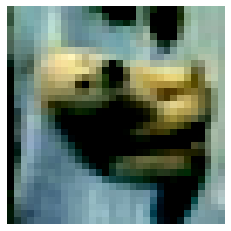

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1252


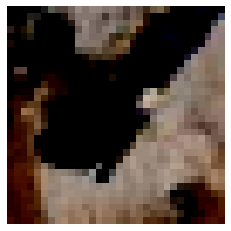

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1253


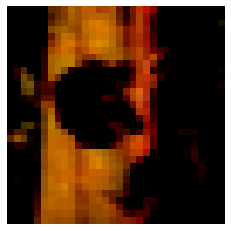

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1254


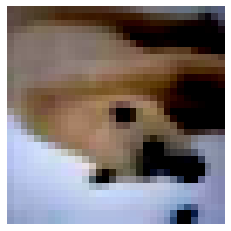

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1255


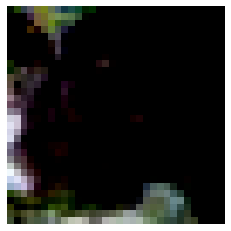

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1256


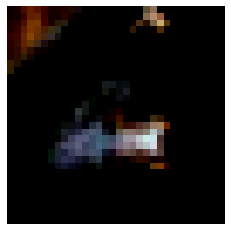

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1257


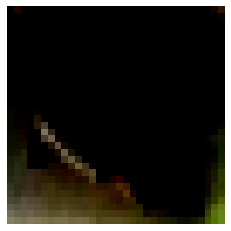

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1258


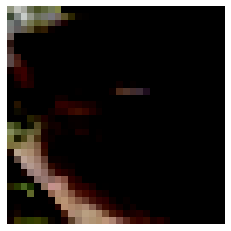

1259


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


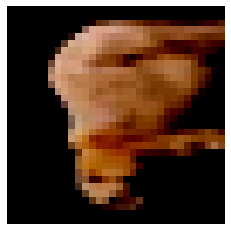

1260


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


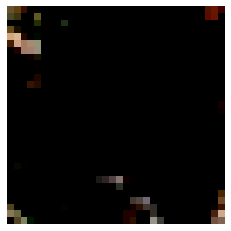

1261


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


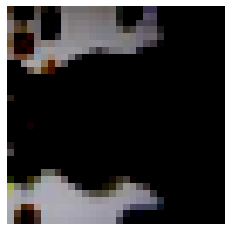

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1262


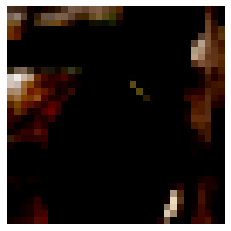

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1263


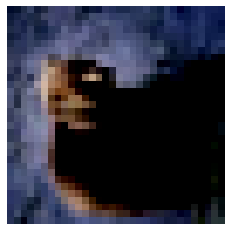

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1264


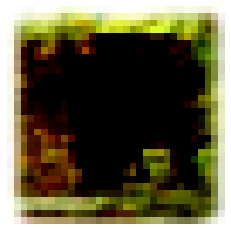

1265


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


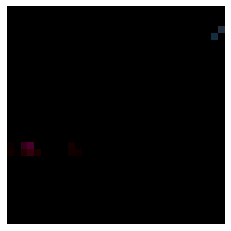

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1266


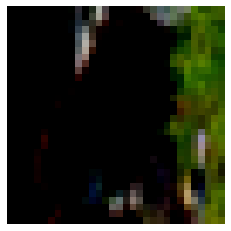

1267


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


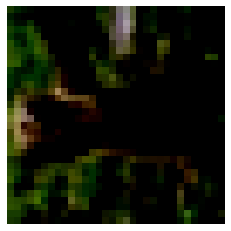

1268


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


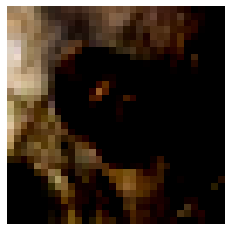

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1269


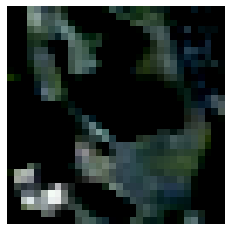

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1270


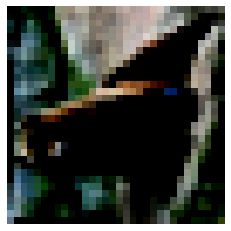

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1271


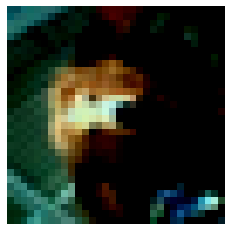

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1272


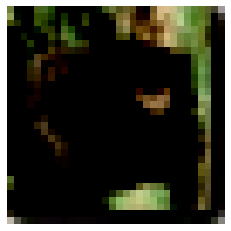

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1273


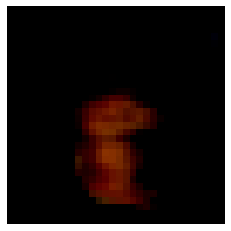

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1274


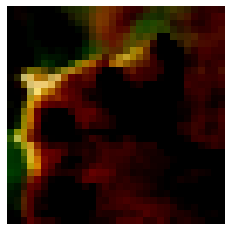

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1275


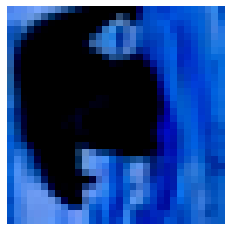

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1276


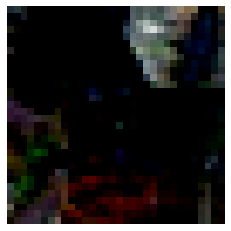

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1277


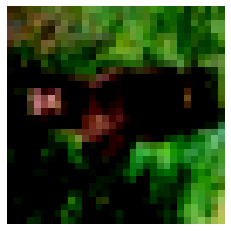

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1278


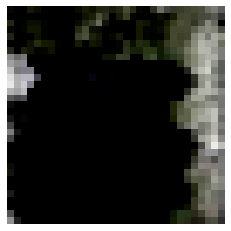

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1279


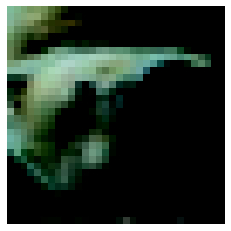

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1280


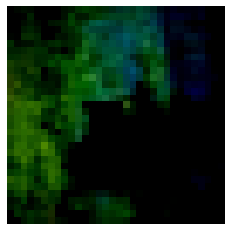

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1281


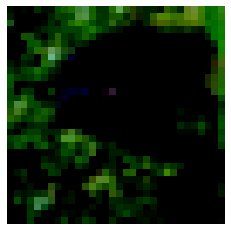

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1282


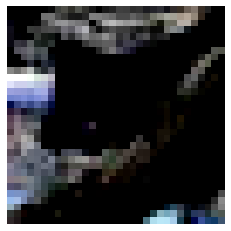

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1283


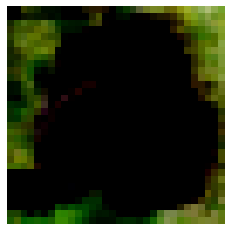

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1284


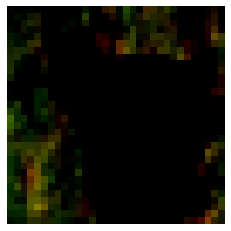

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1285


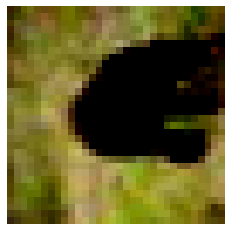

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1286


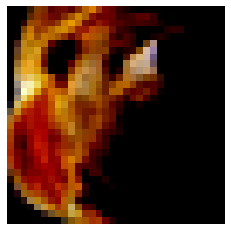

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1287


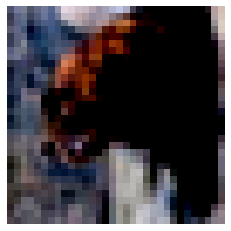

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1288


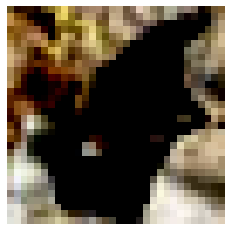

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1289


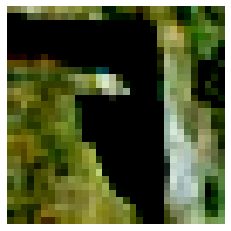

1290


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


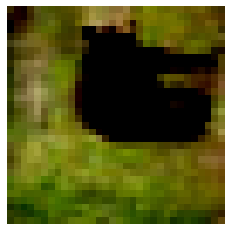

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1291


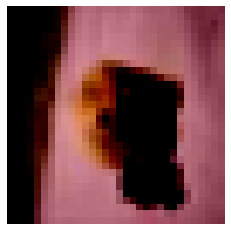

1292


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


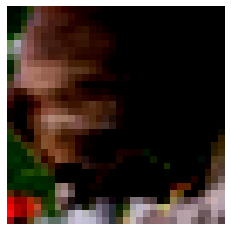

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1293


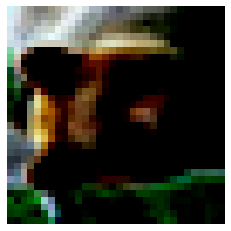

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1294


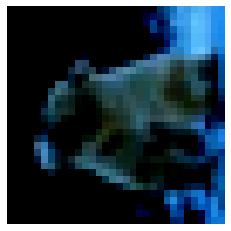

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1295


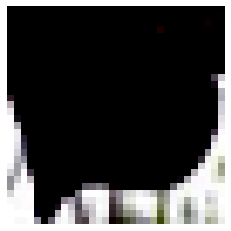

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1296


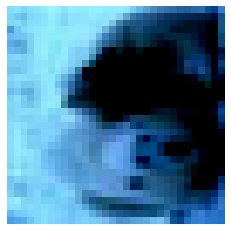

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1297


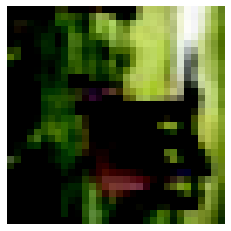

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1298


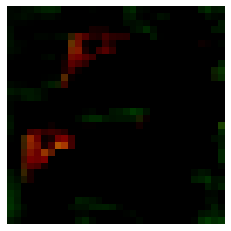

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1299


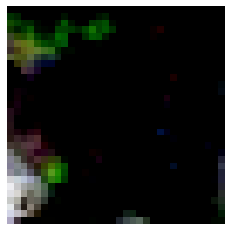

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1300


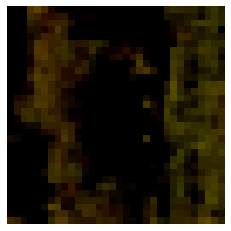

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1301


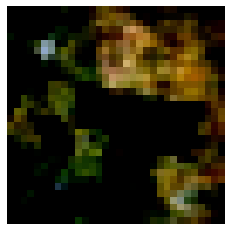

1302


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


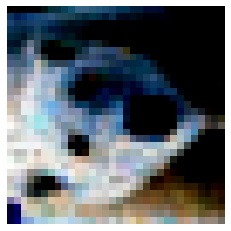

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1303


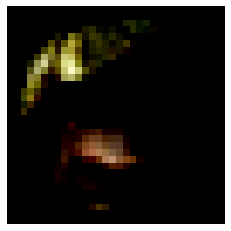

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1304


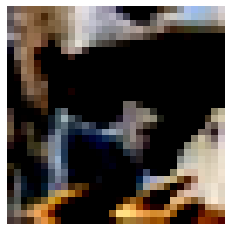

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1305


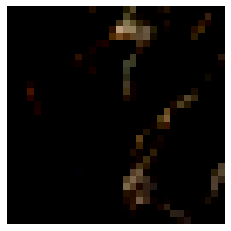

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1306


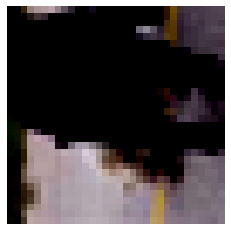

1307


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


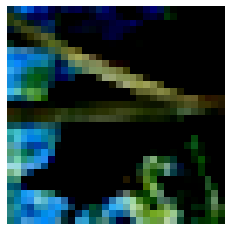

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1308


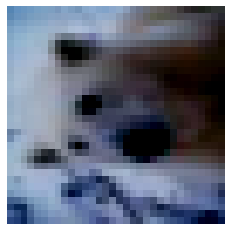

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1309


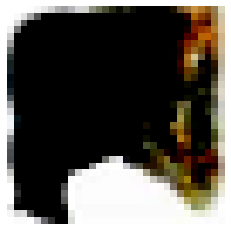

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1310


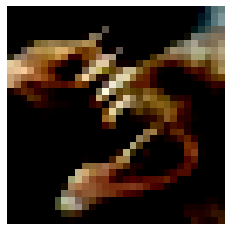

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1311


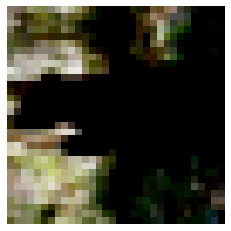

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1312


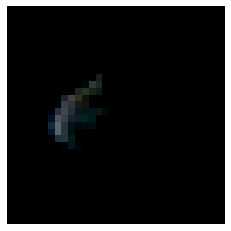

1313


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


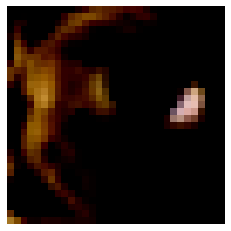

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1314


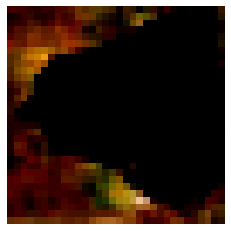

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1315


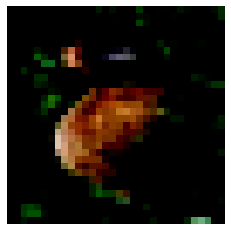

1316


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


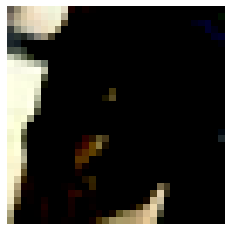

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1317


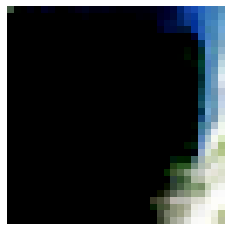

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1318


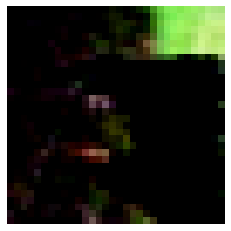

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1319


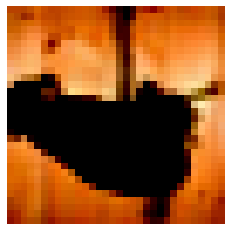

1320


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


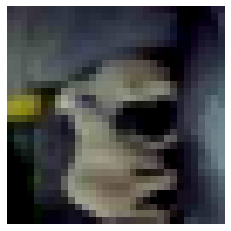

1321


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


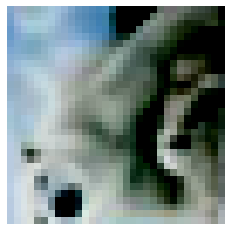

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1322


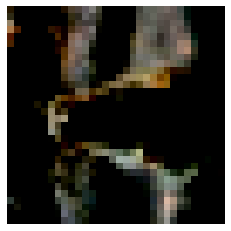

1323


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


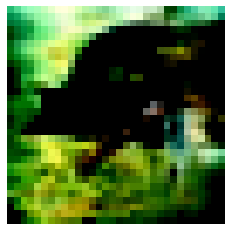

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1324


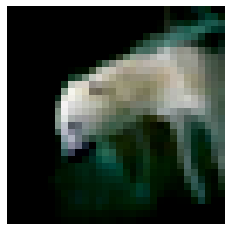

1325


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


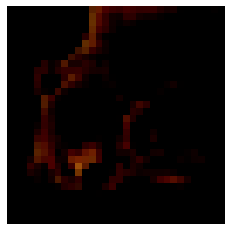

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1326


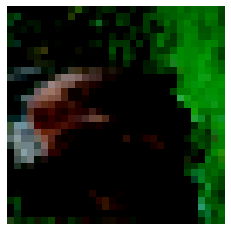

1327


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


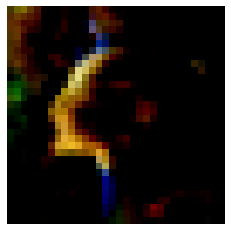

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1328


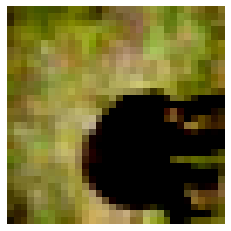

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1329


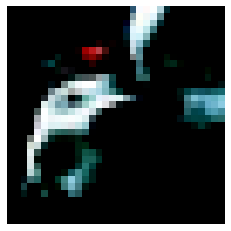

1330


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


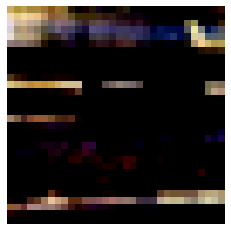

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1331


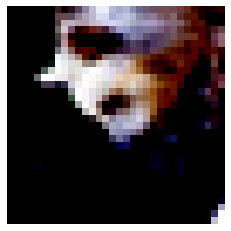

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1332


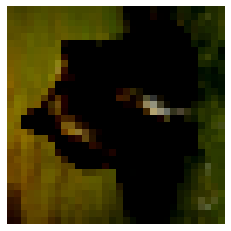

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1333


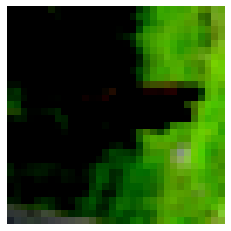

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1334


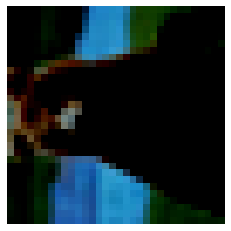

1335


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


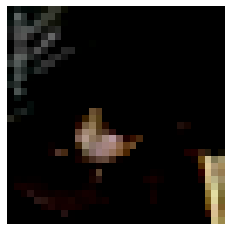

1336


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


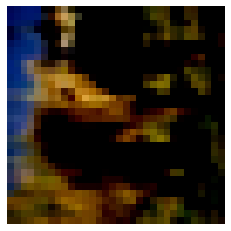

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1337


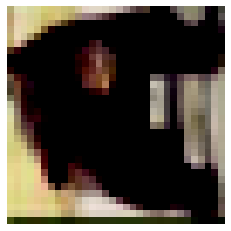

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1338


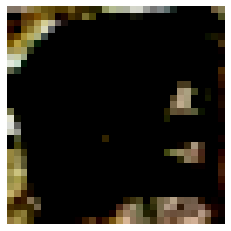

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1339


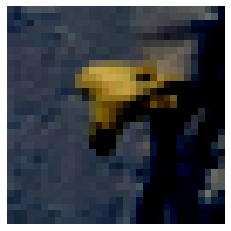

1340


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


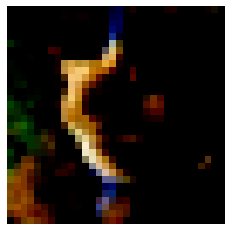

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1341


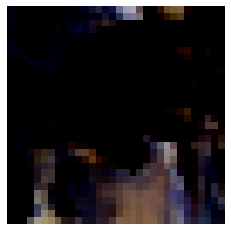

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1342


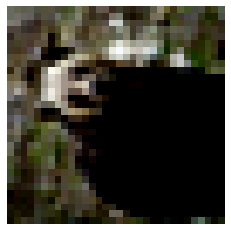

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1343


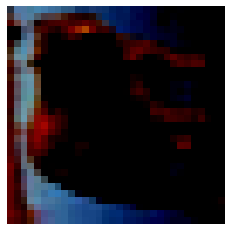

1344


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


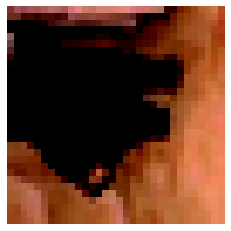

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1345


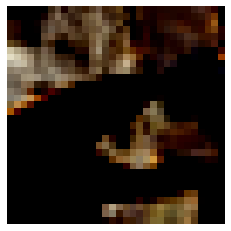

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1346


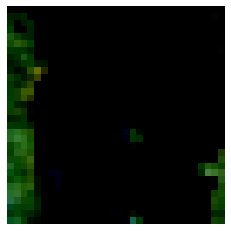

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1347


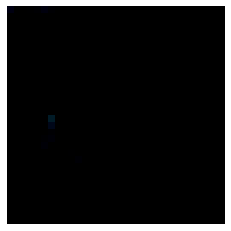

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1348


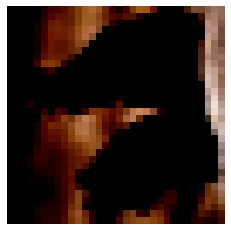

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1349


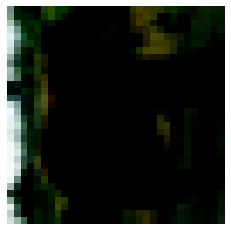

1350


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


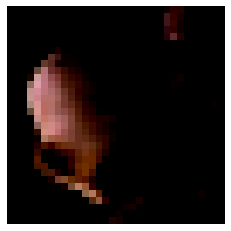

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1351


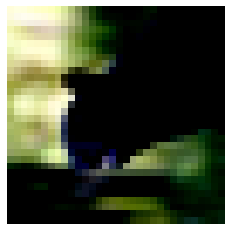

1352


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


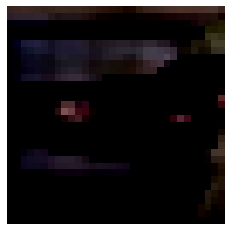

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1353


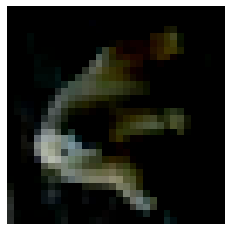

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1354


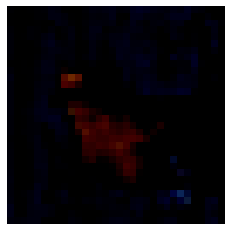

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1355


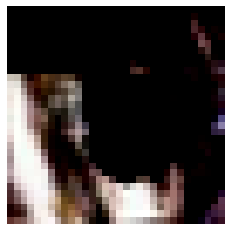

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1356


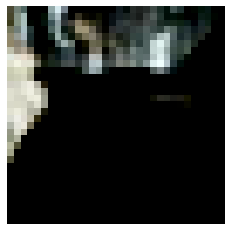

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1357


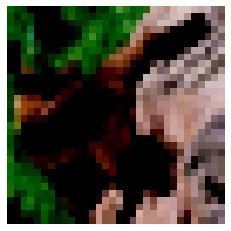

1358


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


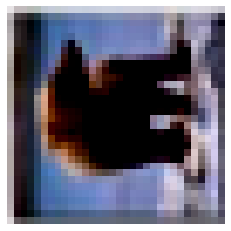

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1359


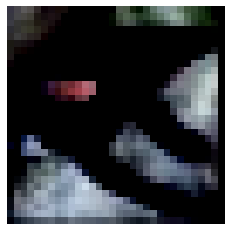

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1360


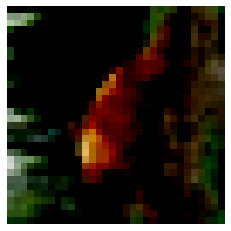

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1361


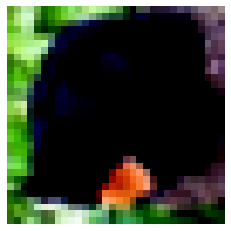

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1362


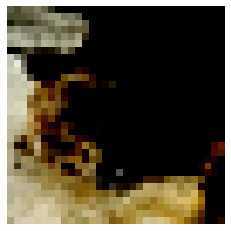

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1363


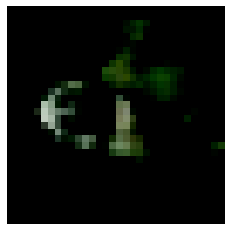

1364


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


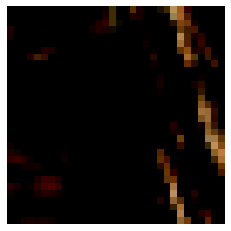

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1365


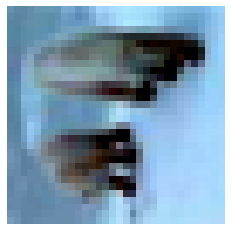

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1366


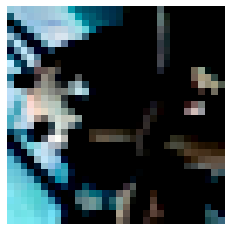

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1367


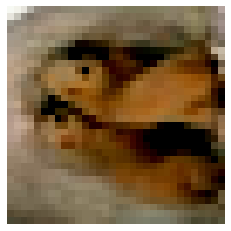

1368


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


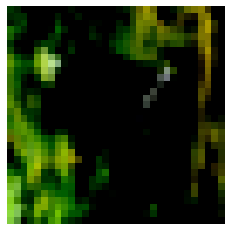

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1369


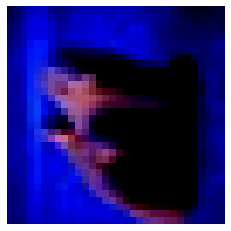

1370


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


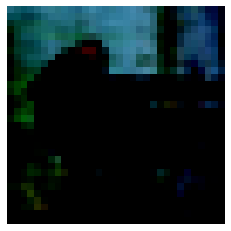

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1371


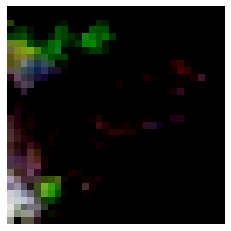

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1372


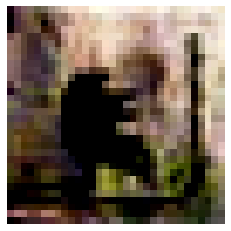

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1373


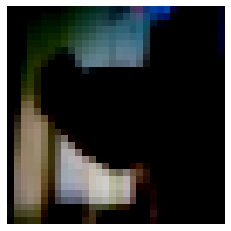

1374


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


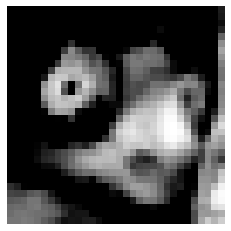

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1375


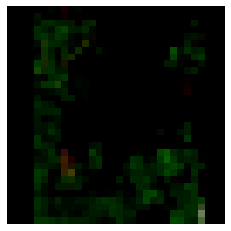

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1376


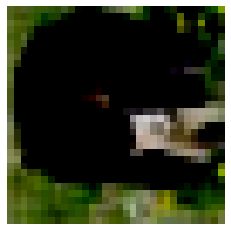

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1377


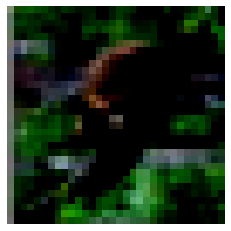

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1378


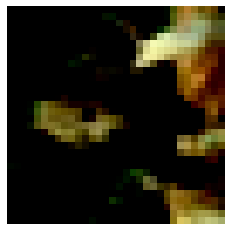

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1379


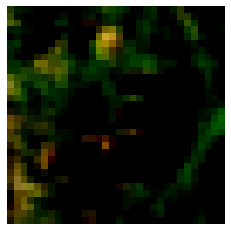

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1380


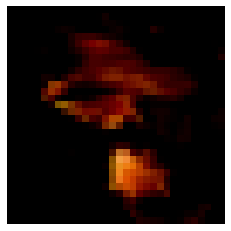

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1381


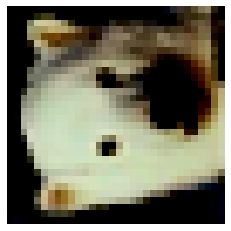

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1382


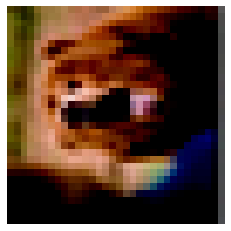

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1383


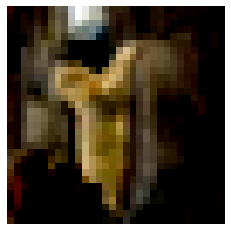

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1384


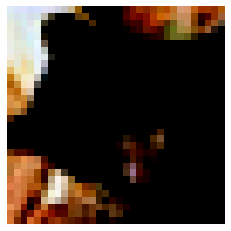

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1385


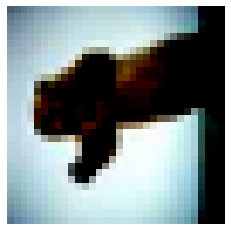

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1386


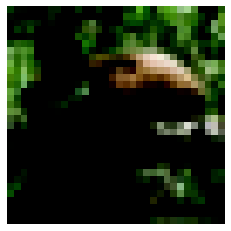

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1387


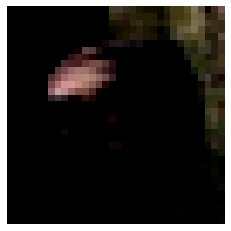

1388


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


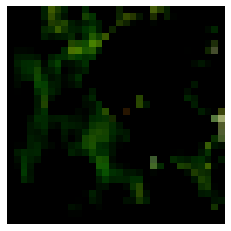

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1389


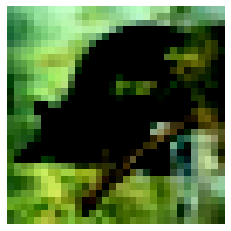

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1390


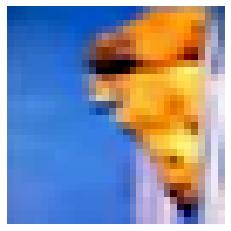

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1391


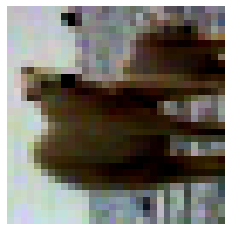

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1392


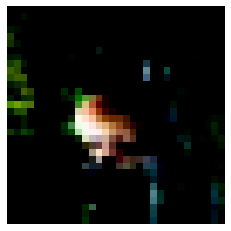

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1393


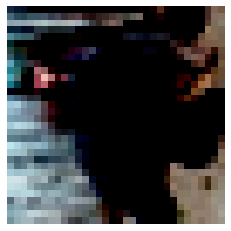

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1394


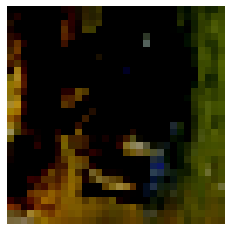

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1395


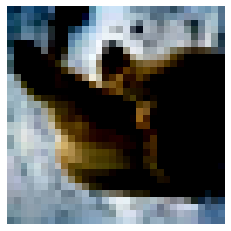

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1396


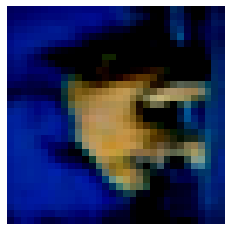

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1397


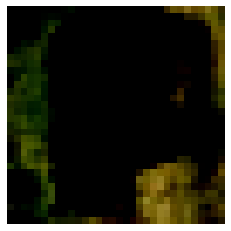

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1398


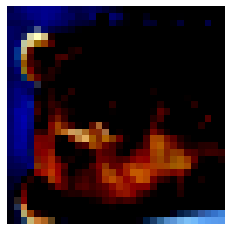

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1399


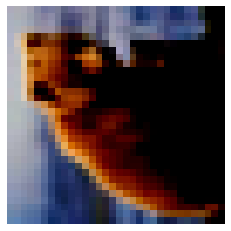

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1400


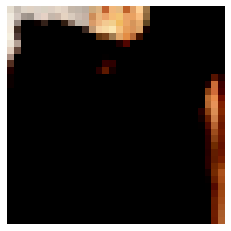

1401


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


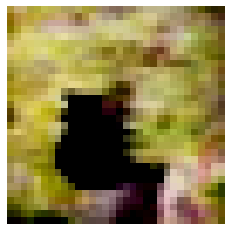

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1402


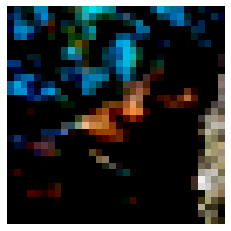

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1403


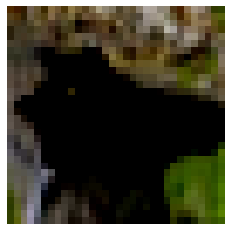

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1404


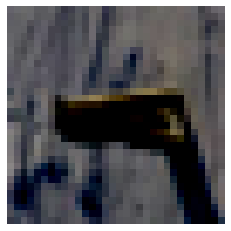

1405


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


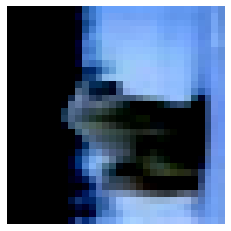

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1406


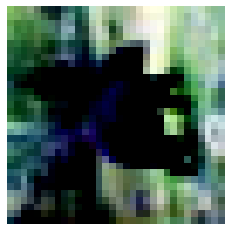

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1407


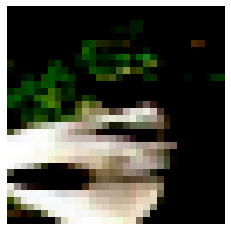

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1408


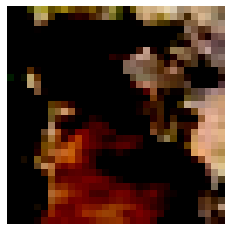

1409


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


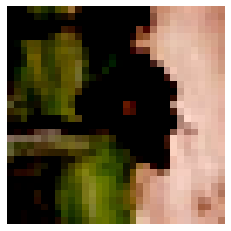

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1410


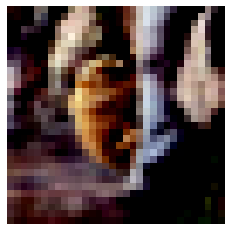

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1411


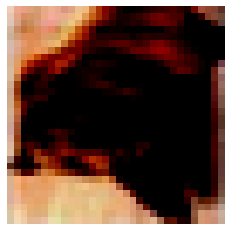

1412


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


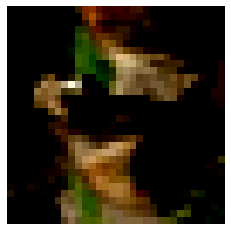

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1413


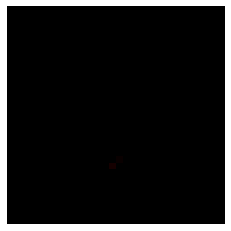

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1414


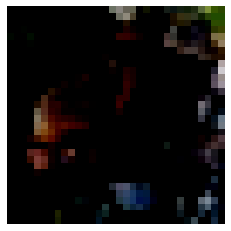

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1415


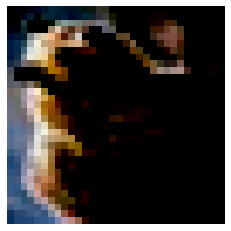

1416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


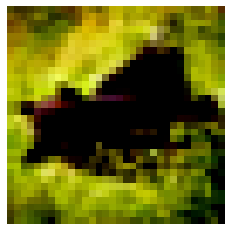

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1417


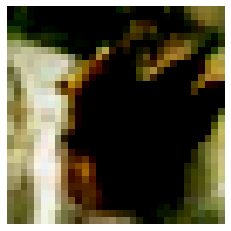

1418


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


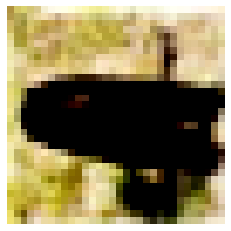

1419


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


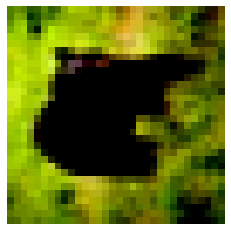

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1420


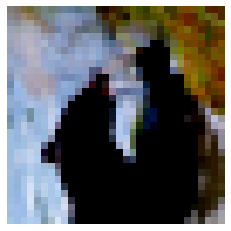

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1421


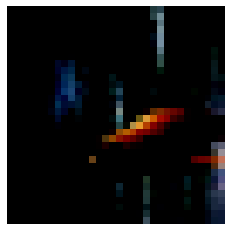

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1422


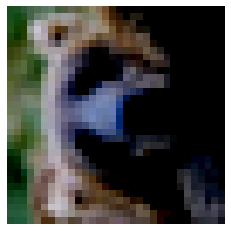

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1423


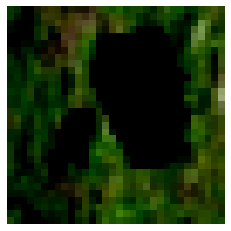

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1424


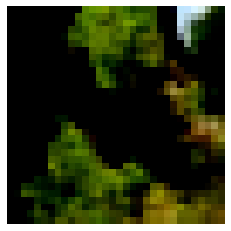

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1425


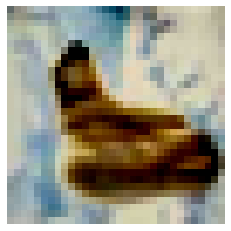

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1426


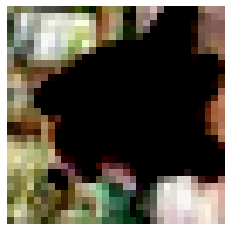

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1427


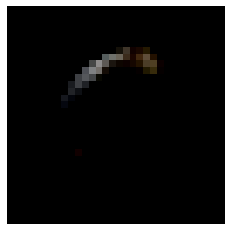

1428


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


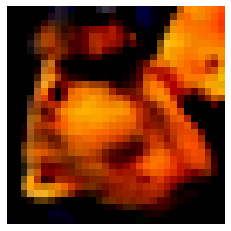

1429


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


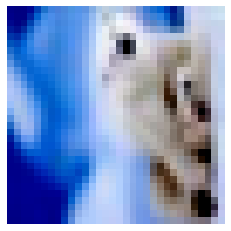

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1430


1431


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1432


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1433


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1434


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1435


1436


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1437


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1438


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1439


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1440


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1441


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1442


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1443


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1444


1445


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1446


1447


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1448


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1449


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1450


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1451


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1452


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1453


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1454


1455


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1456


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1457


1458


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1459


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1460


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1461


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1462


1463


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1464


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1465


1466


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1467


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1468


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1469


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1470


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1471


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1472


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1473


1474


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1475


1476


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1477


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1478


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1479


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1480


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1481


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1482


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1483


1484


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1485


1486


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1487


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1488


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1489


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1490


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1491


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1492


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1493


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1495


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1496


1497


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1498


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1499


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1500


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1501


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1502


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1503


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1504


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1505


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1506


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1507


1508


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1509


1510


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1511


1512


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1513


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1514


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1515


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1516


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1517


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1518


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1519


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1520


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1521


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1522


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1523


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1524


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1525


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1526


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1527


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1528


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1529


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1530


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1531


1532


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1533


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1534


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1535


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1536


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1537


1538


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1539


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1540


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1541


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1542


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1543


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1544


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1545


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1546


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1547


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1548


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1549


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1550


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1551


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1552


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1553


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1554


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1555


1556


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1557


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1558


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1559


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1560


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1561


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1562


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1563


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1564


1565


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1566


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1567


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1568


1569


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1570


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1571


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1572


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1573


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1574


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1575


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1576


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1577


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1578


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1579


1580


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1581


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1582


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1583


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1584


1585


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1586


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1587


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1588


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1589


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1590


1591


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1592


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1593


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1594


1595


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1596


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1597


1598


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1599


1600


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1601


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1602


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1603


1604


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1605


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1606


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1607


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1608


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1609


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1610


1611


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1612


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1613


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1614


1615


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1616


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1617


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1618


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1619


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1620


1621


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1622


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1623


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1624


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1626


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1627


1628


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1629


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1630


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1631


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1632


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1633


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1634


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1635


1636


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1637


1638


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1639


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1640


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1641


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1642


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1643


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1644


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1645


1646


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1647


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1648


1649


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1650


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1651


1652


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1653


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1654


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1655


1656


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1657


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1658


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1659


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1660


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1661


1662


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1663


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1664


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1665


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1666


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1668


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1669


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1670


1671


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1672


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1673


1674


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1675


1676


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1677


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1678


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1679


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1680


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1681


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1682


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1683


1684


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1685


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1686


1687


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1689


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1690


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1691


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1692


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1693


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1694


1695


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1696


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1697


1698


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1699


1700


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1701


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1702


1703


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1704


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1705


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1706


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1707


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1708


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1709


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1710


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1711


1712


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1713


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1714


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1715


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1716


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1717


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1718


1719


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1720


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1721


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1722


1723


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1724


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1725


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1726


1727


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1728


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1729


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1730


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1731


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1732


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1733


1734


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1735


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1736


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1737


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1738


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1739


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1740


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1741


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1742


1743


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1744


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1745


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1746


1747


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1749


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1750


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1751


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1752


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1753


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1754


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1755


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1756


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1757


1758


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1759


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1760


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1761


1762


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1763


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1765


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1766


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1767


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1768


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1769


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1770


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1771


1772


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1773


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1774


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1775


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1776


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1777


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1778


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1779


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1780


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1781


1782


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1783


1784


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1785


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1786


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1787


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1788


1789


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1790


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1791


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1792


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1793


1794


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1795


1796


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1797


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1798


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1799


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1800


1801


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1802


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1803


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1804


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1805


1806


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1807


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1808


1809


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1810


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1811


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1812


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1814


1815


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1816


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1817


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1818


1819


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1820


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1821


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1822


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1823


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1825


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1826


1827


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1828


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1829


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1830


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1831


1832


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1833


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1834


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1835


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1836


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1837


1838


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1839


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1840


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1841


1842


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1843


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1844


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1845


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1846


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1847


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1848


1849


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1850


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1851


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1852


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1853


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1854


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1855


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1856


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1857


1858


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1859


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1860


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1861


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1862


1863


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1864


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1865


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1866


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1867


1868


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1869


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1870


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1871


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1872


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1873


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1874


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1876


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1877


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1878


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1879


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1880


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1881


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1882


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1883


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1884


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1885


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1886


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1887


1888


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1889


1890


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1891


1892


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1893


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1894


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1895


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1896


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1897


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1898


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1899


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1900


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1901


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1902


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1903


1904


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1905


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1906


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1907


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1908


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1909


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1910


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1911


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1912


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1913


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1914


1915


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1916


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1917


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1918


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1919


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1920


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1921


1922


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1923


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1924


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1925


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1926


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1927


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1928


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1929


1930


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1931


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1932


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1933


1934


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1935


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1936


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1937


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1938


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1939


1940


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1941


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1942


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1943


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1944


1945


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1946


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1947


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1948


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1949


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1950


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1951


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1952


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1953


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1955


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1956


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1957


1958


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1959


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1960


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1961


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1962


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1963


1964


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1965


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1966


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1967


1968


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1969


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1970


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1971


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1972


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1973


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1974


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1975


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1976


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1977


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1978


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1979


1980


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1981


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1982


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1983


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1984


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1985


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1986


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1987


1988


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1989


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1990


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1991


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1992


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1993


1994


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1995


1996


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1997


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1998


1999


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2000


2001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2002


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2004


2005


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2007


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2008


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2009


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2010


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2011


2012


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2013


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2014


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2015


2016


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2017


2018


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2019


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2020


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2021


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2022


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2023


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2024


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2025


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2026


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2027


2028


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2029


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2030


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2031


2032


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2033


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2034


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2035


2036


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2037


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2038


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2039


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2040


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2041


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2042


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2043


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2044


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2045


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2046


2047


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2048


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2049


2050


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2051


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2052


2053


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2054


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2055


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2056


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2057


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2058


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2059


2060


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2061


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2062


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2063


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2064


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2065


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2066


2067


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2068


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2069


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2070


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2071


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2072


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2073


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2074


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2075


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2076


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2077


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2078


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2079


2080

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2081


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2082


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2083


2084


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2085


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2086


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2087


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2088


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2089


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2090


2091


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2092


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2093


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2094


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2095


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2096


2097


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2098


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2099


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2101


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2102


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2103


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2104


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2105


2106


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2111


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2112


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2114


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2115


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2116


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2117


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2118


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2119


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2120


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2121


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2122


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2123


2124


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2126


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2127


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2128


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2129


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2130


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2131


2132


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2133


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2134


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2135


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2136


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2137


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2138


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2139


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2140


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2141


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2142


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2144


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2145


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2146


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2147


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2149


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2150


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2151


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2152


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2153


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2154


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2155


2156


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2157


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2159


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2160


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2161


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2162


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2163


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2164


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2165


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2166


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2168


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2169


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2170


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2171


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2172


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2173


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2174


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2176


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2177


2178


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2179


2180


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2181


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2182


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2183


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2184


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2185


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2186


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2187


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2188


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2190


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2191


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2192


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2193


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2194


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2196


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2197


2198


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2199


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2200


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2201


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2202


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2203


2204


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2205


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2206


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2207


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2208


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2209


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2210


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2211


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2212


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2213


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2214


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2215


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2216


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2217


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2218


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2219


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2220


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2221


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2222


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2223


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2224


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2225


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2226


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2227


2228


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2229


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2230


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2231


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2232


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2233


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2234


2235


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2236


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2237


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2238


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2239


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2240


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2241


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2242


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2243


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2244


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2245


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2246


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2248


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2249


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2250


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2251


2252


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2253


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2254


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2255


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2256


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2257


2258


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2259


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2260


2261


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2262


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2263


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2264


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2265


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2266


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2267


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2268


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2269


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2270


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2271


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2272


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2273


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2274


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2275


2276


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2277


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2278


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2279


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2280


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2281


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2282


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2283


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2284


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2285


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2286


2287


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2288


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2289


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2290


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2291


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2292


2293


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2294


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2295


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2296


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2297


2298


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2299


2300


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2301


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2302


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2303


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2304


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2305


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2306


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2307


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2308


2309


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2310


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2311


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2313


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2314


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2315


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2316


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2317


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2318


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2319


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2320


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2321


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2322


2323


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2324


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2325


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2326


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2327


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2328


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2329


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2330


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2331


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2332


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2333


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2334


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2335


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2336


2337


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2338


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2339


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2340


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2341


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2342


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2343


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2344


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2345


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2346


2347


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2348


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2349


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2350


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2351


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2352


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2353


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2354


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2355


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2356


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2357


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2358


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2359


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2360


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2361


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2362


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2363


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2364


2365


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2366


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2367


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2368


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2369


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2370


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2371


2372


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2373


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2374


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2376


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2377


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2378


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2379


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2380


2381


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2382


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2383


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2384


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2385


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2386


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2387


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2388


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2389


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2390


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2391


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2392


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2393


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2394


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2395


2396


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2397


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2398


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2399


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2400


2401


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2402


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2403


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2404


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2405


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2406


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2407


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2408


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2409


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2410


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2411


2412


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2413


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2414


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2415


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2417


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2418


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2419


2420


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2421


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2422


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2423


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2424


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2425


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2426


2427


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2428


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2429


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2430


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2431


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2432


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2433


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2434


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2435


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2436


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2437


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2438


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2439


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2440


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2441


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2442


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2443


2444


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2445


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2446


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2447


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2448


2449


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2450


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2451


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2452


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2453


2454


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2455


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2456


2457


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2458


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2459


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2460


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2461


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2462


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2463


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2464


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2465


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2466


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2467


2468


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2469


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2470


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2471


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2472


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2473


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2474


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2475


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2476


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2477


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2478


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2479


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2480


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2481


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2482


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2483


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2484


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2485


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2486


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2487


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2488


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2489


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2490


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2491


2492


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2493


2494


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2495


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2496


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2497


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2498


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2499


2500


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2501


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2502


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2503


2504


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2505


2506


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2507


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2508


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2509


2510


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2511


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2512


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2513


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2514


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2515


2516


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2517


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2518


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2519


2520


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2521


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2522


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2523


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2524


2525


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2526


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2527


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2528


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2529


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2530


2531


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2532


2533


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2534


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2535


2536


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2537


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2538


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2539


2540


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2541


2542


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2543


2544


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2545


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2546


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2547


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2548


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2549


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2550


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2551


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2552


2553


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2554


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2555


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2556


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2557


2558


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2559


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2560


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2561


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2562


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2563


2564


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2565


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2566


2567


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2568


2569


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2570


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2571


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2572


2573


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2574


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2575


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2576


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2577


2578


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2579


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2580


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2581


2582


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2583


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2584


2585


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2586


2587


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2588


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2589


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2590


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2591


2592


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2593


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2594


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2595


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2596


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2597


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2598


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2599


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2600


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2601


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2602


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2603


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2604


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2605


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2606


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2607


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2608


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2609


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2610


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2611


2612


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2613


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2614


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2615


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2616


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2617


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2618


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2619


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2620


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2621


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2622


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2623


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2624


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2626


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2627


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2628


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2629


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2630


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2631


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2632


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2633


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2634


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2635


2636


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2637


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2638


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2639


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2640


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2641


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2642


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2643


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2644


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2645


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2646


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2647


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2648


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2649


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2650


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2651


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2652


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2653


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2654


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2655


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2656


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2657


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2658


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2659


2660


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2661


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2662


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2663


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2664


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2665


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2666


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2667


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2668


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2669


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2670


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2671


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2672


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2673


2674


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2675


2676


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2677


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2678


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2679


2680


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2681


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2682


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2683


2684


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2685


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2686


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2687


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2689


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2690


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2691


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2692


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2693


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2694


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2695


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2696


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2697


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2698


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2699


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2700


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2701


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2702


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2703


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2704


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2705


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2706


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2707


2708


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2709


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2710


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2711


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2712


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2713


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2714


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2715


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2716


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2717


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2718


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2719


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2720


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2721


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2722


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2723


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2724


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2725


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2726


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2727


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2728


2729


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2730


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2731


2732


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2733


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2734


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2735


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2736


2737


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2738


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2739


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2740


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2741


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2742


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2743


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2744


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2745


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2746


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2747


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2749


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2750


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2751


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2752


2753


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2754


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2755


2756


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2757


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2758


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2759


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2760


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2761


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2762


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2763


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2764


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2765


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2766


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2767


2768


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2769


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2770


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2771


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2772


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2773


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2774


2775


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2776


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2777


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2778


2779


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2780


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2781


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2782


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2783


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2784


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2785


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2786


2787


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2788


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2789


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2790


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2791


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2792


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2793


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2794


2795


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2796


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2797


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2798


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2799


2800


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2801


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2802


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2803


2804


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2805


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2806


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2807


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2808


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2809


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2810


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2811


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2812


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2814


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2815


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2816


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2817


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2818


2819


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2820


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2821


2822


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2823


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2824


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2825


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2826


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2827


2828


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2829


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2830


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2831


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2832


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2833


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2834


2835


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2836


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2837


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2838


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2839


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2840


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2841


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2842


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2843


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2844


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2845


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2846


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2847


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2848


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2849


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2850


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2851


2852


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2853


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2854


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2855


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2856


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2857


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2858


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2859


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2860


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2861


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2862


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2863


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2864


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2865


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2866


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2867


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2868


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2869


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2870


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2871


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2872


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2873


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2874


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2875


2876


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2877


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2878


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2879


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2880


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2881


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2882


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2883


2884


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2885


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2886


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2887


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2888


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2889


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2890


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2891


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2892


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2893


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2894


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2895


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2896


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2897


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2898


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2899


2900


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2901


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2902


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2903


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2904


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2905


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2906


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2907


2908


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2909


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2910


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2911


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2912


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2913


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2914


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2915


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2916


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2917


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2918


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2919


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2920


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2921


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2922


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2923


2924


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2925


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2926


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2927


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2928


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2929


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2930


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2931


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2932


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2933


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2934


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2935


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2936


2937


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2938


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2939


2940


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2941


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2942


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2943


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2944


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2945


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2946


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2947


2948


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2949


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2950


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2951


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2952


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2953


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2955


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2956


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2957


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2958


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2959


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2960


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2961


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2962


2963


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2964


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2965


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2966


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2968


2969


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2970


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2971


2972


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2973


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2974


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2975


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2976


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2977


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2978


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2979


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2980


2981

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2982


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2983


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2984


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2985


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2986


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2987


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2988


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2989


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2990


2991


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2992


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2993


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2994


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2995


2996


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2997


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2998


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2999


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3000


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3001


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3002


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3003


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3004


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3005


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3006


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3007


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3008


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3009


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3010


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3011


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3012


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3013


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3014


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3015


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3016


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3017


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3018


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3019


3020


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3021


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3022


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3023


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3024


3025


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3026


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3027


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3028


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3029


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3030


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3031


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3032


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3033


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3034


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3035


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3036


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3037


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3038


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3039


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3040


3041


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3042


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3043


3044


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3045


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3046


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3047


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3048


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3049


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3050


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3051


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3052


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3053


3054


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3055


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3056


3057


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3058


3059


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3060


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3061


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3062


3063


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3064


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3065


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3066


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3067


3068


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3069


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3070


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3071


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3072


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3073


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3074


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3075


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3076


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3077


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3078


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3079


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3080


3081


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3082


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3083


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3084


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3085


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3086


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3087


3088


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3089


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3090


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3091


3092


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3093


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3094


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3095


3096


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3097


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3098


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3099


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3101


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3102


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3103


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3104


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3105


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3106


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3108


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3111


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3112


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3114


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3115


3116


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3117


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3118


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3119


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3120


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3121


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3122


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3123


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3124


3125


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3126


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3127


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3128


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3129


3130


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3131


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3132


3133


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3134


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3135


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3136


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3137


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3138


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3139


3140


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3141


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3142


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3144


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3145


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3146


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3147


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3149


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3150


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3151


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3152


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3153


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3154


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3155


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3156


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3157


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3159


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3160


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3161


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3162


3163


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3164


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3165


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3166


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3168


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3169


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3170


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3171


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3172


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3173


3174


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3176


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3177


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3178


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3179


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3180


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3181


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3182


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3183


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3184


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3185


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3186


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3187


3188


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3190


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3191


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3192


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3193


3194


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3196


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3197


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3198


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3199


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3200


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3201


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3202


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3203


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3204


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3205


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3206


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3207


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3208


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3209


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3210


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3211


3212


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3213


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3214


KeyboardInterrupt: 

In [120]:
#Vérification des labels
for i in range(dataset_size7):
    img, label = dataset_Species[i]
    print(i)
    figure = plt.figure()
    plt.axis("off")
    plt.imshow(img.squeeze().T, cmap="gray")
    plt.show()


In [121]:
img_dict7 = {}
for i in range(num_classes7):
    img_dict7[classes7[i]] = 0
for i in range(dataset_size7):
    img, label = dataset_Species[i]
    img_dict7[classes7[label]] += 1
img_dict7

{'apple': 500,
 'aquarium_fish': 372,
 'baby': 296,
 'bear': 270,
 'beaver': 209,
 'bed': 200,
 'bee': 189,
 'beetle': 152,
 'bicycle': 152,
 'bottle': 134,
 'bowl': 131,
 'boy': 117,
 'bridge': 113,
 'bus': 97,
 'butterfly': 96,
 'camel': 93,
 'can': 92,
 'castle': 85,
 'caterpillar': 73,
 'cattle': 72,
 'chair': 68,
 'chimpanzee': 67,
 'clock': 66,
 'cloud': 59,
 'cockroach': 54,
 'couch': 51,
 'crab': 50,
 'crocodile': 49,
 'cup': 48,
 'dinosaur': 42,
 'dolphin': 41,
 'elephant': 39,
 'flatfish': 38,
 'forest': 36,
 'fox': 33,
 'girl': 33,
 'hamster': 32,
 'house': 29,
 'kangaroo': 28,
 'keyboard': 27,
 'lamp': 27,
 'lawn_mower': 26,
 'leopard': 23,
 'lion': 23,
 'lizard': 22,
 'lobster': 21,
 'man': 21,
 'maple_tree': 19,
 'motorcycle': 18,
 'mountain': 18,
 'mouse': 17,
 'mushroom': 16,
 'oak_tree': 16,
 'orange': 15,
 'orchid': 14,
 'otter': 14,
 'palm_tree': 14,
 'pear': 13,
 'pickup_truck': 13,
 'pine_tree': 12,
 'plain': 12,
 'plate': 11,
 'poppy': 11,
 'porcupine': 10,
 'poss

In [122]:
Liste7 = list(img_dict7.values())

In [123]:
plt.plot(Liste7)
plt.xlabel("Species ranked in descending order")
plt.ylabel("Number of Images per Species")
plt.title("Dataset sampled by Species")

Text(0.5, 1.0, 'Dataset sampled by Species')

In [124]:
#Echantillonons au niveau des genres
class IMBALANCECIFAR100Generas(CIFAR100Nils):
    cls_num = 100

    def __init__(self, root, imb_type='Generas', a1=4, q1=10, a2 = 2, q2=2, rand_number=0, train=True,
                 transform=None, target_transform=None,
                 download=False):
        super(IMBALANCECIFAR100Generas, self).__init__(root, train, transform, target_transform, download)
        np.random.seed(rand_number)
        img_num_list = self.get_img_num_per_cls(self.cls_num, imb_type, a1, q1, a2, q2)
        self.gen_imbalanced_data(img_num_list)

    def get_img_num_per_cls(self, cls_num, imb_type, a1, q1, a2, q2):
        img_max = len(self.data) / cls_num
        img_num_per_cls = []
        if imb_type == 'exp':
            for cls_idx in range(cls_num):
                num = img_max * (imb_factor**(cls_idx / (cls_num - 1.0)))
                img_num_per_cls.append(int(num))
        if imb_type == 'Generas':
            for cls_idx in range(cls_num):
                num = Liste5[cls_idx]
                img_num_per_cls.append(int(num))
        if imb_type == 'ZM':
            Normalisation = 0
            for i in range(1, 21): #Les genres
                Int = []
                for j in range(1, 6): #les especes
                    Normalisation += (1/(i+q1)**(a1))*(1/(j+q2)**(a2))
            for cls_idx in range(cls_num):
                cls_genre = cls_idx % 5 + 1
                cls_espece = cls_idx // 5 + 1
                num = (1/(cls_espece+q1)**(a1))*(1/(cls_genre+q2)**(a2))
                img_num_per_cls.append(min(int(num*5000/Normalisation), 500))
        if imb_type == 'Zipf-Mandelbrot':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx+imb_factor2)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx+imb_factor2)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        elif imb_type == 'step':
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max))
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max * imb_factor))
        else:
            img_num_per_cls.extend([int(img_max)] * cls_num)
        return img_num_per_cls

    def gen_imbalanced_data(self, img_num_per_cls):
        new_data = []
        new_targets = []
        targets_np = np.array(self.targets, dtype=np.int64)
        classes = np.unique(targets_np)
        # np.random.shuffle(classes)
        self.num_per_cls_dict = dict()
        for the_class, the_img_num in zip(classes, img_num_per_cls):
            self.num_per_cls_dict[the_class] = the_img_num
            idx = np.where(targets_np == the_class)[0]
            np.random.shuffle(idx)
            selec_idx = idx[:the_img_num]
            new_data.append(self.data[selec_idx, ...])
            new_targets.extend([the_class, ] * the_img_num)
        new_data = np.vstack(new_data)
        self.data = new_data
        self.targets = new_targets
        
    def get_cls_num_list(self):
        cls_num_list = []
        for i in range(self.cls_num):
            cls_num_list.append(self.num_per_cls_dict[i])
        return cls_num_list

In [125]:
dataset_Generas = IMBALANCECIFAR100Generas(
    root="./data",
    download=True,
    transform=ToTensor()
)

Files already downloaded and verified


In [126]:
classes8 = dataset_Generas.classes
num_classes8 = len(dataset_Generas.classes)
dataset_size8 = len(dataset_Generas)
print(dataset_size8)
print(num_classes8)
print(classes8)

4927
100
['beaver', 'dolphin', 'otter', 'seal', 'whale', 'aquarium_fish', 'flatfish', 'ray', 'shark', 'trout', 'orchid', 'poppy', 'rose', 'sunflower', 'tulip', 'bottle', 'bowl', 'can', 'cup', 'plate', 'apple', 'mushroom', 'orange', 'pear', 'sweet_pepper', 'clock', 'keyboard', 'lamp', 'telephone', 'television', 'bed', 'chair', 'couch', 'table', 'wardrobe', 'bee', 'beetle', 'butterfly', 'caterpillar', 'cockroach', 'bear', 'leopard', 'lion', 'tiger', 'wolf', 'bridge', 'castle', 'house', 'road', 'skyscraper', 'cloud', 'forest', 'mountain', 'plain', 'sea', 'camel', 'cattle', 'chimpanzee', 'elephant', 'kangaroo', 'fox', 'porcupine', 'possum', 'raccoon', 'skunk', 'crab', 'lobster', 'snail', 'spider', 'worm', 'baby', 'boy', 'girl', 'man', 'woman', 'crocodile', 'dinosaur', 'lizard', 'snake', 'turtle', 'hamster', 'mouse', 'rabbit', 'shrew', 'squirrel', 'maple_tree', 'oak_tree', 'palm_tree', 'pine_tree', 'willow_tree', 'bicycle', 'bus', 'motorcycle', 'pickup_truck', 'train', 'lawn_mower', 'rocket

In [127]:
#Vérification des labels
#for i in range(dataset_size8):
#    img, label = dataset_Generas[i]
#    print(i)
#    figure = plt.figure()
#    plt.axis("off")
#    plt.imshow(img.squeeze().T, cmap="gray")
#    plt.show()


In [128]:
img_dict8 = {}
for i in range(num_classes8):
    img_dict8[classes8[i]] = 0
for i in range(dataset_size8):
    img, label = dataset_Generas[i]
    img_dict8[classes8[label]] += 1
img_dict8

{'beaver': 500,
 'dolphin': 372,
 'otter': 296,
 'seal': 270,
 'whale': 209,
 'aquarium_fish': 200,
 'flatfish': 189,
 'ray': 152,
 'shark': 152,
 'trout': 134,
 'orchid': 131,
 'poppy': 117,
 'rose': 113,
 'sunflower': 97,
 'tulip': 96,
 'bottle': 93,
 'bowl': 92,
 'can': 85,
 'cup': 73,
 'plate': 72,
 'apple': 68,
 'mushroom': 67,
 'orange': 66,
 'pear': 59,
 'sweet_pepper': 54,
 'clock': 51,
 'keyboard': 50,
 'lamp': 49,
 'telephone': 48,
 'television': 42,
 'bed': 41,
 'chair': 39,
 'couch': 38,
 'table': 36,
 'wardrobe': 33,
 'bee': 33,
 'beetle': 32,
 'butterfly': 29,
 'caterpillar': 28,
 'cockroach': 27,
 'bear': 27,
 'leopard': 26,
 'lion': 23,
 'tiger': 23,
 'wolf': 22,
 'bridge': 21,
 'castle': 21,
 'house': 19,
 'road': 18,
 'skyscraper': 18,
 'cloud': 17,
 'forest': 16,
 'mountain': 16,
 'plain': 15,
 'sea': 14,
 'camel': 14,
 'cattle': 14,
 'chimpanzee': 13,
 'elephant': 13,
 'kangaroo': 12,
 'fox': 12,
 'porcupine': 11,
 'possum': 11,
 'raccoon': 10,
 'skunk': 10,
 'crab'

In [129]:
Liste8 = list(img_dict8.values())

In [130]:
plt.plot(Liste8)
plt.xlabel("Species ordered by Generas")
plt.ylabel("Number of Images per Species")
plt.title("Dataset sampled by Generas")

Text(0.5, 1.0, 'Dataset sampled by Generas')

In [131]:
#Et un dataset où les especes sont complétement random
#On veut maintenant construire nos datasets respectant différents critères, même nombre d'images, ils doivent suivre la même distribution selon les espèces, chaque classe doit avoir au moins une image
#Faisons quelquels test ici et puis on les fera au propre dans un autre notebook
#Commençons par créer un dataset échantillonné suivant les espèces
import random
Sample = random.sample(Liste4, k=len(Liste4))
class RandomIMBALANCECIFAR10(torchvision.datasets.CIFAR10):
    cls_num = 10

    def __init__(self, root, imb_type='Good', imb_factor=2.3, imb_factor2=54.7, rand_number=0, train=True,
                 transform=None, target_transform=None,
                 download=False):
        super(RandomIMBALANCECIFAR10, self).__init__(root, train, transform, target_transform, download)
        np.random.seed(rand_number)
        img_num_list = self.get_img_num_per_cls(self.cls_num, imb_type, imb_factor, imb_factor2)
        self.gen_imbalanced_data(img_num_list)

    def get_img_num_per_cls(self, cls_num, imb_type, imb_factor, imb_factor2):
        img_max = len(self.data) / cls_num
        img_num_per_cls = []
        if imb_type == 'exp':
            for cls_idx in range(cls_num):
                num = img_max * (imb_factor**(cls_idx / (cls_num - 1.0)))
                img_num_per_cls.append(int(num))
        if imb_type == 'Good':
            for cls_idx in range(cls_num):
                num = Sample[cls_idx]
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf-Mandelbrot':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx+imb_factor2)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx+imb_factor2)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        if imb_type == 'Zipf':
            invC = 0
            for cls_idx in range(1, cls_num+1):
                invC += 1/((cls_idx)**(imb_factor))
            for cls_idx in range(1, cls_num+1):
                num = img_max * (1/((cls_idx)**(imb_factor)*invC))
                img_num_per_cls.append(int(num))
        elif imb_type == 'step':
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max))
            for cls_idx in range(cls_num // 2):
                img_num_per_cls.append(int(img_max * imb_factor))
        else:
            img_num_per_cls.extend([int(img_max)] * cls_num)
        return img_num_per_cls

    def gen_imbalanced_data(self, img_num_per_cls):
        new_data = []
        new_targets = []
        targets_np = np.array(self.targets, dtype=np.int64)
        classes = np.unique(targets_np)
        # np.random.shuffle(classes)
        self.num_per_cls_dict = dict()
        for the_class, the_img_num in zip(classes, img_num_per_cls):
            self.num_per_cls_dict[the_class] = the_img_num
            idx = np.where(targets_np == the_class)[0]
            np.random.shuffle(idx)
            selec_idx = idx[:the_img_num]
            new_data.append(self.data[selec_idx, ...])
            new_targets.extend([the_class, ] * the_img_num)
        new_data = np.vstack(new_data)
        self.data = new_data
        self.targets = new_targets
        
    def get_cls_num_list(self):
        cls_num_list = []
        for i in range(self.cls_num):
            cls_num_list.append(self.num_per_cls_dict[i])
        return cls_num_list

In [132]:
class RandomIMBALANCECIFAR100(RandomIMBALANCECIFAR10):
    """`CIFAR100 <https://www.cs.toronto.edu/~kriz/cifar.html>`_ Dataset.
    This is a subclass of the `CIFAR10` Dataset.
    """
    base_folder = 'cifar-100-python'
    url = "https://www.cs.toronto.edu/~kriz/cifar-100-python.tar.gz"
    filename = "cifar-100-python.tar.gz"
    tgz_md5 = 'eb9058c3a382ffc7106e4002c42a8d85'
    train_list = [
        ['train', '16019d7e3df5f24257cddd939b257f8d'],
    ]

    test_list = [
        ['test', 'f0ef6b0ae62326f3e7ffdfab6717acfc'],
    ]
    meta = {
        'filename': 'meta',
        'key': 'fine_label_names',
        'md5': '7973b15100ade9c7d40fb424638fde48',
    }
    cls_num = 100


In [133]:
dataset_Species_Random = RandomIMBALANCECIFAR100(root='./data', train=True,
                    download=True, transform=transform)

Files already downloaded and verified


In [134]:
classes9 = dataset_Species_Random.classes
num_classes9 = len(dataset_Species_Random.classes)
dataset_size9 = len(dataset_Species_Random)
print(dataset_size9)
print(num_classes9)
print(classes9)

4927
100
['apple', 'aquarium_fish', 'baby', 'bear', 'beaver', 'bed', 'bee', 'beetle', 'bicycle', 'bottle', 'bowl', 'boy', 'bridge', 'bus', 'butterfly', 'camel', 'can', 'castle', 'caterpillar', 'cattle', 'chair', 'chimpanzee', 'clock', 'cloud', 'cockroach', 'couch', 'crab', 'crocodile', 'cup', 'dinosaur', 'dolphin', 'elephant', 'flatfish', 'forest', 'fox', 'girl', 'hamster', 'house', 'kangaroo', 'keyboard', 'lamp', 'lawn_mower', 'leopard', 'lion', 'lizard', 'lobster', 'man', 'maple_tree', 'motorcycle', 'mountain', 'mouse', 'mushroom', 'oak_tree', 'orange', 'orchid', 'otter', 'palm_tree', 'pear', 'pickup_truck', 'pine_tree', 'plain', 'plate', 'poppy', 'porcupine', 'possum', 'rabbit', 'raccoon', 'ray', 'road', 'rocket', 'rose', 'sea', 'seal', 'shark', 'shrew', 'skunk', 'skyscraper', 'snail', 'snake', 'spider', 'squirrel', 'streetcar', 'sunflower', 'sweet_pepper', 'table', 'tank', 'telephone', 'television', 'tiger', 'tractor', 'train', 'trout', 'tulip', 'turtle', 'wardrobe', 'whale', 'will

In [135]:
img_dict9 = {}
for i in range(num_classes9):
    img_dict9[classes9[i]] = 0
for i in range(dataset_size9):
    img, label = dataset_Species_Random[i]
    img_dict9[classes9[label]] += 1
img_dict9

{'apple': 4,
 'aquarium_fish': 3,
 'baby': 42,
 'bear': 2,
 'beaver': 27,
 'bed': 50,
 'bee': 51,
 'beetle': 13,
 'bicycle': 4,
 'bottle': 209,
 'bowl': 32,
 'boy': 12,
 'bridge': 16,
 'bus': 500,
 'butterfly': 134,
 'camel': 49,
 'can': 23,
 'castle': 2,
 'caterpillar': 10,
 'cattle': 96,
 'chair': 14,
 'chimpanzee': 11,
 'clock': 200,
 'cloud': 113,
 'cockroach': 131,
 'couch': 2,
 'crab': 3,
 'crocodile': 10,
 'cup': 5,
 'dinosaur': 6,
 'dolphin': 296,
 'elephant': 28,
 'flatfish': 3,
 'forest': 5,
 'fox': 8,
 'girl': 9,
 'hamster': 15,
 'house': 54,
 'kangaroo': 3,
 'keyboard': 93,
 'lamp': 6,
 'lawn_mower': 18,
 'leopard': 152,
 'lion': 21,
 'lizard': 2,
 'lobster': 372,
 'man': 9,
 'maple_tree': 26,
 'motorcycle': 270,
 'mountain': 59,
 'mouse': 48,
 'mushroom': 97,
 'oak_tree': 8,
 'orange': 18,
 'orchid': 152,
 'otter': 3,
 'palm_tree': 5,
 'pear': 1,
 'pickup_truck': 72,
 'pine_tree': 4,
 'plain': 13,
 'plate': 17,
 'poppy': 19,
 'porcupine': 7,
 'possum': 41,
 'rabbit': 8,
 '

In [136]:
Liste9 = list(img_dict9.values())
Liste9.sort(reverse=True)

In [137]:
plt.plot(Liste9)
plt.xlabel("Species ranked in descending order")
plt.ylabel("Number of Images per Species")
plt.title("Dataset with Species distributed randomly")

Text(0.5, 1.0, 'Dataset with Species distributed randomly')